In [1]:
import torch
import math
from SC_IPFP.torch.utils import NN, log_kde_pdf_per_point, silvermans_rule
from SC_IPFP.torch.sde_solvers_time import solve_sde_RK


from tqdm.notebook import tqdm

from torch import nn

import itertools
from functools import partial
# np = jax.numpy
import matplotlib.pyplot as plt

In [107]:
def knn_log_prob(xTest, xTrain, k=36, w=0):
    """
    Can use this as an alternative to  log_kde_pdf_per_point, very noisy
    
    Approximate density p(x) ~ 1/kNN(x, {y_i})^d 
    the ln p(x) ~ - d * log kNN(x, {y_i})
    
    where kNN(x, {y_i}) is the distance of the kth nearest neighbour
    
    source: http://faculty.washington.edu/yenchic/18W_425/Lec7_knn_basis.pdf
    
    loss is very noisy, and goes down very slowly and un-monotnically
    
    Theres a lot of studies about these estimates for KL and entropy by Barnabas Poczos
    they might have refinements on the kNNN part. 
    
    w is a windowing parameter to take the mean of the kNN distance going backwards
    to the k-w nearest neighbours, to make things less noisy.    
    """
    k = int(k)
    w = int(min(w, k ))
    
    n, d = xTrain.shape
    
    sq_distances = -2 * torch.mm(xTrain, xTest.T) + torch.sum(xTest**2,axis=1) + torch.sum(xTrain**2,axis=1)[:, None]
    sq_distances = torch.clamp(sq_distances, 0, None)
    sq_distances, _ =  torch.sort(sq_distances,0) #distances sorted in axis 0
    sq_distance = torch.mean(sq_distances[ k,:])
#     print(sq_distance)
    return -(d * 0.5 * torch.log(sq_distance))

In [100]:
from torch import nn
class NN(nn.Module):

    def __init__(self, input_dim=1,  weight_dim_list=[20,20,20]):
        super(NN, self).__init__()

        self.weight_dim_list = [input_dim] + weight_dim_list
        self.layers = [None for i in weight_dim_list]

        for i in range(len(weight_dim_list)):
            setattr(
                self,
                "f" + str(i),
                nn.Linear(
                    self.weight_dim_list[i], self.weight_dim_list[i + 1],
                    bias=True
                )
            )
            self.layers[i]  = getattr(self, "f" + str(i))

            torch.nn.init.xavier_uniform(self.layers[i].weight)
    
    def get_var(self , other=None):
        return torch.tensor([[0]]).double()

    def forward(self, x, var=None):
        functerino = torch.tanh
        x_ = x.clone()
        for i_, layer in enumerate(self.layers[:-1]):
            try:
                x = functerino(layer(x))
            except:
                print(x.shape, i_, x_.shape)
                import pdb; pdb.set_trace()
                raise
        try:
            return (self.layers[-1](x))
        except:
            import pdb; pdb.set_trace()
            raise


In [101]:
def solve_sde_RK(alfa=None, beta=None, X0=None, dt=1.0, N=100, t0=0.0,
                theta=None, noise=False, forwards=True):
    """
            Euler Mayurama method
    Syntax:
    ----------
    solve_sde(alfa=None, beta=None, X0=None, dt=None, N=100, t0=0, DW=None)
    Parameters:
    ----------
        alfa  : a  function with two arguments, the X state and the time
                defines the differential equation.
        beta  : a  function with two arguments, the X state and the time
                defines the stochastic part of the SDE.
        X0    : Initial conditions of the SDE. Mandatory for SDEs
                with variables > 1 (default: gaussian np.random)
        dt    : The timestep of the solution
                (default: 1)
        N     : The number of timesteps (defines the length of the timeseries)
                (default: 100)
        t0    : The initial time of the solution
                (default: 0)
    
    """
    
#     print(X0)
       
    if alfa is None or beta is None:
        raise ValueError("Error: SDE not defined.")

    n, d, *_ = X0.shape
    
    T = torch.tensor(dt * N).cuda()
    
    DWs  = torch.empty((n, N-1, d)).normal_(mean=0, std=1).cuda() * math.sqrt(dt)
    
    
    Y, ti = torch.zeros((n, N, d + 1)).double().cuda(), torch.arange(N).double().cuda()*dt + t0
    t0rep =  (
        t0 * torch.ones((X0.shape[0], 1)).double().cuda() if forwards
        else (T-t0) * torch.ones((X0.shape[0], 1)).double().cuda()
    )
#     Y[:, 0, :] =  torch.cat((X0, t0rep), axis=1 )
    Y = torch.cat((X0, t0rep), axis=1 )[:, None, :]

    N = int(N)
    
    T = dt * N
        
    for n in range(N-1):
        t = ti[n]
        a, DW_n = alfa(Y[:,n, :]),  DWs[:,n,:]
        newY = (  
            Y[:,n, :-1] + a * dt + beta * DW_n
        )
        
        trep = (
            t.repeat(newY.shape[0]).reshape(-1,1) if forwards
            else T - t.repeat(newY.shape[0]).reshape(-1,1)
        )
        
        tocat = torch.cat((newY, trep), dim=1)[:, None, :]
        Y = torch.cat((Y,tocat) , dim=1)
    if torch.isnan(Y).any() or torch.isinf(Y).any(): import pdb; pdb.set_trace()
#     import pdb; pdb.set_trace()
    return ti, Y

In [102]:
def divergence(outputs, inputs):
    grads_ = torch.autograd.grad(
            outputs, inputs, torch.ones_like(outputs),
            retain_graph=True, create_graph=True
     )[0]
    return grads_[:,:,:-1].sum(dim=2)

In [103]:
class cIPFP(object):
    
    def __init__(self, X_0, X_1, weights=[100], batch_size=None,  rng = None, rng_b = None, 
                nrng = None, number_time_steps=16, sde_solver=solve_sde_RK, sigma_sq=1, 
                step_size = 0.001, num_epochs = 10, weight_decay = 0.9, create_network=None,
                log_prob=log_kde_pdf_per_point, optimizer=torch.optim.SGD, lrs = None):
        
        self.sde_solver = sde_solver
        
        self.number_time_steps = number_time_steps
        self.dt = 1.0 / number_time_steps
        
        
        self.batch_size_f = X_0.shape[0] if batch_size is None else batch_size
        self.batch_size_b = X_1.shape[0] if batch_size is None else batch_size
        with torch.cuda.device(0):
        
            self.X_0 = X_0.requires_grad_()
            self.X_1 = X_1.requires_grad_()

            self.H_0 = silvermans_rule(X_0)
            self.H_1 = silvermans_rule(X_1)

            _, self.dim = self.X_0.shape

            weights = weights + [self.dim]


            self.b_forward = NN(self.dim + 1, weights).double().cuda()
            self.b_backward = NN(self.dim + 1, weights).double().cuda()

            self.theta_f = list(self.b_forward.parameters())
            self.theta_b = list(self.b_backward.parameters())

            self.sigma = sigma_sq

            self.optimizer_f = optimizer(
                self.theta_f, lr=step_size, weight_decay=weight_decay
            )

            self.optimizer_b = optimizer(
                self.theta_b, lr=step_size, weight_decay=weight_decay
            )
            
            m = 0.1
            lr_lambda = lambda epoch : 1.0 / (1.0 + lrs * epoch)


            self.lrs_f  = torch.optim.lr_scheduler.LambdaLR(self.optimizer_f, lr_lambda, last_epoch=-1)
            self.lrs_b  = torch.optim.lr_scheduler.LambdaLR(self.optimizer_b, lr_lambda, last_epoch=-1)

            num_complete_batches_f, leftover_f = divmod(self.X_0.shape[0], self.batch_size_f)
            self.num_batches_f = num_complete_batches_f + bool(leftover_f)

            num_complete_batches_b, leftover_b = divmod(self.X_1.shape[0], self.batch_size_b)
            self.num_batches_b = num_complete_batches_b + bool(leftover_b)

            self.first_iter_fac = 0.0

            self.log_prob = log_prob

            self.burn_in = False
    
    def data_stream(self, forward=True):
        X = self.X_0 if forward else self.X_1
        
        batch_size = self.batch_size_f if forward else self.batch_size_b
        num_batches = self.num_batches_f if forward else self.num_batches_b
        
        num_train = self.X_0.shape[0] if forward else self.X_1.shape[0]
        while True:
            perm = torch.randperm(X.size()[0])
            for i in range(num_batches):
                batch_idx = perm[i * batch_size:(i + 1) * batch_size]
                yield X[batch_idx] 
        
    def loss_for_trajectory(self, Xt, forwards):
        n_, *_ = Xt.shape
        
#         if not forwards :
#             Xt = Xt.flip(1)
        
        if forwards:
            b_minus  = self.b_backward.forward( Xt)
            b_plus = self.b_forward.forward(Xt)
            div = divergence(b_minus, Xt)
        else:
            b_minus  = self.b_backward.forward(Xt)
            b_plus = self.b_forward.forward(Xt) * self.first_iter_fac 
            div = -divergence(b_plus, Xt) * self.first_iter_fac 

            
        sign = 1.0 if forwards else -1.0
        
        time_integral = (sign *  (b_plus - b_minus))**2 * self.dt 
        out =  0.5 * time_integral.sum(dim=(1,2))  - (div.sum(dim=(1)) *  self.dt )
        
        return out


    def inner_loss_jit(self, batch,  
                       batch_terminal_empirical,
                       forwards):
        
        b = (
            self.b_forward.forward
            if forwards else (lambda X: -self.b_backward.forward(X))
        )
        
        t, Xt, *W = self.sde_solver(
            b, self.sigma, batch, self.dt, 
            self.number_time_steps, 0,
            None, False, forwards
        )
        Ht = silvermans_rule(Xt[:,-1,:-1])
        H = silvermans_rule(batch_terminal_empirical)
        
        main_term = self.loss_for_trajectory(Xt, forwards)

        if not self.burn_in:
#             xx = torch.linspace(-30, 30 , 1000).reshape(-1,1).double().cuda()
#             yy = self.log_prob( xx, batch_terminal_empirical, H)  
#             plt.plot(
#                 xx.detach().cpu().numpy(),
#                 np.exp(yy.detach().cpu().numpy())
#             )
#             plt.show()
            cross_entropy = -self.log_prob( Xt[:,-1,:-1], batch_terminal_empirical, H)             
        else:
            cross_entropy = -self.log_prob(batch_terminal_empirical, Xt[:,-1,:-1], Ht)

        J = torch.mean(main_term +  2.0 * cross_entropy )
        J = torch.squeeze(J)
        return J
    
    def inner_loss(self, batch, forwards=True):
        
        if self. burn_in:
            self.batch_terminal_empirical_burn = next(self.data_stream(forward=forwards))
            self.H_burn = self.H_0 if forwards else self.H_1
#         else:
        batch_terminal_empirical = next(self.data_stream(forward=not(forwards)))
        H = self.H_1 if forwards else self.H_0

        return self.inner_loss_jit(
            batch, batch_terminal_empirical,
            forwards
        )

    def closure(self, X, forwards=True):
        """
        Close method required for pytorches CG and LBFGS optimizers
        :params X[torch.tensor]: nxdim  torch tensor representing dataset
        """
        
        opt = self.optimizer_f if forwards else self.optimizer_b
        
        opt.zero_grad()
        loss = self.inner_loss(X, forwards)
        loss.backward()
        return loss
    
    
    def fit(self, IPFP_iterations=10, sub_iterations=10, plot=False, burn_iterations=7):     
        
        name = str(self.optimizer_f).lower()
        bfgs_cg_flag  = "bfgs" in name or "cg" in name
        close_f, close_b =  [], []

        
        
        if plot: self.plot_trajectories()
        
        self.first_iter_fac = 0.0
        if burn_iterations > 0 : self.burn_in = True
            
        
        batches_f = self.data_stream(forward=True)
        batches_b = self.data_stream(forward=False)
        
        loss_b, loss_f = [], []
        for i in tqdm(range(IPFP_iterations + burn_iterations)):
            
            if i == burn_iterations:
                self.burn_in = False
                self.first_iter_fac = 0.0
            
            
            for k in range(sub_iterations):
                for _ in range(self.num_batches_b):
                    batch_b =  next(batches_b)
                    
                    if bfgs_cg_flag:
                        close_b = [lambda : self.closure(batch_b, False)]
                    lossb = self.inner_loss(
                        batch_b, False
                    )
                    lossb.backward()
                    self.optimizer_b.step(*close_b)
                    self.lrs_b.step()
                print(f"loss b {lossb}")
            loss_b.append(lossb)

            self.first_iter_fac = 1.0
       
            for k in range(sub_iterations):
                for _ in range(self.num_batches_f):
                    batch_f =  next(batches_f)
                    if bfgs_cg_flag:
                        close_f = [lambda : self.closure(batch_f, True)]
                    lossf = self.inner_loss(
                        batch_f, True
                    )
                    
                    lossf.backward()
                    self.optimizer_f.step(*close_f)
                    self.lrs_f.step()
  
                print(f"loss f {lossf}")
            loss_f.append(lossf)


            self.loss_f = loss_f
            self.loss_b = loss_b
            if plot: self.plot_trajectories()

        
        plt.plot(range(IPFP_iterations), loss_f, "g")
        plt.show()
        plt.plot(range(IPFP_iterations), loss_b, "b")
        plt.show()
        
    def plot_trajectories(self):
        bb = lambda X: -self.b_backward(X)

        t, Xts = self.sde_solver(
            self.b_forward.forward, self.sigma,
            self.X_0, self.dt,  self.number_time_steps, 0.0,
            self.theta_f, False, True
        )
        t_, Xts_ = self.sde_solver(
            bb, self.sigma, 
            self.X_1, self.dt, self.number_time_steps, 0.0, 
            self.theta_b, False, False
        )
        
        fn = 14
        fig, axs = plt.subplots(2,1,  sharey=False, figsize=(15,10))
        axs[1].set_xlabel("$t$", fontsize=fn)
        axs[1].set_ylabel("$x(t)$", fontsize=fn)
        axs[0].set_ylabel("$x(t)$", fontsize=fn)

        tt = axs[1].get_xticks()
        axs[1].set_xticks(tt.flatten() )
        axs[1].set_xticklabels(list(map (lambda x: '{0:.2f}'.format((x)), tt))[::-1])

        for i in range(n):
            label = "$\mathbb{Q}$: Forward process" if i == 0 else None
            axs[0].plot(t.cpu().flatten(), Xts[i,:,:-1].detach().cpu().numpy().flatten(), 'b', alpha=0.03,  label=label)


        for i in range(n):
            label = "$\mathbb{P}$: Reverse process" if i == 0 else None
            axs[1].plot(t_.cpu().flatten(), Xts_[i,:, :-1].detach().cpu().numpy().flatten(), 'r', alpha=0.03, label=label)

        axs[1].legend(fontsize=fn)
        axs[0].legend(fontsize=fn)

        plt.show()    
    
    #     @partial(jit, static_argnums=(0,2))
    def transport_batch(self, batch_x, forwards):
        theta = self.theta_f if forwards else self.theta_b    
        b = self.b_forward if forwards else  lambda X, theta: -self.b_backward(X, theta)

        t, Xt = self.sde_solver(
            alfa=b, beta=self.sigma, dt=self.dt, 
            X0=batch_x.reshape(-1,self.dim), N=self.number_time_steps, theta=theta
        )

        return Xt[:,-1,:]
            

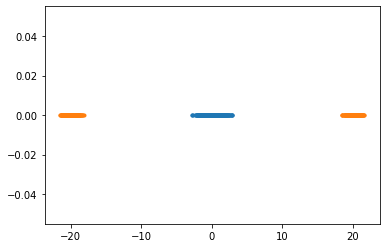

In [104]:
import numpy.random as npr
import numpy as np
import matplotlib.pyplot as plt
%matplotlib inline

n = 900
n_2 = int(n * 1.0 / 3)
n_2 = int(n * 1.0 / 2.0)


X1 = npr.randn(n).reshape(-1,1) - 0
X21 = 0.6 * npr.randn(n_2).reshape(-1,1) + 20
X22 =  0.6 * npr.randn(n_2).reshape(-1,1) -20
# X23 =  0.6 * npr.randn(n_2).reshape(-1,1) + 20

X2 = np.concatenate((X21, X22), axis=0)
X1, X2 = X2, X1

plt.plot(X2.flatten(), [0] * n, '.')
plt.plot(X1.flatten(), [0] * n, '.')

with torch.cuda.device(0):

    X1 = torch.tensor(X1).cuda()
    X2 = torch.tensor(X2).cuda()

In [121]:


torch.cuda.manual_seed_all(10)
torch.manual_seed(10)

c = cIPFP(
    X1, X2,  number_time_steps=100, batch_size=900 ,
    step_size=5e-3, weights=[20, 20], rng = None,
    optimizer=torch.optim.Adam, lrs = 0.005, weight_decay=0, log_prob=knn_log_prob
)

/anaconda/envs/py37_default/lib/python3.7/site-packages/ipykernel_launcher.py:21: UserWarning: nn.init.xavier_uniform is now deprecated in favor of nn.init.xavier_uniform_.


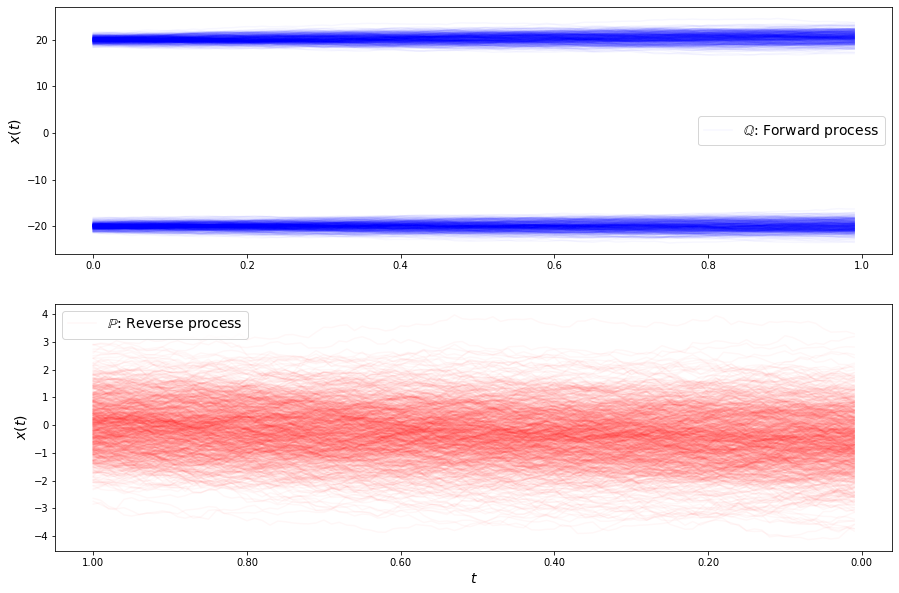

loss b 5.831217605565457
loss b 5.712605912351998
loss b 5.606707895831123
loss b 5.557188198792965
loss b 5.487765057454522
loss b 5.597004757421539
loss b 5.666966657969219
loss b 5.7538219217920155
loss b 5.797297360490436
loss b 5.8076325424236295
loss b 5.736042350637001
loss b 5.728247692387599
loss b 5.688014296091304
loss b 5.7001490299893005
loss b 5.527006073849829
loss b 5.680844771254925
loss b 5.766969606043017
loss b 5.81942215462206
loss b 5.844024221289072
loss b 6.018764188051197
loss b 6.134074573182393
loss b 6.232093695706502
loss b 6.291098869079186
loss b 6.271588659117561
loss b 6.2372360552342005
loss b 6.2376292072519455
loss b 6.1499066998211065
loss b 6.063960699167798
loss b 5.953067411136241
loss b 5.916360184280474
loss f 5.681186052330104
loss f 5.566091234588896
loss f 5.715403704770015
loss f 5.781320594819148
loss f 5.746615547790661
loss f 5.660595385446465
loss f 5.634325718247144
loss f 5.626275519681585
loss f 5.698600630271216
loss f 5.84338656702

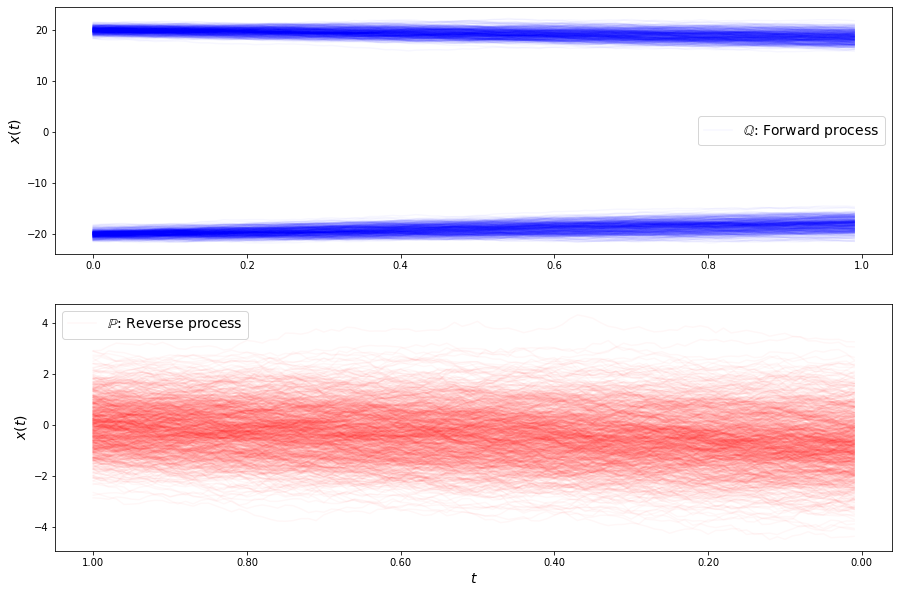

loss b 5.282657673557371
loss b 5.313782736736288
loss b 5.436658748486709
loss b 5.446464579462408
loss b 5.4114810682217405
loss b 5.351410720256376
loss b 5.479646236422129
loss b 5.485433631020637
loss b 5.496760088763531
loss b 5.470097018748976
loss b 5.541394425091556
loss b 5.491412622355966
loss b 5.511455452191308
loss b 5.526000861961591
loss b 5.514032804829744
loss b 5.365179132772512
loss b 5.4744512852309635
loss b 5.4047929317353995
loss b 5.462294729413496
loss b 5.445773551407209
loss b 5.372167922719433
loss b 5.364374588956335
loss b 5.3722214219314015
loss b 5.331686285228851
loss b 5.209332044069608
loss b 5.279856342512989
loss b 5.292431213342371
loss b 5.191528308809457
loss b 5.2295816833380515
loss b 5.069559147901105
loss f 5.616541272994163
loss f 5.574782962312992
loss f 5.604033837821771
loss f 5.597228351864659
loss f 5.556544584246932
loss f 5.549262282318169
loss f 5.549249058162784
loss f 5.52589325343275
loss f 5.555013757534396
loss f 5.588213504084

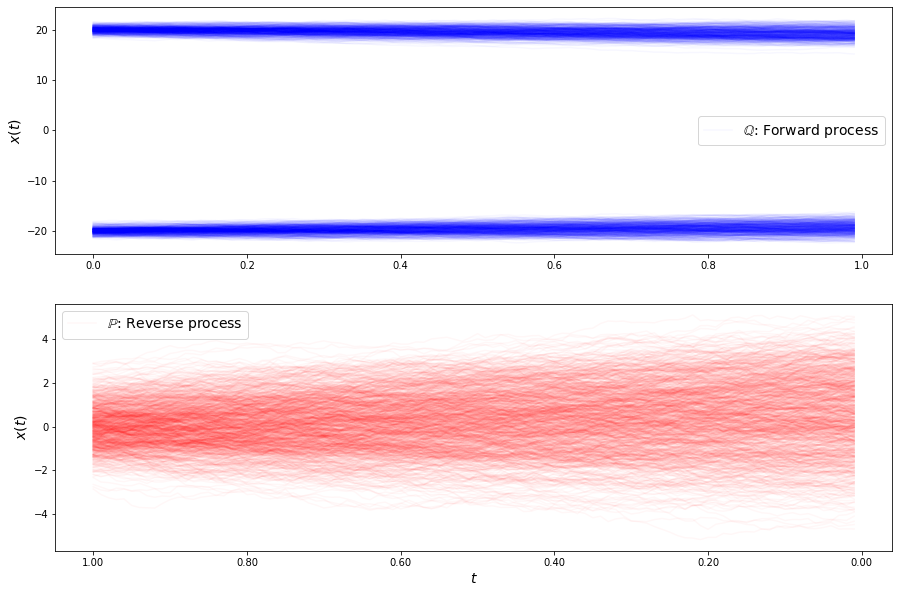

loss b 5.87225641716039
loss b 5.971473258577627
loss b 5.982906928877222
loss b 6.058054600520213
loss b 5.997033327290375
loss b 6.170668680690391
loss b 6.087311891310999
loss b 6.161358075905768
loss b 6.124515927600052
loss b 6.176944517208387
loss b 6.216835960673252
loss b 6.1205542065016
loss b 6.115445669928837
loss b 6.177483940621643
loss b 6.191770652752799
loss b 6.137890407717926
loss b 6.072205004942511
loss b 6.133960879948768
loss b 6.103870027506847
loss b 6.105005606039185
loss b 6.013811278172898
loss b 6.001239339094741
loss b 5.990633981511
loss b 5.937688783474526
loss b 6.064714084942522
loss b 5.911961642311533
loss b 5.978752284261635
loss b 5.9092681168218055
loss b 5.971021638680959
loss b 5.9558284912160575
loss f 5.736590778199265
loss f 5.809017558420225
loss f 5.847822091753373
loss f 5.938797782712949
loss f 6.011309739362847
loss f 6.102943067714823
loss f 6.18253409436059
loss f 6.245963730265029
loss f 6.322650680475715
loss f 6.339163698534894
loss 

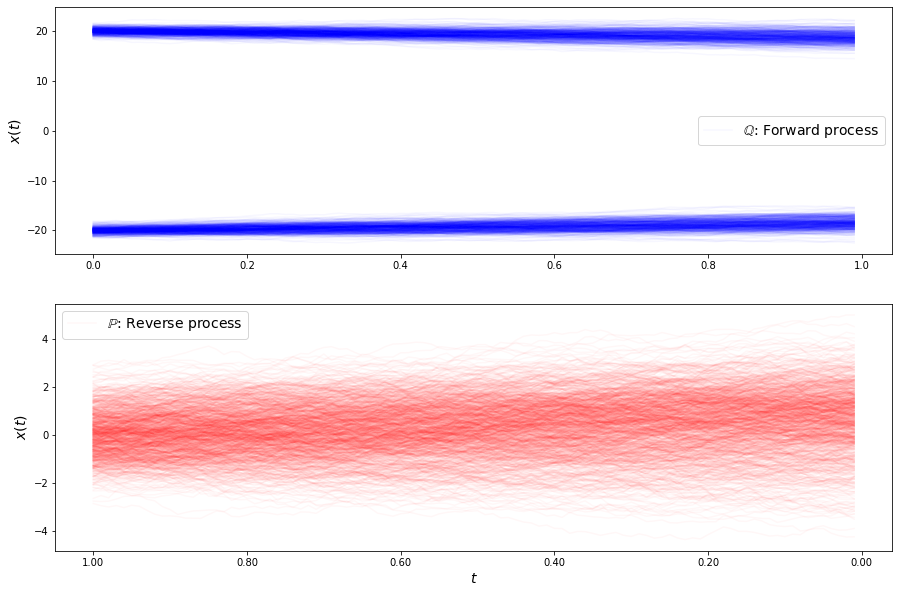

loss b 5.445054144906957
loss b 5.457668154861052
loss b 5.432083400815278
loss b 5.547905884747102
loss b 5.54461704664469
loss b 5.454892945905852
loss b 5.533286649865871
loss b 5.614163279510034
loss b 5.536908506923542
loss b 5.5529187359213354
loss b 5.584121745776075
loss b 5.6568528771972915
loss b 5.655539538018387
loss b 5.789017943198895
loss b 5.721484800129012
loss b 5.857649807960221
loss b 5.826121421540315
loss b 5.897725703050103
loss b 5.904940575357534
loss b 6.073188546683952
loss b 6.009948187730846
loss b 6.203000213171858
loss b 6.172282268861012
loss b 6.210424784405919
loss b 6.257070401723256
loss b 6.286886419420779
loss b 6.3245206417965125
loss b 6.4991448530573726
loss b 6.339931335574428
loss b 6.337447914187592
loss f 5.793809171291307
loss f 5.853000728772758
loss f 5.860989222675764
loss f 5.898353675616046
loss f 5.922043226281906
loss f 5.94135285003758
loss f 5.94973657132726
loss f 5.973621471176146
loss f 5.978975907140132
loss f 6.004219182122921

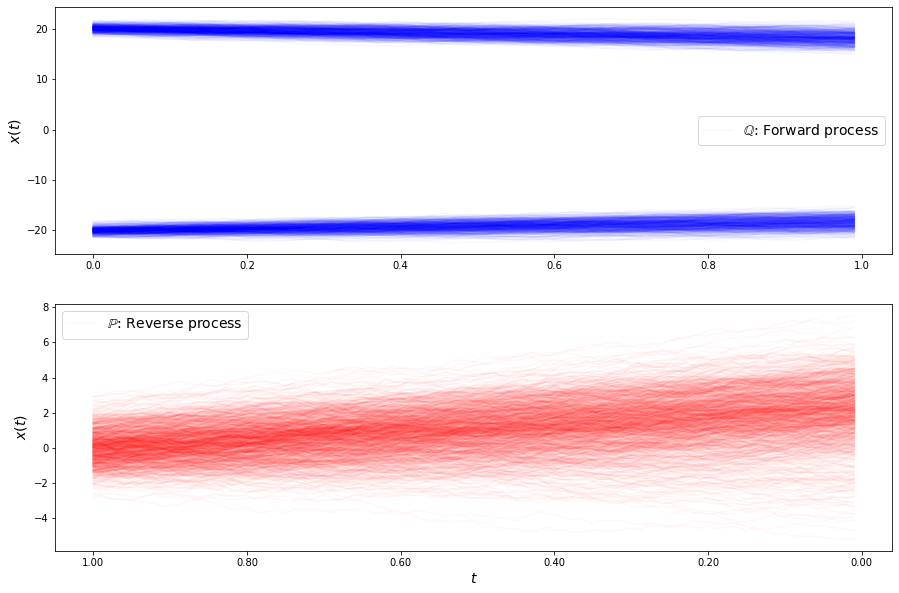

loss b 5.212357433981747
loss b 5.364383080746097
loss b 5.201157917486208
loss b 5.268441342592672
loss b 5.2459821151662185
loss b 5.25999634098568
loss b 5.189781432615707
loss b 5.214029022928629
loss b 5.262390259751643
loss b 5.194577171874041
loss b 5.205979841707115
loss b 5.168008115597892
loss b 5.158108893513898
loss b 5.041275263590974
loss b 5.031611890983922
loss b 5.027423299433723
loss b 5.085123962610016
loss b 5.005464974939998
loss b 5.089201392798209
loss b 5.066577369514598
loss b 5.078661511795632
loss b 4.850262444460037
loss b 5.071183180513882
loss b 5.120272974836317
loss b 5.087194479683676
loss b 5.098181754043447
loss b 5.22671255484035
loss b 5.0270073729764215
loss b 5.223546272295781
loss b 5.16869687964477
loss f 5.8954565388540585
loss f 5.997691252215636
loss f 6.08409799183575
loss f 6.112598558644465
loss f 6.208864312307386
loss f 6.273521162997514
loss f 6.392667673281206
loss f 6.479990389623861
loss f 6.579380527501652
loss f 6.661680977794259
l

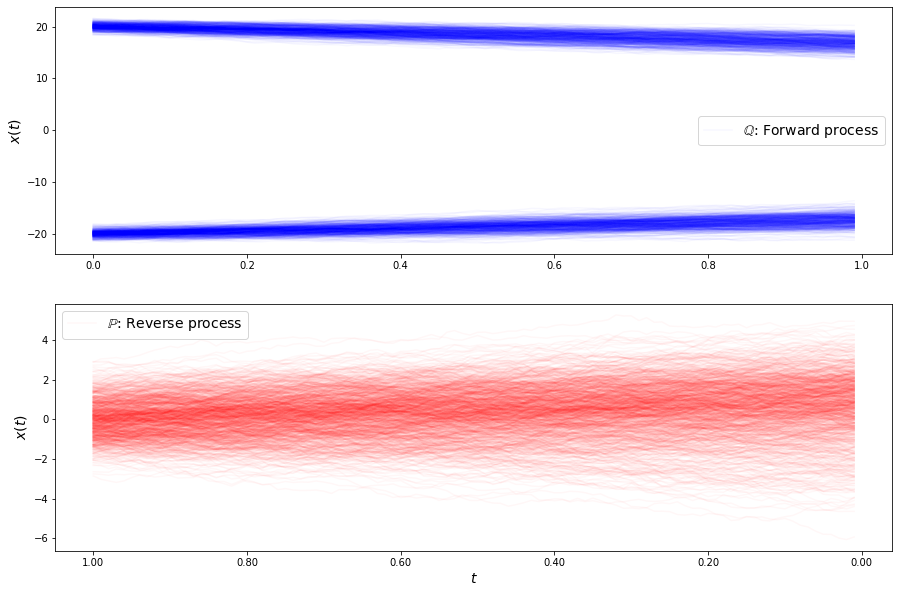

loss b 6.901236768326257
loss b 6.841462575393722
loss b 6.865492665547543
loss b 6.843906032656704
loss b 6.854923802678165
loss b 6.780540385128741
loss b 6.804981583932159
loss b 6.759556385978215
loss b 6.66744211984148
loss b 6.642663540464128
loss b 6.621999444916988
loss b 6.510372773845595
loss b 6.3537627127560405
loss b 6.340225691610908
loss b 6.265528727529515
loss b 6.118404763548721
loss b 6.083285377038888
loss b 5.930063311257895
loss b 5.728918528630712
loss b 5.759692679649071
loss b 5.652774274815808
loss b 5.532307808603296
loss b 5.381011383495791
loss b 5.430943122923797
loss b 5.264211748830595
loss b 5.262420236891293
loss b 5.251690337618081
loss b 5.2728290286964
loss b 5.187319213886514
loss b 5.244238860914761
loss f 5.44918981226286
loss f 5.491097406873136
loss f 5.565072295659602
loss f 5.567863510640577
loss f 5.667886097017837
loss f 5.740700031971633
loss f 5.830964121587497
loss f 5.918517156951763
loss f 6.014067543727503
loss f 6.118060232100114
los

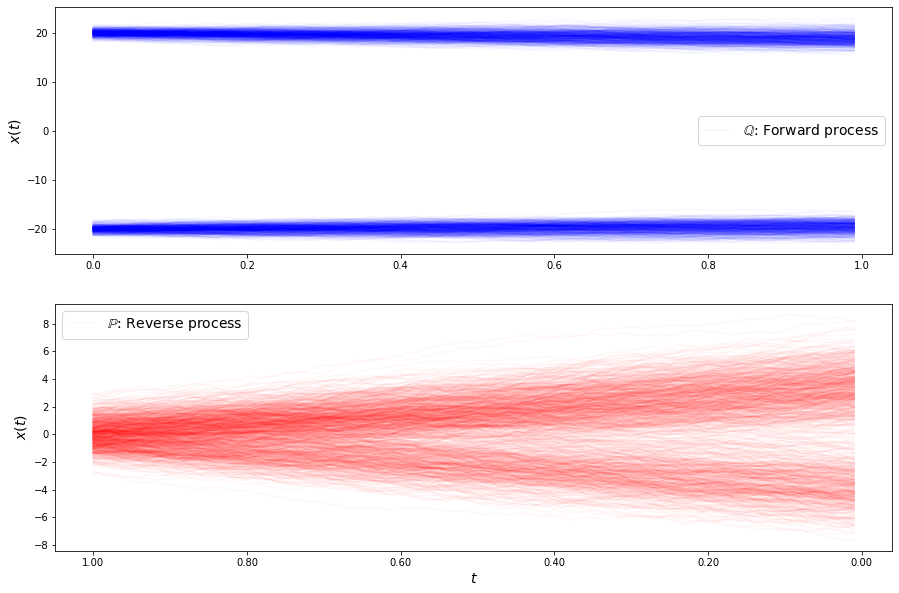

loss b 7.487993129622997
loss b 7.682052300873723
loss b 7.825376052229414
loss b 7.914972444507208
loss b 8.135679271556857
loss b 8.285263798685012
loss b 8.349241807728736
loss b 8.519089929319428
loss b 8.470744326146558
loss b 8.580326380466985
loss b 8.615145834718035
loss b 8.607251846737404
loss b 8.63077729560958
loss b 8.609352398725015
loss b 8.608331640931583
loss b 8.505373698826476
loss b 8.542010060918694
loss b 8.390578659160436
loss b 8.389506836220058
loss b 8.317856310826548
loss b 8.213259555800198
loss b 8.040611933806488
loss b 7.92994881136241
loss b 7.850931282274152
loss b 7.779505855485601
loss b 7.6163889609297675
loss b 7.506208297806097
loss b 7.341268684414385
loss b 7.017258349323555
loss b 7.120532031410286
loss f 7.669682047188383
loss f 7.673703244082843
loss f 7.680967886917288
loss f 7.6090928318806474
loss f 7.585234464517375
loss f 7.475899405241332
loss f 7.311563178046031
loss f 7.179295620373494
loss f 7.0292671920107175
loss f 6.868508333665619

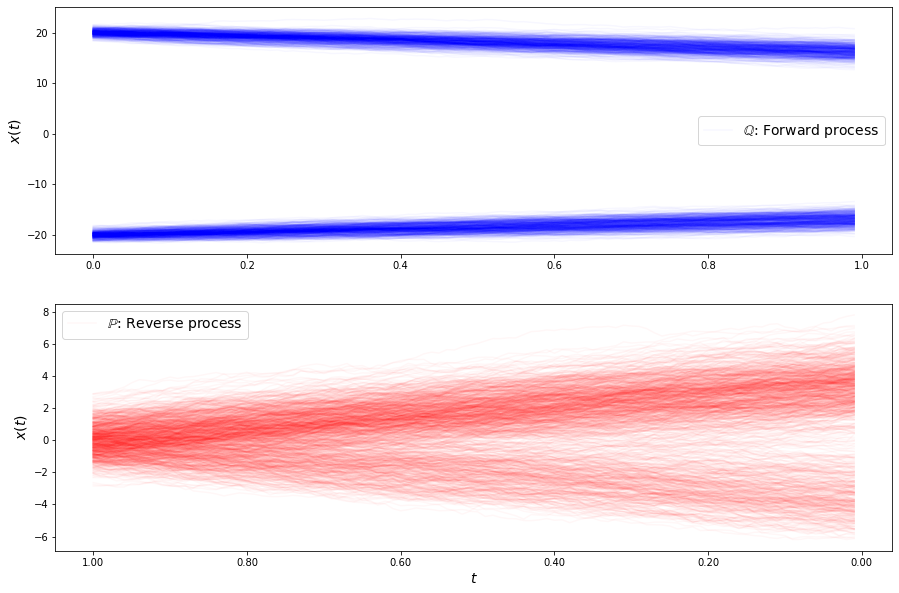

loss b 4.6741653797082
loss b 4.72168713485802
loss b 4.7010705067655785
loss b 4.699069774484319
loss b 4.877889522471262
loss b 4.912212339080857
loss b 5.113362736847124
loss b 5.197275219215138
loss b 5.0916396302225255
loss b 5.2623263514535354
loss b 5.3485522218276165
loss b 5.423218748861854
loss b 5.548366933915039
loss b 5.639375785415082
loss b 5.74495484125753
loss b 5.808692799259042
loss b 5.959778972299749
loss b 6.107494756693278
loss b 6.2392710825399345
loss b 6.336062098133734
loss b 6.408122431551187
loss b 6.492563410187167
loss b 6.646453490741348
loss b 6.6765174563865495
loss b 6.853741563766022
loss b 6.8663099555070986
loss b 7.072127182939139
loss b 7.090756465153622
loss b 7.334856901901376
loss b 7.389762297958498
loss f 10.304096198229587
loss f 10.63449002785272
loss f 10.878996817677052
loss f 11.174798965583385
loss f 11.489683473211757
loss f 11.753332814959533
loss f 12.004708374567185
loss f 12.269159630855809
loss f 12.496613954554626
loss f 12.7746

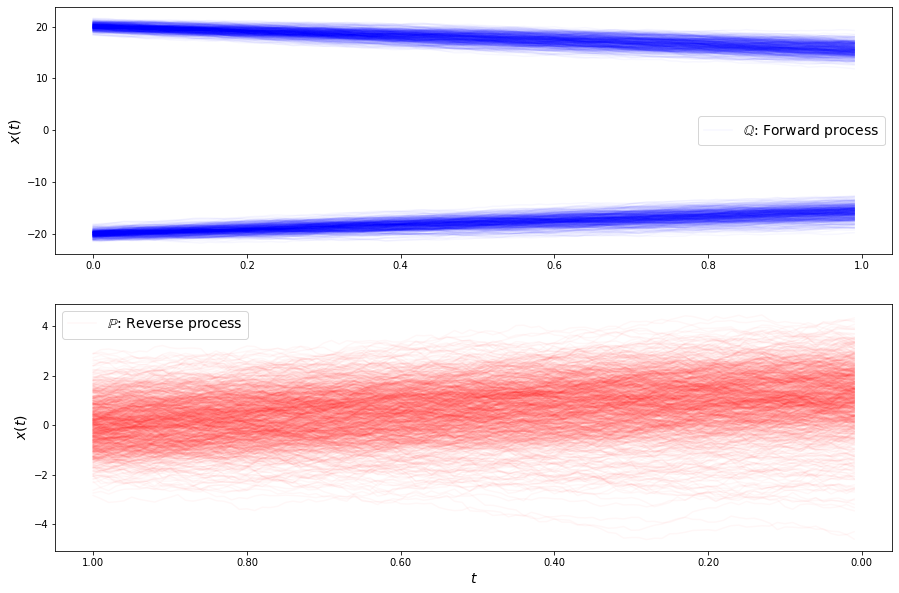

loss b 9.350187445741424
loss b 9.775792845491155
loss b 9.633232506949984
loss b 9.74717901776064
loss b 9.973008353834707
loss b 9.994519563063532
loss b 9.831007487450854
loss b 9.76590951191324
loss b 9.998873943589416
loss b 9.71525119056952
loss b 9.946630820623625
loss b 9.49720557926158
loss b 9.77680094132904
loss b 9.667244178734748
loss b 9.591510434764821
loss b 9.655665300709805
loss b 9.512047318384619
loss b 9.205449814390875
loss b 9.30258371312355
loss b 9.16992358664857
loss b 9.060123008999636
loss b 9.287447838788143
loss b 8.985182870473533
loss b 8.972927735972378
loss b 8.787852610220519
loss b 8.689209303130413
loss b 8.636439853899574
loss b 8.39471804543623
loss b 8.189757096912375
loss b 8.270068356710782
loss f 9.685109019615545
loss f 9.489739485216095
loss f 9.3472369498454
loss f 9.189025623717566
loss f 8.966425711873663
loss f 8.789972318748488
loss f 8.526429117561978
loss f 8.309304571223043
loss f 8.07232734359384
loss f 7.877393802080772
loss f 7.67

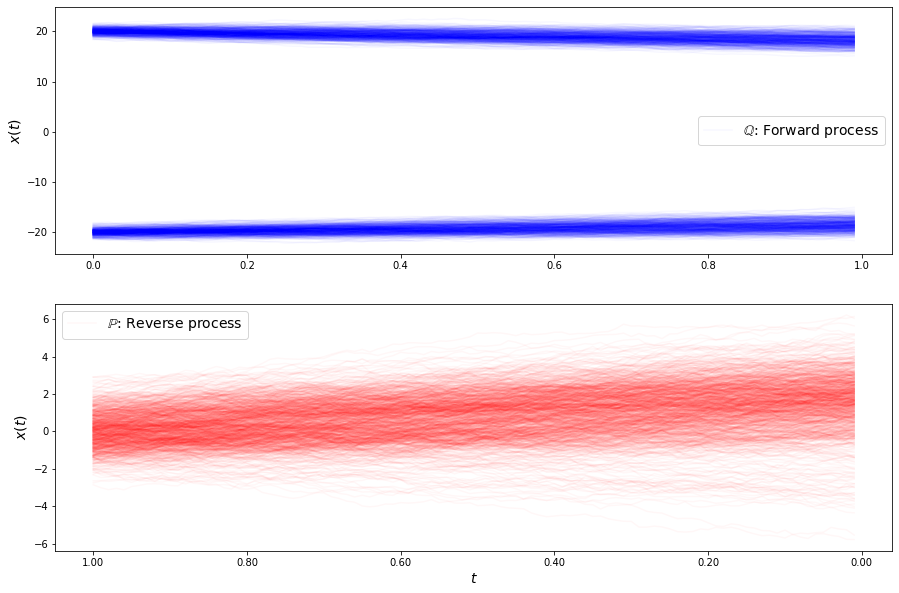

loss b 5.232322241836242
loss b 5.244388605199085
loss b 5.260413545603881
loss b 5.240734181363016
loss b 5.218451127515798
loss b 5.288272770030453
loss b 5.23778400633448
loss b 5.131684105804536
loss b 5.253064768237258
loss b 5.318945660339507
loss b 5.324021018284296
loss b 5.348000435614676
loss b 5.453459644408913
loss b 5.467425846109272
loss b 5.419034101655309
loss b 5.385062290644347
loss b 5.487690970818357
loss b 5.529193079754
loss b 5.650908561058559
loss b 5.632573935321979
loss b 5.823067085980351
loss b 5.782410385902362
loss b 5.862394657083257
loss b 6.0284803392078015
loss b 5.822055292869161
loss b 6.048929517838142
loss b 6.211395462268513
loss b 6.304113720314182
loss b 6.197762560747651
loss b 6.476876613526079
loss f 8.26672129180625
loss f 8.546896225397443
loss f 8.757055706685128
loss f 9.026735475766134
loss f 9.331934470991488
loss f 9.534854090526409
loss f 9.783144168315708
loss f 10.04546900123809
loss f 10.336327207521542
loss f 10.568398607506365
lo

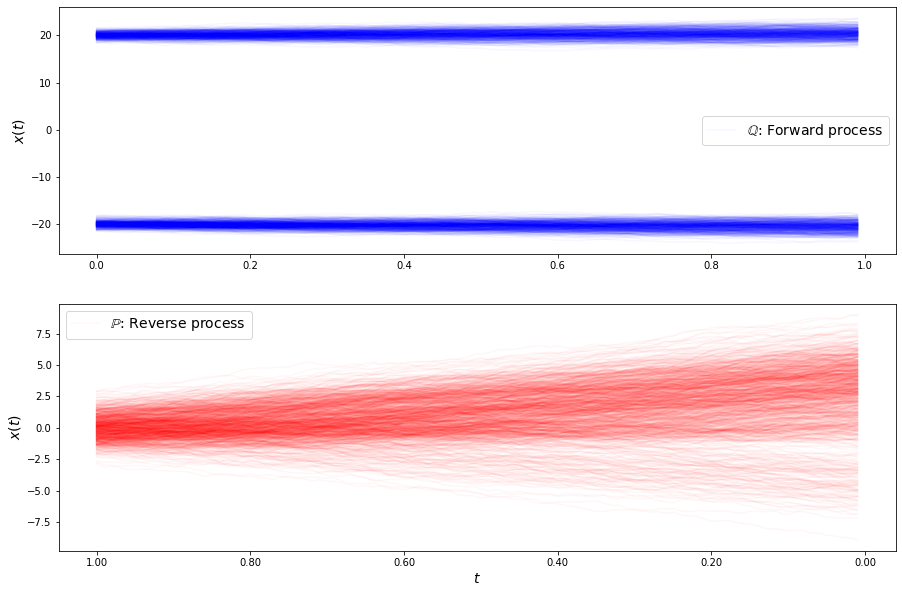

loss b 10.674467214034072
loss b 10.82077527845997
loss b 10.992592291600785
loss b 11.173377555046658
loss b 11.235497163414252
loss b 11.305712769458186
loss b 11.271245143707414
loss b 11.46461890542783
loss b 11.537939522807514
loss b 11.657417908879593
loss b 11.776237253420005
loss b 11.697437324081912
loss b 11.706011989710934
loss b 11.662558523723305
loss b 11.727316493941704
loss b 11.684812017353138
loss b 11.861118753689462
loss b 11.635957835925252
loss b 11.562307675927276
loss b 11.430223806946682
loss b 11.54565510750147
loss b 11.274340791656229
loss b 11.251573535789383
loss b 11.31279994133379
loss b 10.960980330268754
loss b 10.961237917060838
loss b 10.79863716384238
loss b 10.676228870644865
loss b 10.506797997336326
loss b 10.28452846941427
loss f 18.933261873170288
loss f 19.118762434831105
loss f 19.279191599792696
loss f 19.435531569452962
loss f 19.587253847951427
loss f 19.717044305309205
loss f 19.844806186213123
loss f 19.951110237987184
loss f 20.04477137

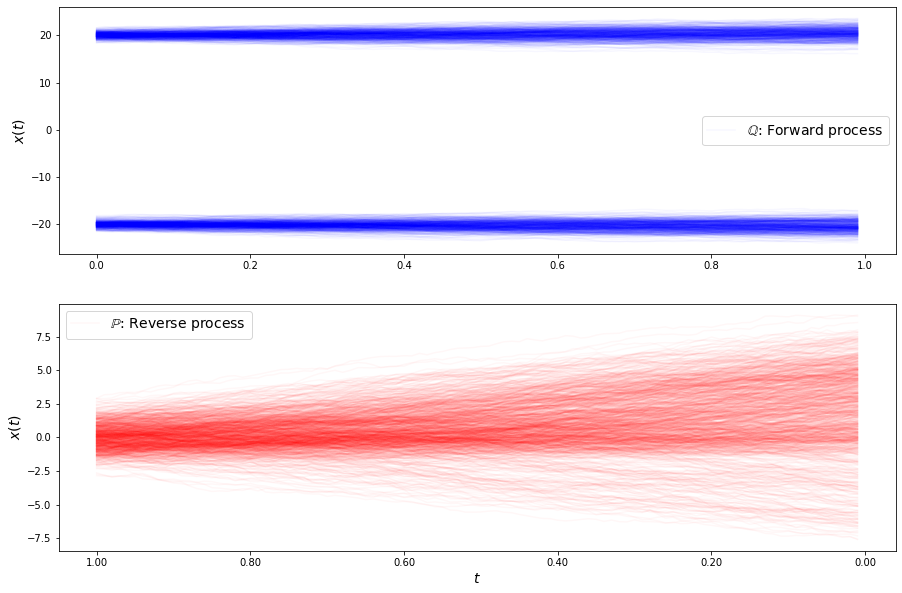

loss b 11.839858333177004
loss b 11.705792876788836
loss b 11.554302031626174
loss b 11.219235492204916
loss b 11.064501745150986
loss b 10.719703696625034
loss b 10.478506635329698
loss b 10.28753412441754
loss b 10.075821039200138
loss b 9.759453994328963
loss b 9.469030773047884
loss b 9.266804136683762
loss b 9.025745090865994
loss b 8.869382192498618
loss b 8.727334596978707
loss b 8.485548165545117
loss b 8.2939496879966
loss b 8.107665190316123
loss b 7.9376523023999175
loss b 7.743113329921709
loss b 7.704741908442799
loss b 7.5028249049229405
loss b 7.413734881031077
loss b 7.251450427085497
loss b 7.24179967581149
loss b 7.1031859839748845
loss b 7.002042418611941
loss b 6.966659822212821
loss b 6.8702285233510825
loss b 6.8514098277779905
loss f 10.551083247697752
loss f 10.414606440585505
loss f 10.243800833551266
loss f 10.074797321190472
loss f 9.906350736181214
loss f 9.72633267434813
loss f 9.544964161169345
loss f 9.356254013843722
loss f 9.159152390627428
loss f 8.972

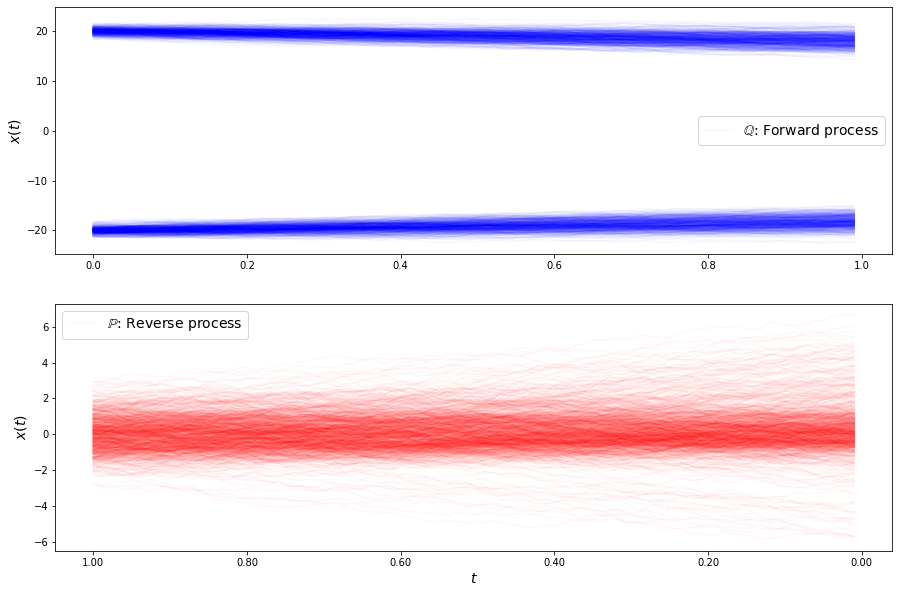

loss b 5.735593617172251
loss b 5.732785104112772
loss b 5.783787820445791
loss b 5.828365986599966
loss b 5.801583921486797
loss b 5.871525513605692
loss b 5.963946621700812
loss b 6.015065389321949
loss b 6.038134238446956
loss b 6.013756560676837
loss b 6.059623188563228
loss b 6.129528305437446
loss b 6.1410422666675215
loss b 6.2360725647504385
loss b 6.240914247958062
loss b 6.239559250303047
loss b 6.238817460030699
loss b 6.305342959132383
loss b 6.329030292942722
loss b 6.3865607199276235
loss b 6.414327257022197
loss b 6.455692465998156
loss b 6.402828937291367
loss b 6.533219795081265
loss b 6.566620424249551
loss b 6.591436925521356
loss b 6.512727535072532
loss b 6.59226405866526
loss b 6.578136839375102
loss b 6.626534242947335
loss f 6.605547572842957
loss f 6.716648825501219
loss f 6.839422646733152
loss f 6.9695498526972965
loss f 7.090952060095853
loss f 7.243164266711857
loss f 7.378134621977227
loss f 7.529014058905639
loss f 7.674725991693277
loss f 7.8277440958809

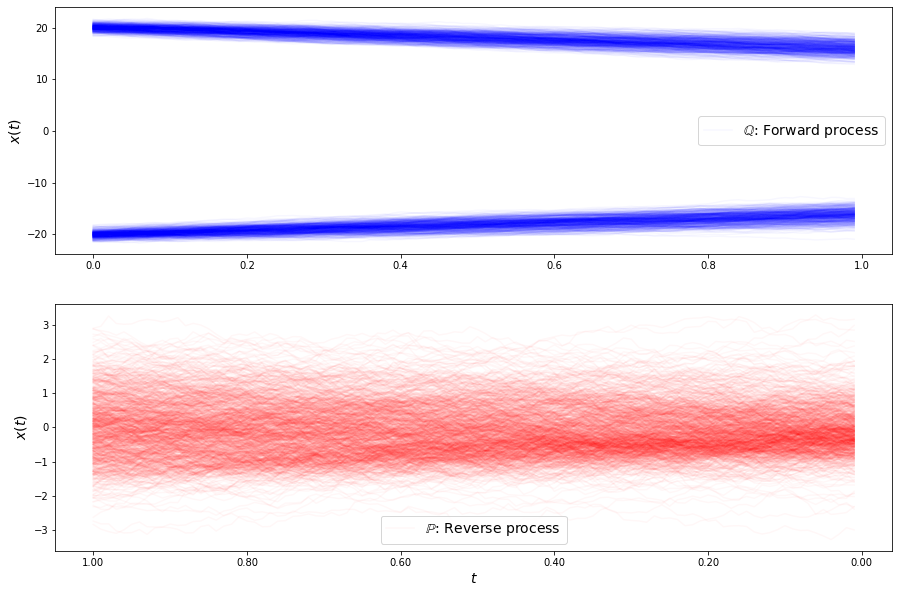

loss b 9.230605451227268
loss b 9.130787169732855
loss b 8.971032966210931
loss b 9.272450183554254
loss b 9.384368319396168
loss b 9.198608944963938
loss b 9.260826000620975
loss b 9.246221992246335
loss b 9.280629286324741
loss b 9.348873693927333
loss b 9.347838898583722
loss b 9.523627941919171
loss b 9.332731700639227
loss b 9.12204716644648
loss b 9.52632655329
loss b 9.343327492942752
loss b 9.434132419332611
loss b 9.367789012404549
loss b 9.28978894569439
loss b 9.545073049912048
loss b 9.360488864472742
loss b 9.41221660710222
loss b 9.428225119933419
loss b 9.571650288039246
loss b 9.491590152298903
loss b 9.564820288645949
loss b 9.56467582281488
loss b 9.444868203220782
loss b 9.442766182351574
loss b 9.42250439359905
loss f 19.047771852725184
loss f 19.31745264595915
loss f 19.57732916904792
loss f 19.836556366849255
loss f 20.07955066838828
loss f 20.31375754011635
loss f 20.53869791103473
loss f 20.74300045955368
loss f 20.954980312524913
loss f 21.15952394252936
loss f

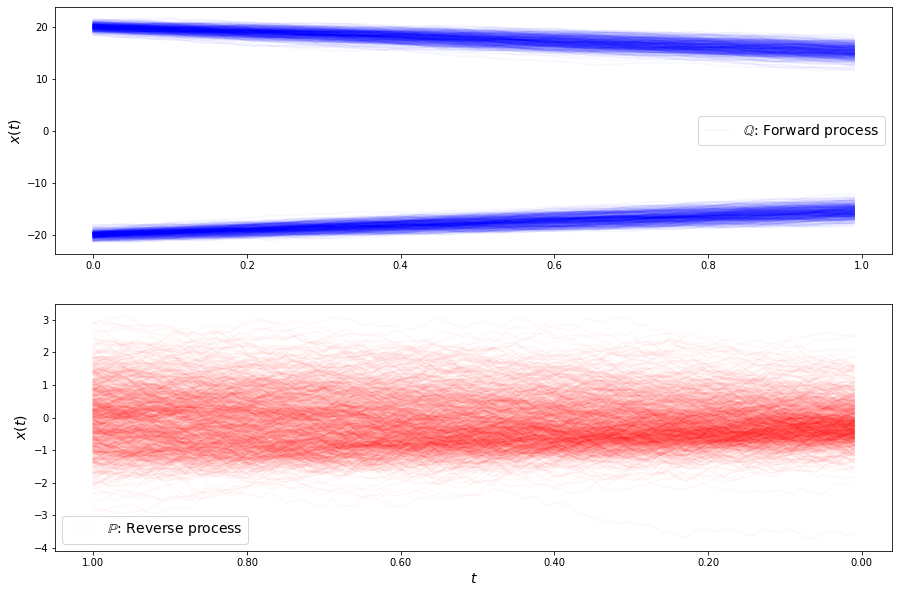

loss b 9.78798617931996
loss b 9.651820265708755
loss b 9.65975332417207
loss b 9.850829509479933
loss b 9.626375412740307
loss b 9.687968937633846
loss b 9.788036651800052
loss b 9.776831066619433
loss b 9.712266011278789
loss b 9.743969437739537
loss b 9.856737842299383
loss b 9.903175259827165
loss b 9.630699276709507
loss b 9.462637284744522
loss b 9.589068468800976
loss b 9.713356929985238
loss b 9.90353325992101
loss b 9.580935218907838
loss b 9.964955872031808
loss b 9.937177226817674
loss b 9.531129353094107
loss b 9.599445222618609
loss b 9.743938444245257
loss b 9.683183596179731
loss b 9.513495808913397
loss b 9.671849317132502
loss b 9.63427752248006
loss b 9.595167304480835
loss b 9.902012071072283
loss b 9.685879570750098
loss f 26.490931903287617
loss f 26.465965371280024
loss f 26.417428269142896
loss f 26.34924646604728
loss f 26.274452958264252
loss f 26.185841926345216
loss f 26.066417732513848
loss f 25.953486826941337
loss f 25.807485258226947
loss f 25.65513557887

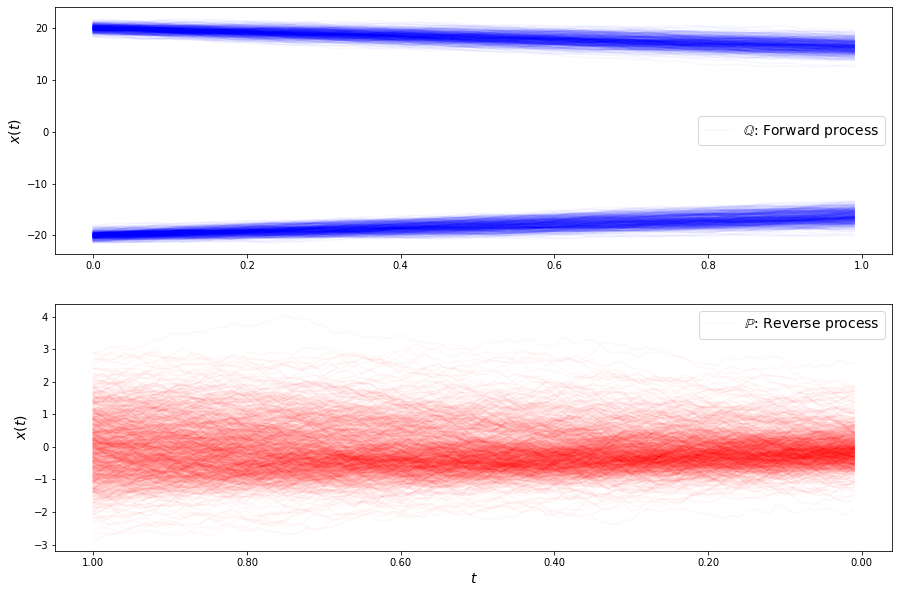

loss b 7.448333630982283
loss b 7.510388015038917
loss b 7.451487137346804
loss b 7.440092895733794
loss b 7.41487151022491
loss b 7.567277719967387
loss b 7.481658384313009
loss b 7.483718594311918
loss b 7.545929578727372
loss b 7.42650609263388
loss b 7.5925107194069605
loss b 7.430982055046919
loss b 7.407788309110047
loss b 7.573533738717879
loss b 7.494626043298541
loss b 7.428340960709804
loss b 7.534198651401246
loss b 7.49577855086815
loss b 7.588197141168866
loss b 7.625304078690319
loss b 7.414410007378267
loss b 7.596477492509696
loss b 7.591443207764814
loss b 7.439621950622838
loss b 7.588031973484653
loss b 7.506389463986589
loss b 7.449679307509855
loss b 7.644627123501562
loss b 7.3784494105979
loss b 7.511998585487549
loss f 17.296473080168354
loss f 17.0194542876671
loss f 16.733486790309176
loss f 16.465203625623435
loss f 16.17549628607847
loss f 15.90445701935253
loss f 15.611313506833119
loss f 15.33564788716222
loss f 15.0519422407656
loss f 14.782362641939459
l

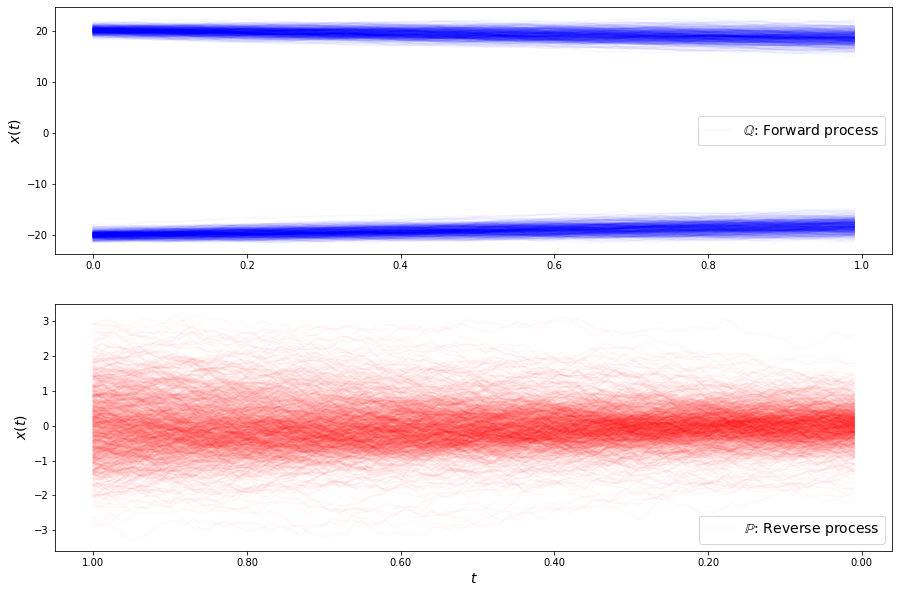

loss b 6.868269501223778
loss b 6.890362318887307
loss b 6.8791912739170975
loss b 6.87847823172512
loss b 6.860763761115572
loss b 6.784217095691081
loss b 6.837637172723647
loss b 6.8225445047891355
loss b 6.7818672193673
loss b 6.7736793441297
loss b 6.747646922598474
loss b 6.705257111247705
loss b 6.709358985938054
loss b 6.702513788370123
loss b 6.709847285478992
loss b 6.719033019763782
loss b 6.657214292429107
loss b 6.639295310057261
loss b 6.662025302947235
loss b 6.654798621190318
loss b 6.598203973925354
loss b 6.570940397740362
loss b 6.570966973757454
loss b 6.516572681174546
loss b 6.544099078961523
loss b 6.479413843339272
loss b 6.550562894217817
loss b 6.482837048079859
loss b 6.443046822407623
loss b 6.4686177830565565
loss f 6.845693995105201
loss f 6.74577532831818
loss f 6.636602435648111
loss f 6.543733426827984
loss f 6.4487962644433265
loss f 6.36539137155466
loss f 6.289055588836714
loss f 6.205096457899478
loss f 6.138919839985353
loss f 6.083680009871039
los

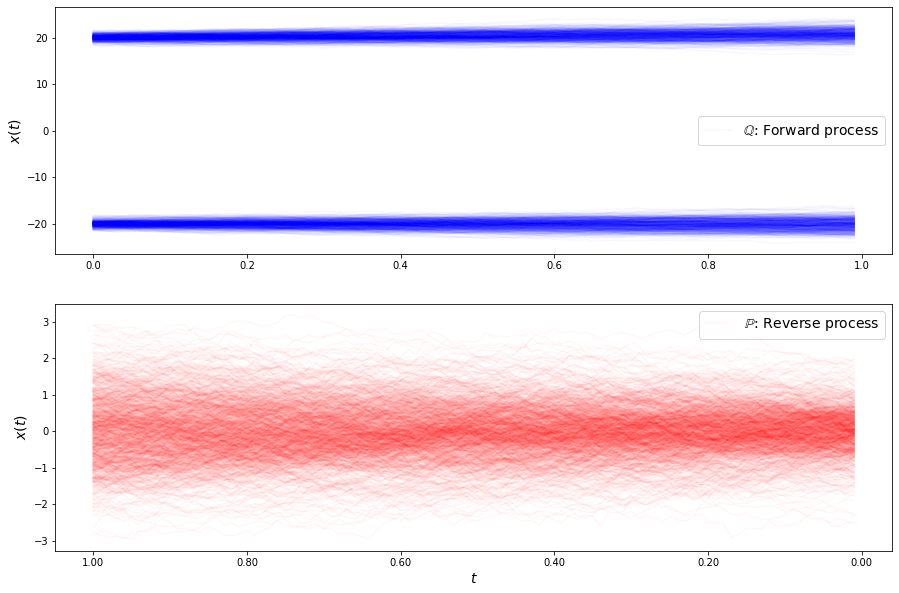

loss b 8.183641514589102
loss b 8.065962273869983
loss b 8.076451658901773
loss b 8.078464133652917
loss b 8.096950641658623
loss b 8.071575245141048
loss b 8.060472580398104
loss b 8.020907010368651
loss b 7.979833475620886
loss b 7.984679254915491
loss b 7.976951981539337
loss b 7.965276640788566
loss b 7.906915322668755
loss b 7.926744772790085
loss b 7.837896787477187
loss b 7.854708896354807
loss b 7.838520486733048
loss b 7.7757693745546375
loss b 7.813855568716758
loss b 7.685151563431761
loss b 7.793973209013477
loss b 7.716100357497271
loss b 7.699200649111685
loss b 7.684267837614973
loss b 7.615915106790866
loss b 7.635694882873423
loss b 7.593662675388943
loss b 7.618159375375016
loss b 7.557086042527805
loss b 7.557263789306838
loss f 7.602873366677252
loss f 7.72625115667573
loss f 7.856928490736465
loss f 7.984684191967178
loss f 8.126090711304618
loss f 8.260248853534673
loss f 8.401756375161936
loss f 8.538633431712725
loss f 8.677907707393082
loss f 8.816598119093692


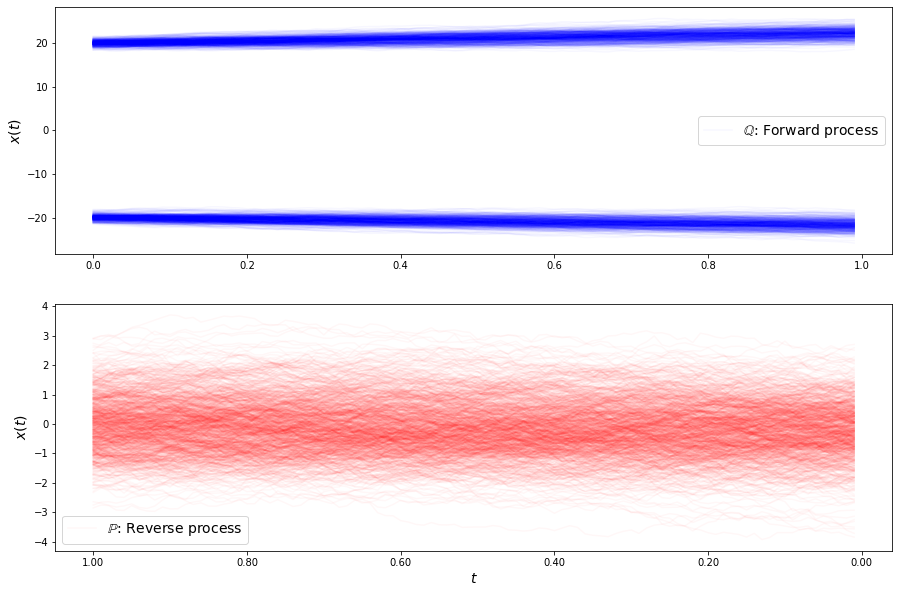

loss b 9.466296460682141
loss b 9.466438348468483
loss b 9.410336767902608
loss b 9.420633700650042
loss b 9.415944398100867
loss b 9.342192265446887
loss b 9.333356727512992
loss b 9.33333480747167
loss b 9.27829657756056
loss b 9.301006593857183
loss b 9.222325335187882
loss b 9.252534544769906
loss b 9.238187910686422
loss b 9.202017976504681
loss b 9.18839480170436
loss b 9.178986013592924
loss b 9.148122377875069
loss b 9.132027295132147
loss b 9.122265986766369
loss b 9.093502651214328
loss b 9.09763645716892
loss b 9.091446651398856
loss b 9.0783499236072
loss b 9.071070568809484
loss b 9.056038334481483
loss b 9.040643849628967
loss b 9.02771899105453
loss b 9.052045861507844
loss b 9.037045791101153
loss b 8.969684049082831
loss f 15.994194046374888
loss f 16.198337425079934
loss f 16.38958812148485
loss f 16.583367481972846
loss f 16.77119561764826
loss f 16.966295355555925
loss f 17.137711253288675
loss f 17.332320024696052
loss f 17.50853803651666
loss f 17.68357857996663
l

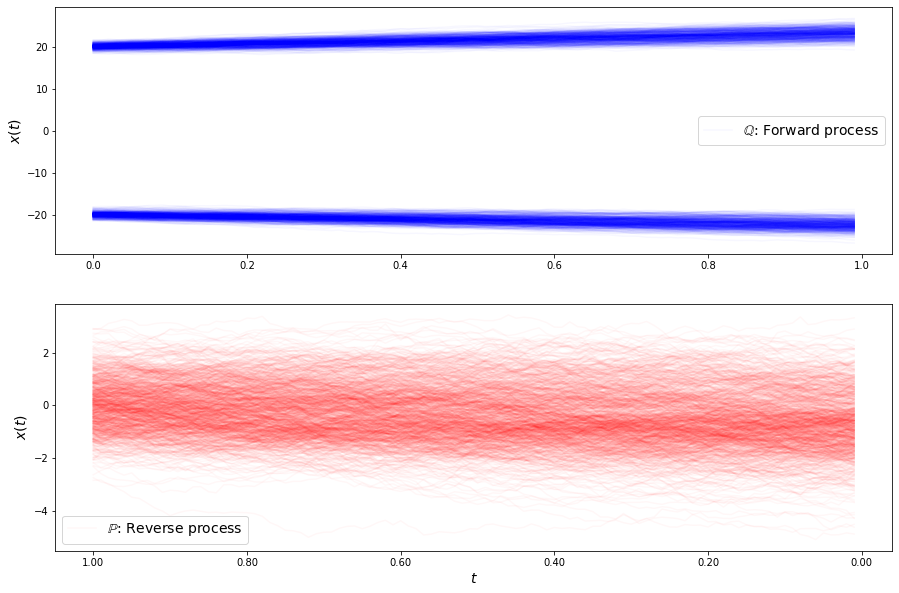

loss b 9.72640276100347
loss b 9.700542746892934
loss b 9.699316542980709
loss b 9.71937068191128
loss b 9.723459302847822
loss b 9.713990883750908
loss b 9.711281769421918
loss b 9.748018466339472
loss b 9.721557047595835
loss b 9.691664114181405
loss b 9.705787396987178
loss b 9.729238274784908
loss b 9.759061989079676
loss b 9.738053063537043
loss b 9.780656811047438
loss b 9.765269666672847
loss b 9.740689746417521
loss b 9.81183132910692
loss b 9.772148339193102
loss b 9.80052469071348
loss b 9.789009402100538
loss b 9.823064272822378
loss b 9.82210532251442
loss b 9.852266712933451
loss b 9.810950149846123
loss b 9.845064333088537
loss b 9.85805867206549
loss b 9.906430001212989
loss b 9.916197143904956
loss b 9.885960020393712
loss f 21.627173647640067
loss f 21.721530790568355
loss f 21.812821362487114
loss f 21.892160272054703
loss f 21.960319176226033
loss f 22.014578566769586
loss f 22.06421647279301
loss f 22.105314217497796
loss f 22.11920586727151
loss f 22.13182521642410

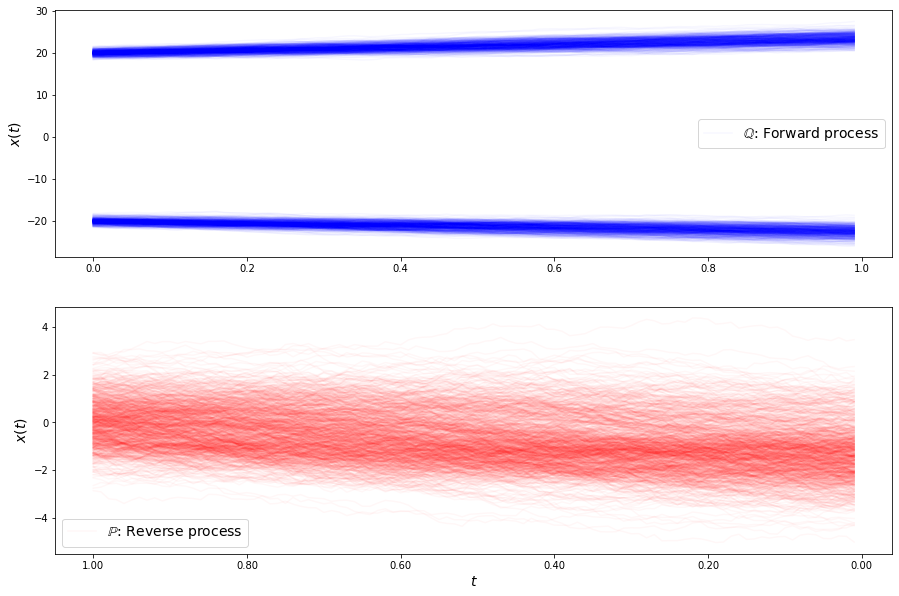

loss b 8.903510071276983
loss b 8.837794899483532
loss b 8.858273457575532
loss b 8.874311324690439
loss b 8.896891739854466
loss b 8.845500942563767
loss b 8.870402412289073
loss b 8.853700183071593
loss b 8.87358510415062
loss b 8.870348045455376
loss b 8.887661859361568
loss b 8.835378137617276
loss b 8.870520701324889
loss b 8.869639922921662
loss b 8.83196540071995
loss b 8.776228917435109
loss b 8.850002749193175
loss b 8.810137769659947
loss b 8.81264933999824
loss b 8.799450454806289
loss b 8.803813164087787
loss b 8.815643836323638
loss b 8.759542835839532
loss b 8.813357740785309
loss b 8.795909752683048
loss b 8.761814253198386
loss b 8.738733544809698
loss b 8.737288847151618
loss b 8.725762032931833
loss b 8.706691573225495
loss f 16.87985390284611
loss f 16.83402101050616
loss f 16.76557403039783
loss f 16.71026265941438
loss f 16.62740379979115
loss f 16.554176323427438
loss f 16.479033269339297
loss f 16.402160339668768
loss f 16.32271275018989
loss f 16.2320725012226
l

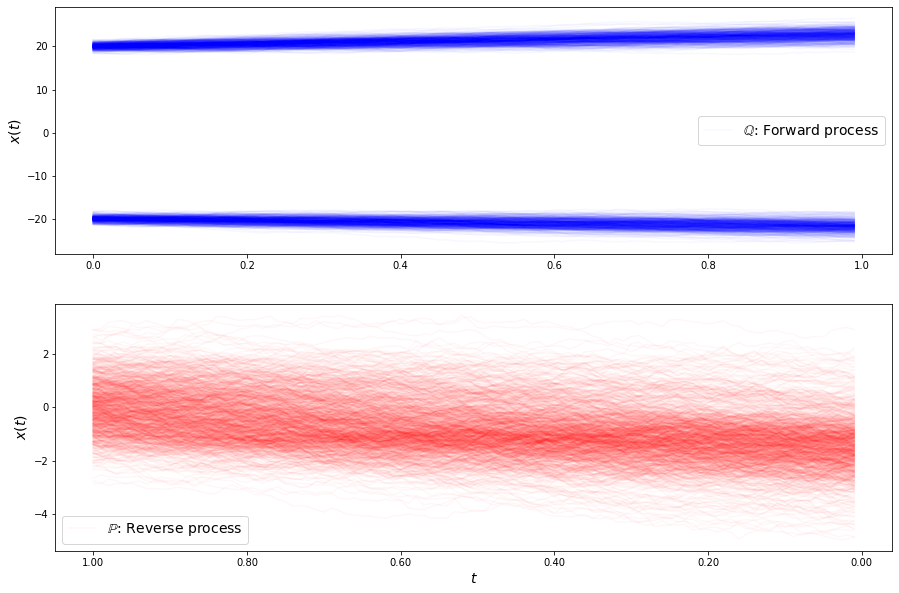

loss b 7.258154212596843
loss b 7.261369466321049
loss b 7.2950774318967495
loss b 7.272665077199741
loss b 7.222085085023559
loss b 7.234354373358035
loss b 7.257400502346898
loss b 7.232532612949984
loss b 7.201862846115308
loss b 7.201129030861445
loss b 7.181418943838086
loss b 7.186590486077784
loss b 7.169700476786933
loss b 7.15120175104455
loss b 7.1907037528517455
loss b 7.176952839010638
loss b 7.121668485733474
loss b 7.143120792876359
loss b 7.115327365159236
loss b 7.114945164134025
loss b 7.132516531223593
loss b 7.10483882375114
loss b 7.091695858639774
loss b 7.106397331381971
loss b 7.110395705104431
loss b 7.115986358617481
loss b 7.094421343783917
loss b 7.106263914418136
loss b 7.0820184932824075
loss b 7.1027044745231365
loss f 8.844584234795756
loss f 8.756825859938573
loss f 8.657493420518202
loss f 8.57243486402735
loss f 8.484456795681519
loss f 8.39457248634209
loss f 8.310666006131136
loss f 8.2317836377088
loss f 8.157373480269069
loss f 8.073301619226617
lo

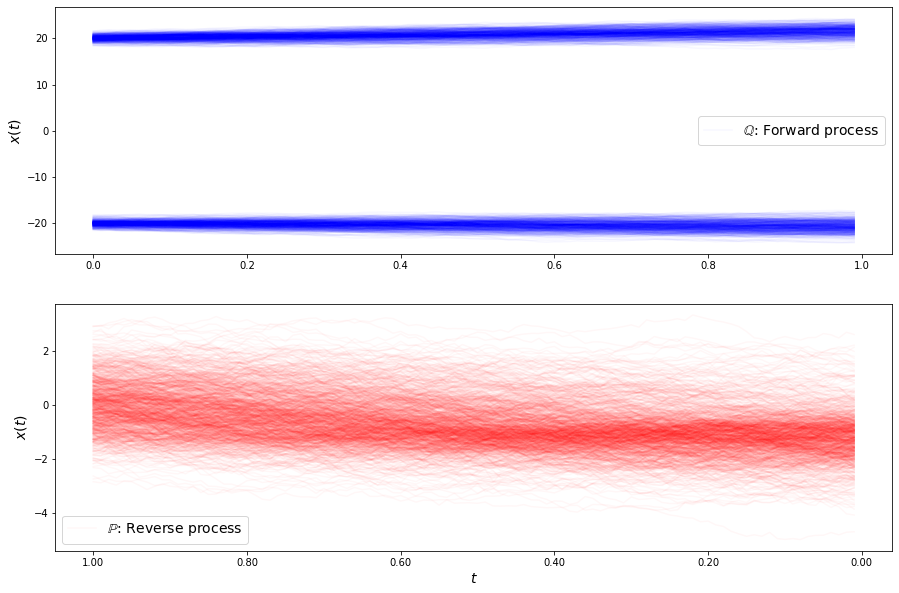

loss b 6.453357029346422
loss b 6.415759152932878
loss b 6.429668760162536
loss b 6.451067963578485
loss b 6.453566203742787
loss b 6.450475228867359
loss b 6.478177619948776
loss b 6.453076364088886
loss b 6.489389041483829
loss b 6.500998892333853
loss b 6.498785987556284
loss b 6.498595346509703
loss b 6.530660978744938
loss b 6.521089000434804
loss b 6.499643371956234
loss b 6.545766290163711
loss b 6.5533600471461195
loss b 6.564513571151984
loss b 6.564401725761202
loss b 6.578550841207764
loss b 6.566978923919069
loss b 6.600640530677245
loss b 6.607898664904608
loss b 6.623097438287014
loss b 6.612572709123532
loss b 6.667632252518275
loss b 6.6554942645579676
loss b 6.662503778590176
loss b 6.663670224064539
loss b 6.682329340615136
loss f 6.072789304524782
loss f 6.050488152817049
loss f 6.020485606637233
loss f 5.9957436243093385
loss f 5.982685024198578
loss f 5.953717908249648
loss f 5.93381857851504
loss f 5.916321217269604
loss f 5.904178016107334
loss f 5.87882402244406

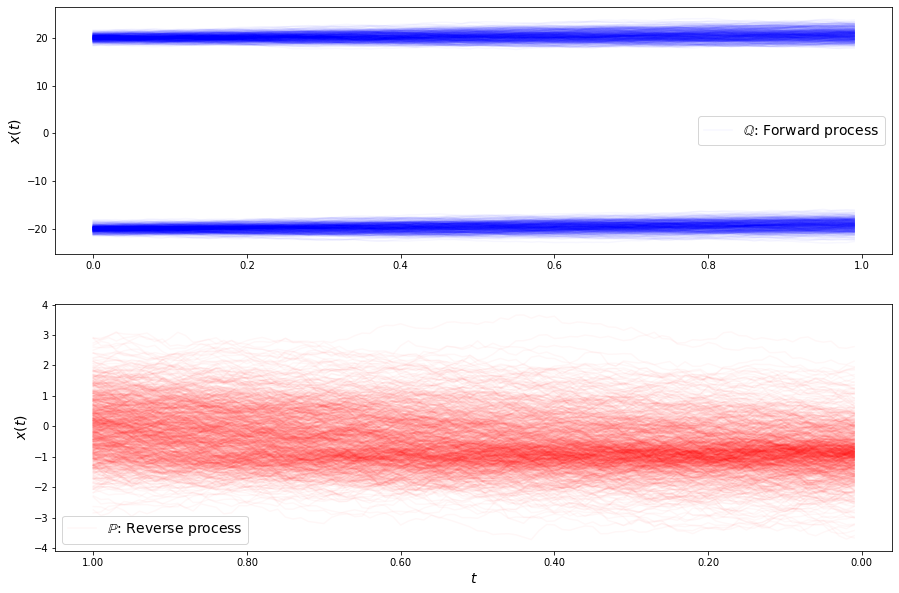

loss b 6.47772667611244
loss b 6.430023904450836
loss b 6.468396248591941
loss b 6.459040776801723
loss b 6.484232998549959
loss b 6.45626848329511
loss b 6.481585204969171
loss b 6.494614434485109
loss b 6.451228301209432
loss b 6.528524176119628
loss b 6.513573598650111
loss b 6.550261117084892
loss b 6.5174097652562075
loss b 6.5334591219492575
loss b 6.560783236955348
loss b 6.563210359704868
loss b 6.558449295558806
loss b 6.558361745659897
loss b 6.59716134595919
loss b 6.588727376177418
loss b 6.597393638101282
loss b 6.62267639601264
loss b 6.605604715016046
loss b 6.622497393433908
loss b 6.6602584456390295
loss b 6.6220426884279515
loss b 6.644848533850894
loss b 6.668962143987458
loss b 6.634504580233743
loss b 6.649895687043254
loss f 7.110797165999907
loss f 7.15345380903883
loss f 7.210828603441575
loss f 7.25511059069018
loss f 7.304833301924336
loss f 7.341186171262384
loss f 7.380033056784783
loss f 7.412510581049397
loss f 7.449947363134798
loss f 7.460913472226993
lo

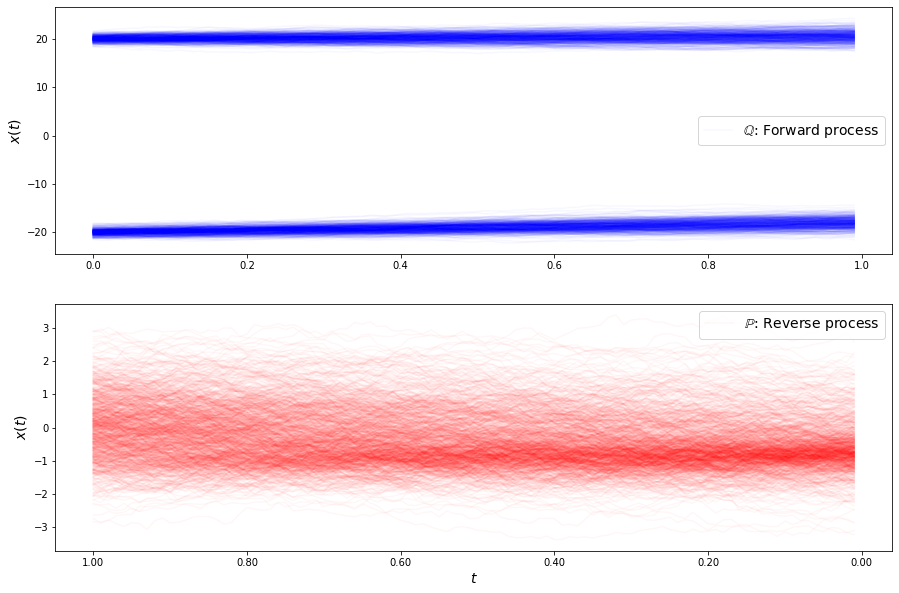

loss b 6.457130696802285
loss b 6.42027095183107
loss b 6.440485395354699
loss b 6.470098803970131
loss b 6.504128005212093
loss b 6.464018147728374
loss b 6.446145308972457
loss b 6.493879596010194
loss b 6.513003121921752
loss b 6.470825551676129
loss b 6.470626388353278
loss b 6.523629213958371
loss b 6.516318133598221
loss b 6.446814461227925
loss b 6.470547573491231
loss b 6.463236556768729
loss b 6.555897392996324
loss b 6.467217295187406
loss b 6.528163577090148
loss b 6.462810256432186
loss b 6.490316639661851
loss b 6.484425066442333
loss b 6.523843452974487
loss b 6.519901699801821
loss b 6.51011793147044
loss b 6.5179090250181915
loss b 6.47445829922592
loss b 6.51034133436404
loss b 6.506134370951899
loss b 6.509730458343632
loss f 8.772663631730302
loss f 8.833157771074793
loss f 8.900557432544291
loss f 8.952481879944596
loss f 9.017340370554003
loss f 9.079475357839813
loss f 9.138971885517817
loss f 9.19298567460958
loss f 9.266395256133015
loss f 9.311700850138697
loss

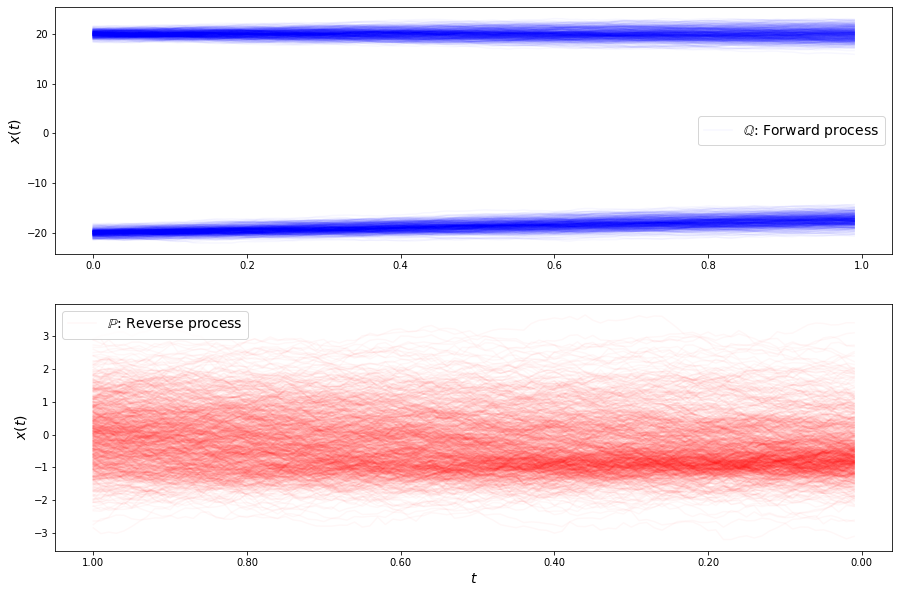

loss b 6.410995988835501
loss b 6.328427095914869
loss b 6.4324855126051155
loss b 6.357587793609449
loss b 6.367075123564458
loss b 6.3869335764554345
loss b 6.363558401444546
loss b 6.366480332155132
loss b 6.378306372869251
loss b 6.380378931508254
loss b 6.38559475326283
loss b 6.34800871732789
loss b 6.392124919216829
loss b 6.342719515928658
loss b 6.346480515178688
loss b 6.361501667745422
loss b 6.3103813092310315
loss b 6.372958627484573
loss b 6.353551118423869
loss b 6.343000805483367
loss b 6.31950779135294
loss b 6.383688823454725
loss b 6.2799335816001225
loss b 6.356475650988034
loss b 6.307459780748578
loss b 6.356365428409776
loss b 6.3557943180927605
loss b 6.355092714142414
loss b 6.349794720499336
loss b 6.312208163829939
loss f 10.63796000183262
loss f 10.691875635755865
loss f 10.748798569653214
loss f 10.794939933745217
loss f 10.850919113138
loss f 10.910178664638241
loss f 10.953863698776713
loss f 11.008647699690087
loss f 11.052672740873053
loss f 11.09365378

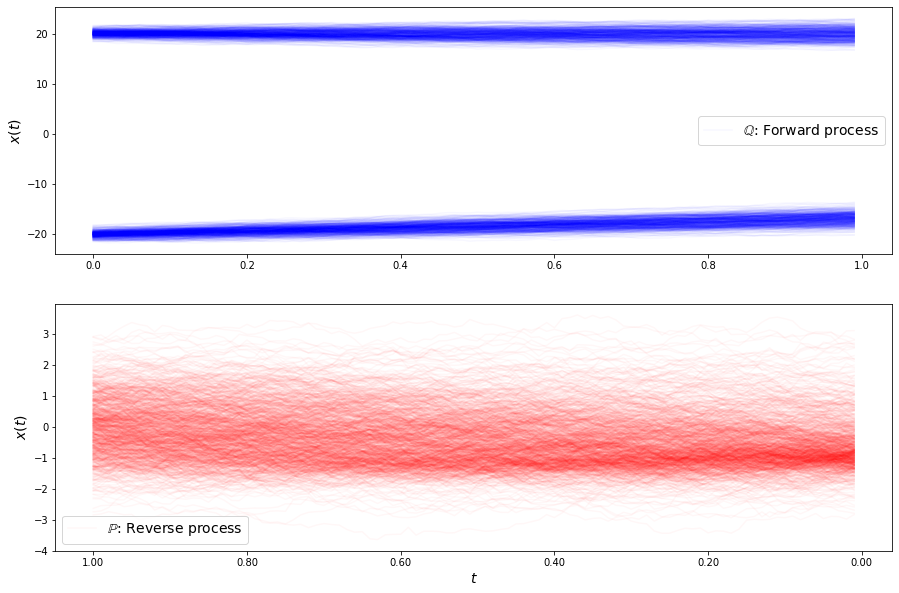

loss b 6.23303331581906
loss b 6.240872999094336
loss b 6.2555483189089305
loss b 6.254702644235536
loss b 6.317461521130851
loss b 6.315948465593464
loss b 6.2660265932345425
loss b 6.249924967162794
loss b 6.231111025991157
loss b 6.254108012721918
loss b 6.24784289087435
loss b 6.259949797190006
loss b 6.228198849665501
loss b 6.227759433448216
loss b 6.1791335084792465
loss b 6.224875020949105
loss b 6.224658336960925
loss b 6.237643394489213
loss b 6.1889247666823355
loss b 6.243343323267793
loss b 6.236460233030175
loss b 6.165635403338866
loss b 6.217664285466818
loss b 6.208083050243203
loss b 6.209678383790827
loss b 6.17517077073486
loss b 6.21417269665751
loss b 6.217913717696043
loss b 6.164955162623657
loss b 6.163566888163321
loss f 9.58663372082892
loss f 9.585996479625898
loss f 9.59003454994222
loss f 9.611949664925186
loss f 9.620552094114732
loss f 9.6376303165354
loss f 9.655676580782103
loss f 9.673517230819497
loss f 9.692321118451046
loss f 9.712586707709326
loss

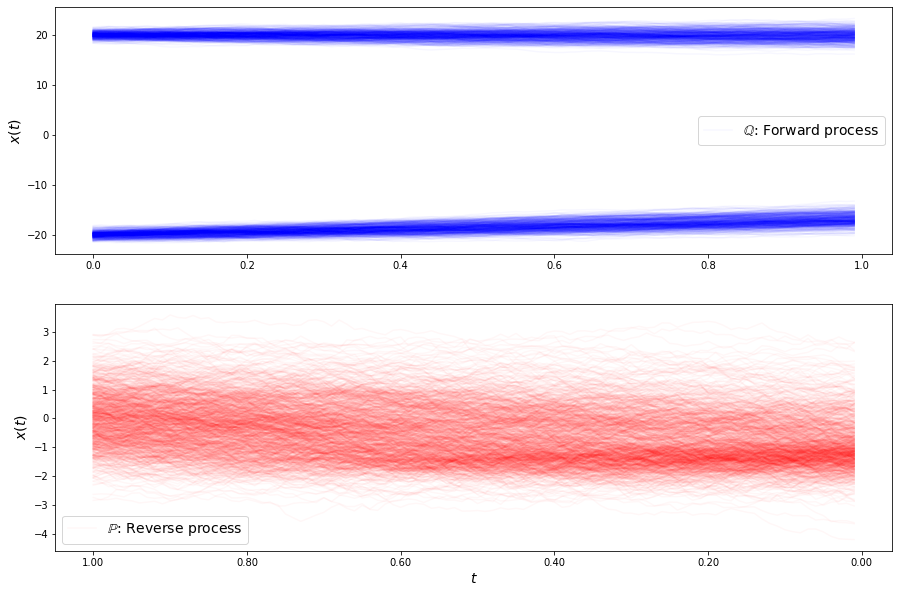

loss b 6.201247475853711
loss b 6.161608441127441
loss b 6.159973847706456
loss b 6.1131826598011045
loss b 6.160910639020765
loss b 6.093087711905437
loss b 6.159395810919677
loss b 6.118423543802166
loss b 6.142391115533653
loss b 6.100679071735098
loss b 6.121352335690116
loss b 6.094582558693984
loss b 6.121768102370037
loss b 6.139358953946036
loss b 6.127128232132933
loss b 6.077426859597482
loss b 6.085696122154385
loss b 6.123517679689548
loss b 6.081480222899003
loss b 6.10056052770027
loss b 6.0806858265960475
loss b 6.129113729478253
loss b 6.093477243818926
loss b 6.105540472347979
loss b 6.07192166411669
loss b 6.1110733365833925
loss b 6.158260561909978
loss b 6.130024932066234
loss b 6.129279284137347
loss b 6.122981387954764
loss f 8.626098516941962
loss f 8.567540802225434
loss f 8.512874661841716
loss f 8.458554137177202
loss f 8.385783603749704
loss f 8.318922183308773
loss f 8.245294325876277
loss f 8.175452671841851
loss f 8.106423348583558
loss f 8.037291908148019

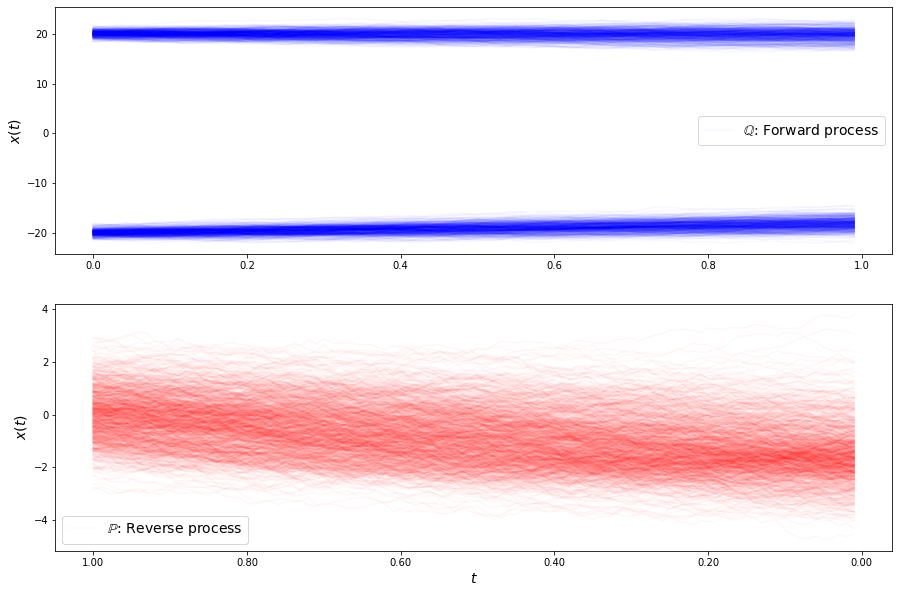

loss b 6.1379022522307
loss b 6.141184568226807
loss b 6.162729230238546
loss b 6.120025060711342
loss b 6.167345550731566
loss b 6.144454471088455
loss b 6.207294197553552
loss b 6.196656354052534
loss b 6.207397365076879
loss b 6.230432550679067
loss b 6.249587235916482
loss b 6.247272588907352
loss b 6.264180835994127
loss b 6.315254460672101
loss b 6.324737963962325
loss b 6.266152445770136
loss b 6.3302712192067165
loss b 6.324216202965926
loss b 6.325077873433521
loss b 6.356660037159296
loss b 6.3524470937172905
loss b 6.36446198447442
loss b 6.398229939717346
loss b 6.378487352824703
loss b 6.437396273963598
loss b 6.422491055063591
loss b 6.45232284813805
loss b 6.4085343700764374
loss b 6.428190201026578
loss b 6.442715643147506
loss f 6.540823845813472
loss f 6.533920902480294
loss f 6.524937394759575
loss f 6.5188550751391485
loss f 6.5244118784466165
loss f 6.5069678433912514
loss f 6.495588684740916
loss f 6.497347997748301
loss f 6.49366388034905
loss f 6.476897809325292

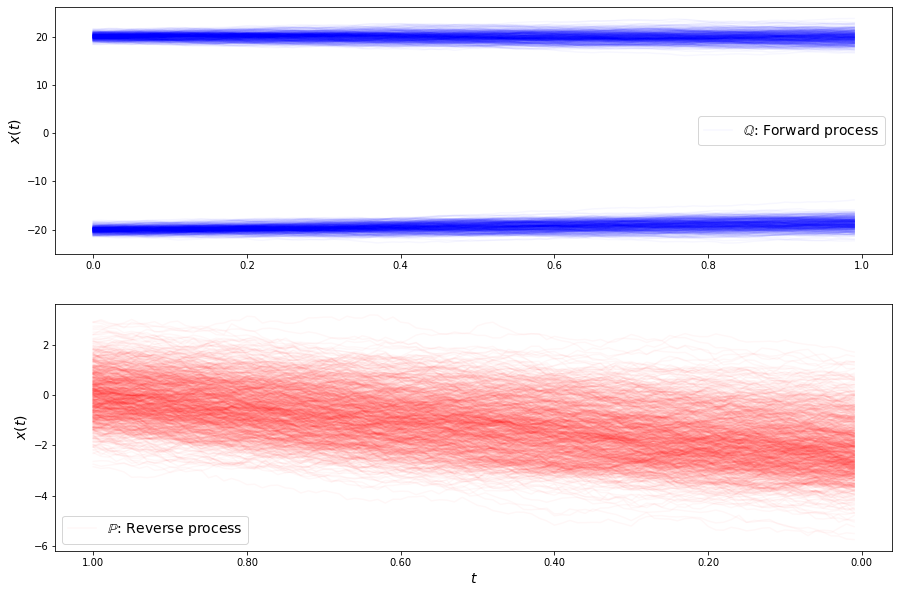

loss b 6.392026502870678
loss b 6.379859313897283
loss b 6.479243431976864
loss b 6.452676049197961
loss b 6.441882962658586
loss b 6.4849540819971585
loss b 6.538219781295455
loss b 6.496546260438895
loss b 6.512340299627701
loss b 6.540387285007163
loss b 6.550591551240859
loss b 6.520471706303793
loss b 6.5671480116758465
loss b 6.550646917555063
loss b 6.537007421681757
loss b 6.592318477322061
loss b 6.638172046610272
loss b 6.593557791255957
loss b 6.611610467142307
loss b 6.615286056058483
loss b 6.638878547423213
loss b 6.678803730061515
loss b 6.665813661440024
loss b 6.69047861480193
loss b 6.694710812053479
loss b 6.66046714980183
loss b 6.696704252603542
loss b 6.671994112440023
loss b 6.7087054185285115
loss b 6.722669013138857
loss f 6.235950340733859
loss f 6.227025164458578
loss f 6.240493918089588
loss f 6.232255717907164
loss f 6.251861623446435
loss f 6.2450238481843225
loss f 6.246305340195472
loss f 6.251042495513925
loss f 6.253807187595073
loss f 6.24444568713932

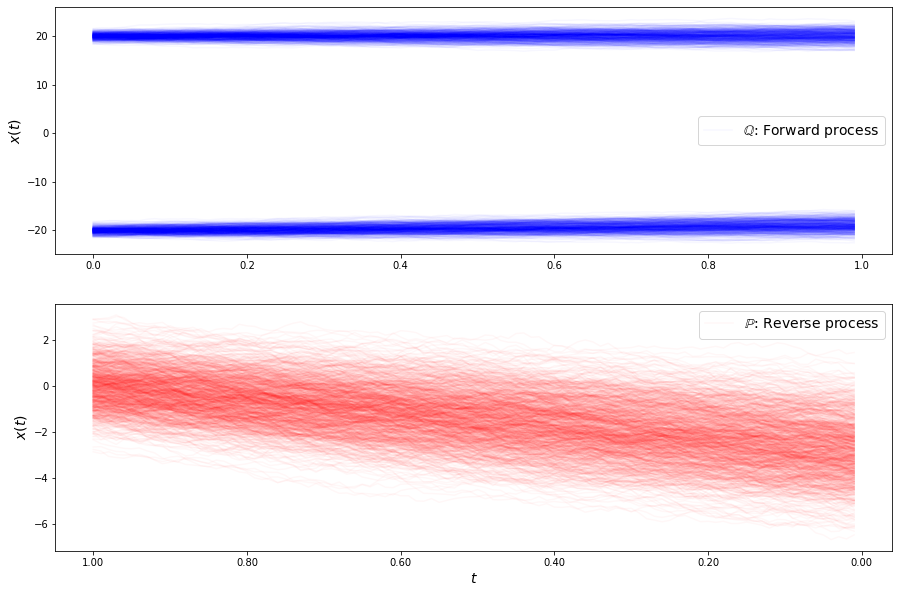

loss b 6.566073988517872
loss b 6.556137318767797
loss b 6.582154901088087
loss b 6.589387417624651
loss b 6.61585483269178
loss b 6.617428459601382
loss b 6.633168887195856
loss b 6.667325243868686
loss b 6.6486825218532015
loss b 6.6701955785850116
loss b 6.672192941951397
loss b 6.662083954228107
loss b 6.723396146820835
loss b 6.69366967071699
loss b 6.7492364209095
loss b 6.77655815374988
loss b 6.72365006406283
loss b 6.776248034102942
loss b 6.833777907939569
loss b 6.818927531008028
loss b 6.826725909830855
loss b 6.794307523827197
loss b 6.832775354389937
loss b 6.873255350159304
loss b 6.8966581031052785
loss b 6.8692165265565
loss b 6.861200933661664
loss b 6.89896569822806
loss b 6.925381566164256
loss b 6.885465610999812
loss f 6.553293160918951
loss f 6.5374464147586675
loss f 6.538018777648757
loss f 6.536482448812049
loss f 6.538578048850921
loss f 6.535687817545701
loss f 6.545938915084872
loss f 6.537263206142066
loss f 6.528831198289899
loss f 6.532420600920576
loss 

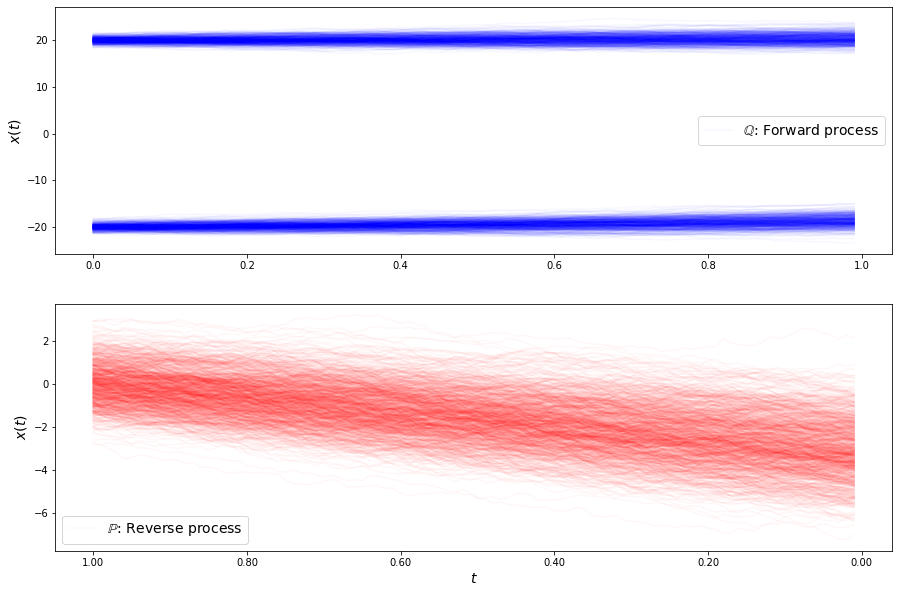

loss b 6.541863086759479
loss b 6.502245060256848
loss b 6.543792863514147
loss b 6.568777705705053
loss b 6.557137931975883
loss b 6.541354687912575
loss b 6.580513998427032
loss b 6.578646160227765
loss b 6.5906465262141305
loss b 6.602343732424358
loss b 6.630091239955388
loss b 6.612601687147605
loss b 6.6033283373108755
loss b 6.6069189904863155
loss b 6.63413061293099
loss b 6.631196665377338
loss b 6.6641161175143
loss b 6.673308209425573
loss b 6.641112262579755
loss b 6.661256332571237
loss b 6.702443729867746
loss b 6.685190107567316
loss b 6.677175125076929
loss b 6.683092405657048
loss b 6.694037497886184
loss b 6.685717154940304
loss b 6.707832261308754
loss b 6.702114904803997
loss b 6.711414544547474
loss b 6.6890308980428435
loss f 6.4453737213034215
loss f 6.438735574055749
loss f 6.421245697463473
loss f 6.413495364529345
loss f 6.416416441956487
loss f 6.377931995905066
loss f 6.3736142025941085
loss f 6.352466561255356
loss f 6.342850475344844
loss f 6.3261223130260

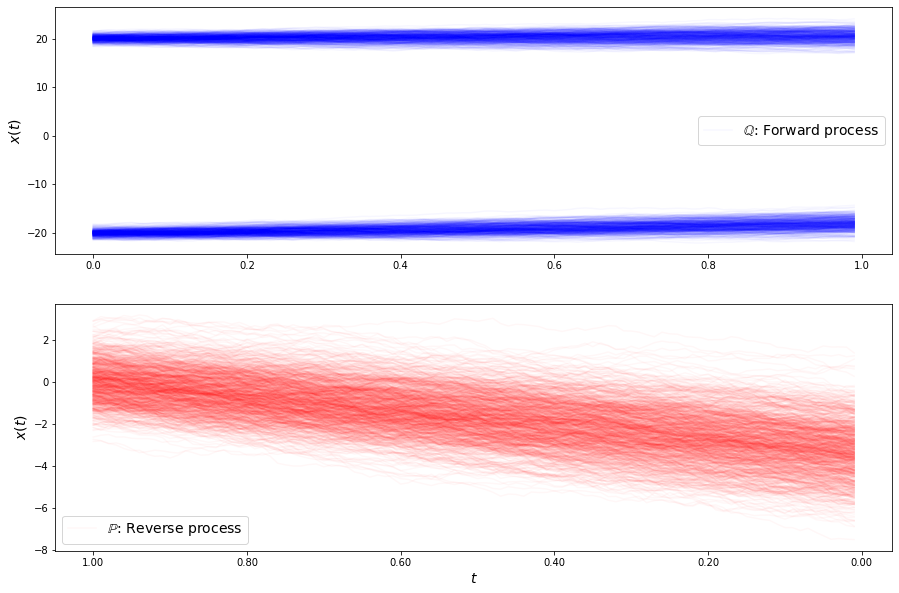

loss b 6.193919763389148
loss b 6.204721211742451
loss b 6.190538271172791
loss b 6.196119348564212
loss b 6.203666337024352
loss b 6.181285834766836
loss b 6.213713672578415
loss b 6.2683902438538786
loss b 6.225787953524473
loss b 6.1896766019381655
loss b 6.241096623481598
loss b 6.205461690318793
loss b 6.235901701305179
loss b 6.232262856351451
loss b 6.19638452803728
loss b 6.196070127701959
loss b 6.190978179529637
loss b 6.184673426824503
loss b 6.208239734017784
loss b 6.214812490089993
loss b 6.244952974266429
loss b 6.23062547828395
loss b 6.201989030083442
loss b 6.227566379788943
loss b 6.223439236343725
loss b 6.234709682005693
loss b 6.2075778359362666
loss b 6.21215072414028
loss b 6.204346462048887
loss b 6.2004694048665465
loss f 5.768592504547531
loss f 5.756643826092532
loss f 5.745323804079477
loss f 5.739452939769843
loss f 5.7264302210876386
loss f 5.729086280484325
loss f 5.7165309657664825
loss f 5.705861602710435
loss f 5.699729803885004
loss f 5.7062292990368

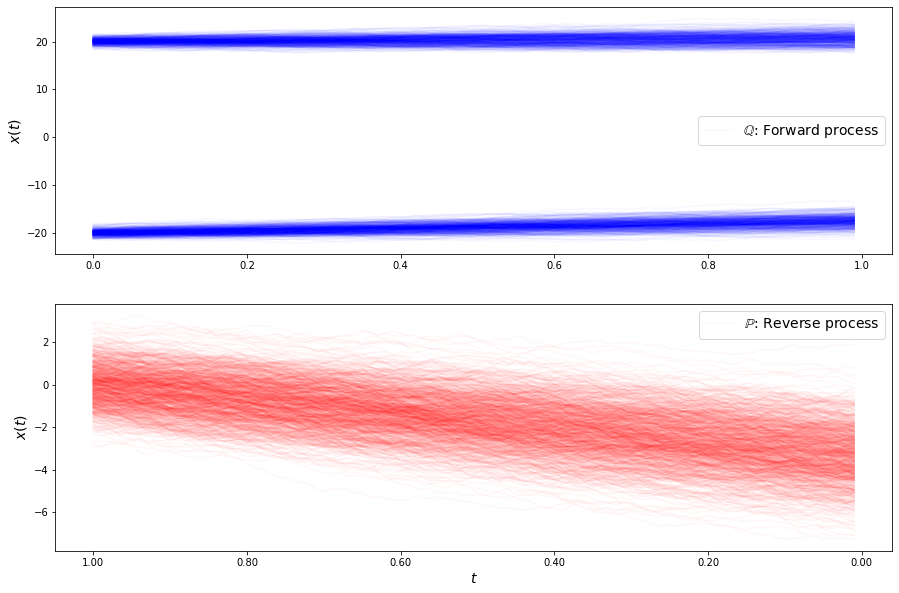

loss b 5.745876822014073
loss b 5.720766772442044
loss b 5.725498924646864
loss b 5.737896605006916
loss b 5.736782155392295
loss b 5.754106761916425
loss b 5.703429519075583
loss b 5.7268455323443925
loss b 5.739087870495961
loss b 5.726151177587116
loss b 5.735055408854047
loss b 5.733872007975445
loss b 5.710988419470899
loss b 5.703518477224256
loss b 5.709970057192143
loss b 5.694015519201159
loss b 5.70276123228353
loss b 5.710853691015731
loss b 5.7101568468248
loss b 5.7077131793886515
loss b 5.691862296980993
loss b 5.7112636905847545
loss b 5.7101104578207345
loss b 5.692564139235721
loss b 5.669377875501334
loss b 5.687045416733165
loss b 5.718567939644709
loss b 5.698678092566349
loss b 5.693119865057712
loss b 5.658310773240454
loss f 5.788793184067884
loss f 5.789203670949684
loss f 5.799146557939089
loss f 5.7951215536352025
loss f 5.812210372408203
loss f 5.81284516128716
loss f 5.818903278770952
loss f 5.822105668288934
loss f 5.831438875360489
loss f 5.826389679282187

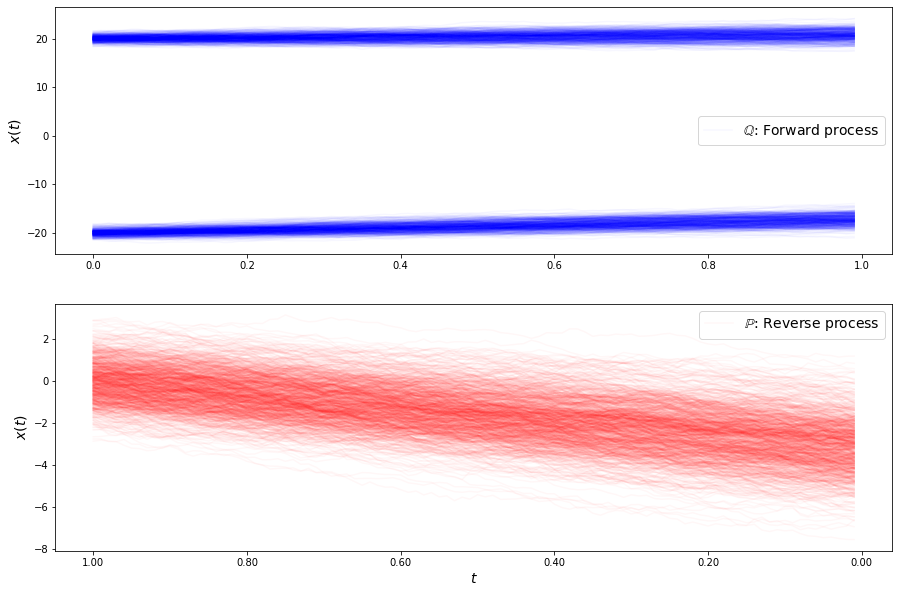

loss b 5.460261061497491
loss b 5.414043493632589
loss b 5.43583725979003
loss b 5.42705846290592
loss b 5.4373112876359695
loss b 5.446221418886076
loss b 5.4506265597641566
loss b 5.463244255180637
loss b 5.43680064721506
loss b 5.4366497182895435
loss b 5.433321333889627
loss b 5.43493134450738
loss b 5.445214572132536
loss b 5.415610902153871
loss b 5.448397324675609
loss b 5.434809599585779
loss b 5.443260616990251
loss b 5.4381663303714465
loss b 5.437998159408664
loss b 5.432326684609391
loss b 5.432965049321199
loss b 5.426210665688553
loss b 5.425440716676988
loss b 5.42578528218269
loss b 5.421640307978981
loss b 5.438501589503208
loss b 5.444640073221747
loss b 5.433682239704372
loss b 5.4402194905968
loss b 5.451989171829869
loss f 6.104040733714331
loss f 6.108960590855364
loss f 6.109103218502078
loss f 6.1072555486709605
loss f 6.114158426993527
loss f 6.113617448870251
loss f 6.121369123214379
loss f 6.120915368059008
loss f 6.124773337699175
loss f 6.12113273872123
los

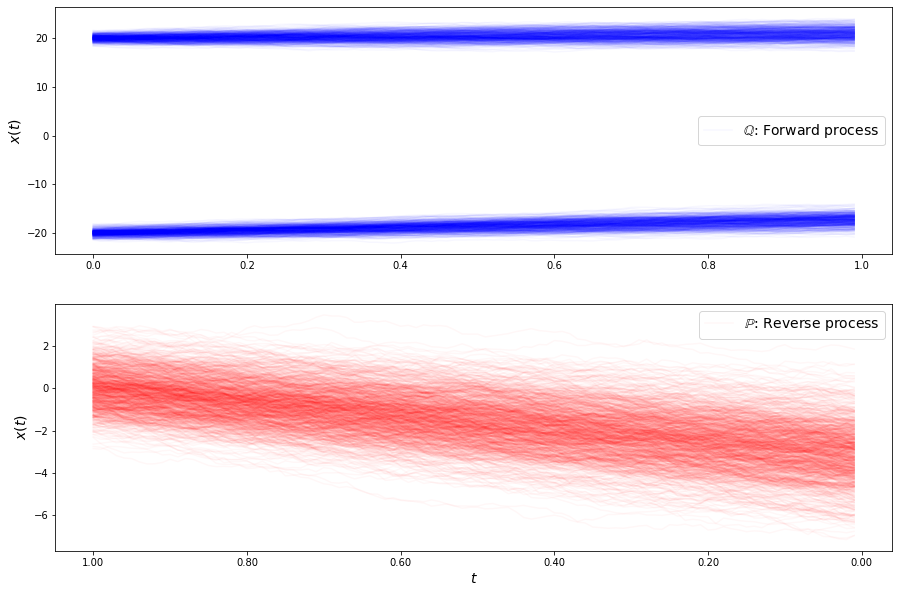

loss b 5.483313678186265
loss b 5.47910037697091
loss b 5.505429523221648
loss b 5.51986936115049
loss b 5.49665522599679
loss b 5.473068713704333
loss b 5.480225182352841
loss b 5.495260428466053
loss b 5.505667515056993
loss b 5.4841212253421965
loss b 5.509695489094357
loss b 5.496235335478995
loss b 5.5069047907548025
loss b 5.498706384793268
loss b 5.503389337960238
loss b 5.50320633321834
loss b 5.504517555997682
loss b 5.5044517925461705
loss b 5.506282725592968
loss b 5.503618307793583
loss b 5.528580653799635
loss b 5.487322697016916
loss b 5.494535972295743
loss b 5.490397418296878
loss b 5.5249616474366885
loss b 5.494371859876959
loss b 5.510016004996657
loss b 5.527380589612868
loss b 5.5078192232023
loss b 5.525994488147687
loss f 6.172005336987008
loss f 6.165652565372391
loss f 6.165711494919759
loss f 6.1590194704624315
loss f 6.16317022219794
loss f 6.162282598133838
loss f 6.153914850779891
loss f 6.155957090329426
loss f 6.151717011995214
loss f 6.148111341560472
lo

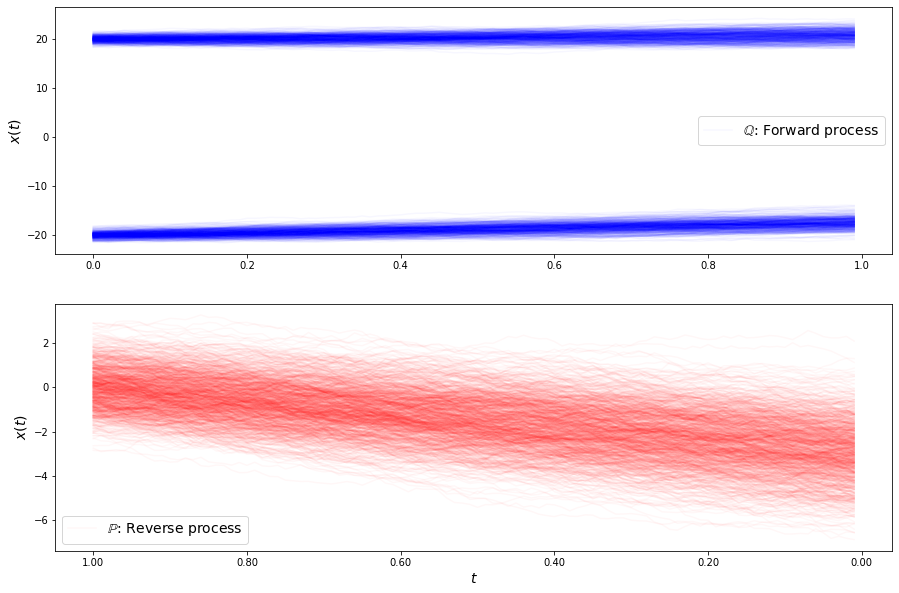

loss b 5.768042678306853
loss b 5.7710754685497365
loss b 5.767796779482101
loss b 5.77437572067302
loss b 5.793454733373563
loss b 5.782552363175233
loss b 5.753500452166171
loss b 5.793097855094408
loss b 5.802667709401796
loss b 5.779522027137936
loss b 5.798678280499787
loss b 5.794824597613594
loss b 5.7938575997559125
loss b 5.810274418314709
loss b 5.799366670006822
loss b 5.804736073379549
loss b 5.800975941634904
loss b 5.7936433498271604
loss b 5.803295132736123
loss b 5.794498790729922
loss b 5.808837736560935
loss b 5.786776048560914
loss b 5.808632192299231
loss b 5.8027528670554185
loss b 5.79979223136547
loss b 5.790404401065808
loss b 5.800238281809911
loss b 5.810043242574069
loss b 5.8204078788343425
loss b 5.808866348977208
loss f 6.0233977152133225
loss f 6.0174277639664835
loss f 6.016342842543319
loss f 6.00649251877979
loss f 5.997312818773924
loss f 5.9915561789552445
loss f 5.992243974125243
loss f 5.977229421858818
loss f 5.969887449160643
loss f 5.96592116808

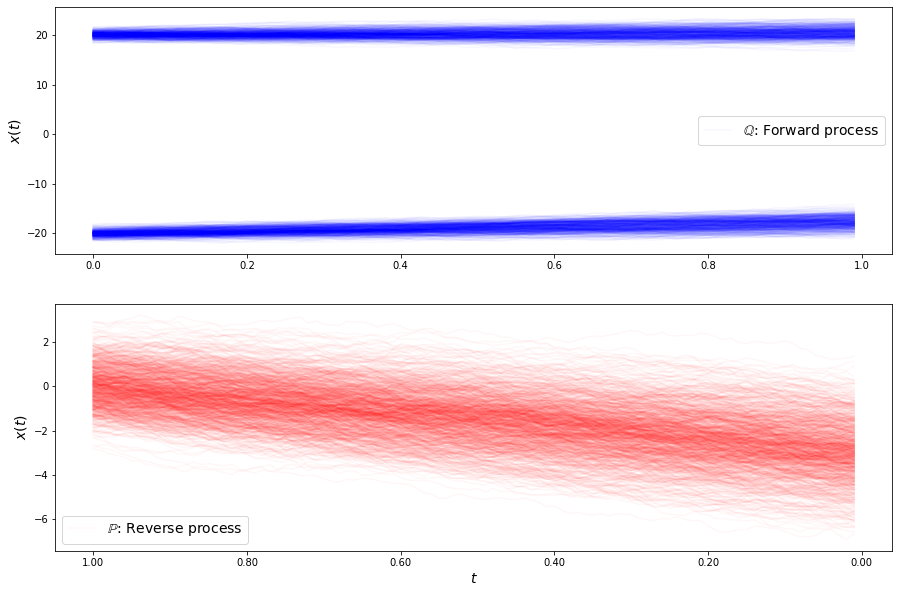

loss b 6.107287615571125
loss b 6.114200064517901
loss b 6.123331417787888
loss b 6.115561865376171
loss b 6.1225029299583955
loss b 6.136130304115534
loss b 6.1181555138719155
loss b 6.120183789503044
loss b 6.128349801349403
loss b 6.126110880286622
loss b 6.1323456718169504
loss b 6.122897949688395
loss b 6.128805947975767
loss b 6.112850583391461
loss b 6.094017603582137
loss b 6.110896177811176
loss b 6.105412891669519
loss b 6.112427155439053
loss b 6.11855658791932
loss b 6.123722583296863
loss b 6.099013273273894
loss b 6.12604797234579
loss b 6.122110529723598
loss b 6.103701042904768
loss b 6.1066552671099315
loss b 6.125038794116952
loss b 6.09170711841365
loss b 6.079825285444097
loss b 6.097233224351515
loss b 6.093692100771398
loss f 5.853411951589725
loss f 5.847541662733447
loss f 5.835121179780759
loss f 5.831414212287107
loss f 5.823720832577053
loss f 5.83097660086079
loss f 5.816932808391837
loss f 5.821810530978778
loss f 5.811322652375785
loss f 5.8164447877341185

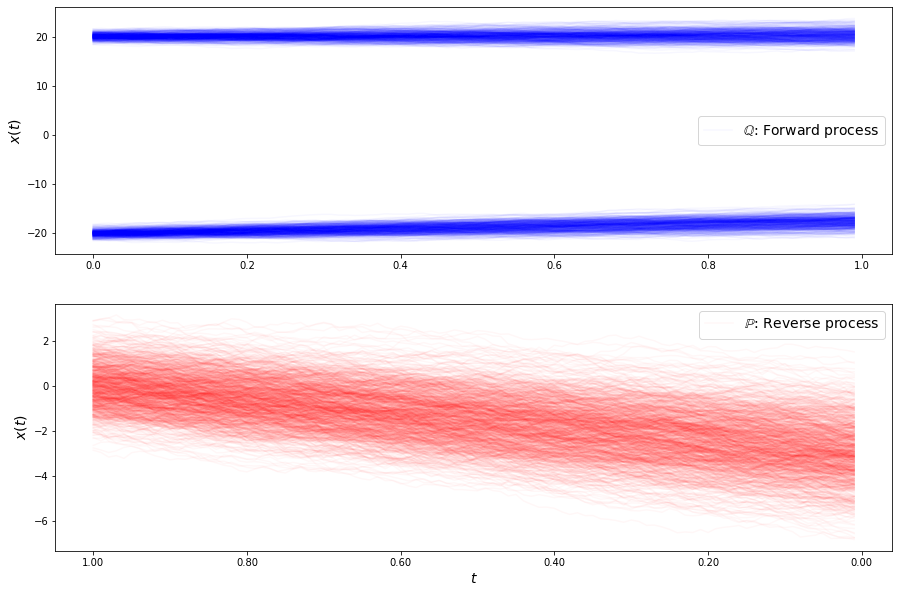

loss b 6.321666937151829
loss b 6.324671722024128
loss b 6.33075295169739
loss b 6.331536507268248
loss b 6.307199222604511
loss b 6.313720998391358
loss b 6.331079829427716
loss b 6.304752188332829
loss b 6.313650809042228
loss b 6.303097124077603
loss b 6.315395026732791
loss b 6.295712215993093
loss b 6.3124416980494376
loss b 6.296699836589429
loss b 6.275743456317208
loss b 6.297206845499136
loss b 6.264341156301147
loss b 6.279068154127337
loss b 6.287432807835998
loss b 6.2610785434481615
loss b 6.254489195444928
loss b 6.240443253493069
loss b 6.239038053456234
loss b 6.258167660569018
loss b 6.248475500813673
loss b 6.2331028621947
loss b 6.219395317307159
loss b 6.203012251857879
loss b 6.183735983749151
loss b 6.205371871286973
loss f 5.762864363923733
loss f 5.782789548308446
loss f 5.7571331093768
loss f 5.770482982823355
loss f 5.769261877229112
loss f 5.763556668592802
loss f 5.7641169371030845
loss f 5.764128267285544
loss f 5.763341010233118
loss f 5.7659110994428255
l

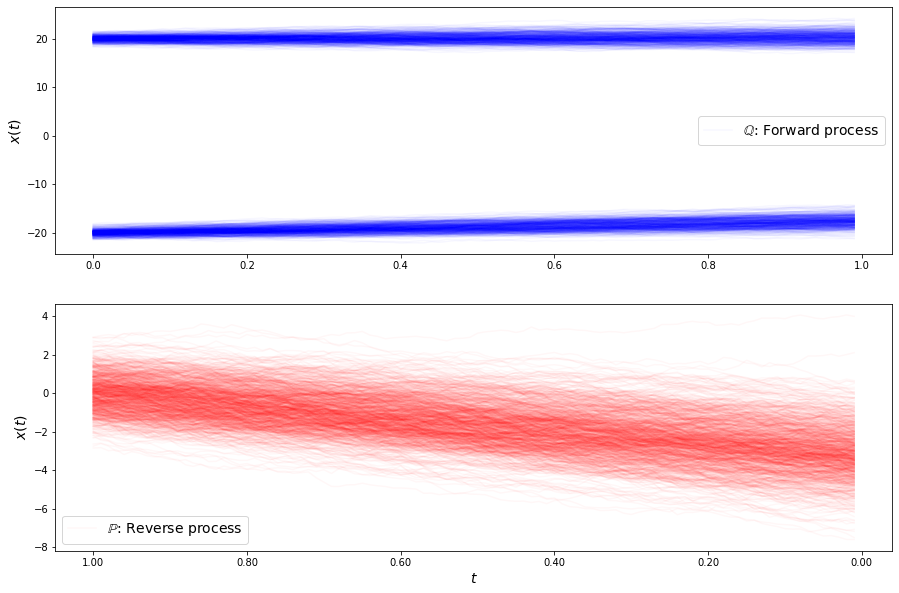

loss b 6.344759510646886
loss b 6.3258978639753725
loss b 6.329901349344962
loss b 6.308943851511462
loss b 6.31121289202854
loss b 6.308096360803247
loss b 6.296406282828853
loss b 6.277457968356613
loss b 6.279060779631944
loss b 6.271482531606325
loss b 6.2509251272830095
loss b 6.254778062634737
loss b 6.241957495084009
loss b 6.235354234192361
loss b 6.240282187427258
loss b 6.223401824886642
loss b 6.203665307725984
loss b 6.19976473636474
loss b 6.192715489810774
loss b 6.192969177987278
loss b 6.169075839750894
loss b 6.164552584769567
loss b 6.176266590253104
loss b 6.142121295248954
loss b 6.128702501091949
loss b 6.131633062331242
loss b 6.109008960988561
loss b 6.120187181459379
loss b 6.093577664342928
loss b 6.077564410209517
loss f 5.708960072315863
loss f 5.701954805138002
loss f 5.7094932376843905
loss f 5.703090906228065
loss f 5.694485589658352
loss f 5.697010849266074
loss f 5.706942723862979
loss f 5.706273670437028
loss f 5.698096812814251
loss f 5.691623480977677

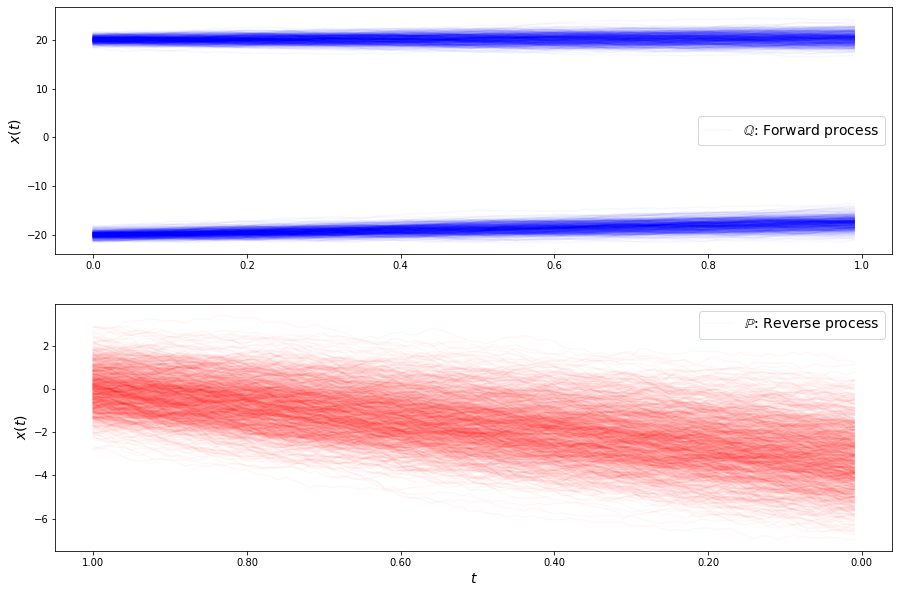

loss b 6.1328787078556655
loss b 6.12654013892292
loss b 6.103776068999617
loss b 6.097063202934607
loss b 6.070141224408353
loss b 6.073611793845631
loss b 6.063106401245362
loss b 6.057492192654379
loss b 6.040182516977532
loss b 6.028155107494968
loss b 6.015229766748976
loss b 6.019768426862565
loss b 6.00672987259126
loss b 5.996949516103341
loss b 5.976714373656794
loss b 5.958757671292463
loss b 5.949486698685671
loss b 5.935466953295215
loss b 5.937371119555915
loss b 5.943783713956445
loss b 5.914707898799629
loss b 5.892334553317653
loss b 5.890683685194331
loss b 5.897386515147489
loss b 5.883090966880543
loss b 5.867272642256681
loss b 5.862935876775188
loss b 5.841472516240403
loss b 5.824974802247726
loss b 5.824518787105121
loss f 5.7863759032636155
loss f 5.789156301549991
loss f 5.7864535029207875
loss f 5.789962688055921
loss f 5.788998508713298
loss f 5.784345275441489
loss f 5.779241464758011
loss f 5.7842311148694705
loss f 5.774258986483631
loss f 5.78110237882426

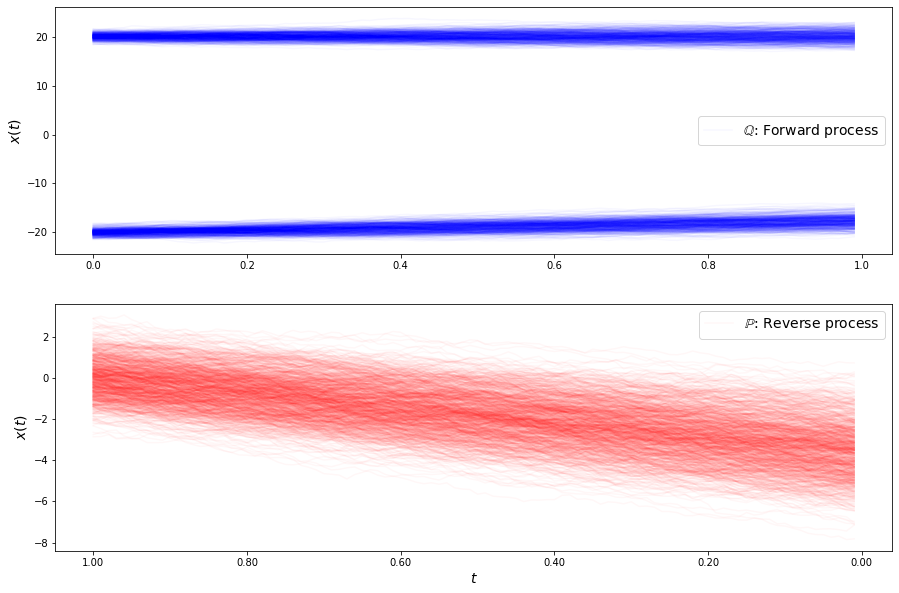

loss b 5.792645520936439
loss b 5.779439560894925
loss b 5.768965050429834
loss b 5.759388852808535
loss b 5.743534307204997
loss b 5.741548059497038
loss b 5.728872705938369
loss b 5.709110220799399
loss b 5.706660552923785
loss b 5.70509814951059
loss b 5.701940081072397
loss b 5.680936425259916
loss b 5.675329587243198
loss b 5.664446069124745
loss b 5.66182455421522
loss b 5.658903387656891
loss b 5.637145593311101
loss b 5.636481768832692
loss b 5.630616473588393
loss b 5.620275456955636
loss b 5.611672816850351
loss b 5.609099963593019
loss b 5.593072335123031
loss b 5.591984377299554
loss b 5.580659262282872
loss b 5.575922665174739
loss b 5.552991552835315
loss b 5.55272084074886
loss b 5.557157012700911
loss b 5.542524202605975
loss f 5.970687072718182
loss f 5.963456431422805
loss f 5.966041933636687
loss f 5.958980053736409
loss f 5.952036312404349
loss f 5.953001106061159
loss f 5.942145009188838
loss f 5.941007171983028
loss f 5.936737783587591
loss f 5.932248411313886
los

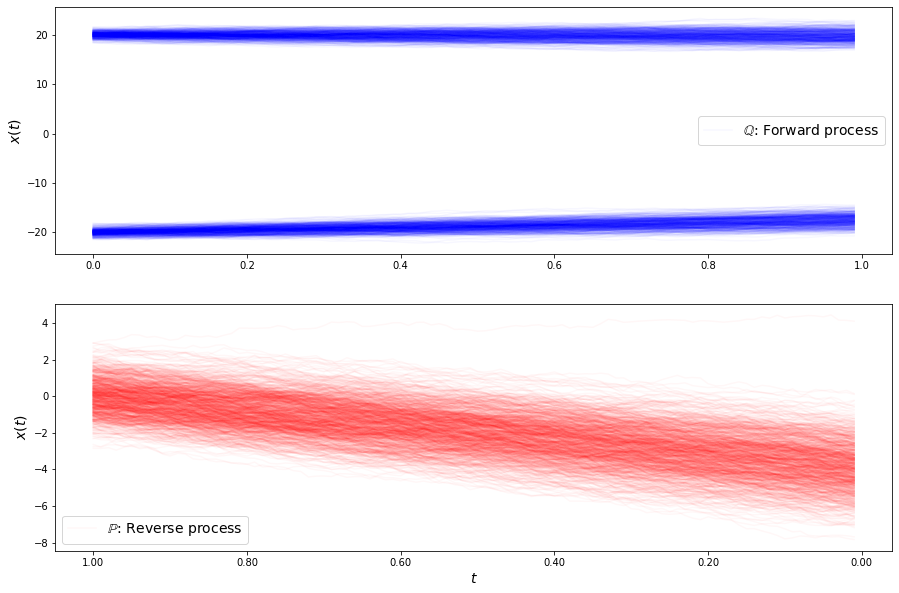

loss b 5.482428840036198
loss b 5.46849967866186
loss b 5.467756340417144
loss b 5.468887077831141
loss b 5.470437207122616
loss b 5.452773506705206
loss b 5.44622286961664
loss b 5.447425613509171
loss b 5.438798096686224
loss b 5.4291613117070785
loss b 5.421876850158058
loss b 5.427305351948616
loss b 5.422315927903745
loss b 5.415847326556725
loss b 5.409867312723294
loss b 5.406170268031418
loss b 5.398701980287865
loss b 5.391090845008631
loss b 5.3975896429220525
loss b 5.400537351655822
loss b 5.382927873370052
loss b 5.38309004850038
loss b 5.385953489610015
loss b 5.376410594688828
loss b 5.373943349448709
loss b 5.377046554292924
loss b 5.361602375750729
loss b 5.366096086345416
loss b 5.362227692063862
loss b 5.360531482598926
loss f 5.78816637323441
loss f 5.783913873700497
loss f 5.781150790864867
loss f 5.7767351117822106
loss f 5.774226353743881
loss f 5.77188449966219
loss f 5.761963573264403
loss f 5.758854562581237
loss f 5.755281587131697
loss f 5.751378036523912
lo

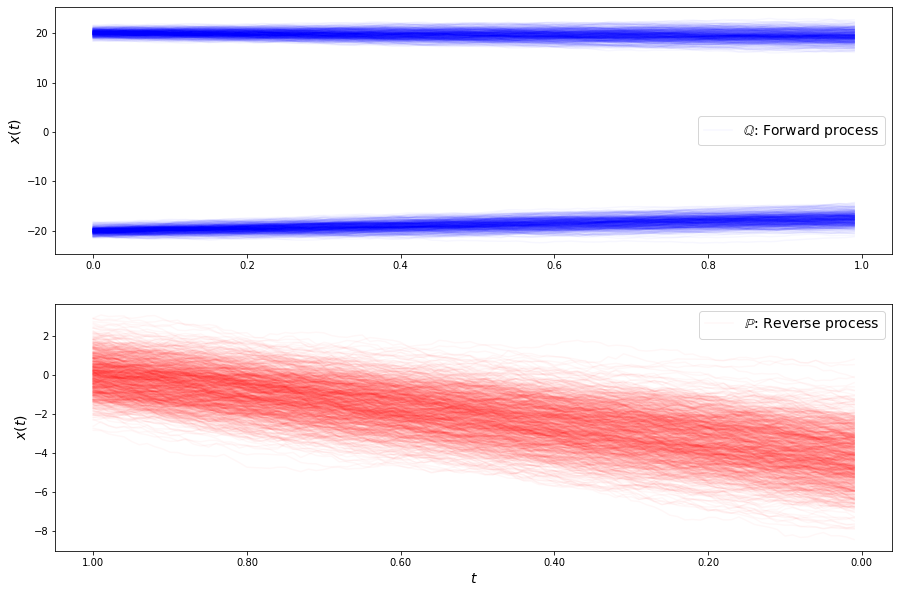

loss b 5.335473543642614
loss b 5.3343108069809855
loss b 5.332669921814808
loss b 5.33365316564168
loss b 5.322879718940805
loss b 5.314435546094078
loss b 5.3204472275728225
loss b 5.334787359801519
loss b 5.330088032550865
loss b 5.313815035087304
loss b 5.321407373092681
loss b 5.32562962628527
loss b 5.32611178904346
loss b 5.324116556637054
loss b 5.325226603618868
loss b 5.3253590625429155
loss b 5.320961422696353
loss b 5.326533104338587
loss b 5.3190402568793616
loss b 5.311393570322317
loss b 5.321465565431999
loss b 5.324578867563731
loss b 5.324679812864759
loss b 5.322446695427833
loss b 5.323402941697358
loss b 5.328190202497764
loss b 5.331695109127719
loss b 5.329449274558861
loss b 5.327797457629037
loss b 5.330141770782474
loss f 5.868013121619895
loss f 5.861683127346437
loss f 5.868033544552957
loss f 5.868911953513614
loss f 5.864665240239425
loss f 5.871284264161087
loss f 5.864828783002027
loss f 5.862417736640359
loss f 5.86565211961941
loss f 5.8673303333742854

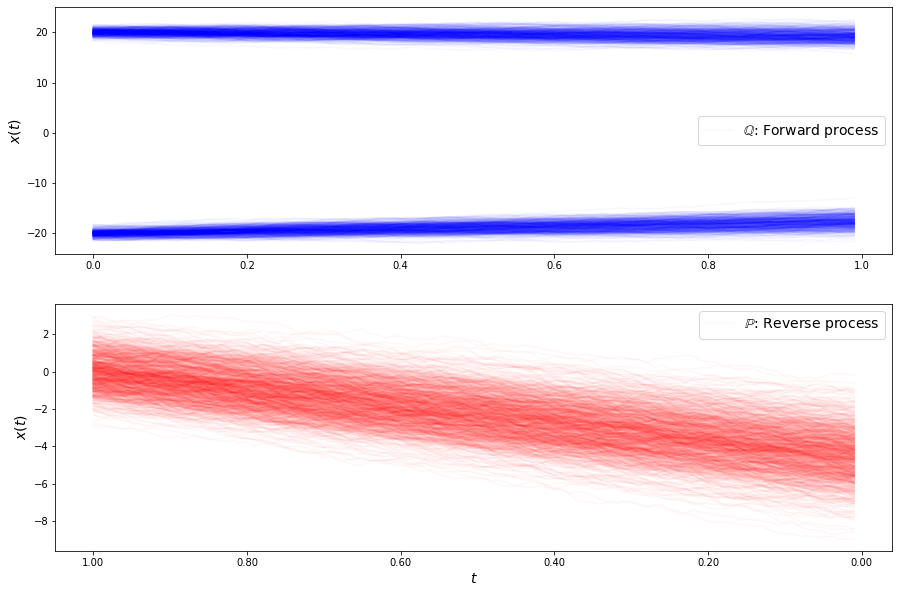

loss b 5.343605590502155
loss b 5.354465397886892
loss b 5.337675398786195
loss b 5.351672379322097
loss b 5.3464988241984805
loss b 5.350377934900064
loss b 5.353786848367575
loss b 5.3561990302626725
loss b 5.344887258875916
loss b 5.360915139625693
loss b 5.356431280326306
loss b 5.362780922909334
loss b 5.366533933299336
loss b 5.373361213158269
loss b 5.371540835098755
loss b 5.378550464163163
loss b 5.367785507049418
loss b 5.3770585465595335
loss b 5.385585287815999
loss b 5.3757564128777995
loss b 5.392165269574887
loss b 5.381805095643501
loss b 5.39213379660843
loss b 5.397775172667024
loss b 5.393056659905343
loss b 5.405577200706117
loss b 5.4042116235677975
loss b 5.396268596353698
loss b 5.41887224437517
loss b 5.413669109245726
loss f 6.030335976153311
loss f 6.0313892559550055
loss f 6.025255189034689
loss f 6.024991341684527
loss f 6.021847512238977
loss f 6.016619523822903
loss f 6.022578115424484
loss f 6.012502609495912
loss f 6.010946565327133
loss f 6.007970574679

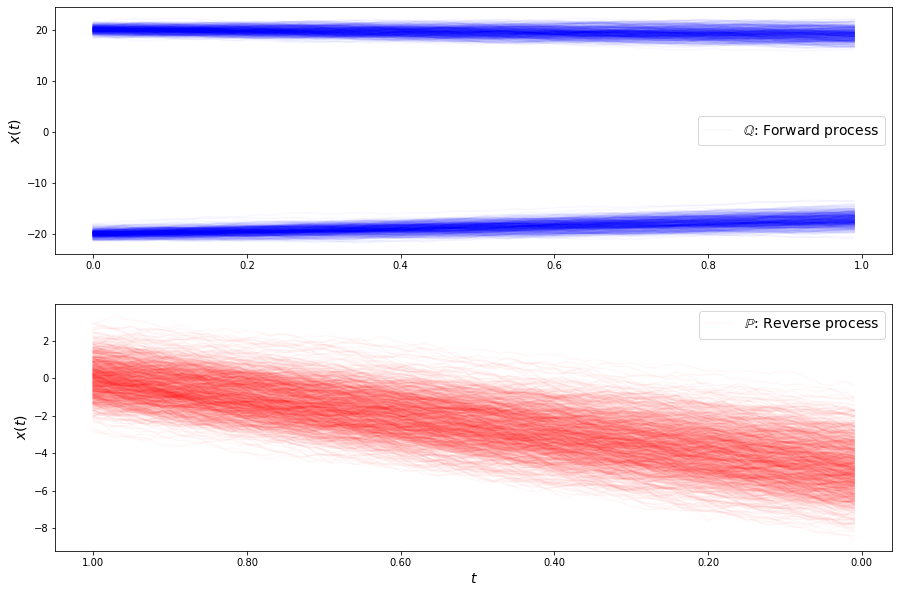

loss b 5.41646095607846
loss b 5.416392134178864
loss b 5.413541601791463
loss b 5.421030751311395
loss b 5.427725577609853
loss b 5.432704069811474
loss b 5.438136689549532
loss b 5.439288394383317
loss b 5.428963562900355
loss b 5.439486494924485
loss b 5.445679557674419
loss b 5.444352521774082
loss b 5.43810853219539
loss b 5.448098974876339
loss b 5.4603045599427285
loss b 5.461610082021042
loss b 5.451604017190958
loss b 5.457156383661831
loss b 5.460640372159916
loss b 5.460681211977238
loss b 5.470989418983921
loss b 5.4672659586110655
loss b 5.463385515618166
loss b 5.464944622539511
loss b 5.493753918091362
loss b 5.479020849224102
loss b 5.473622425477393
loss b 5.473237370313404
loss b 5.4871095656170095
loss b 5.48005907655805
loss f 5.854998730787448
loss f 5.821405386610759
loss f 5.805900854583094
loss f 5.786282716649197
loss f 5.7568951834710305
loss f 5.734340806617991
loss f 5.712255055577677
loss f 5.68283203148936
loss f 5.66839565893501
loss f 5.637642579596691
l

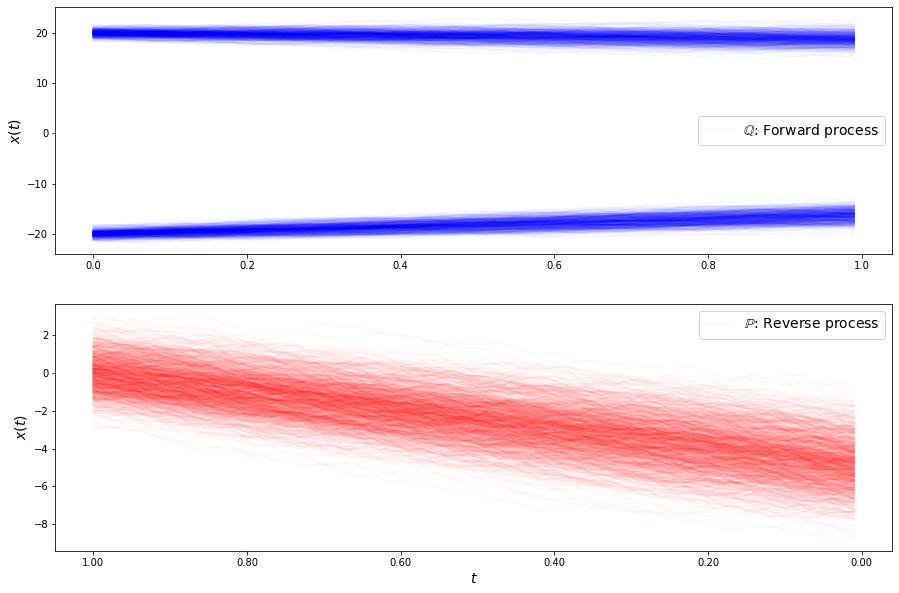

loss b 5.428955395516725
loss b 5.432221539062058
loss b 5.434628180629333
loss b 5.444235642587827
loss b 5.433318255364777
loss b 5.450195906896955
loss b 5.434963560533575
loss b 5.4421832025136565
loss b 5.4409309503526835
loss b 5.455584469794189
loss b 5.4352767529177095
loss b 5.443349562901513
loss b 5.459185671636541
loss b 5.452879608467681
loss b 5.46190237020065
loss b 5.450669624955406
loss b 5.44573394425675
loss b 5.448783560978272
loss b 5.460039737378773
loss b 5.448107760939483
loss b 5.460683569953466
loss b 5.459197185581116
loss b 5.460419826636261
loss b 5.4653362097716744
loss b 5.468396126417131
loss b 5.459844820114803
loss b 5.4669106878196
loss b 5.472086238999371
loss b 5.468878423577783
loss b 5.4744668039533115
loss f 5.403368774979506
loss f 5.40169910992525
loss f 5.401934035952883
loss f 5.389738185993681
loss f 5.3910147590251105
loss f 5.398074471616447
loss f 5.391728439161089
loss f 5.383579774063601
loss f 5.385297775138774
loss f 5.380881275266941

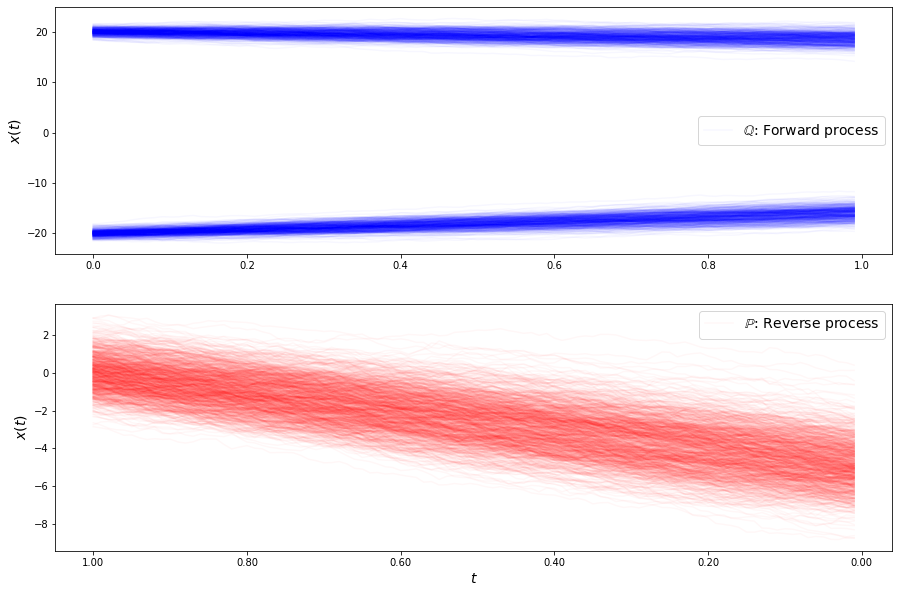

loss b 5.3530759367991525
loss b 5.362440919162633
loss b 5.373882952806717
loss b 5.364540186801611
loss b 5.365828355003565
loss b 5.37233364357352
loss b 5.357933767554895
loss b 5.359555371234484
loss b 5.371395678547065
loss b 5.378141543147851
loss b 5.370940755828259
loss b 5.370806609959932
loss b 5.365602648065311
loss b 5.367234033283243
loss b 5.372795620904044
loss b 5.379619392883035
loss b 5.373010186406546
loss b 5.371021758562191
loss b 5.371564310227225
loss b 5.371463667522751
loss b 5.3765165988811585
loss b 5.376644791300025
loss b 5.38103507597464
loss b 5.385775570274328
loss b 5.381522666554198
loss b 5.38106256245596
loss b 5.374213487613616
loss b 5.37018548627729
loss b 5.378866076689109
loss b 5.386850792786714
loss f 5.3614868646574605
loss f 5.346638806890803
loss f 5.361458700351088
loss f 5.362970998700799
loss f 5.360834051437992
loss f 5.366071202205565
loss f 5.359504784617365
loss f 5.366345668327149
loss f 5.37060478629986
loss f 5.365666539094954
lo

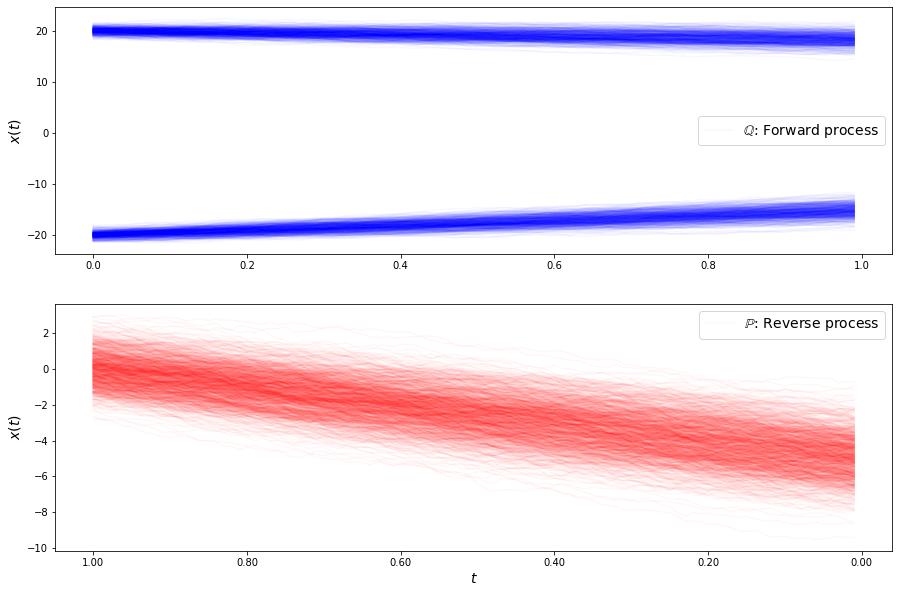

loss b 5.30703986263788
loss b 5.312331118626993
loss b 5.3115704559619035
loss b 5.3190083729317506
loss b 5.310834611546233
loss b 5.3136618803882225
loss b 5.316867014192134
loss b 5.309394225417695
loss b 5.317876785853414
loss b 5.305888314956272
loss b 5.317994286460627
loss b 5.318960156308504
loss b 5.314993124206712
loss b 5.317483288879147
loss b 5.320880904991946
loss b 5.326232912015533
loss b 5.327313188996787
loss b 5.322545802864976
loss b 5.324479529096633
loss b 5.31883664672332
loss b 5.321543179386776
loss b 5.3204549295454076
loss b 5.332904277094224
loss b 5.324594366510289
loss b 5.323203625688403
loss b 5.324588125430259
loss b 5.334405539071369
loss b 5.3473332218951155
loss b 5.332678640451997
loss b 5.334102761290543
loss f 5.476196905801131
loss f 5.474754325248339
loss f 5.486047102953266
loss f 5.501864898368791
loss f 5.499931178962898
loss f 5.513753508807904
loss f 5.520278940422024
loss f 5.524954223756657
loss f 5.532146716311513
loss f 5.5428311786833

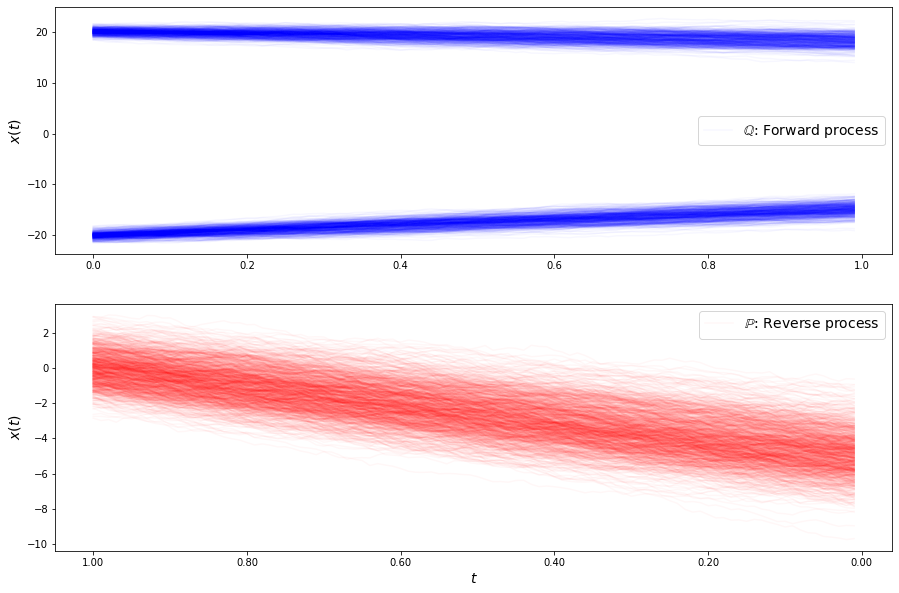

loss b 5.30754238438636
loss b 5.317973626949565
loss b 5.3108752524496206
loss b 5.293148525740987
loss b 5.29736316923777
loss b 5.306940867398772
loss b 5.316213740974635
loss b 5.310376533812441
loss b 5.314230349496607
loss b 5.323913347009177
loss b 5.319028503226987
loss b 5.321654808767577
loss b 5.325219857614002
loss b 5.3192244244698195
loss b 5.318791662309006
loss b 5.321850743860276
loss b 5.320126444648296
loss b 5.320010872303811
loss b 5.324786381938645
loss b 5.330020088356525
loss b 5.319273077801565
loss b 5.327133495284446
loss b 5.3276548853534615
loss b 5.327847648347198
loss b 5.3287706667472845
loss b 5.328982722689692
loss b 5.3230950726161606
loss b 5.325935689089136
loss b 5.3254309652965794
loss b 5.335495030536757
loss f 5.65278869572763
loss f 5.6527236705838755
loss f 5.666457243822038
loss f 5.665224697871285
loss f 5.669352445365004
loss f 5.674894893576414
loss f 5.6783580939252145
loss f 5.692276648678924
loss f 5.68785244435144
loss f 5.695154626533

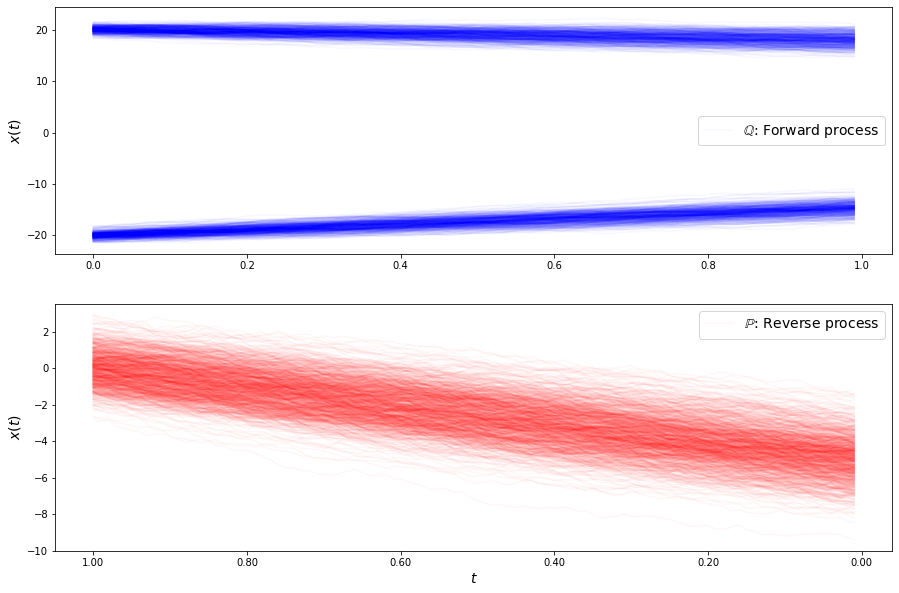

loss b 5.322467745936731
loss b 5.322533311011019
loss b 5.322348558238761
loss b 5.326321720366419
loss b 5.324709694205961
loss b 5.3213310302102546
loss b 5.3218313177501235
loss b 5.3173614096374004
loss b 5.33073319045548
loss b 5.327148324712331
loss b 5.322948154271374
loss b 5.328200950610235
loss b 5.325892962460178
loss b 5.331720557399107
loss b 5.337438267274977
loss b 5.328946052287862
loss b 5.334944380009038
loss b 5.332422615611779
loss b 5.322357511498549
loss b 5.33412444066454
loss b 5.329791862874412
loss b 5.331340666637416
loss b 5.333382550428088
loss b 5.327944965571703
loss b 5.337661793514566
loss b 5.331437926111692
loss b 5.345859676656827
loss b 5.332727774665518
loss b 5.336373166783445
loss b 5.335289559458136
loss f 5.662270732035077
loss f 5.659590571201261
loss f 5.6640533130496795
loss f 5.67827892464236
loss f 5.668545063914145
loss f 5.678385440074001
loss f 5.689248516926588
loss f 5.679148212499246
loss f 5.674587280913194
loss f 5.686606845134833

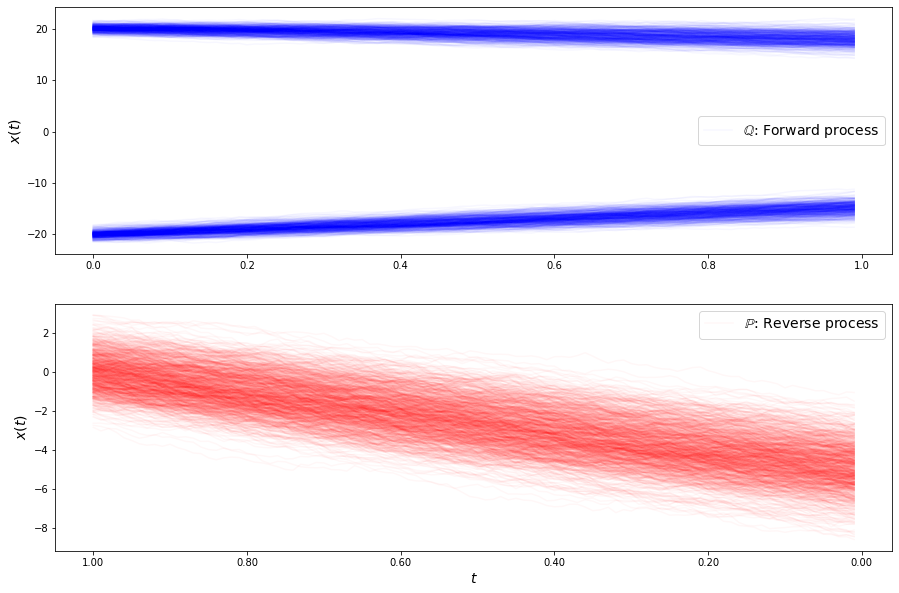

loss b 5.324901102827895
loss b 5.317242518235929
loss b 5.3233009491166845
loss b 5.329461728269889
loss b 5.32550891935537
loss b 5.3346317913073715
loss b 5.324177532150828
loss b 5.329921846675565
loss b 5.326297031732827
loss b 5.324105637668915
loss b 5.321770536109412
loss b 5.323763062424942
loss b 5.334592051820216
loss b 5.322014570015741
loss b 5.321799700581503
loss b 5.335793193257435
loss b 5.3254619212388805
loss b 5.333477141645157
loss b 5.32897182551957
loss b 5.32970367276879
loss b 5.327716026060659
loss b 5.330647476789092
loss b 5.334253047550445
loss b 5.325672300281691
loss b 5.331967812874686
loss b 5.328723215090463
loss b 5.323467431056192
loss b 5.326862184847296
loss b 5.331393400917295
loss b 5.332656201910241
loss f 5.521732382650318
loss f 5.522647604744101
loss f 5.523869798762623
loss f 5.528811500546304
loss f 5.534118833723871
loss f 5.525854326551332
loss f 5.521427171398696
loss f 5.521722482261531
loss f 5.520716812435843
loss f 5.513298409417539


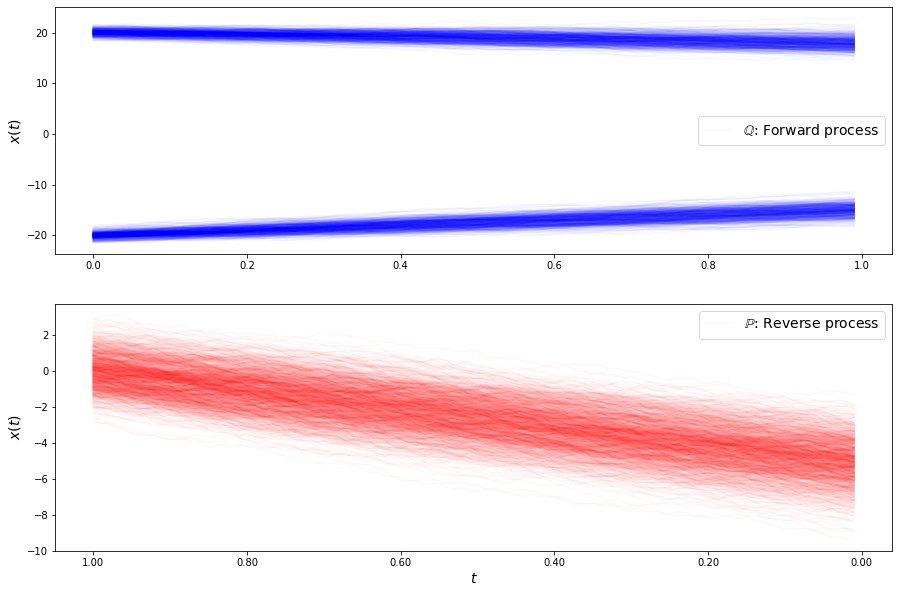

loss b 5.3210117114475315
loss b 5.316524163470221
loss b 5.307414935409626
loss b 5.310458380660285
loss b 5.316914312382817
loss b 5.310079578009198
loss b 5.308350879291417
loss b 5.311476884338817
loss b 5.311489150917069
loss b 5.325841003212287
loss b 5.308187743776983
loss b 5.322768561926968
loss b 5.309044637234948
loss b 5.311896746845862
loss b 5.312456724368957
loss b 5.328787132897392
loss b 5.316789103337791
loss b 5.318230307734419
loss b 5.310525543782751
loss b 5.329838515872779
loss b 5.316681526482701
loss b 5.331959669569868
loss b 5.318000617141312
loss b 5.3327392630354025
loss b 5.322923803459577
loss b 5.337764728061094
loss b 5.33592868861326
loss b 5.335323381393981
loss b 5.331606684461579
loss b 5.33923674675579
loss f 5.355062506768512
loss f 5.351563787819721
loss f 5.348706550731351
loss f 5.348408105277664
loss f 5.346183539112335
loss f 5.353704670020397
loss f 5.353323348242125
loss f 5.349077916871545
loss f 5.347386075843029
loss f 5.3571033202634855

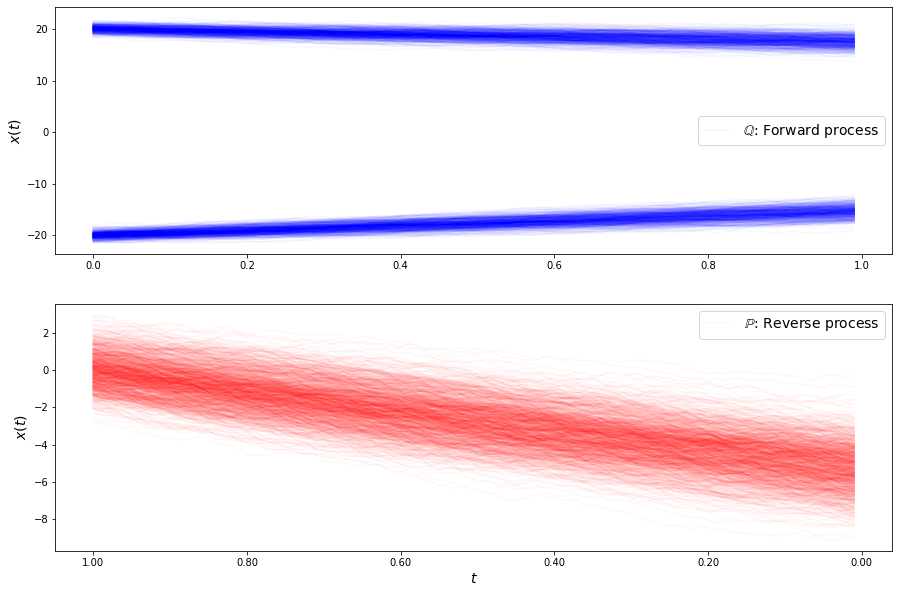

loss b 5.3453364453166365
loss b 5.348799366234064
loss b 5.348429980234945
loss b 5.344568113129421
loss b 5.356326199745793
loss b 5.36011885206291
loss b 5.3663585670098515
loss b 5.367360005063335
loss b 5.3686334045276745
loss b 5.366798892645116
loss b 5.379365291305752
loss b 5.372478080910038
loss b 5.3734164253195535
loss b 5.365802472899111
loss b 5.388035584914079
loss b 5.373169331875419
loss b 5.380077291502946
loss b 5.38070694905957
loss b 5.396391541694607
loss b 5.3915724793208835
loss b 5.387632885012316
loss b 5.3957524066269755
loss b 5.406529479572345
loss b 5.404998478620386
loss b 5.40163822547
loss b 5.393033407627247
loss b 5.404136928663991
loss b 5.412856830009653
loss b 5.415806550828445
loss b 5.410345941132264
loss f 5.368367631713264
loss f 5.376755515041795
loss f 5.382734185729612
loss f 5.393809271929546
loss f 5.401660176835032
loss f 5.393685277751039
loss f 5.4105778748636295
loss f 5.418592463272806
loss f 5.4265182393870806
loss f 5.43556153346315

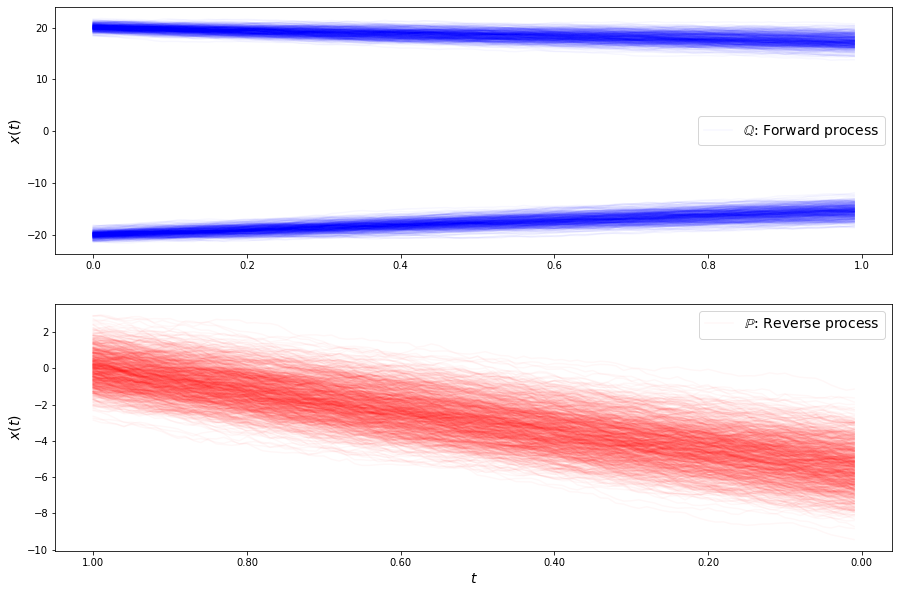

loss b 5.444987628916171
loss b 5.442906925382098
loss b 5.4424605866332
loss b 5.45363459501244
loss b 5.462916864443028
loss b 5.457926122919016
loss b 5.467503572796449
loss b 5.45573091789103
loss b 5.4614491666362985
loss b 5.474444383184681
loss b 5.45932225127848
loss b 5.478618718824435
loss b 5.470365017366958
loss b 5.48279803884782
loss b 5.481068151944919
loss b 5.49271792744943
loss b 5.503643548064398
loss b 5.49528413372637
loss b 5.513378861077643
loss b 5.504341190026095
loss b 5.506144445861718
loss b 5.506884948575287
loss b 5.526300120518733
loss b 5.522042094960742
loss b 5.533591403093486
loss b 5.537440337288952
loss b 5.535617766751518
loss b 5.534640481122988
loss b 5.5406159963264425
loss b 5.547785087602416
loss f 5.540674277580985
loss f 5.553147306096645
loss f 5.54228107138737
loss f 5.550254809403379
loss f 5.548297967038381
loss f 5.5583124144668075
loss f 5.5548341341079555
loss f 5.549204409186214
loss f 5.551463244076026
loss f 5.562989233311024
loss 

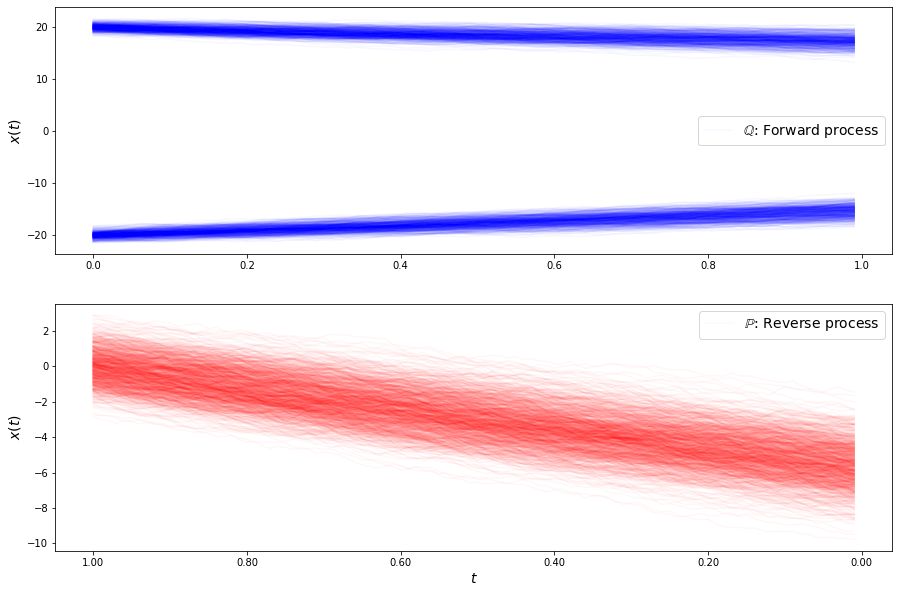

loss b 5.447676713912239
loss b 5.447762841084599
loss b 5.456888925150052
loss b 5.451842147855679
loss b 5.464157001793282
loss b 5.466325605374435
loss b 5.464506755816597
loss b 5.4667591151863215
loss b 5.469537477057685
loss b 5.4748218628692795
loss b 5.4824824351174355
loss b 5.488372664880037
loss b 5.479985503729828
loss b 5.48829581361817
loss b 5.490300410954395
loss b 5.494426658885207
loss b 5.496589182429156
loss b 5.4839047438500845
loss b 5.51310068336217
loss b 5.512664278260136
loss b 5.489285419977217
loss b 5.51796462755229
loss b 5.520591911697743
loss b 5.530907238494896
loss b 5.51735499259071
loss b 5.526831500462761
loss b 5.527099778564091
loss b 5.532457064389337
loss b 5.533848465525021
loss b 5.538523900177692
loss f 5.516700328554139
loss f 5.493636657913116
loss f 5.496478977199439
loss f 5.491804631622224
loss f 5.482333299351455
loss f 5.469650220589111
loss f 5.4803464161464435
loss f 5.466361399225223
loss f 5.460667866183229
loss f 5.453519053818624

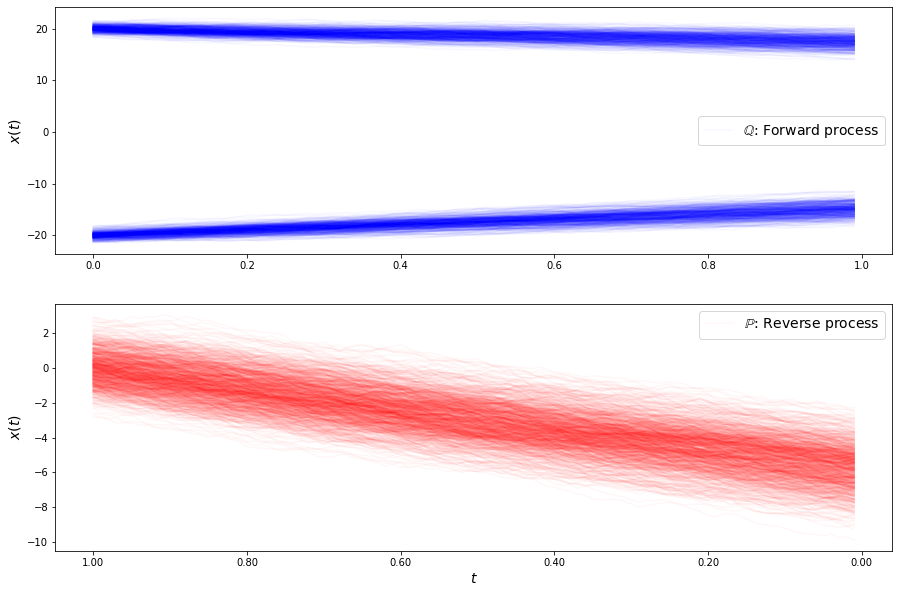

loss b 5.319977756448149
loss b 5.322267349653361
loss b 5.327717214428198
loss b 5.327345334629108
loss b 5.33722829193757
loss b 5.3192175527519705
loss b 5.332991579737691
loss b 5.333704938345728
loss b 5.327958372195624
loss b 5.3364496925245355
loss b 5.342719968016644
loss b 5.330416018239874
loss b 5.334224476665457
loss b 5.3311163218018995
loss b 5.337101226702453
loss b 5.3428090830727495
loss b 5.344652900661791
loss b 5.358260557938788
loss b 5.33814799690606
loss b 5.356636443443277
loss b 5.346056065011083
loss b 5.347469218822981
loss b 5.352325370652032
loss b 5.3482359808043975
loss b 5.349785222822777
loss b 5.3574414090638625
loss b 5.3554192137774885
loss b 5.35480185753496
loss b 5.352012730275015
loss b 5.3521525668806555
loss f 5.296779309183977
loss f 5.292985509377919
loss f 5.282773758689587
loss f 5.289725839778504
loss f 5.273221876065139
loss f 5.264038312454681
loss f 5.262297947839607
loss f 5.246282805021296
loss f 5.254551567102139
loss f 5.24213879748

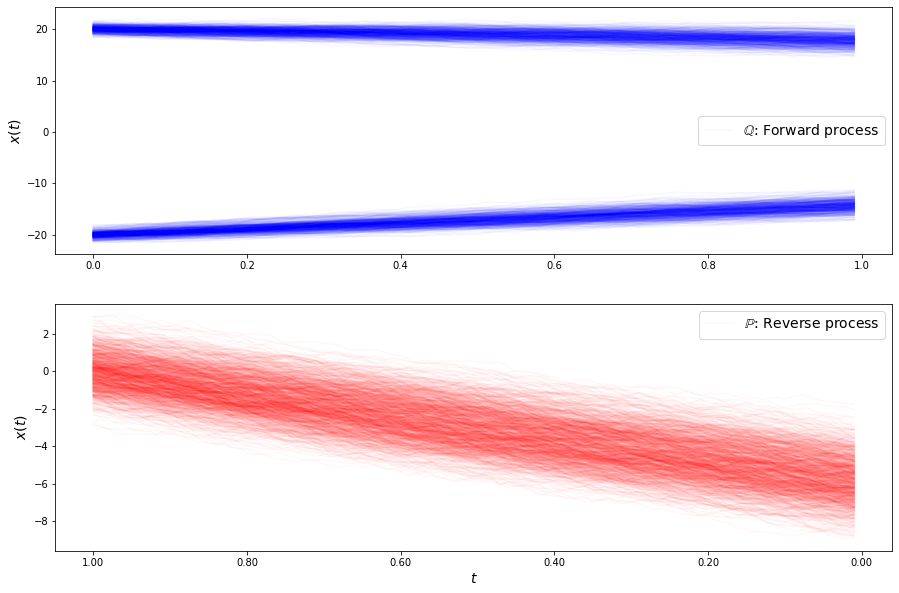

loss b 5.1937728303080135
loss b 5.192493669935589
loss b 5.199494905411843
loss b 5.1944982489127405
loss b 5.190585063636512
loss b 5.19456146208505
loss b 5.180557410645942
loss b 5.187902704499607
loss b 5.1809926711117384
loss b 5.1889183110100365
loss b 5.186769449175789
loss b 5.193835388915598
loss b 5.188146765076281
loss b 5.1831817645420974
loss b 5.176051213691133
loss b 5.1854260896715525
loss b 5.189424785954544
loss b 5.175411004009459
loss b 5.1854039290653695
loss b 5.196543411689439
loss b 5.178289660493166
loss b 5.19112967999036
loss b 5.184792933084785
loss b 5.193273366185194
loss b 5.1721991335985695
loss b 5.18781169642879
loss b 5.183269904350739
loss b 5.181359857495521
loss b 5.18924429517269
loss b 5.178745176485679
loss f 5.219085637849786
loss f 5.21954295521254
loss f 5.229130106282861
loss f 5.227850516260705
loss f 5.234737281411463
loss f 5.2332458221591125
loss f 5.244337230480404
loss f 5.239522819149033
loss f 5.247593582969724
loss f 5.244405786757

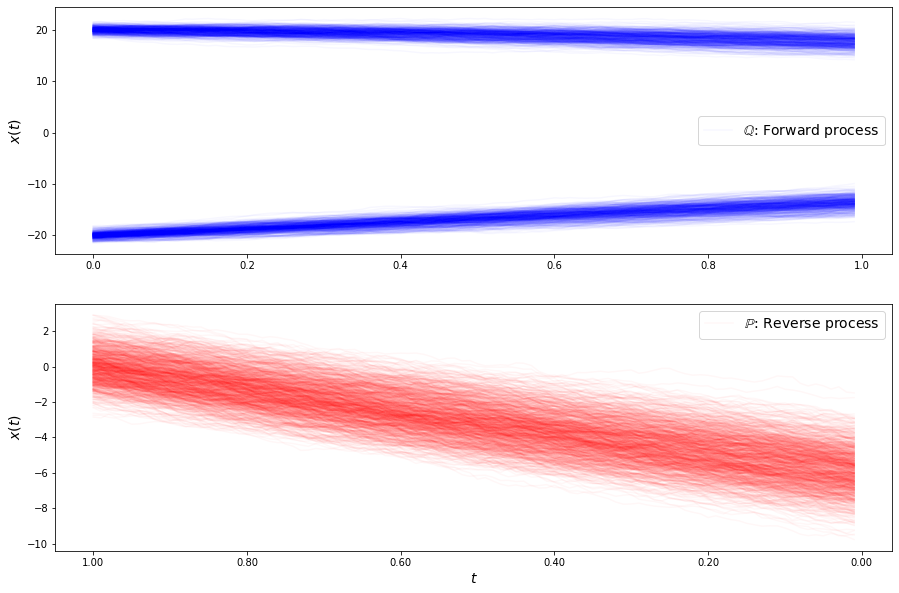

loss b 5.190506790942175
loss b 5.193793602865814
loss b 5.188601728177324
loss b 5.196318192682486
loss b 5.187147179039126
loss b 5.186946724199209
loss b 5.1923289994288355
loss b 5.186508164275208
loss b 5.190349612428015
loss b 5.178350292183363
loss b 5.170084735961131
loss b 5.17438417116665
loss b 5.183408490626079
loss b 5.186825169678544
loss b 5.184009043714607
loss b 5.173802684037794
loss b 5.186560227831205
loss b 5.1744748001324545
loss b 5.177968388483473
loss b 5.1788771104403315
loss b 5.167360474310778
loss b 5.17162952752874
loss b 5.156691926491365
loss b 5.164377913038198
loss b 5.177751556984814
loss b 5.163160707985843
loss b 5.16280670180906
loss b 5.165852758304867
loss b 5.1629702006103555
loss b 5.159202953050179
loss f 5.34432229670357
loss f 5.341354968810186
loss f 5.3536300108653405
loss f 5.358753679869712
loss f 5.360294083450475
loss f 5.3632941799234635
loss f 5.350753323450287
loss f 5.363029344807443
loss f 5.361955358082701
loss f 5.37302091797086

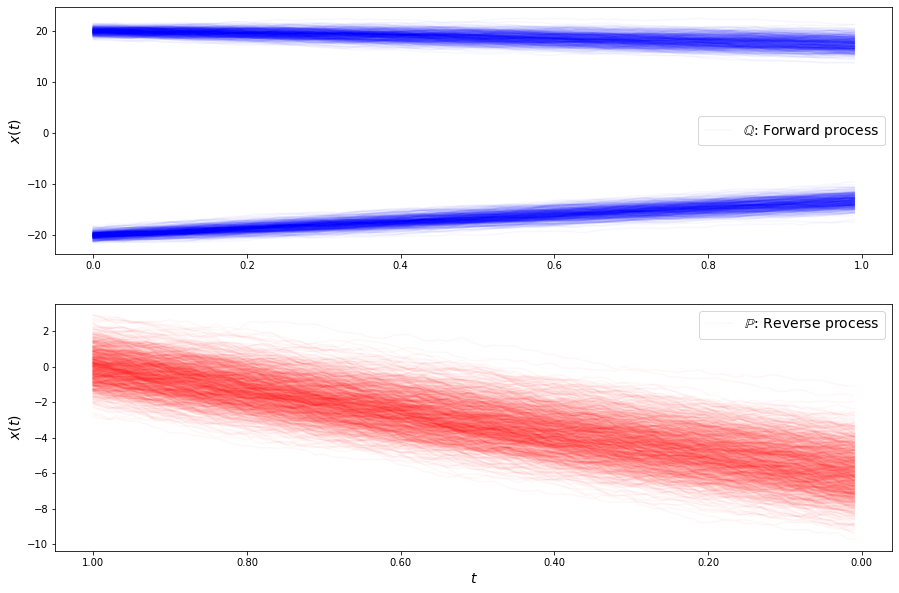

loss b 5.255645674229034
loss b 5.249553414869235
loss b 5.254188483576869
loss b 5.237839781506375
loss b 5.2449701455651665
loss b 5.238691519320378
loss b 5.245040505536287
loss b 5.241354910580776
loss b 5.233828044398614
loss b 5.235331341904892
loss b 5.232164298025181
loss b 5.2302797387291795
loss b 5.224813226135099
loss b 5.228687614195129
loss b 5.221127305876632
loss b 5.219922751952961
loss b 5.214420210665968
loss b 5.220757089695112
loss b 5.207835327362602
loss b 5.205652742078211
loss b 5.214175643935397
loss b 5.213483247831531
loss b 5.206597930495703
loss b 5.199046138512429
loss b 5.198820908598009
loss b 5.201350523530844
loss b 5.20166737885826
loss b 5.196059353469958
loss b 5.18959373518361
loss b 5.180064235360387
loss f 5.350454241212803
loss f 5.353382183309611
loss f 5.344650383646491
loss f 5.352651570153741
loss f 5.345711059983263
loss f 5.344245470972618
loss f 5.341892347039062
loss f 5.344867441204002
loss f 5.350196170091407
loss f 5.348130591934852


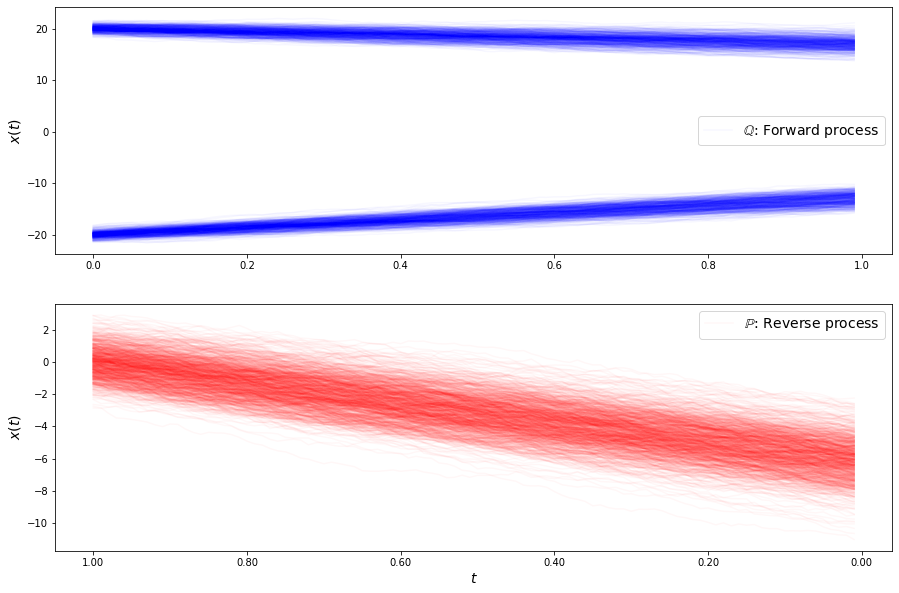

loss b 5.291968436522822
loss b 5.291224791287937
loss b 5.288108981486564
loss b 5.280862781595791
loss b 5.279417307631545
loss b 5.271800704718994
loss b 5.270179609205942
loss b 5.2638360767118035
loss b 5.261636121446804
loss b 5.253589400575328
loss b 5.251661241398501
loss b 5.248188158207775
loss b 5.251082382607485
loss b 5.2526522159257745
loss b 5.2301936345640945
loss b 5.230058507053293
loss b 5.2275495848653435
loss b 5.224922599228075
loss b 5.2267635635259175
loss b 5.21504381110362
loss b 5.215053243981968
loss b 5.205672009727175
loss b 5.201599059660653
loss b 5.2016763112381685
loss b 5.19611517917356
loss b 5.202736152154735
loss b 5.188632462305955
loss b 5.182067411282691
loss b 5.182944567061864
loss b 5.1761231463975825
loss f 5.28628148625346
loss f 5.2991877960731
loss f 5.290021141740882
loss f 5.299297189219103
loss f 5.293106788343348
loss f 5.301994036433478
loss f 5.296521356950295
loss f 5.305149802119482
loss f 5.292930324392842
loss f 5.29607223223313

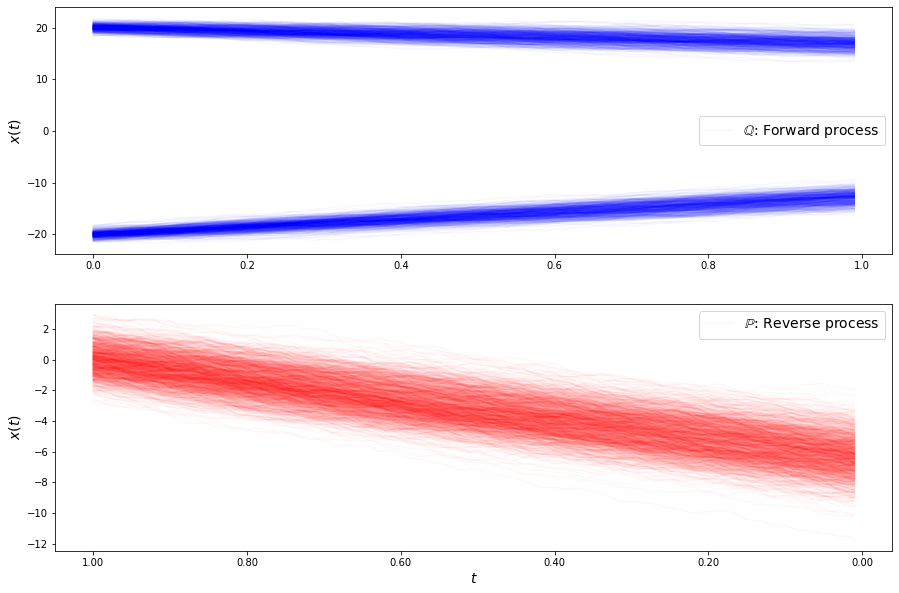

loss b 5.24607833499904
loss b 5.2327677028592685
loss b 5.228780119188106
loss b 5.21469356830479
loss b 5.213828687731296
loss b 5.215456923777767
loss b 5.217939058734618
loss b 5.206256489393137
loss b 5.195844324667811
loss b 5.193696593980817
loss b 5.189786234274962
loss b 5.186178297149969
loss b 5.170094198485532
loss b 5.168721337768209
loss b 5.166605078343073
loss b 5.157892717093238
loss b 5.157046631849461
loss b 5.152471267633944
loss b 5.1471194447855835
loss b 5.146688813318726
loss b 5.1437431000963665
loss b 5.1275224565711
loss b 5.12896326837778
loss b 5.126361122186938
loss b 5.117208053006457
loss b 5.120796847452309
loss b 5.106790095688847
loss b 5.100163740452644
loss b 5.09677657547225
loss b 5.093430112600178
loss f 5.216606609251658
loss f 5.210242728218365
loss f 5.210363308927142
loss f 5.214775837491951
loss f 5.211003689583221
loss f 5.22272472995593
loss f 5.211859062768968
loss f 5.216615406414223
loss f 5.2177406287933605
loss f 5.2138513484341065
lo

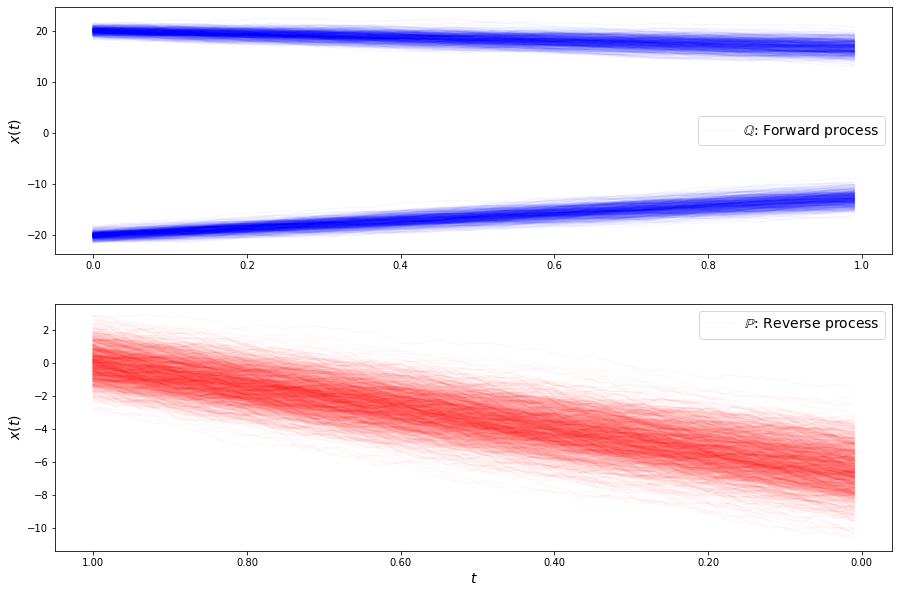

loss b 5.109978413456517
loss b 5.107410456567762
loss b 5.095477470981033
loss b 5.085548234859453
loss b 5.080301241318728
loss b 5.072158347475158
loss b 5.0770990240575395
loss b 5.066894451942249
loss b 5.067919303654805
loss b 5.061219138892169
loss b 5.064918863234183
loss b 5.047389597597076
loss b 5.052579832240885
loss b 5.045177019537278
loss b 5.041018289671876
loss b 5.0291356170222645
loss b 5.030808995111107
loss b 5.02496011051704
loss b 5.021229213320042
loss b 5.011145733000912
loss b 5.012103453977255
loss b 5.001310389064498
loss b 5.003366901630227
loss b 5.001819007296642
loss b 4.99058185000129
loss b 4.988965494503148
loss b 4.991637090592682
loss b 4.973345728326051
loss b 4.982989631471904
loss b 4.9669787799638305
loss f 5.120147021230012
loss f 5.114480173453664
loss f 5.1085185747338455
loss f 5.108974573839438
loss f 5.122494413943227
loss f 5.109752712943792
loss f 5.108904991885145
loss f 5.107344731017972
loss f 5.109743069633309
loss f 5.11602949107589

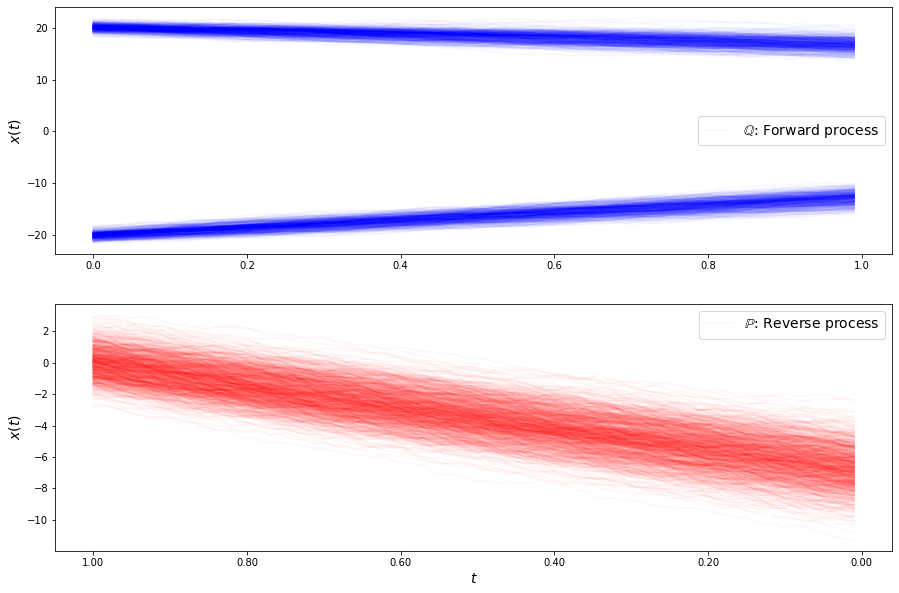

loss b 4.963622445829642
loss b 4.957857569971463
loss b 4.949857652625923
loss b 4.950754634852314
loss b 4.947105955588819
loss b 4.946187744275436
loss b 4.946913203074241
loss b 4.9378133797901285
loss b 4.934408523813595
loss b 4.9336197232721135
loss b 4.925580131342977
loss b 4.923848056774923
loss b 4.927228146465839
loss b 4.932609696914758
loss b 4.925160564184679
loss b 4.9270858778591675
loss b 4.917816953411213
loss b 4.914471040608869
loss b 4.905148535615137
loss b 4.906217080473454
loss b 4.904888454773061
loss b 4.912135216746316
loss b 4.891058864074731
loss b 4.895966810906518
loss b 4.8993298265325755
loss b 4.904194292490645
loss b 4.898116171427102
loss b 4.890970175494448
loss b 4.8915976472967255
loss b 4.894378914349776
loss f 5.070515312507021
loss f 5.072697566473243
loss f 5.072908800494645
loss f 5.069230397103412
loss f 5.068964107114342
loss f 5.072197823249295
loss f 5.067334747102047
loss f 5.067980889566402
loss f 5.064537940805768
loss f 5.06229763177

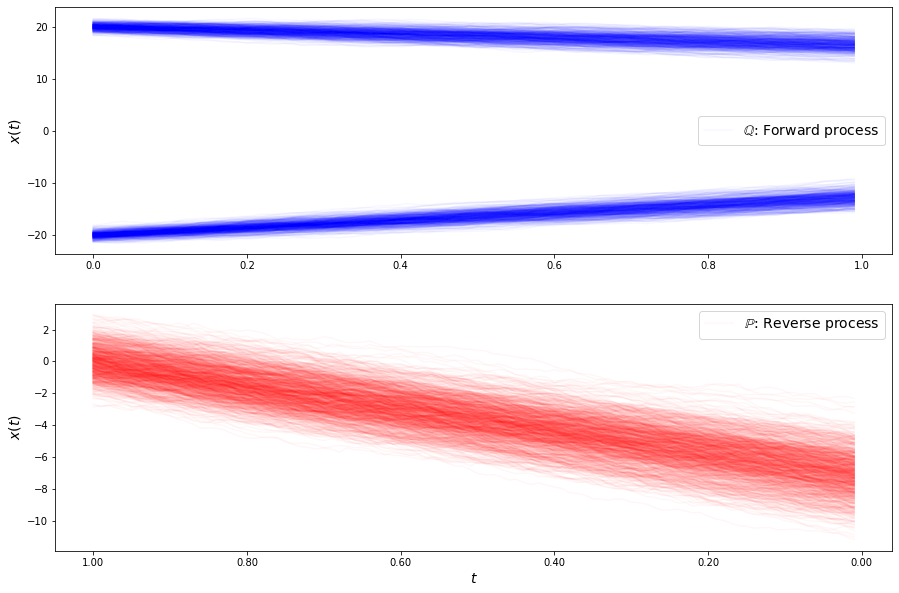

loss b 4.880542273219607
loss b 4.882191130003428
loss b 4.884274368902101
loss b 4.88862348992957
loss b 4.880970200682063
loss b 4.879454135862017
loss b 4.8675249751728105
loss b 4.88245865785188
loss b 4.8607597374565445
loss b 4.871106016159171
loss b 4.879421160717826
loss b 4.864433474712391
loss b 4.872170235800251
loss b 4.873326193196965
loss b 4.878686874541078
loss b 4.869220571654163
loss b 4.8759701617080005
loss b 4.882604760116221
loss b 4.86804284071534
loss b 4.877774842505889
loss b 4.877537425893695
loss b 4.872573150303542
loss b 4.883002908076898
loss b 4.879567243735719
loss b 4.882405336050452
loss b 4.891922285959657
loss b 4.88767396419242
loss b 4.888532257015558
loss b 4.880104827193066
loss b 4.892093746612106
loss f 5.099043628054562
loss f 5.110251712025558
loss f 5.093391630711837
loss f 5.089616821440935
loss f 5.089679569057576
loss f 5.083773908448194
loss f 5.091933676970185
loss f 5.0776652982007375
loss f 5.083461742185266
loss f 5.0813123643018026

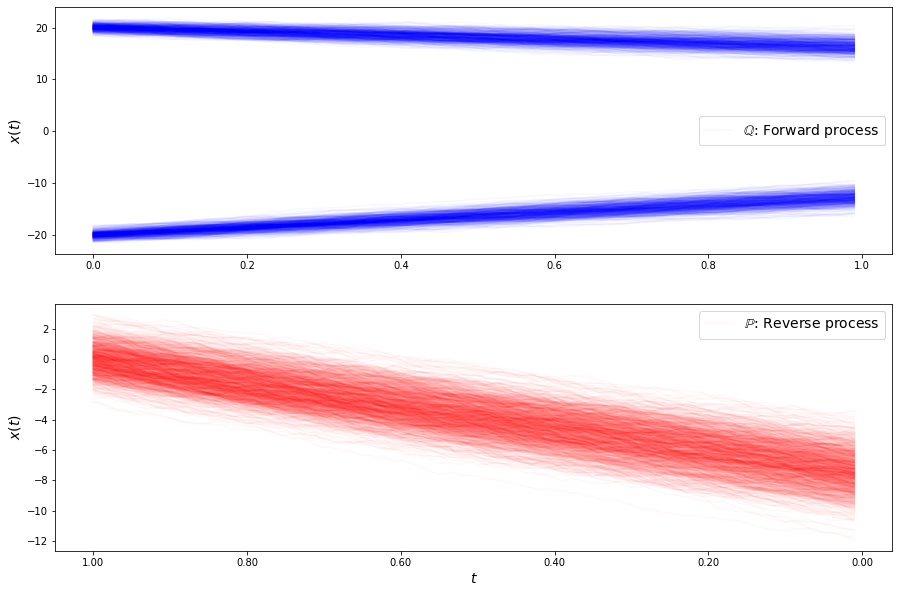

loss b 4.878795103394655
loss b 4.8663094891680405
loss b 4.882636351023424
loss b 4.87660272159978
loss b 4.89060712757318
loss b 4.885315201842893
loss b 4.879106822591392
loss b 4.894156247789935
loss b 4.88972120795127
loss b 4.894238040697543
loss b 4.895230855835266
loss b 4.8977133119542575
loss b 4.895403302806711
loss b 4.898401302688991
loss b 4.896828477936277
loss b 4.9070315680847205
loss b 4.916237619949361
loss b 4.909078994740275
loss b 4.9184572204891905
loss b 4.92040714517299
loss b 4.923517518019373
loss b 4.9465372047172735
loss b 4.9333913498138084
loss b 4.948200879674053
loss b 4.923230295654701
loss b 4.936595390867235
loss b 4.941531477755261
loss b 4.952222183671186
loss b 4.959770421454982
loss b 4.952501297774054
loss f 5.152752788920935
loss f 5.156588386316289
loss f 5.1559085357629835
loss f 5.157727118446626
loss f 5.162300494649636
loss f 5.1552812312611875
loss f 5.144256253374827
loss f 5.134480719968261
loss f 5.14396068071573
loss f 5.1286903531163

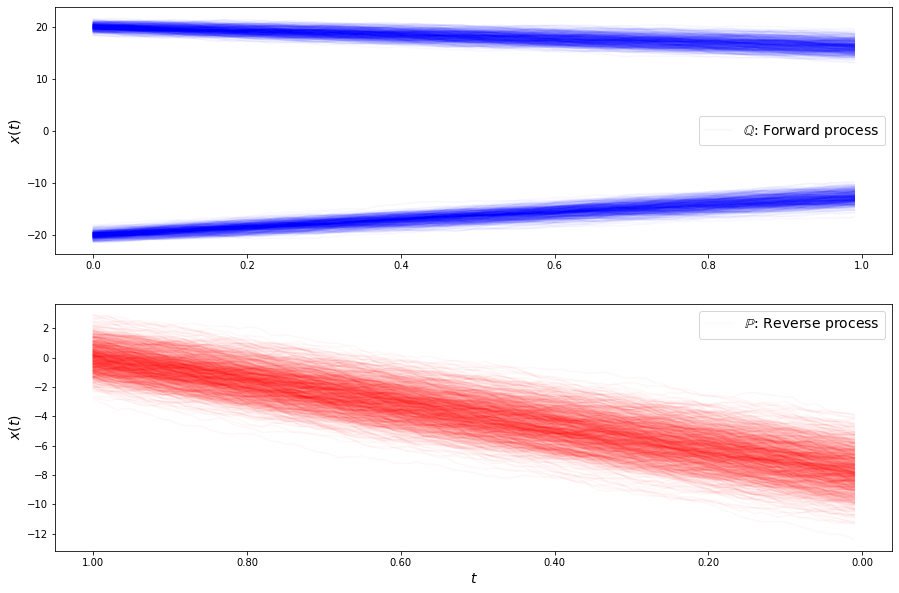

loss b 4.901768524150151
loss b 4.902088926867227
loss b 4.903967187342517
loss b 4.909745918596601
loss b 4.912741539184605
loss b 4.9215961998032
loss b 4.909031734576081
loss b 4.925632355727771
loss b 4.940295351283354
loss b 4.940828381411383
loss b 4.934305042057373
loss b 4.94049293497444
loss b 4.93349369638412
loss b 4.945281438498311
loss b 4.954430411770666
loss b 4.948530309713406
loss b 4.955869831832668
loss b 4.958456535213003
loss b 4.969951955013073
loss b 4.981801447925999
loss b 4.9805338949939975
loss b 4.97452569587406
loss b 4.988863223132428
loss b 4.989670251570905
loss b 4.990362817222711
loss b 5.013947133054109
loss b 5.010555719994713
loss b 5.001849660745681
loss b 5.011144378489373
loss b 5.019948024295239
loss f 5.191215775244054
loss f 5.18024269334763
loss f 5.1860582822904115
loss f 5.179885570382122
loss f 5.165454230483476
loss f 5.166042886420721
loss f 5.171117770472664
loss f 5.150793192060017
loss f 5.155123311136794
loss f 5.148561038693764
loss

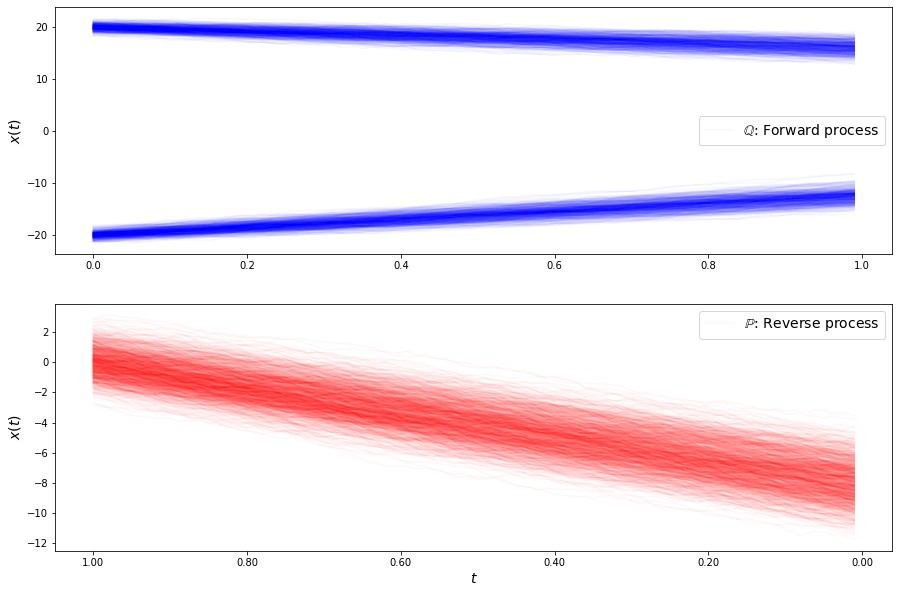

loss b 4.895003277447561
loss b 4.899920268972175
loss b 4.900072182383722
loss b 4.902105140897505
loss b 4.908642618380268
loss b 4.91040718645839
loss b 4.910408270603343
loss b 4.913190788443425
loss b 4.92228920283156
loss b 4.928381148463695
loss b 4.927911993687636
loss b 4.923511870869667
loss b 4.933401489794732
loss b 4.943647259761273
loss b 4.942294144749588
loss b 4.9495533840997865
loss b 4.946385169533162
loss b 4.945661832309142
loss b 4.961665884508188
loss b 4.966110068534806
loss b 4.969597212299614
loss b 4.9673199459221085
loss b 4.968615474977432
loss b 4.978371244742437
loss b 4.980968892529589
loss b 4.979259171901592
loss b 4.989755157158345
loss b 5.0071779826711
loss b 4.997984230317272
loss b 4.999523515683155
loss f 5.143758034856705
loss f 5.153389275565391
loss f 5.147251065546256
loss f 5.128794873019126
loss f 5.1271656752061485
loss f 5.1212518118353625
loss f 5.105006997479539
loss f 5.117459710654948
loss f 5.105749036368535
loss f 5.099721810230457


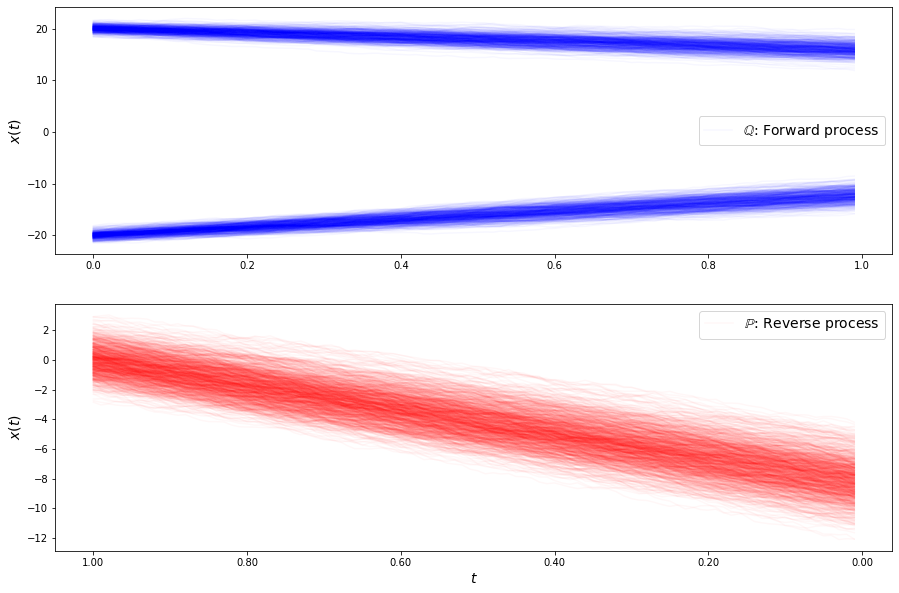

loss b 4.8579486368257525
loss b 4.857863430665459
loss b 4.854253760836815
loss b 4.859229859289494
loss b 4.8612525086901215
loss b 4.844386708692326
loss b 4.868486136207376
loss b 4.862249307534023
loss b 4.86140715232646
loss b 4.863141239553953
loss b 4.874521870459872
loss b 4.874917546545411
loss b 4.872939181374084
loss b 4.871283264614219
loss b 4.890091784044564
loss b 4.881557380159099
loss b 4.863870276648107
loss b 4.894652444375708
loss b 4.886601002650437
loss b 4.898581703505353
loss b 4.886249804478157
loss b 4.883707739678926
loss b 4.90404668413592
loss b 4.88881268895198
loss b 4.898347316153432
loss b 4.89562612242601
loss b 4.8824300707514015
loss b 4.907953715340729
loss b 4.907769328817857
loss b 4.902558075084205
loss f 5.0477096689163705
loss f 5.049507600905928
loss f 5.038452933492067
loss f 5.024485611159033
loss f 5.032439331784891
loss f 5.0256826771076515
loss f 5.025828524341082
loss f 5.01865463020579
loss f 5.007415583156872
loss f 5.001350574349612


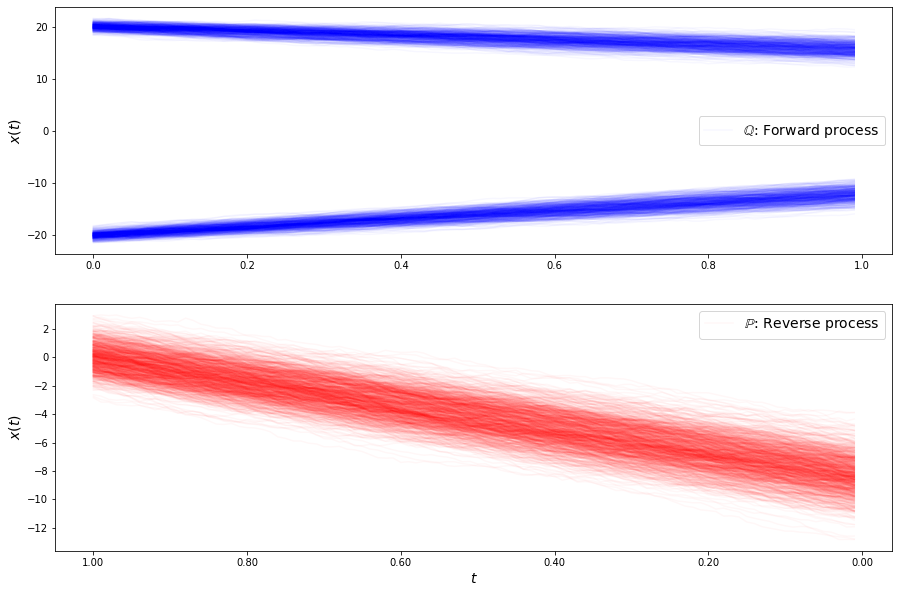

loss b 4.757322769734125
loss b 4.756982413551666
loss b 4.7628101770640585
loss b 4.753811065089015
loss b 4.76543554927918
loss b 4.7728145747065405
loss b 4.749734275023382
loss b 4.764924434326646
loss b 4.775675097267011
loss b 4.768990452076396
loss b 4.778321545691745
loss b 4.761142572283199
loss b 4.7795318450204345
loss b 4.785420168670343
loss b 4.779860189068986
loss b 4.772046039274082
loss b 4.772410342716326
loss b 4.779975055831085
loss b 4.772804063595275
loss b 4.779776256637083
loss b 4.776222693162826
loss b 4.7990384413545435
loss b 4.782955380495705
loss b 4.78100377451449
loss b 4.786439851308319
loss b 4.775511172832579
loss b 4.7914293725329715
loss b 4.776634429701146
loss b 4.789322292976928
loss b 4.781168486948954
loss f 4.9299503019534185
loss f 4.921735575550426
loss f 4.924809443330266
loss f 4.913723505727382
loss f 4.909447816003636
loss f 4.911261929931585
loss f 4.903195222083209
loss f 4.893710364886877
loss f 4.897696759357146
loss f 4.890503925211

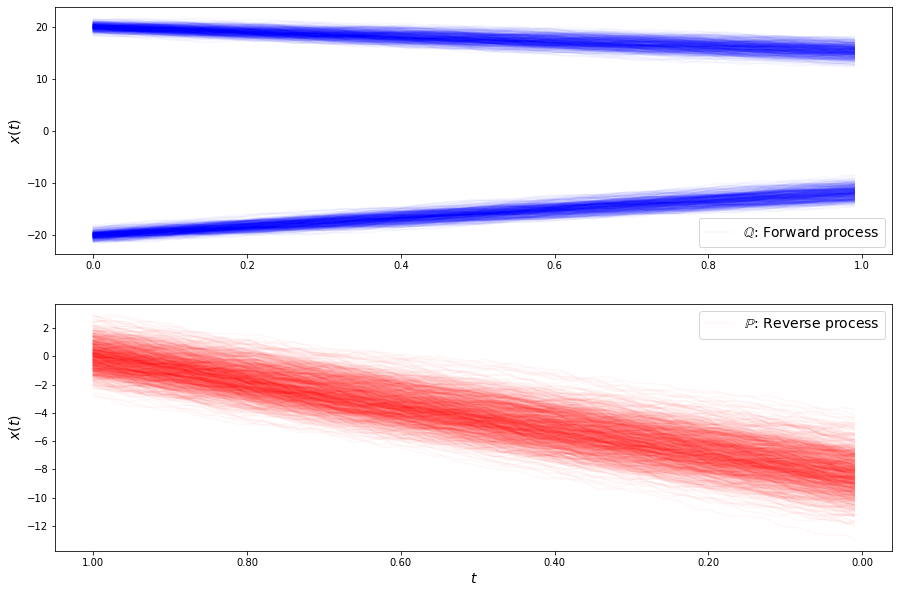

loss b 4.681188510850966
loss b 4.666941120492352
loss b 4.65996115556786
loss b 4.67971725458025
loss b 4.673058501819458
loss b 4.670627869931567
loss b 4.660711150118443
loss b 4.660175594726869
loss b 4.677002205249375
loss b 4.67985839520385
loss b 4.67678276085087
loss b 4.672526272681905
loss b 4.675265473766497
loss b 4.661444758932916
loss b 4.6772899922365285
loss b 4.677476925731095
loss b 4.678459108598602
loss b 4.656974968646762
loss b 4.661121765167813
loss b 4.6720500922261765
loss b 4.674916644723345
loss b 4.6620377976937375
loss b 4.673096864634381
loss b 4.665900235966435
loss b 4.677737832908142
loss b 4.67911864946468
loss b 4.678827501966011
loss b 4.6703489929193
loss b 4.682017830842073
loss b 4.68251062294234
loss f 4.823152050443828
loss f 4.799939927528543
loss f 4.811116842033088
loss f 4.8156841003805
loss f 4.811250685739337
loss f 4.807733487846015
loss f 4.793180053414512
loss f 4.804799187481057
loss f 4.791374343474987
loss f 4.8012863820096525
loss f

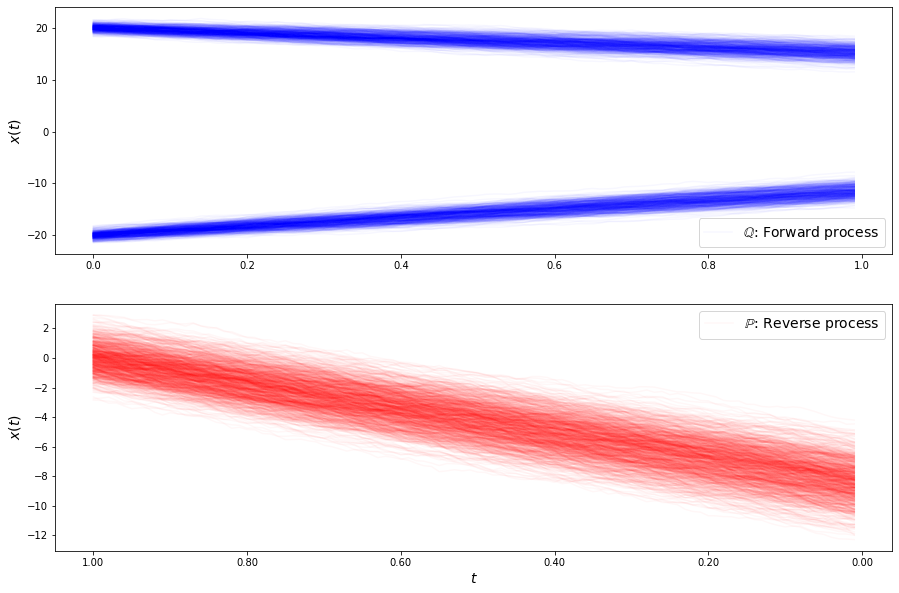

loss b 4.610951876203705
loss b 4.61558679214515
loss b 4.603664732124166
loss b 4.616497949651952
loss b 4.621219174818844
loss b 4.611780941573999
loss b 4.611785645515317
loss b 4.595970891804383
loss b 4.606993556407215
loss b 4.619235944091213
loss b 4.616651115442918
loss b 4.612966089817942
loss b 4.619171574399826
loss b 4.615465460502495
loss b 4.613610634499943
loss b 4.620742434627895
loss b 4.608274262713145
loss b 4.612939261631053
loss b 4.607628682534796
loss b 4.610474949612184
loss b 4.6184014657113766
loss b 4.60600424469685
loss b 4.6126287905500485
loss b 4.6111453622083625
loss b 4.594707064008839
loss b 4.60611434659722
loss b 4.613076646986347
loss b 4.612048250098303
loss b 4.604683710663257
loss b 4.624508526782351
loss f 4.7538874627667305
loss f 4.768709670746048
loss f 4.766073453873768
loss f 4.750398493534625
loss f 4.759734239582529
loss f 4.759346670507125
loss f 4.753337041430826
loss f 4.7616551243771195
loss f 4.740768626191186
loss f 4.76248959045596

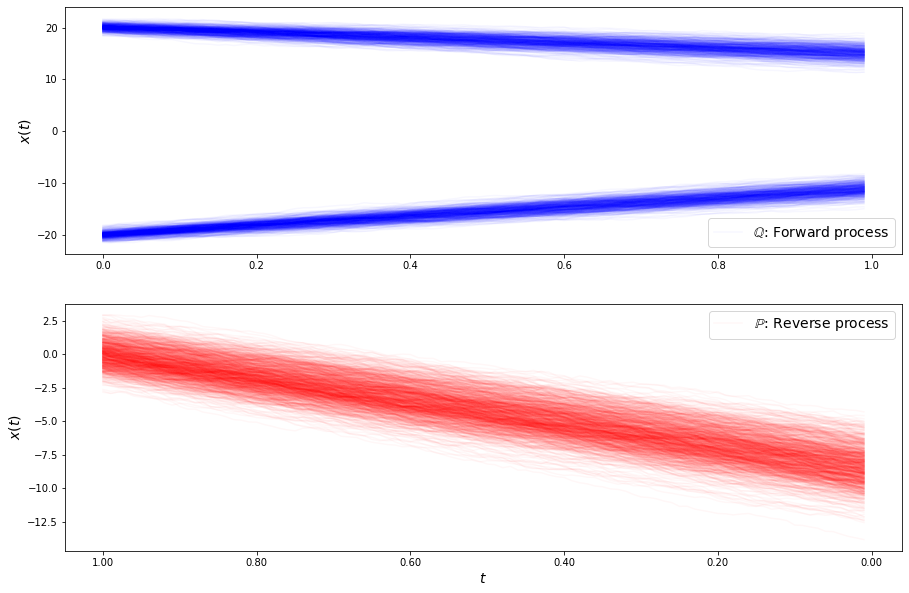

loss b 4.620473265689928
loss b 4.621895165805677
loss b 4.615527412922158
loss b 4.613720485999422
loss b 4.611486824021623
loss b 4.608992455470146
loss b 4.609383852120446
loss b 4.632279670434731
loss b 4.624582723006659
loss b 4.623204339365229
loss b 4.615278352204636
loss b 4.615428011601489
loss b 4.614111921641334
loss b 4.622551455308709
loss b 4.61649606157004
loss b 4.620613198945776
loss b 4.627364044223947
loss b 4.6087885532916095
loss b 4.621811047411123
loss b 4.616963605063093
loss b 4.610135885779371
loss b 4.606318290901647
loss b 4.608560548810018
loss b 4.598065139800574
loss b 4.601473256292001
loss b 4.607494841538377
loss b 4.606693181677646
loss b 4.6010969367788634
loss b 4.600540261143953
loss b 4.614064072162982
loss f 4.757717222139921
loss f 4.764073509430251
loss f 4.745703087806595
loss f 4.763080792476835
loss f 4.772591472529161
loss f 4.7758241271959205
loss f 4.757089383664861
loss f 4.763122551929668
loss f 4.77184079834019
loss f 4.749177217243258

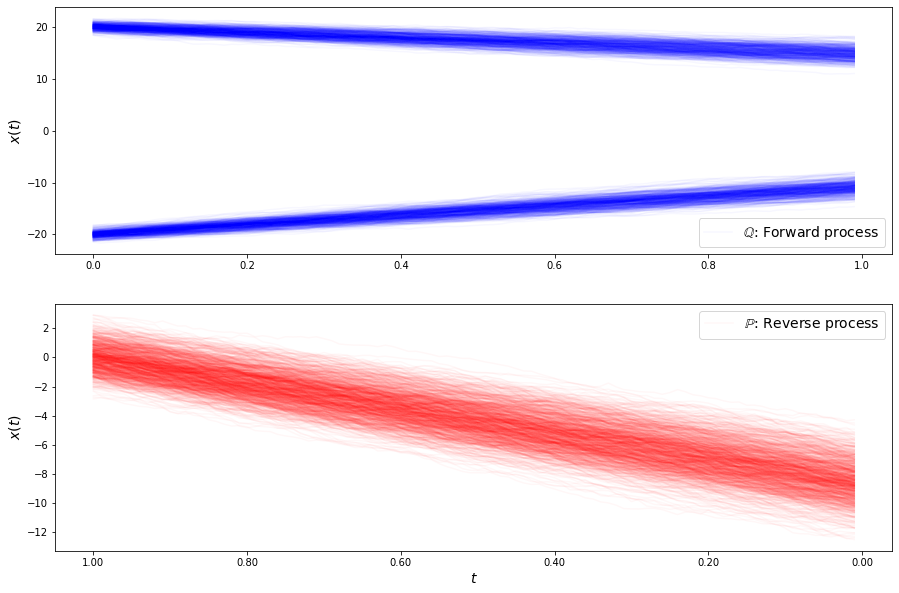

loss b 4.679862134855397
loss b 4.677976956464882
loss b 4.67681125778567
loss b 4.667429776516957
loss b 4.667259322690871
loss b 4.675907260978993
loss b 4.6535493839923845
loss b 4.6751311445187325
loss b 4.670574196119727
loss b 4.672734389859775
loss b 4.664249580031891
loss b 4.66820915494377
loss b 4.653202916388574
loss b 4.645080010122041
loss b 4.658334568835638
loss b 4.653404519016757
loss b 4.659690563271959
loss b 4.651785173571499
loss b 4.653541995000971
loss b 4.643859835221338
loss b 4.653781419053339
loss b 4.644010560921218
loss b 4.642680471117862
loss b 4.638132314424824
loss b 4.632073624070197
loss b 4.63622628240303
loss b 4.639524884670205
loss b 4.645005914720962
loss b 4.633408244660745
loss b 4.63445267195469
loss f 4.768448224695019
loss f 4.775152308565132
loss f 4.783454385779999
loss f 4.76792282590617
loss f 4.775025665403613
loss f 4.772124566926841
loss f 4.774150113794477
loss f 4.771445390777276
loss f 4.775942271224586
loss f 4.789224698983122
los

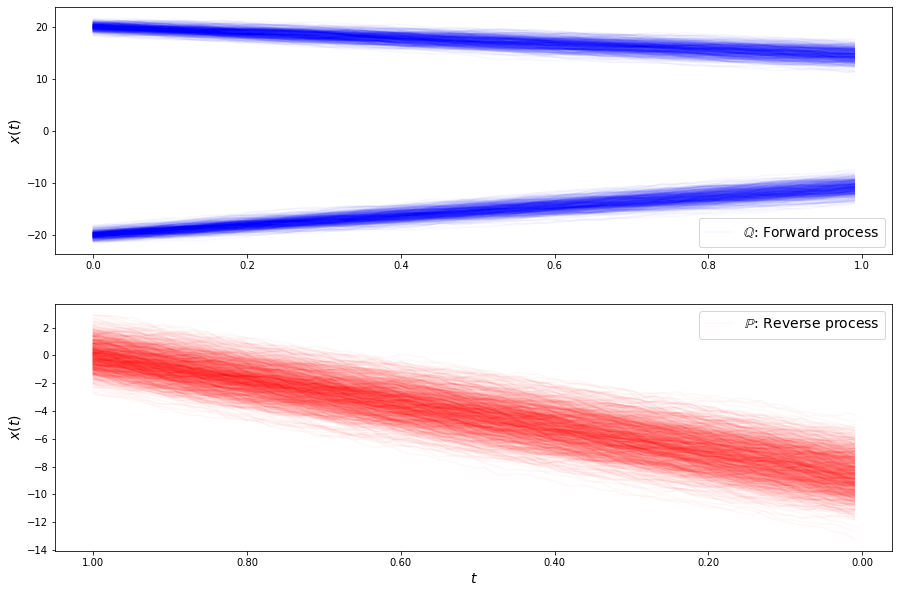

loss b 4.733113921498958
loss b 4.732373965918913
loss b 4.72656475577418
loss b 4.726969502235059
loss b 4.713562445495668
loss b 4.718406012691823
loss b 4.731303660925503
loss b 4.720313760249935
loss b 4.713594520245879
loss b 4.7019193021738195
loss b 4.70564028828649
loss b 4.694068979566574
loss b 4.69601548688787
loss b 4.695612768106837
loss b 4.692559653215132
loss b 4.695722688844833
loss b 4.68442278299046
loss b 4.692749617248056
loss b 4.681134442696521
loss b 4.679832623062826
loss b 4.6640575221559715
loss b 4.672689050814575
loss b 4.656740514504355
loss b 4.6535152019251145
loss b 4.660310041837844
loss b 4.645555703788939
loss b 4.664457376280106
loss b 4.635342370414512
loss b 4.638363167165349
loss b 4.651658961678688
loss f 4.762193583480434
loss f 4.7540250400142705
loss f 4.765420740934038
loss f 4.781534536584256
loss f 4.770540958441617
loss f 4.763780348131674
loss f 4.759435265049875
loss f 4.7679962678228325
loss f 4.766570713840156
loss f 4.777009296532578

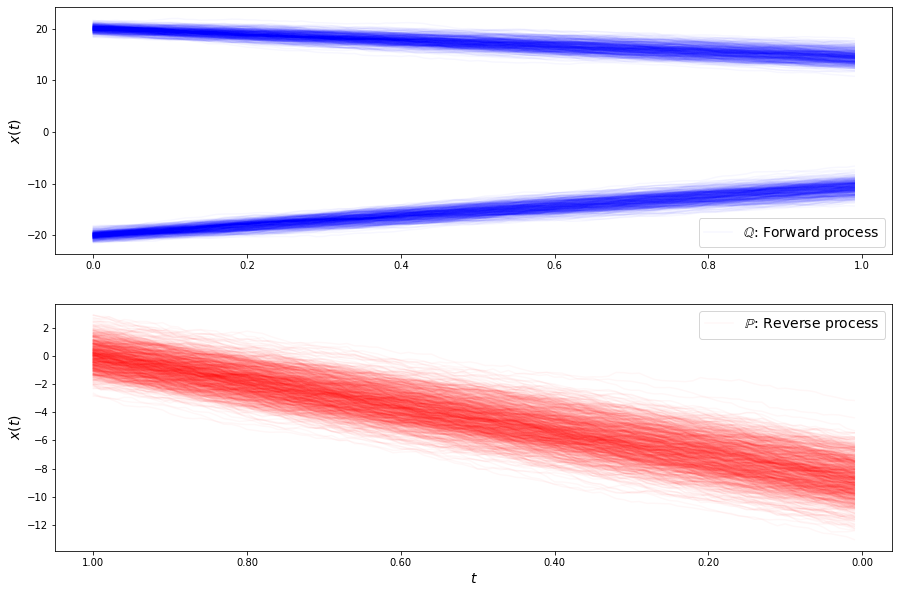

loss b 4.755886331854101
loss b 4.741407588785993
loss b 4.7318686859881005
loss b 4.729400097096265
loss b 4.742220478961875
loss b 4.722172848307878
loss b 4.714177056904411
loss b 4.715854801532063
loss b 4.704152501655199
loss b 4.70680180672324
loss b 4.706513975617998
loss b 4.707621212973701
loss b 4.687167623215387
loss b 4.696268633866373
loss b 4.689569461419116
loss b 4.690040354719711
loss b 4.678006649920916
loss b 4.66551459351642
loss b 4.677006501643057
loss b 4.668474082081873
loss b 4.671890225667848
loss b 4.667720751477727
loss b 4.642403838014424
loss b 4.644675223239321
loss b 4.623872722560326
loss b 4.635187065193333
loss b 4.633909804713183
loss b 4.6326257367824235
loss b 4.617117964428547
loss b 4.622245691383478
loss f 4.714631703045193
loss f 4.720723000928047
loss f 4.7236692509248
loss f 4.7242985443744905
loss f 4.726988128608619
loss f 4.726022343222223
loss f 4.718933283917818
loss f 4.726860009824645
loss f 4.728358734631103
loss f 4.736871124420977
l

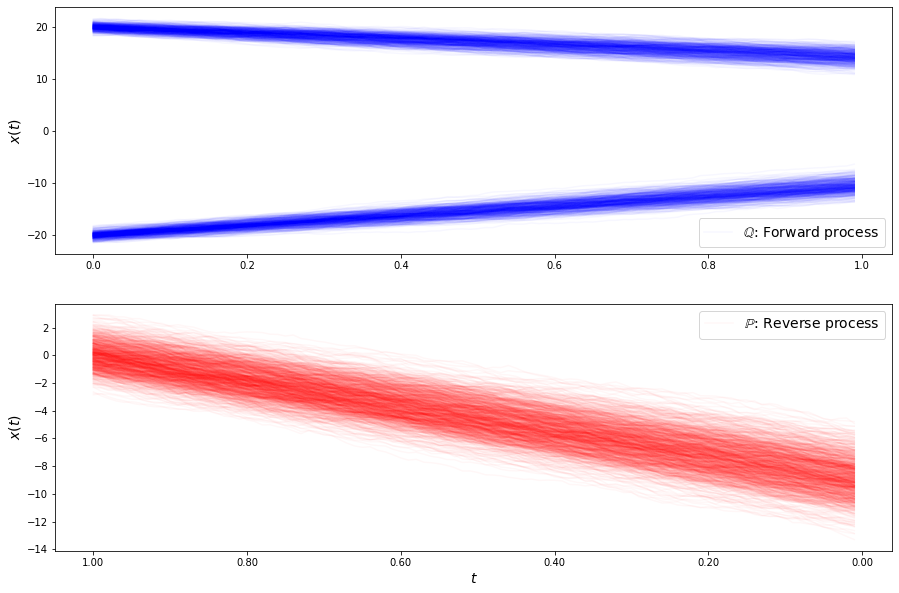

loss b 4.695509286730089
loss b 4.6990902943442485
loss b 4.684315026106184
loss b 4.674200768521498
loss b 4.675259124287061
loss b 4.679556713249979
loss b 4.667240641676988
loss b 4.662113726685714
loss b 4.6496127881761184
loss b 4.645564381126566
loss b 4.640902752549301
loss b 4.622195137546833
loss b 4.640762725636054
loss b 4.63878072239387
loss b 4.6199619839170465
loss b 4.611118832865727
loss b 4.606709434932162
loss b 4.614376309744535
loss b 4.599110813342972
loss b 4.5882994570799545
loss b 4.593868107499333
loss b 4.578607088848618
loss b 4.578504648149232
loss b 4.574660362933041
loss b 4.562851172138346
loss b 4.553831746805017
loss b 4.555550751370695
loss b 4.5524750987795475
loss b 4.5460925890875625
loss b 4.542230704106504
loss f 4.658448843734433
loss f 4.6574661118636
loss f 4.664570517608793
loss f 4.66424440404532
loss f 4.650903077147399
loss f 4.6693006938104995
loss f 4.658292310983903
loss f 4.667009180230212
loss f 4.6701020690416115
loss f 4.663093157098

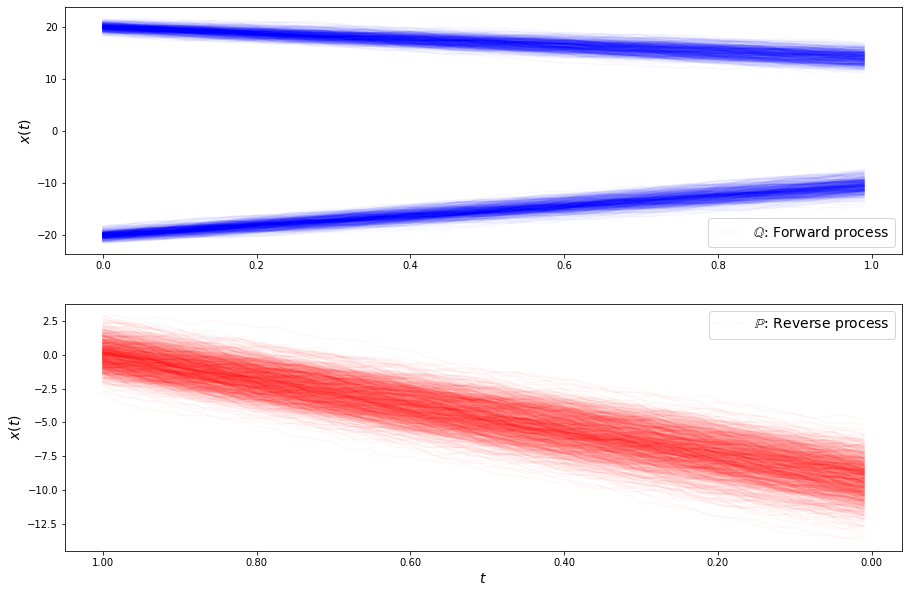

loss b 4.604412375476744
loss b 4.5855685342621335
loss b 4.5841903689824
loss b 4.5796347577506715
loss b 4.5719204029117515
loss b 4.571333997110369
loss b 4.563653178804498
loss b 4.5559314549263386
loss b 4.548083506081162
loss b 4.534524870600171
loss b 4.539717489819646
loss b 4.532818831840104
loss b 4.524604028597062
loss b 4.528587038776643
loss b 4.510639991253189
loss b 4.519869741632282
loss b 4.51451000647713
loss b 4.486774968151402
loss b 4.494773769272062
loss b 4.479986217638828
loss b 4.474691060211861
loss b 4.462407459070874
loss b 4.4672455929835655
loss b 4.470154172521118
loss b 4.467450590591494
loss b 4.457718978499186
loss b 4.446118175981618
loss b 4.458347509745237
loss b 4.441178135856514
loss b 4.443379156835926
loss f 4.565002910208655
loss f 4.578262701139949
loss f 4.563871538097605
loss f 4.57504593908533
loss f 4.582789517346074
loss f 4.568000025043328
loss f 4.565559531556622
loss f 4.552300873061561
loss f 4.570282655959498
loss f 4.571837099338382

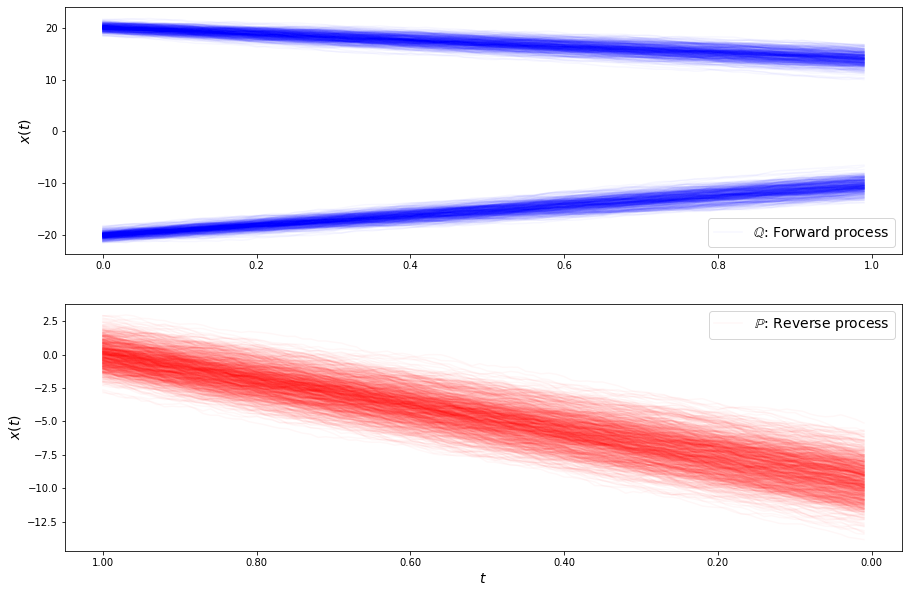

loss b 4.464018520571366
loss b 4.468474426115845
loss b 4.4546671850681125
loss b 4.457928064741994
loss b 4.450580922023485
loss b 4.438834650945412
loss b 4.438384717222474
loss b 4.437999240782872
loss b 4.425559185467962
loss b 4.432620851571814
loss b 4.413674236715662
loss b 4.42110209379558
loss b 4.401136672357532
loss b 4.414146935670026
loss b 4.418606500347517
loss b 4.399809043783658
loss b 4.386861285642122
loss b 4.383414357262799
loss b 4.385571240461835
loss b 4.397229530141618
loss b 4.395640023093725
loss b 4.392606651284835
loss b 4.381313897877113
loss b 4.372318854658867
loss b 4.358175143832218
loss b 4.36987432545862
loss b 4.352525022043807
loss b 4.363672089731736
loss b 4.369362541721563
loss b 4.361952342441556
loss f 4.6457923655378774
loss f 4.637238334434864
loss f 4.637918288568959
loss f 4.635922344727741
loss f 4.6352616121206704
loss f 4.633881027772458
loss f 4.629679248436315
loss f 4.6251737775353705
loss f 4.620323333991215
loss f 4.61787794094801

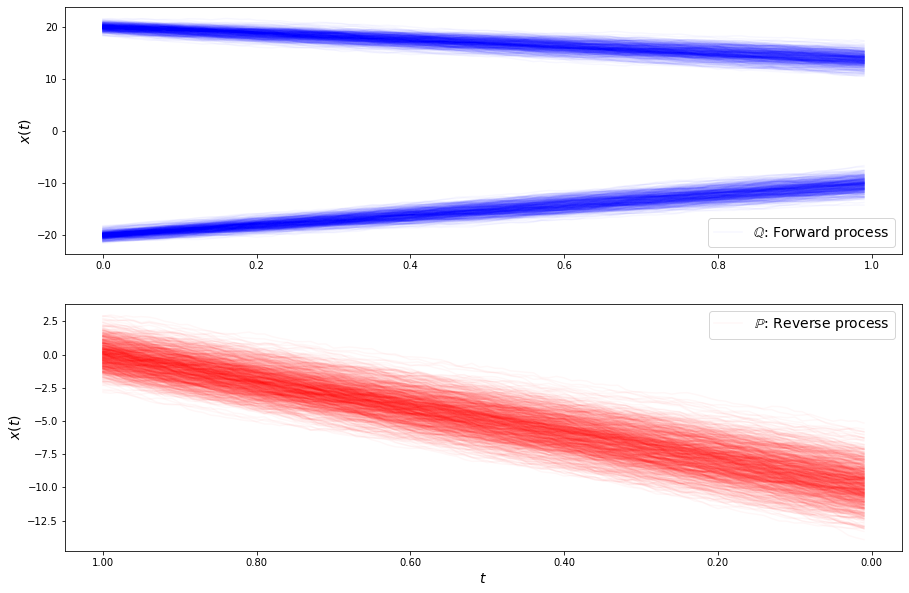

loss b 4.377028150103392
loss b 4.377028759718535
loss b 4.354169986879794
loss b 4.352097671685653
loss b 4.353568864400413
loss b 4.358703245069412
loss b 4.341920090770665
loss b 4.3466573044506
loss b 4.338509015714106
loss b 4.347250184962712
loss b 4.353304604815733
loss b 4.348609827740413
loss b 4.340797542741116
loss b 4.344730493772397
loss b 4.346170591329408
loss b 4.336856215710958
loss b 4.328916348923532
loss b 4.331438513686431
loss b 4.312945890270161
loss b 4.33065482708285
loss b 4.3236162235427225
loss b 4.313256400329808
loss b 4.318016418915492
loss b 4.317899933127183
loss b 4.304639451483472
loss b 4.3314877835830705
loss b 4.324891264320174
loss b 4.322202280121307
loss b 4.311218678562303
loss b 4.309360428804893
loss f 4.729803972784702
loss f 4.72149020200162
loss f 4.720865688237607
loss f 4.706737952160473
loss f 4.710734099231613
loss f 4.706478970039443
loss f 4.702100524486079
loss f 4.68416324063899
loss f 4.694217784581732
loss f 4.688314281203462
los

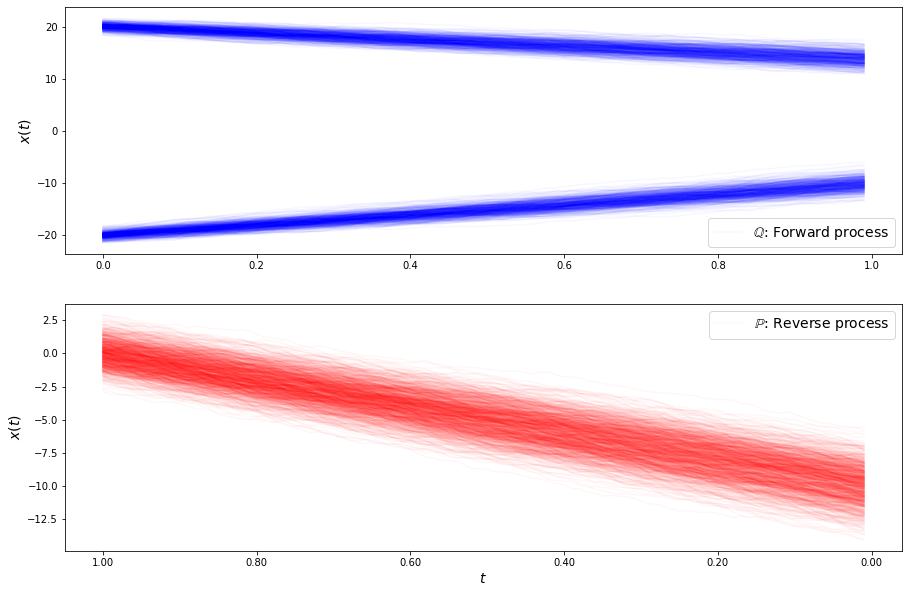

loss b 4.3094281639143786
loss b 4.306021160428453
loss b 4.290174023257212
loss b 4.3044784536758085
loss b 4.317209439373504
loss b 4.304219888226339
loss b 4.289398635659654
loss b 4.304043286944287
loss b 4.291735809218022
loss b 4.299609123468562
loss b 4.29426711087577
loss b 4.28410629708639
loss b 4.299464458798242
loss b 4.2926029402972405
loss b 4.302812052138443
loss b 4.29463496995524
loss b 4.29649414082029
loss b 4.296202680508335
loss b 4.297355153311601
loss b 4.299287124144924
loss b 4.29756272115775
loss b 4.29763938592177
loss b 4.305265969389636
loss b 4.311151093631766
loss b 4.302714839837807
loss b 4.308978722483733
loss b 4.30781073139461
loss b 4.321654726890205
loss b 4.318733264218356
loss b 4.3071247587798025
loss f 4.736153163901649
loss f 4.729618546764096
loss f 4.7379294767770705
loss f 4.70815485711078
loss f 4.706109091318959
loss f 4.709728270138454
loss f 4.698723682215088
loss f 4.6860716192753324
loss f 4.67404209188213
loss f 4.679408352955399
los

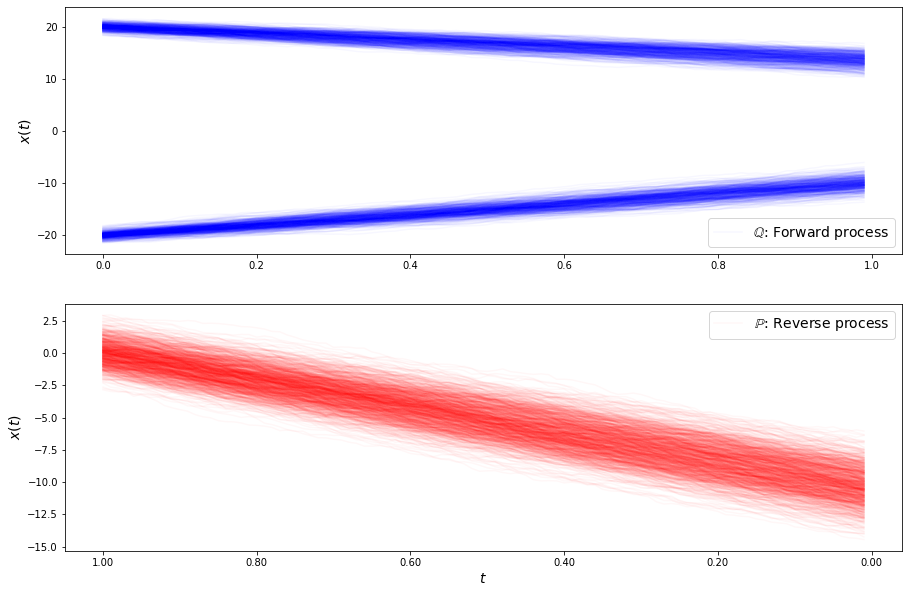

loss b 4.291223025010772
loss b 4.27225678690701
loss b 4.271015729664527
loss b 4.282168055840749
loss b 4.27488163888028
loss b 4.268065897399618
loss b 4.272149620416507
loss b 4.280438026832117
loss b 4.269829772244882
loss b 4.2748401117013834
loss b 4.280786293863073
loss b 4.284251965437777
loss b 4.288915143619432
loss b 4.27589932598482
loss b 4.287632091069766
loss b 4.2750854809422245
loss b 4.278992173641248
loss b 4.289611518679872
loss b 4.303338464108457
loss b 4.2883830387877
loss b 4.2862632868837505
loss b 4.281351083403622
loss b 4.293137523035845
loss b 4.309580098438331
loss b 4.312421845191995
loss b 4.292349688520285
loss b 4.301474690814378
loss b 4.303589943085081
loss b 4.308931566383625
loss b 4.309212074267992
loss f 4.635935817865416
loss f 4.639961509838146
loss f 4.625408344170191
loss f 4.631482946900479
loss f 4.62224590941581
loss f 4.625129442427312
loss f 4.628130482698325
loss f 4.61297646901899
loss f 4.58770963833161
loss f 4.596399977969269
loss 

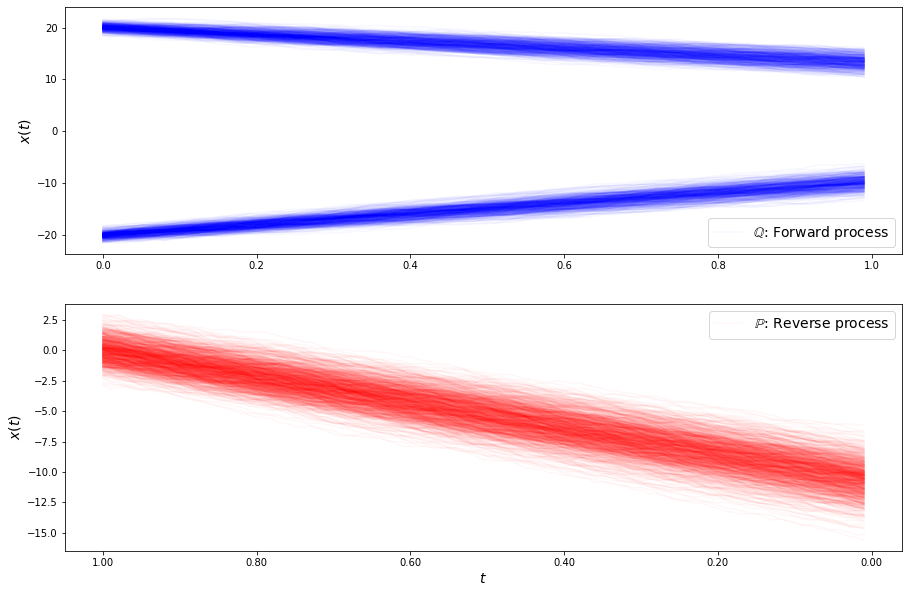

loss b 4.242968651568251
loss b 4.233869909094273
loss b 4.237877126433965
loss b 4.2397250978425465
loss b 4.2335489303906435
loss b 4.234269991692571
loss b 4.247840170047349
loss b 4.237706748707095
loss b 4.231179552787293
loss b 4.265677383582585
loss b 4.260981992162909
loss b 4.255398829192005
loss b 4.266694659403309
loss b 4.257685464787822
loss b 4.244429766786953
loss b 4.242567547949761
loss b 4.2501104860611845
loss b 4.267966200292722
loss b 4.2598634307945185
loss b 4.270226851917649
loss b 4.263202841016578
loss b 4.274604600863974
loss b 4.268609538277155
loss b 4.272229165908377
loss b 4.263755337773676
loss b 4.271747652763745
loss b 4.273548802906482
loss b 4.277285797748652
loss b 4.281823702746443
loss b 4.295681700072481
loss f 4.533895972712191
loss f 4.535042914515839
loss f 4.5347093302188695
loss f 4.51299235774241
loss f 4.514759075381545
loss f 4.5065763800357725
loss f 4.515895933834508
loss f 4.493601619187105
loss f 4.492364912541518
loss f 4.49778601143

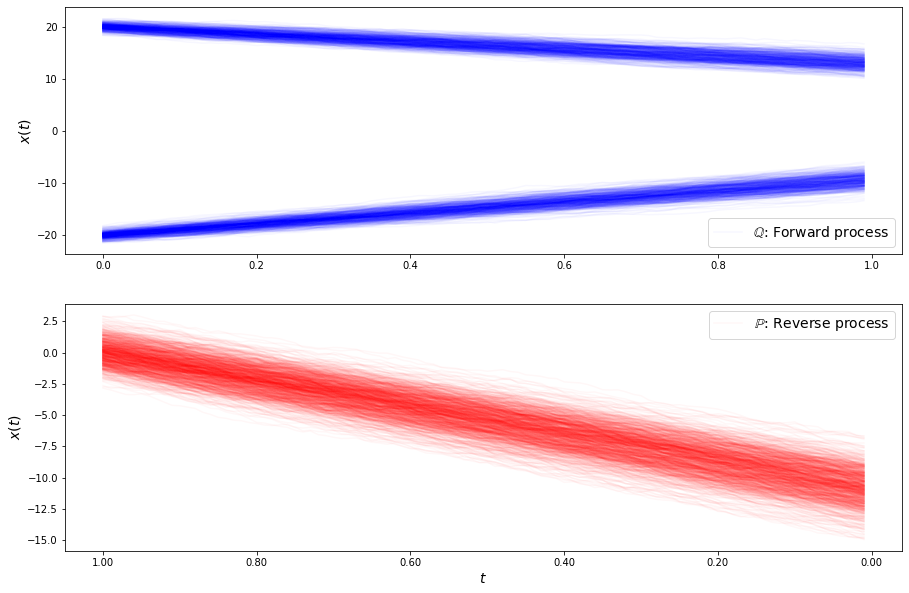

loss b 4.188246045541964
loss b 4.166997266403793
loss b 4.176727577333506
loss b 4.193467655442339
loss b 4.171759907582616
loss b 4.182504947674753
loss b 4.180680762869349
loss b 4.185484083574162
loss b 4.193522319620339
loss b 4.180075763336619
loss b 4.198398319009119
loss b 4.170762170760585
loss b 4.206272060633065
loss b 4.200071207850325
loss b 4.192786977812667
loss b 4.186676161206182
loss b 4.2002432200995345
loss b 4.213472330507312
loss b 4.208035950646255
loss b 4.208266450175466
loss b 4.207461554573528
loss b 4.193286585897236
loss b 4.198255952022965
loss b 4.225108795016537
loss b 4.213943421132351
loss b 4.213327968077316
loss b 4.216388668973539
loss b 4.215064598706692
loss b 4.217749094467998
loss b 4.236908437186653
loss f 4.462425611886461
loss f 4.460904287751783
loss f 4.444794354036537
loss f 4.436428216391035
loss f 4.432137241066069
loss f 4.436091260860408
loss f 4.44774119317375
loss f 4.432263568554145
loss f 4.41711683640058
loss f 4.436750842952506
l

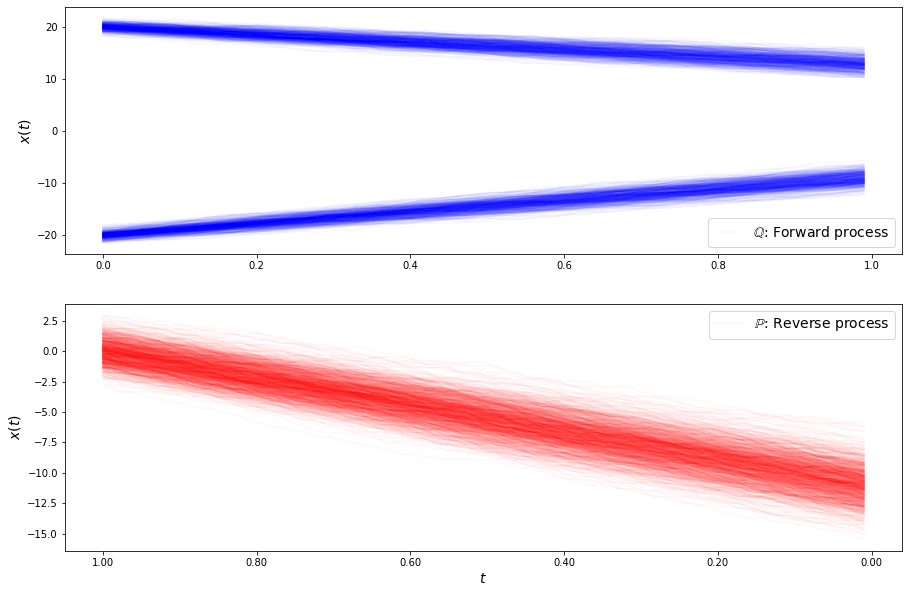

loss b 4.090763469408378
loss b 4.085755662715069
loss b 4.0882223459350655
loss b 4.088013758850674
loss b 4.09880587871945
loss b 4.109510566531279
loss b 4.1044803833804995
loss b 4.085085327225754
loss b 4.09126032610891
loss b 4.092568911524202
loss b 4.091858466664361
loss b 4.096285543180035
loss b 4.094753153641211
loss b 4.102924925139109
loss b 4.111000084418642
loss b 4.099312170429965
loss b 4.090922306435497
loss b 4.1178387337231435
loss b 4.119870187861922
loss b 4.099584413599826
loss b 4.108580720179064
loss b 4.09811555749636
loss b 4.09942174125968
loss b 4.119498131701801
loss b 4.11549420597738
loss b 4.1033022147096645
loss b 4.137660963906024
loss b 4.117556498772429
loss b 4.124791555073993
loss b 4.111047818575698
loss f 4.356340456624229
loss f 4.3701252537979745
loss f 4.352122274463541
loss f 4.352959240321826
loss f 4.363552938333347
loss f 4.3469345960384205
loss f 4.3478520721326115
loss f 4.348032719118789
loss f 4.345791606585236
loss f 4.34465634789488

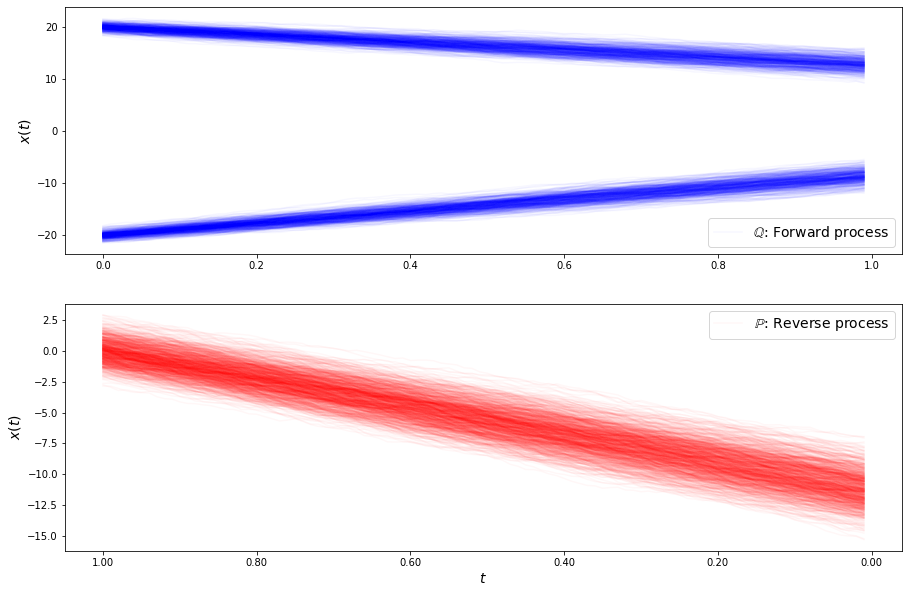

loss b 4.023294201686964
loss b 4.000377145828064
loss b 4.005768557191233
loss b 4.0049714602316895
loss b 3.99659879602821
loss b 4.020848851653814
loss b 4.005874327589554
loss b 4.000328816076376
loss b 3.9955919952996437
loss b 4.007640864046479
loss b 4.007672840058689
loss b 4.012085465168221
loss b 4.003429949595316
loss b 4.005625050852779
loss b 4.0154016891604645
loss b 4.015364179368887
loss b 4.002611208180023
loss b 4.007629652238049
loss b 4.015370532193478
loss b 4.01695882672971
loss b 4.0067630303590756
loss b 4.022965682563231
loss b 4.01226109922298
loss b 4.019730668437731
loss b 4.014196666713238
loss b 4.015960652968979
loss b 3.9946642001135064
loss b 4.008777247317906
loss b 4.0161595511053765
loss b 4.003914239652052
loss f 4.302404177669245
loss f 4.284429210373933
loss f 4.285127192497852
loss f 4.300825259124877
loss f 4.294829951039281
loss f 4.299238443562155
loss f 4.295382241207924
loss f 4.286774266572141
loss f 4.297380047793085
loss f 4.2691298419919

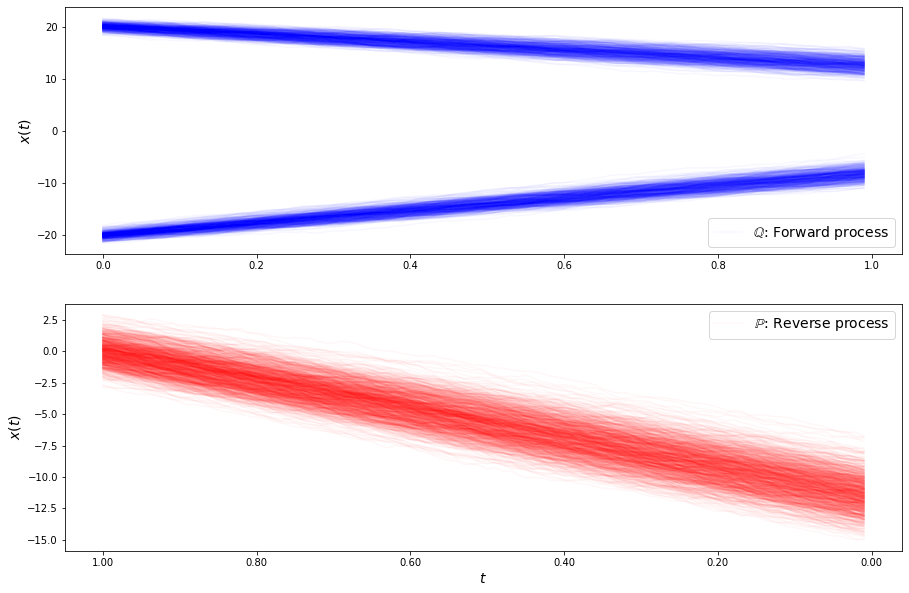

loss b 3.9325370680613747
loss b 3.954318496102449
loss b 3.937313890623503
loss b 3.942670325896973
loss b 3.9539434178618875
loss b 3.954189660700181
loss b 3.9285001977698157
loss b 3.936494666086651
loss b 3.9411481812333897
loss b 3.9386697383120253
loss b 3.9466833947803592
loss b 3.9443249360339063
loss b 3.9282709748414835
loss b 3.935067070981565
loss b 3.9431444258041743
loss b 3.9319493313576657
loss b 3.9288380184970118
loss b 3.937116022884323
loss b 3.9511318224229988
loss b 3.936814333866907
loss b 3.916219596321474
loss b 3.9333240057512358
loss b 3.9357698347966883
loss b 3.9376275887676204
loss b 3.911714278700067
loss b 3.9558563948049468
loss b 3.9322514530046133
loss b 3.945258747045418
loss b 3.9298120377094747
loss b 3.9228302245704993
loss f 4.245854969508906
loss f 4.248794447236712
loss f 4.244603748238938
loss f 4.2379715889853795
loss f 4.239565949853472
loss f 4.2397909117292745
loss f 4.242973970633632
loss f 4.235614323754919
loss f 4.228516021931462
loss

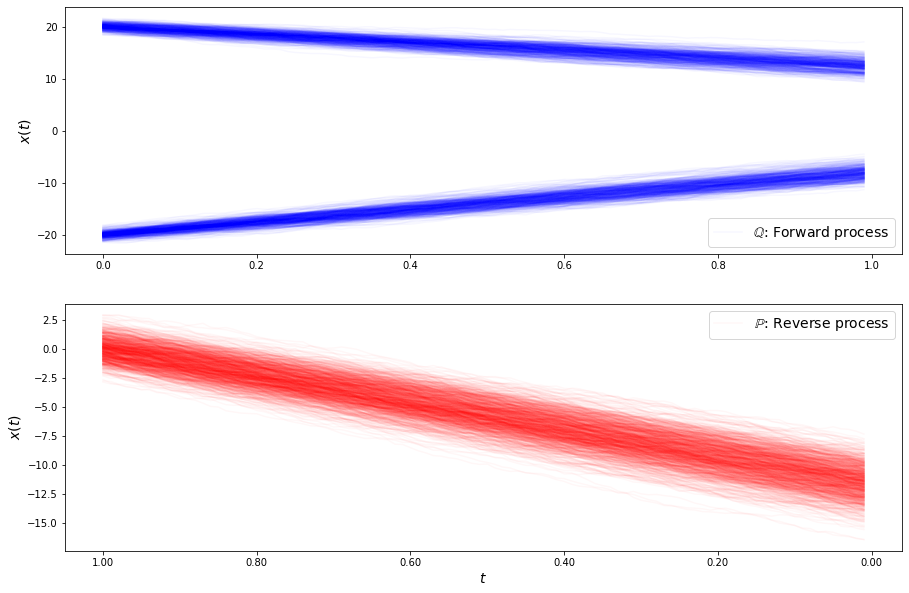

loss b 3.9174398745881795
loss b 3.8964724326304734
loss b 3.897234944369981
loss b 3.8893353356076408
loss b 3.8909174115360994
loss b 3.9030254028875904
loss b 3.900049307752843
loss b 3.8901643003330886
loss b 3.8905197638835345
loss b 3.8893926038803635
loss b 3.874775425287709
loss b 3.8864263807228467
loss b 3.8879346913339625
loss b 3.8669184101606433
loss b 3.883023836904428
loss b 3.8898203335710795
loss b 3.8868033947161953
loss b 3.8795322830453345
loss b 3.8734081241803917
loss b 3.865543406649661
loss b 3.854727649290085
loss b 3.8722825625208936
loss b 3.8665958974100896
loss b 3.8743803929888463
loss b 3.8773588739849667
loss b 3.873875871458258
loss b 3.8699661344327065
loss b 3.8788490959634627
loss b 3.8593058834857144
loss b 3.8648609831344176
loss f 4.191467810692814
loss f 4.18536330680727
loss f 4.197333677929271
loss f 4.195241330100915
loss f 4.210208492805529
loss f 4.1995429260648285
loss f 4.196206759169563
loss f 4.204599492486484
loss f 4.2034621339395875
l

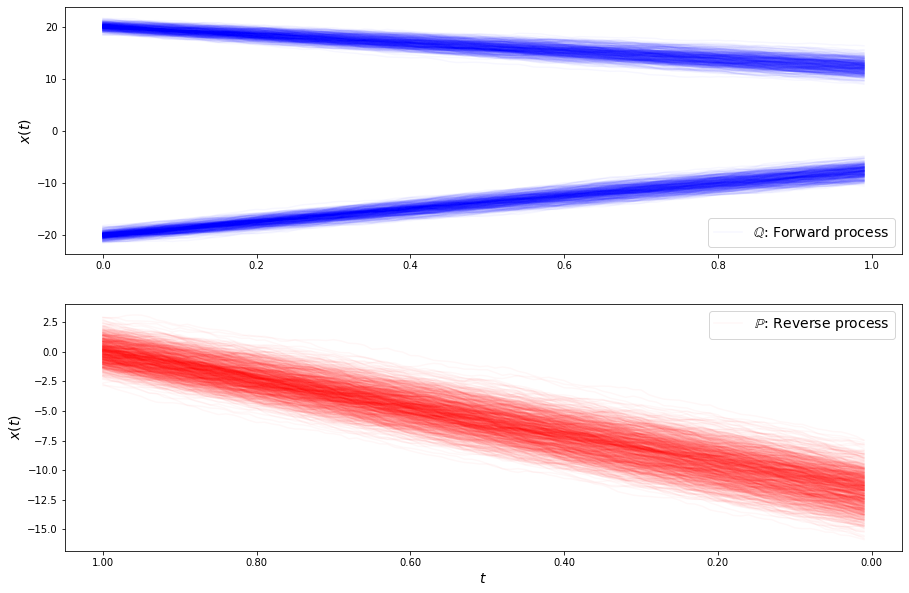

loss b 3.8665420518429157
loss b 3.874576670949695
loss b 3.872887923391289
loss b 3.861697601607095
loss b 3.8666432672206246
loss b 3.8589724047723166
loss b 3.855122893629969
loss b 3.866660801214432
loss b 3.8289667466523833
loss b 3.8511583764016093
loss b 3.842747632730772
loss b 3.8401052702378227
loss b 3.8375459458935275
loss b 3.8533655097532056
loss b 3.8432557774590475
loss b 3.8569415449749647
loss b 3.841507281519656
loss b 3.8427057519292904
loss b 3.8300708628587317
loss b 3.841811291179451
loss b 3.8443674143465887
loss b 3.8372766403062517
loss b 3.8266069597335406
loss b 3.813963220878318
loss b 3.8043280929209304
loss b 3.8036740896899794
loss b 3.816571802688891
loss b 3.8335876042109507
loss b 3.8111676183922145
loss b 3.7890930910629694
loss f 4.153228597843338
loss f 4.1581212066778
loss f 4.157493943455935
loss f 4.162228520787924
loss f 4.171641377552668
loss f 4.163428171611151
loss f 4.187148977948378
loss f 4.171578613621282
loss f 4.148379918659676
loss f 

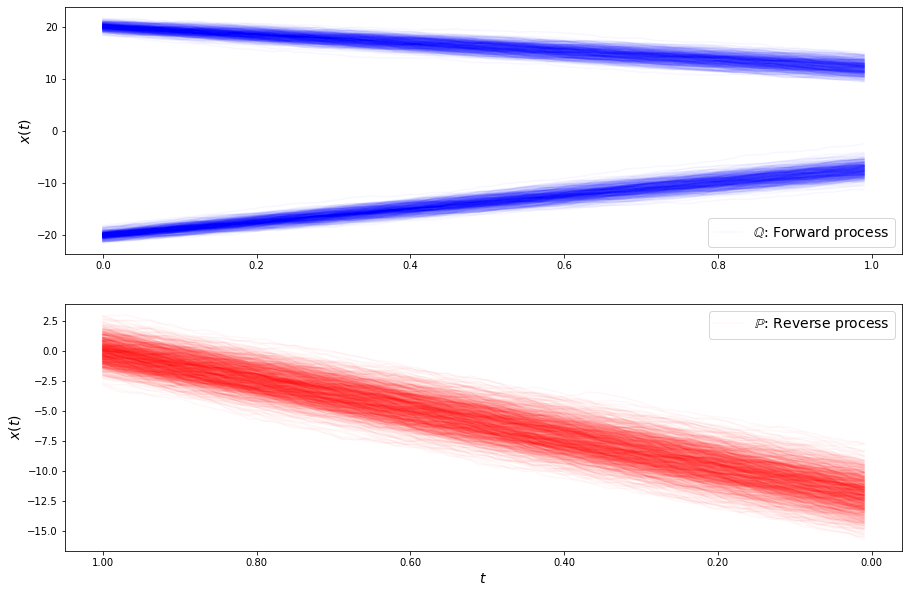

loss b 3.8478591782076412
loss b 3.848261056117576
loss b 3.848460216390663
loss b 3.8390717581075373
loss b 3.8178112430539213
loss b 3.8310881884353205
loss b 3.825847451685574
loss b 3.809042791486265
loss b 3.8204328324113694
loss b 3.8038287692483452
loss b 3.825757661770015
loss b 3.792866785333456
loss b 3.8172738872577523
loss b 3.8083013385525133
loss b 3.806225261314046
loss b 3.8008360519375786
loss b 3.7901922715616587
loss b 3.779499372519239
loss b 3.7792318385147747
loss b 3.7848859841068565
loss b 3.778982555596828
loss b 3.768164682825154
loss b 3.7677050396375042
loss b 3.775280074795261
loss b 3.743037950907125
loss b 3.750498550271289
loss b 3.7521807574443247
loss b 3.7450166583658917
loss b 3.748823955048825
loss b 3.7439708024759306
loss f 4.103868911730923
loss f 4.0907127577170925
loss f 4.093460285690312
loss f 4.0868662815697805
loss f 4.10247029410278
loss f 4.102747191464231
loss f 4.102257153892339
loss f 4.099626564896226
loss f 4.092824701145934
loss f 4

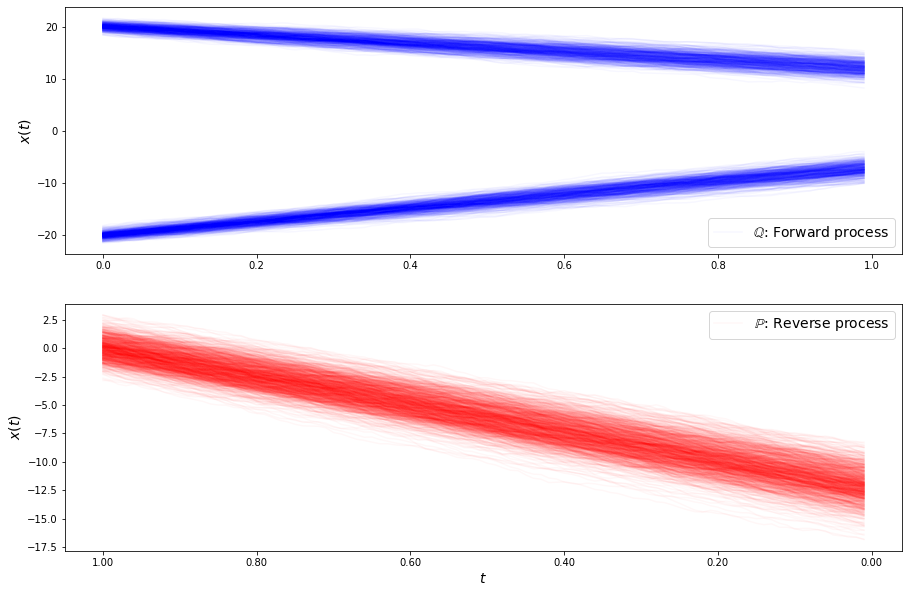

loss b 3.7731001437460026
loss b 3.805397980162448
loss b 3.765310865006818
loss b 3.7572331260502088
loss b 3.752229392384356
loss b 3.750465497844301
loss b 3.748255621080935
loss b 3.745547592825231
loss b 3.731111381901869
loss b 3.7414345630250825
loss b 3.7195531764447254
loss b 3.7046976429121017
loss b 3.717695785697879
loss b 3.7102105686041513
loss b 3.71404510477135
loss b 3.7006544803699195
loss b 3.7073964953460865
loss b 3.6799406786688893
loss b 3.6959564834671204
loss b 3.6731764417072292
loss b 3.6669736099558086
loss b 3.680785735103538
loss b 3.65525031254486
loss b 3.6595514903800574
loss b 3.685816278134441
loss b 3.6596385949147248
loss b 3.663531520368584
loss b 3.638124615224664
loss b 3.6423756710514636
loss b 3.651294730900774
loss f 4.023003406154996
loss f 4.012161007470161
loss f 4.027877389746808
loss f 4.010259791377357
loss f 4.0130742966841595
loss f 4.024748865639965
loss f 4.027533622622862
loss f 4.0269240829641
loss f 4.027019883181742
loss f 3.9959

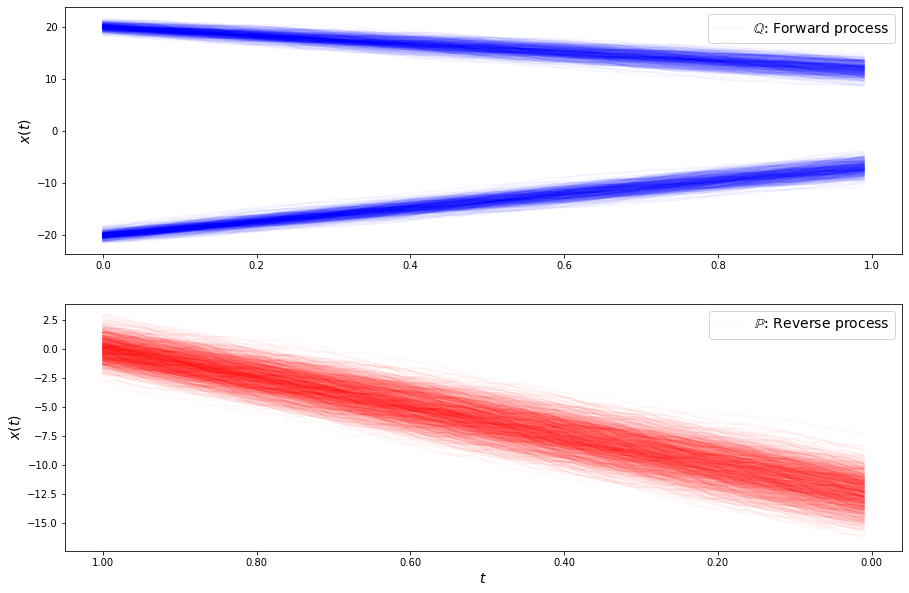

loss b 3.6639044702968206
loss b 3.6736483346472393
loss b 3.657842039480295
loss b 3.658112432816997
loss b 3.6637377512293208
loss b 3.6383929086841875
loss b 3.6412417698987363
loss b 3.6268246922617773
loss b 3.6348875061241364
loss b 3.6059895275053595
loss b 3.6184748373052003
loss b 3.628956478344924
loss b 3.599699738704278
loss b 3.6152910062368937
loss b 3.6268362451385285
loss b 3.6168507495686275
loss b 3.6056264005861705
loss b 3.5852594240332545
loss b 3.5955744597372865
loss b 3.583292986582502
loss b 3.587490815968768
loss b 3.563332667990215
loss b 3.5655739211106243
loss b 3.565142294390512
loss b 3.554703421056626
loss b 3.5634759881500604
loss b 3.551815135369506
loss b 3.576163435687164
loss b 3.5598527785891947
loss b 3.5299324792587035
loss f 3.9446086796718745
loss f 3.960951099189556
loss f 3.94629251550308
loss f 3.930818290103513
loss f 3.954639653626024
loss f 3.9432878908125755
loss f 3.9397325314035916
loss f 3.9439834416605244
loss f 3.9500067658055475
lo

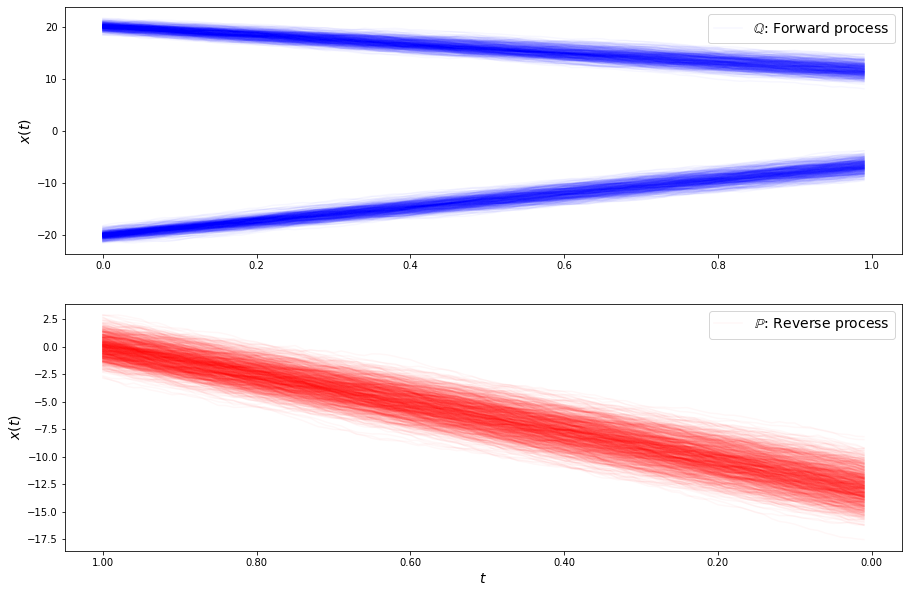

loss b 3.5651426635927495
loss b 3.550448747500251
loss b 3.5634305774930484
loss b 3.5485793325489445
loss b 3.5330661331481976
loss b 3.548250846318691
loss b 3.5298550787384753
loss b 3.5259135842955716
loss b 3.522067046339199
loss b 3.514833782898483
loss b 3.520610804522338
loss b 3.5056755485063382
loss b 3.4883828452717154
loss b 3.5095232120085456
loss b 3.4992578555854603
loss b 3.4734435111024786
loss b 3.508331963793839
loss b 3.4849756786110166
loss b 3.4646497902572553
loss b 3.4709572969000098
loss b 3.458938108327866
loss b 3.4602907949841106
loss b 3.459742369262586
loss b 3.4747978781101834
loss b 3.471166384621925
loss b 3.4637150217991213
loss b 3.47173453326474
loss b 3.43885076459824
loss b 3.4460321740478
loss b 3.4308290557198053
loss f 3.892522213100858
loss f 3.8825097268371396
loss f 3.891625744378071
loss f 3.899915984061316
loss f 3.889722693973171
loss f 3.895270674650774
loss f 3.8795162976538062
loss f 3.8839736399086777
loss f 3.8913699947998066
loss f 

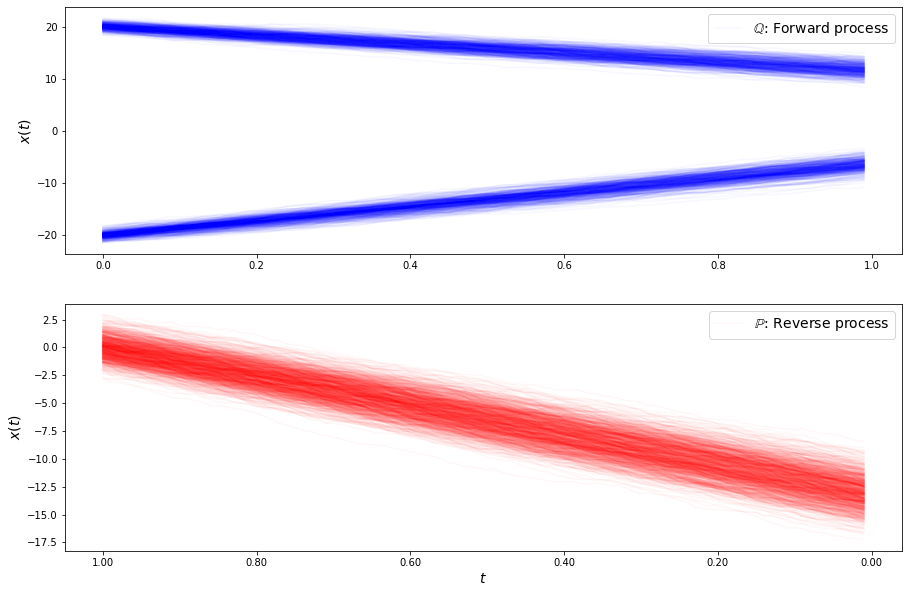

loss b 3.4407563220121067
loss b 3.44371633129041
loss b 3.430306117688898
loss b 3.4341117272277732
loss b 3.432197128424372
loss b 3.4364288715502718
loss b 3.411684035403026
loss b 3.3935487351562617
loss b 3.397667867415015
loss b 3.3953390400810592
loss b 3.3789633351191615
loss b 3.3820179292875863
loss b 3.3756800887411127
loss b 3.3959496278407446
loss b 3.3685313912834203
loss b 3.394138392231776
loss b 3.372580400740187
loss b 3.3583202276410637
loss b 3.3560010764035804
loss b 3.3684461701424624
loss b 3.354909880027673
loss b 3.3500139970475957
loss b 3.342313555320782
loss b 3.3574876217355762
loss b 3.3483444725316036
loss b 3.3496994444957267
loss b 3.338281916787719
loss b 3.3567798286733046
loss b 3.3440694449027584
loss b 3.367555532863318
loss f 3.853659684671154
loss f 3.860748048017529
loss f 3.850304011164489
loss f 3.8412104846109805
loss f 3.8650970109746687
loss f 3.8594969186239956
loss f 3.854776828049461
loss f 3.8447445301268997
loss f 3.8476550167562342
lo

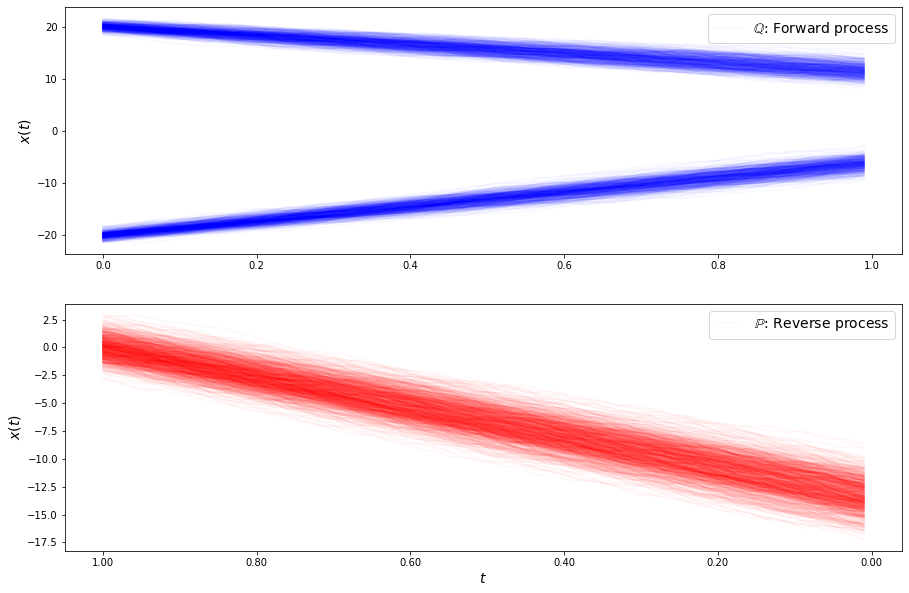

loss b 3.318508513809726
loss b 3.317943954361024
loss b 3.3298947027197956
loss b 3.3207661221733984
loss b 3.3271400509124445
loss b 3.290540772986239
loss b 3.295736060267343
loss b 3.293054112448951
loss b 3.295354988038708
loss b 3.290703379905782
loss b 3.2989153313550434
loss b 3.295953583858153
loss b 3.2771622229199697
loss b 3.2848091939095645
loss b 3.2738422110759617
loss b 3.272423186200994
loss b 3.2840351398349448
loss b 3.261386962879067
loss b 3.2666675911490115
loss b 3.2643019302779974
loss b 3.245856878242314
loss b 3.2803932145928485
loss b 3.2612015187280665
loss b 3.2351967731225164
loss b 3.243632321273311
loss b 3.258912869613155
loss b 3.2357573880405646
loss b 3.2573306787297023
loss b 3.2328975197632905
loss b 3.2552559092383317
loss f 3.853248512556123
loss f 3.836061613094313
loss f 3.831359533341038
loss f 3.829749607628874
loss f 3.8467680543232756
loss f 3.804925890173816
loss f 3.834942243184419
loss f 3.8087209713617987
loss f 3.8192087975036833
loss 

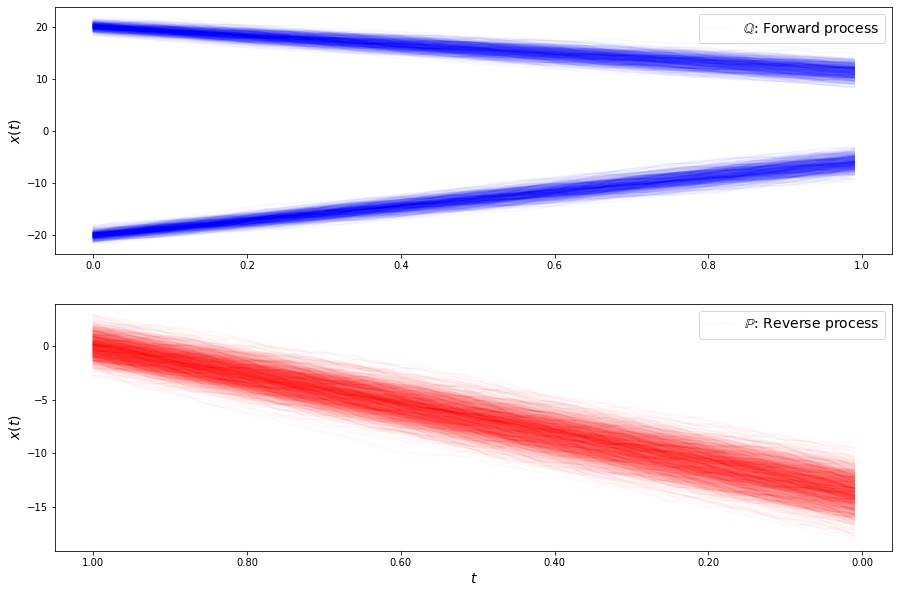

loss b 3.2194524469427734
loss b 3.1794891374265455
loss b 3.2017871589607716
loss b 3.194297854007039
loss b 3.195728954658889
loss b 3.194514962134035
loss b 3.1930089436086804
loss b 3.1800307005117205
loss b 3.1904367046417743
loss b 3.1814485900395044
loss b 3.188307062147014
loss b 3.1745422162756727
loss b 3.176462448106774
loss b 3.200362349514033
loss b 3.162548348263105
loss b 3.201855889060651
loss b 3.1541682100246415
loss b 3.174633819673451
loss b 3.1797267455226104
loss b 3.155055559277622
loss b 3.173427802863788
loss b 3.174394113434287
loss b 3.1511624907484586
loss b 3.1644083260554696
loss b 3.1615919564895063
loss b 3.1282606905462473
loss b 3.1535095289317145
loss b 3.143388749064758
loss b 3.1218719936400423
loss b 3.1807480819950125
loss f 3.830067573785225
loss f 3.8200850329714577
loss f 3.8164592794019185
loss f 3.822161806917388
loss f 3.813016037490319
loss f 3.8024805048066006
loss f 3.8006332236373113
loss f 3.7957586420953566
loss f 3.7945549245310386
lo

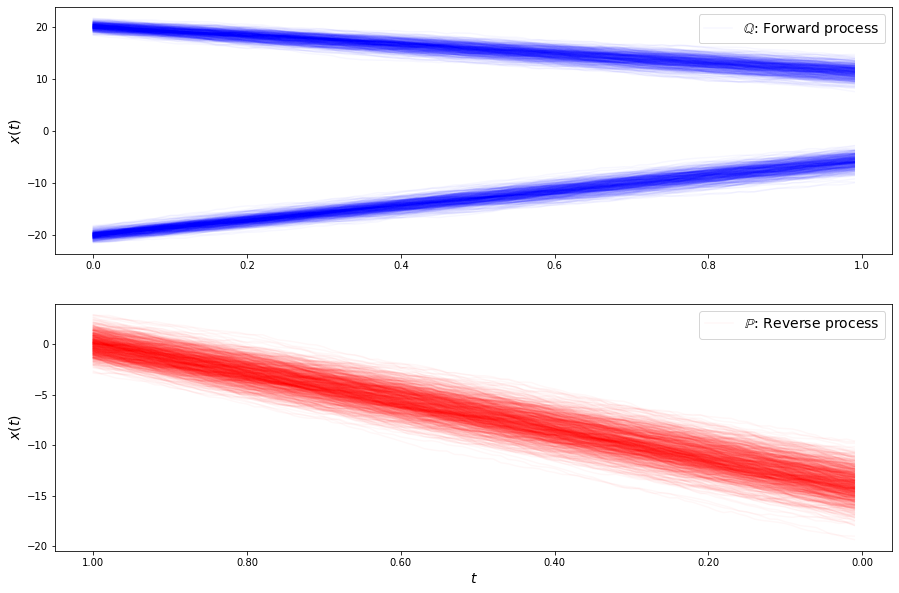

loss b 3.0678763654257835
loss b 3.0935162626059003
loss b 3.091584959319934
loss b 3.055143650696358
loss b 3.062796133207938
loss b 3.0838722359481108
loss b 3.0593514331544216
loss b 3.0834813409367987
loss b 3.093325166506181
loss b 3.0540714952999717
loss b 3.057666210865281
loss b 3.061123793688042
loss b 3.070453186305612
loss b 3.081630015861596
loss b 3.0899709540353806
loss b 3.042857576584875
loss b 3.0536985791829423
loss b 3.05062988015421
loss b 3.032294619710942
loss b 3.04466047769993
loss b 3.0320730591830847
loss b 3.073126895713126
loss b 3.057118283469632
loss b 3.0585181160970287
loss b 3.064563194757219
loss b 3.0328318031206556
loss b 3.0423662061819954
loss b 3.0438620035119253
loss b 3.024975749860671
loss b 3.037431847377659
loss f 3.8042980885270072
loss f 3.7909279709793187
loss f 3.8041960253354272
loss f 3.807447317969508
loss f 3.7856703303983754
loss f 3.792282069024801
loss f 3.7912953275060013
loss f 3.784685966496718
loss f 3.767427024704613
loss f 3.

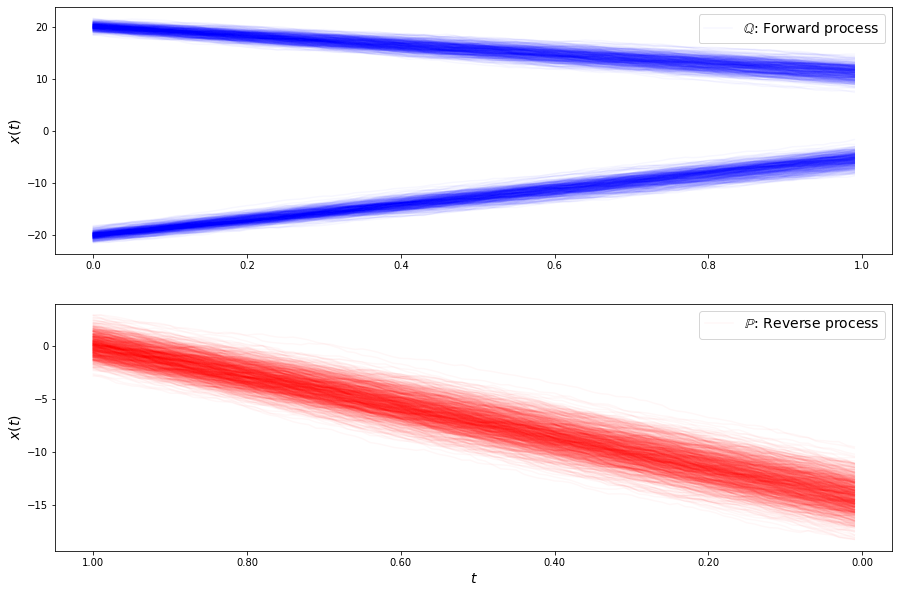

loss b 2.9585879993586457
loss b 2.958240957650704
loss b 2.960267071215534
loss b 2.9452719315265847
loss b 2.955223840153497
loss b 2.9507505193700756
loss b 2.956376777303884
loss b 2.9463311553146294
loss b 2.9508225032223705
loss b 2.9539702263339183
loss b 2.946784331319111
loss b 2.948211579369114
loss b 2.9407446333423968
loss b 2.9263443179419455
loss b 2.9178622303057975
loss b 2.9322474889375862
loss b 2.94071053710403
loss b 2.917780314086184
loss b 2.931531702465994
loss b 2.914751034718371
loss b 2.9455990364117888
loss b 2.92859118234033
loss b 2.919585576756381
loss b 2.9106650844052875
loss b 2.932620098231859
loss b 2.8975140092249996
loss b 2.893812870470911
loss b 2.915655750391934
loss b 2.940928017999871
loss b 2.9302154647848355
loss f 3.7633251149841636
loss f 3.7518444052233995
loss f 3.763142313957448
loss f 3.7705482717520074
loss f 3.7620167701454466
loss f 3.743203886106892
loss f 3.7447113144862785
loss f 3.754202279663883
loss f 3.7195236189162055
loss f 

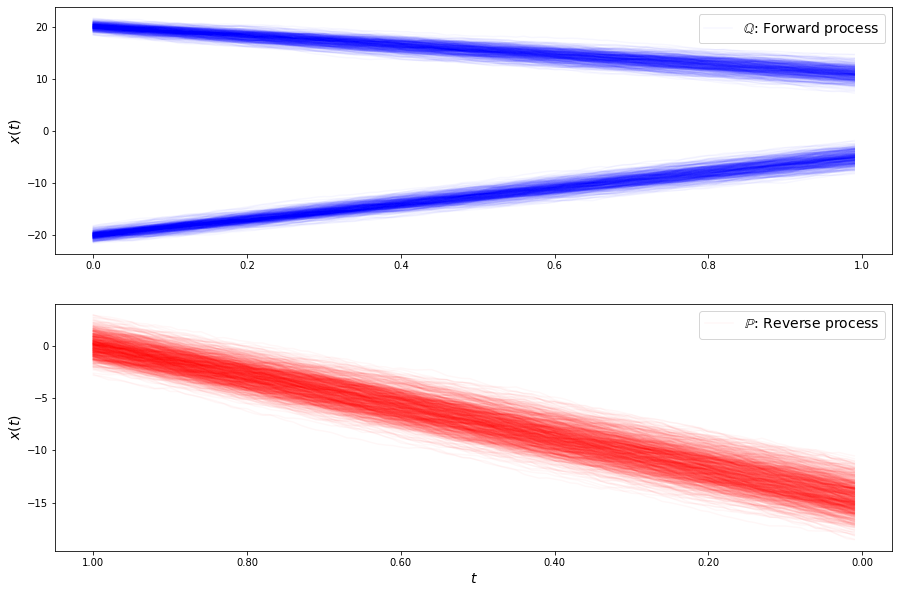

loss b 2.8314364206562965
loss b 2.8401601659330473
loss b 2.8219843568702565
loss b 2.8080678727098736
loss b 2.828433747014313
loss b 2.7995677754730166
loss b 2.8120923039395462
loss b 2.811011276557209
loss b 2.817178001710613
loss b 2.790303140972719
loss b 2.7983385179743396
loss b 2.818197549401478
loss b 2.818621135712265
loss b 2.815995355853165
loss b 2.8164911448791634
loss b 2.8025846429868526
loss b 2.787238224211026
loss b 2.774970086124194
loss b 2.786901581728078
loss b 2.782940323153805
loss b 2.781881704813864
loss b 2.778795317490544
loss b 2.761957278727433
loss b 2.7899078391869585
loss b 2.734979739473744
loss b 2.7676046706848587
loss b 2.797695694624425
loss b 2.7594372881962324
loss b 2.7852859232373866
loss b 2.762078380828778
loss f 3.72408286099086
loss f 3.710404623980074
loss f 3.7240763688533756
loss f 3.7031549072126664
loss f 3.7105338432262838
loss f 3.693715314230184
loss f 3.697788847373877
loss f 3.6696664436300184
loss f 3.675969763837513
loss f 3.

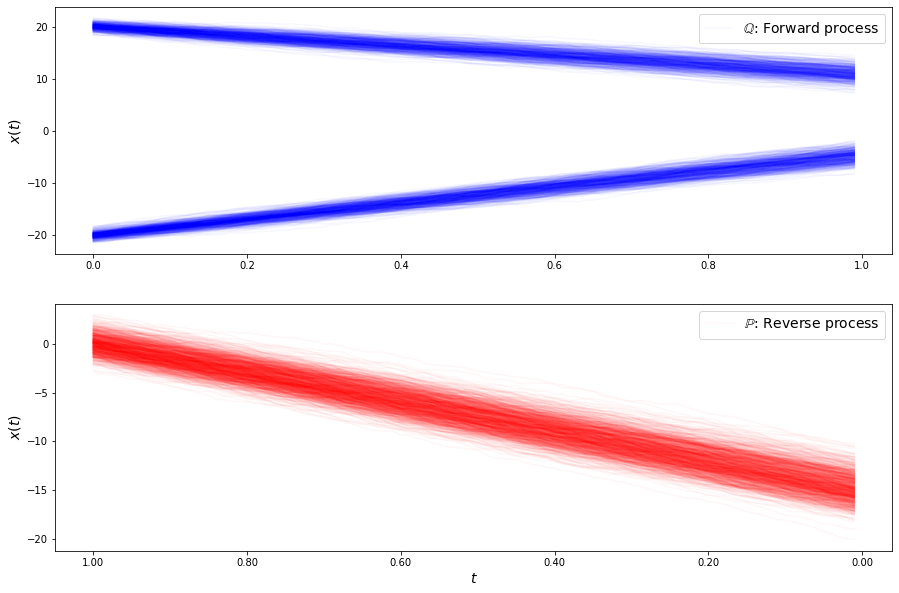

loss b 2.7381937681670894
loss b 2.7193796472856255
loss b 2.7346298976427756
loss b 2.7120627034732663
loss b 2.72234499398326
loss b 2.6748846999628664
loss b 2.684332314104178
loss b 2.701931129653597
loss b 2.687743342219005
loss b 2.6885957493807715
loss b 2.7010818345919727
loss b 2.684774819792965
loss b 2.6998607269008974
loss b 2.6624017208980084
loss b 2.639410382767905
loss b 2.692242634273731
loss b 2.6706737834932572
loss b 2.6971528237538402
loss b 2.6801899706776067
loss b 2.669031065809361
loss b 2.650518679346758
loss b 2.668868581435133
loss b 2.6648664842923453
loss b 2.625569187063311
loss b 2.6143960511733195
loss b 2.6753644036561655
loss b 2.6152014473633103
loss b 2.6586353255200637
loss b 2.6278451936127607
loss b 2.6556077236284463
loss f 3.671945099882174
loss f 3.6788155987576867
loss f 3.6783903704074086
loss f 3.652029663161968
loss f 3.64695345972585
loss f 3.6533350864643874
loss f 3.662008640846398
loss f 3.651073753191747
loss f 3.6579532198431153
loss

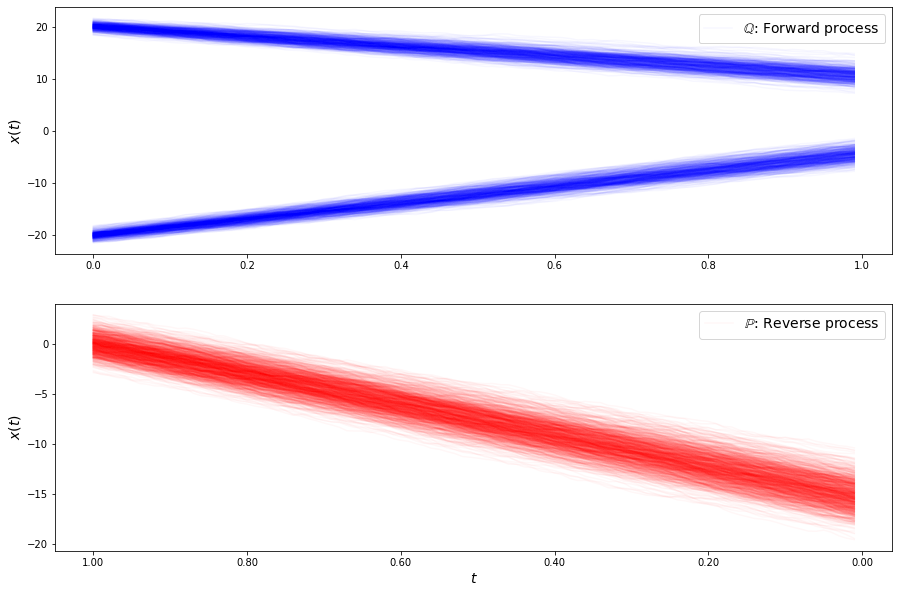

loss b 2.611978867637971
loss b 2.629494144445735
loss b 2.594493206166841
loss b 2.592763815902197
loss b 2.5459839168376934
loss b 2.6084334159411835
loss b 2.611088631981983
loss b 2.567139504118441
loss b 2.582044214269583
loss b 2.565711172101384
loss b 2.5674059318671723
loss b 2.564089717172956
loss b 2.5487193924268907
loss b 2.541211331228853
loss b 2.528935576957845
loss b 2.565466968398943
loss b 2.5378165256814
loss b 2.5726485505058068
loss b 2.5284725731329387
loss b 2.547916716244009
loss b 2.5122413727951853
loss b 2.557768798189225
loss b 2.5288531322712933
loss b 2.529742580640413
loss b 2.5608811636435274
loss b 2.539668156396763
loss b 2.509275696325149
loss b 2.4909693270934836
loss b 2.527415486564833
loss b 2.5736854225016863
loss f 3.6150530745135794
loss f 3.6168757906856364
loss f 3.636484673461726
loss f 3.6222155837030843
loss f 3.6111123100241236
loss f 3.6013470899364783
loss f 3.5973463827818013
loss f 3.6204837483044363
loss f 3.5996722291727736
loss f 3

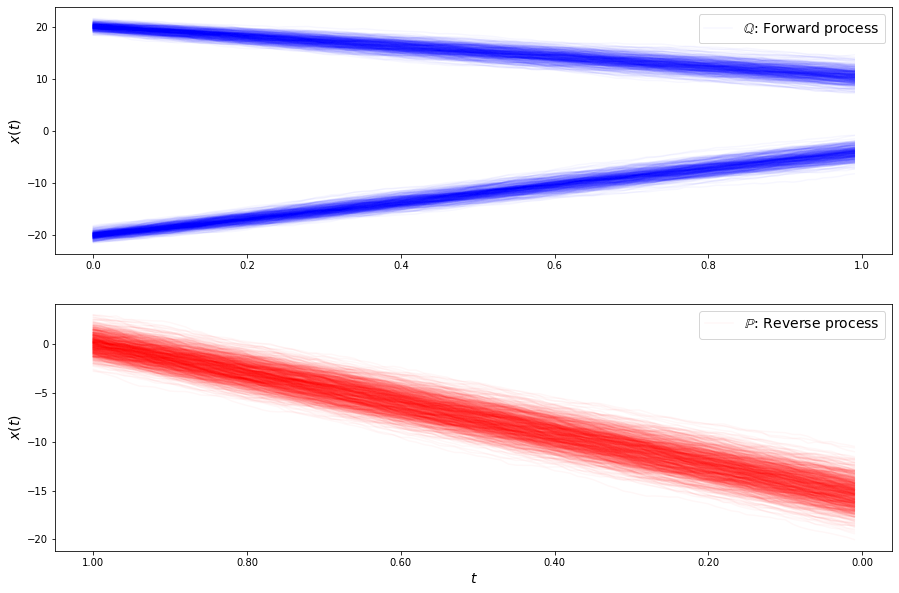

loss b 2.467494932511535
loss b 2.4960369394281146
loss b 2.4964281878656376
loss b 2.495229125866527
loss b 2.4670711821299163
loss b 2.4923353460864837
loss b 2.4567426547845836
loss b 2.4479156476714827
loss b 2.460621983350954
loss b 2.480598230065362
loss b 2.4542205654427067
loss b 2.4570605984113953
loss b 2.440893999746099
loss b 2.435310625960331
loss b 2.3915927634927563
loss b 2.4359737186923156
loss b 2.4044148183045624
loss b 2.411848177511873
loss b 2.4297746686264783
loss b 2.4363084121560594
loss b 2.3861510159231787
loss b 2.411138565552096
loss b 2.4016274869222713
loss b 2.4087845281003863
loss b 2.401887043589772
loss b 2.362213162301541
loss b 2.3784661862540917
loss b 2.3818909305478972
loss b 2.4153451064714617
loss b 2.3842829382253994
loss f 3.5846873777966426
loss f 3.5952914149634054
loss f 3.5723859882136386
loss f 3.5833278341959756
loss f 3.5513879403257675
loss f 3.5567824856692902
loss f 3.5468835765715436
loss f 3.5456338454987404
loss f 3.5443974613946

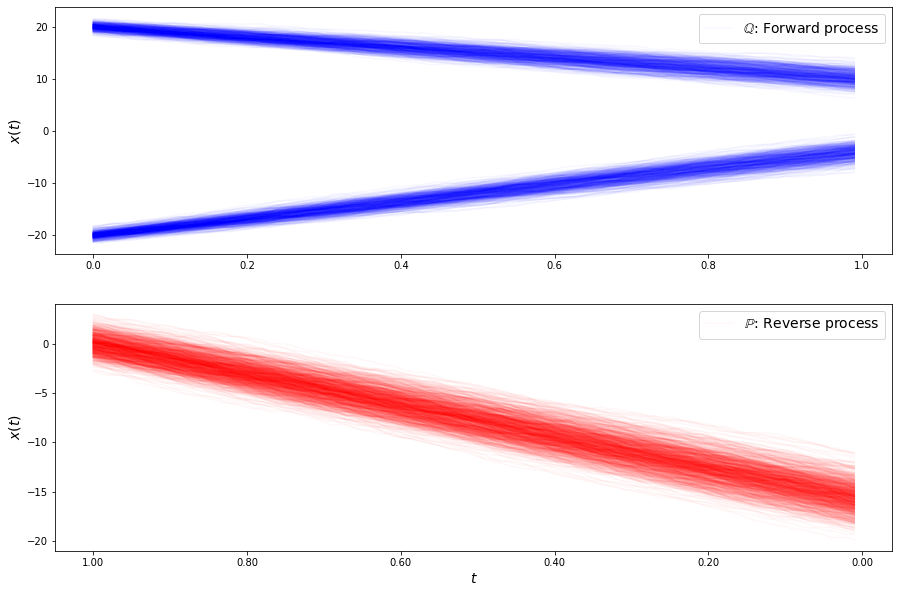

loss b 2.3167674655506794
loss b 2.3495864114675484
loss b 2.356262373263961
loss b 2.3097508255648465
loss b 2.3216501965594096
loss b 2.3147877366359437
loss b 2.279800300731182
loss b 2.308754106556839
loss b 2.3235281086015904
loss b 2.3079345067191794
loss b 2.3093322649459624
loss b 2.3184986554944005
loss b 2.276738880566163
loss b 2.2879972355658653
loss b 2.324559115496686
loss b 2.308115967537159
loss b 2.264580507123661
loss b 2.286702628898108
loss b 2.2820862388089402
loss b 2.2860197607410635
loss b 2.2527666383789566
loss b 2.2676617427423937
loss b 2.2783483286668447
loss b 2.2987078157852867
loss b 2.2881441417451267
loss b 2.2761976144543405
loss b 2.277306615740188
loss b 2.262435518528929
loss b 2.251323830775012
loss b 2.2404072364550633
loss f 3.5168684898072993
loss f 3.4969082128972877
loss f 3.513084754653937
loss f 3.507822813960712
loss f 3.4901560096311997
loss f 3.4940198749592746
loss f 3.46014482261107
loss f 3.463101561375333
loss f 3.4658006678962923
lo

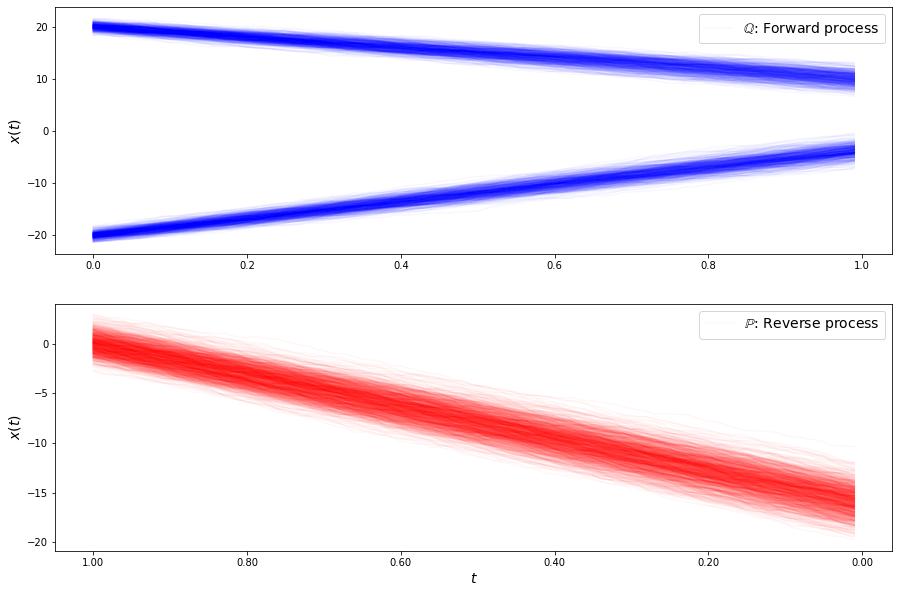

loss b 2.18574969276367
loss b 2.2231513478043636
loss b 2.1528377684237565
loss b 2.24782430597123
loss b 2.1822293720803247
loss b 2.151779581573945
loss b 2.1831449438420174
loss b 2.185581041290091
loss b 2.1433934696074757
loss b 2.1847904680086208
loss b 2.2053007751910645
loss b 2.1669512974034215
loss b 2.1955944964098175
loss b 2.1833459159342388
loss b 2.1577816234460756
loss b 2.1822667516967154
loss b 2.1468589310335107
loss b 2.165948778554599
loss b 2.1287426343060494
loss b 2.16222100187811
loss b 2.1196936287926635
loss b 2.1815583650954404
loss b 2.118076962975781
loss b 2.1534247341828614
loss b 2.083190081583166
loss b 2.1610580444032004
loss b 2.11075955985498
loss b 2.1214563156656534
loss b 2.1147389485609045
loss b 2.122632007244693
loss f 3.4196556816048314
loss f 3.4107529096333575
loss f 3.399332634408759
loss f 3.393421206041653
loss f 3.3745073024858163
loss f 3.3594725296628543
loss f 3.373867336801699
loss f 3.3552572741345084
loss f 3.378202873934427
loss

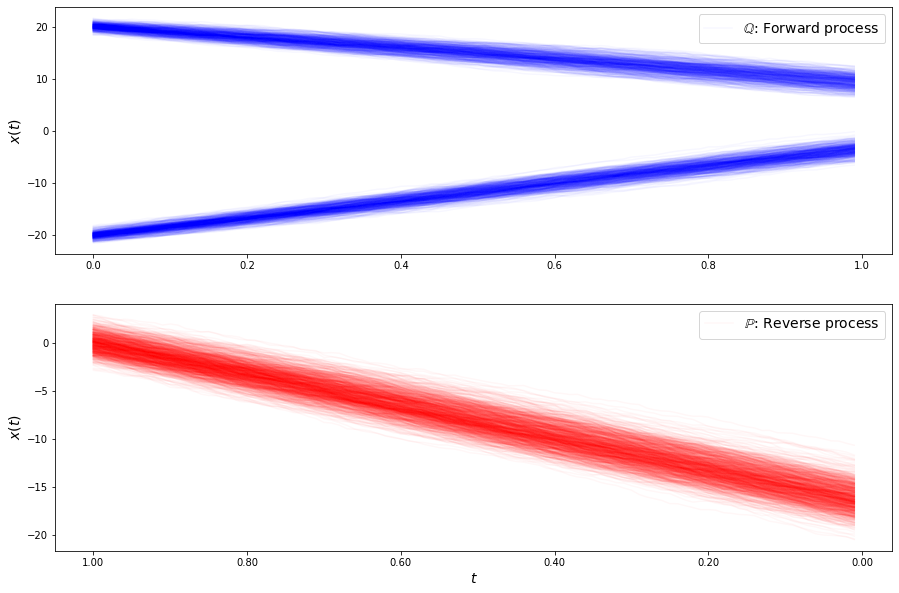

loss b 2.077330437876254
loss b 2.0429281235404617
loss b 1.997545189765641
loss b 2.045619404858106
loss b 2.0405720561380316
loss b 2.0155712183607877
loss b 2.082000175316829
loss b 2.0023255744196926
loss b 2.072676430692902
loss b 2.0378284071463413
loss b 1.9913257014288648
loss b 2.0010578441776983
loss b 2.0016608268654403
loss b 2.0156550197476863
loss b 2.030313760208998
loss b 1.9896464786662045
loss b 2.0173116376044162
loss b 1.9841742956062562
loss b 1.9772890956135352
loss b 1.9861535626623168
loss b 2.0099117968382654
loss b 1.9420202523663435
loss b 2.0117548708111754
loss b 1.9799095904739958
loss b 1.9565488771403337
loss b 1.959228775351129
loss b 1.9344394315318307
loss b 1.9457421581965972
loss b 1.9472473910388537
loss b 1.9475664482120476
loss f 3.272054713298885
loss f 3.2649017592942147
loss f 3.2357090785626434
loss f 3.263031946603025
loss f 3.245524509935339
loss f 3.250952805451796
loss f 3.2404553828364038
loss f 3.2279854833059223
loss f 3.22087336417688

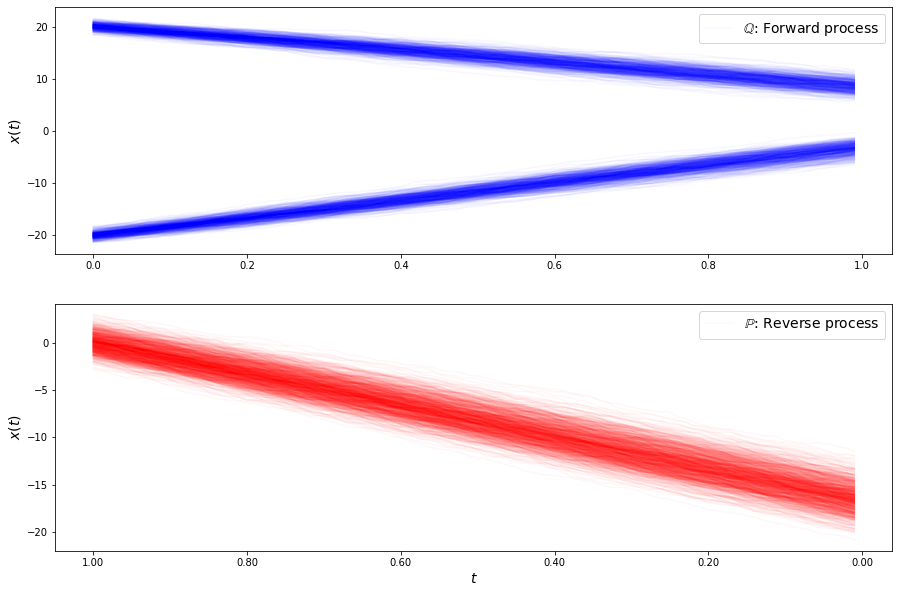

loss b 1.9000304565022368
loss b 1.8510058005647578
loss b 1.864061704185497
loss b 1.9538422465251837
loss b 1.8955353464806186
loss b 1.8923980537612275
loss b 1.8833504059505812
loss b 1.827733087935196
loss b 1.873844628496937
loss b 1.869291333847071
loss b 1.793285817715835
loss b 1.8364194093624728
loss b 1.8004604017592505
loss b 1.815212645719818
loss b 1.9115307699598163
loss b 1.8077156217078658
loss b 1.796047028754928
loss b 1.8307720864799704
loss b 1.8572890329496765
loss b 1.8465277815045131
loss b 1.817551613397888
loss b 1.8073289631031098
loss b 1.8113340266223619
loss b 1.8352272881382699
loss b 1.782823200508083
loss b 1.775534899221091
loss b 1.821802731841581
loss b 1.8236707511244143
loss b 1.7535742061592297
loss b 1.7743815772779807
loss f 3.128863582307754
loss f 3.1235028938824163
loss f 3.1039826925804745
loss f 3.1281309709486353
loss f 3.105072398890039
loss f 3.1226984558760003
loss f 3.0870681849820634
loss f 3.1039163991583747
loss f 3.117357811775934


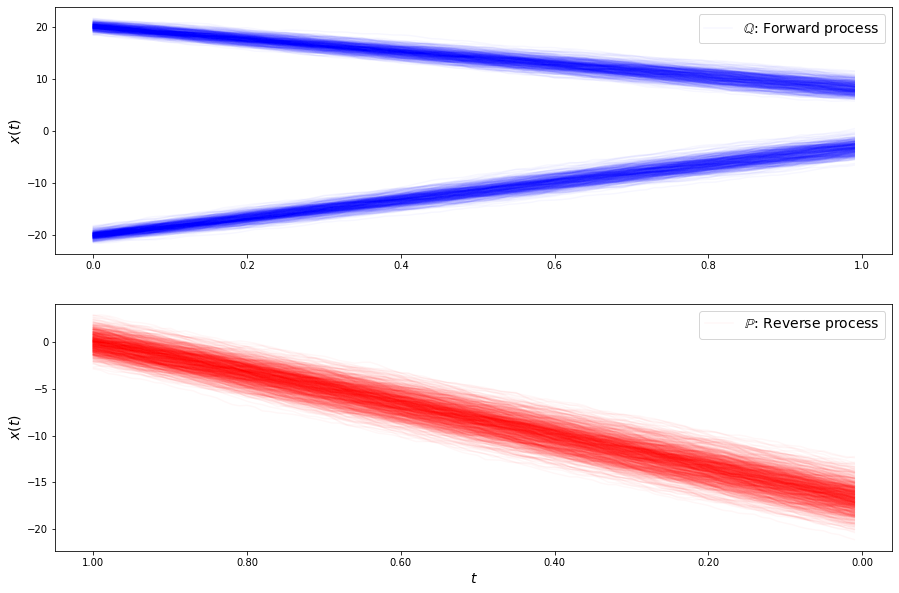

loss b 1.7750950697680756
loss b 1.7625033236087004
loss b 1.6614444671746809
loss b 1.719150589942239
loss b 1.6900133929994563
loss b 1.7454388053793743
loss b 1.6750778562631048
loss b 1.678582613685728
loss b 1.6782389572161673
loss b 1.644441970469591
loss b 1.7259813959630015
loss b 1.6770252118473055
loss b 1.6616890869269894
loss b 1.6879726915139532
loss b 1.647932876333851
loss b 1.6345686612574433
loss b 1.7062219763270787
loss b 1.673200709012355
loss b 1.6067232472163109
loss b 1.6440559940122603
loss b 1.630820966826372
loss b 1.6481554882775056
loss b 1.6327947795846662
loss b 1.6160002929925545
loss b 1.596761421056306
loss b 1.6192491822077255
loss b 1.637263879921244
loss b 1.5390729706130721
loss b 1.6278708973397336
loss b 1.6688776341868312
loss f 3.027880584342276
loss f 3.0352769708876886
loss f 3.026204568079077
loss f 3.041487374292728
loss f 3.0230328439309258
loss f 3.0329508969117707
loss f 3.002587370149405
loss f 3.0056896024429656
loss f 3.02281866128135


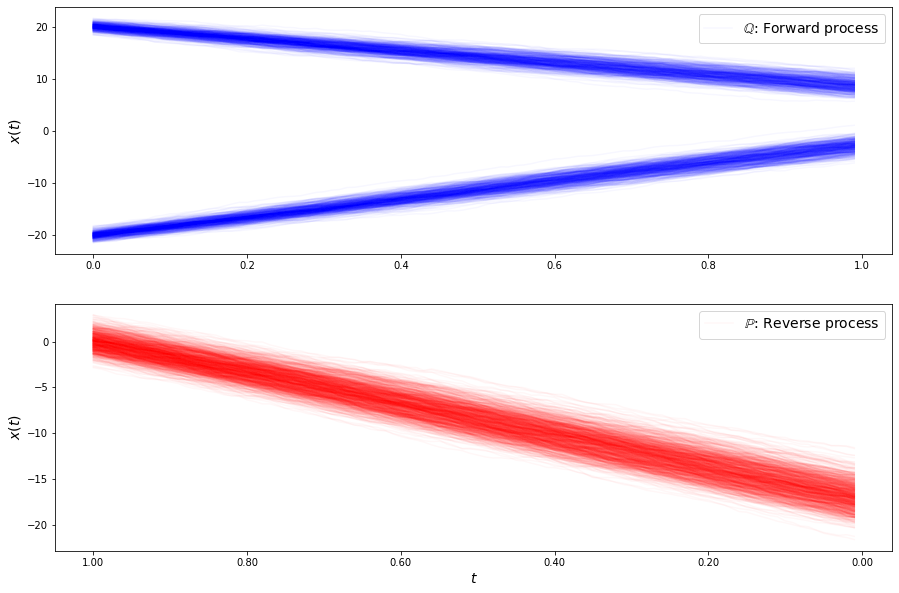

loss b 1.5583265477702646
loss b 1.5669991219507424
loss b 1.531948747906
loss b 1.5768339394864186
loss b 1.5668841540116507
loss b 1.4729938149042028
loss b 1.5265805924303322
loss b 1.5005080933010613
loss b 1.4846074664502382
loss b 1.4852818956353135
loss b 1.524391010135246
loss b 1.527256866271838
loss b 1.4968981650573103
loss b 1.4642135739703315
loss b 1.4456347309410482
loss b 1.5025637985383944
loss b 1.4586632164899347
loss b 1.5109746406758087
loss b 1.4380853885155653
loss b 1.4141797375940752
loss b 1.4785387968639674
loss b 1.4837499961040874
loss b 1.5245889633250473
loss b 1.4371394522928271
loss b 1.4279878985060073
loss b 1.3766307645851283
loss b 1.4558723537749119
loss b 1.4886110914223503
loss b 1.4313862512980844
loss b 1.4492361571375372
loss f 3.020970136119867
loss f 3.010913527571874
loss f 3.0275765612496848
loss f 3.054689103169133
loss f 3.0113229758636484
loss f 3.0099874855108477
loss f 3.0204762476891047
loss f 2.989347769412898
loss f 3.0155298934002

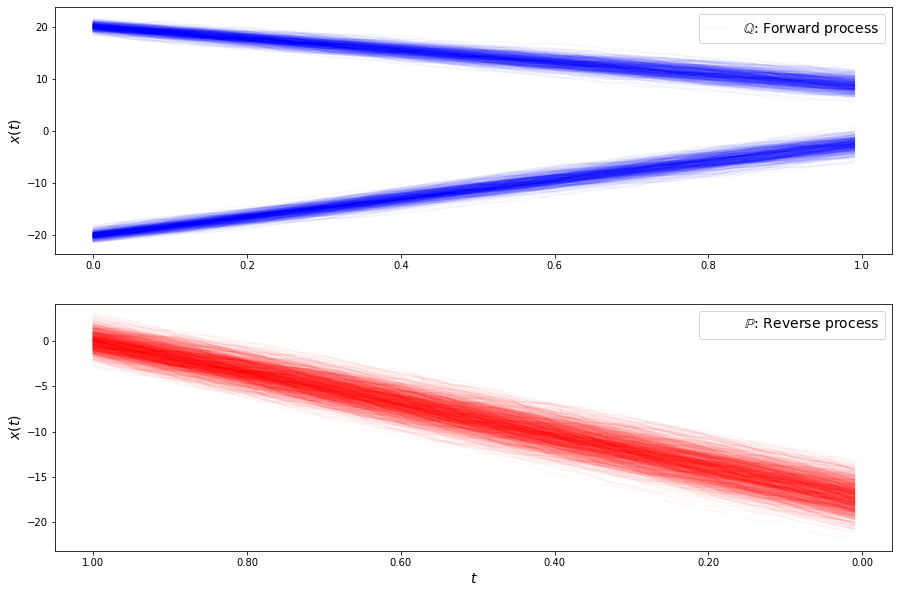

loss b 1.3351180717489168
loss b 1.3911739911153367
loss b 1.3142693226554543
loss b 1.361277002727539
loss b 1.2308330860428882
loss b 1.368165608955842
loss b 1.2757149482082373
loss b 1.3495612667680044
loss b 1.2699444592527007
loss b 1.286715700356725
loss b 1.2593608594152896
loss b 1.3184649843764704
loss b 1.3275347430924611
loss b 1.3199212884570863
loss b 1.2773674002521698
loss b 1.2745218578809243
loss b 1.2916136998398906
loss b 1.2442234759372939
loss b 1.2487841454930217
loss b 1.2688158611906073
loss b 1.3010917376699007
loss b 1.2382457975417742
loss b 1.2403983533600902
loss b 1.2653313437629061
loss b 1.2365530717777296
loss b 1.2309909265942642
loss b 1.19400391396318
loss b 1.206213099675684
loss b 1.2102846751265162
loss b 1.191154988211042
loss f 3.0575833442251468
loss f 3.0152974923026212
loss f 2.9936895974355666
loss f 3.012829389348052
loss f 2.991191182343573
loss f 2.9791516153818747
loss f 2.9842637918156343
loss f 2.9753874863657357
loss f 2.951759964071

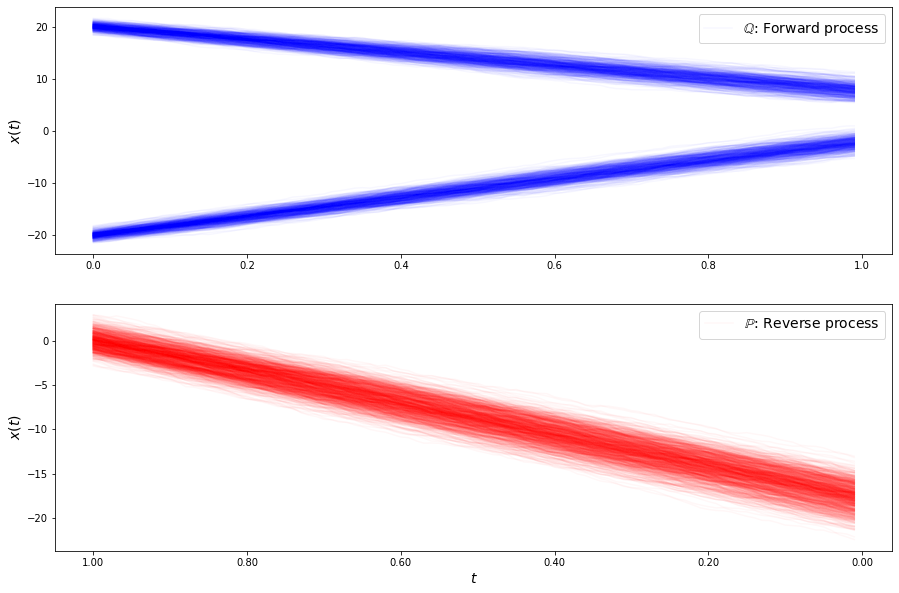

loss b 1.1848020997910476
loss b 1.0749533706471517
loss b 1.0377168639517578
loss b 1.0646270133149691
loss b 1.0837873107567522
loss b 1.0934206728481386
loss b 1.0855910492323244
loss b 0.9595803946601684
loss b 1.104797716928039
loss b 1.1154046476725952
loss b 1.0808848409923884
loss b 1.0468045934281176
loss b 1.1154772425456254
loss b 1.042527196046588
loss b 0.9918387868473737
loss b 1.087780838276717
loss b 1.0042562418448684
loss b 1.0628718247501185
loss b 1.0538196343942008
loss b 0.958566320188626
loss b 1.0630395758035258
loss b 1.0220127901166363
loss b 0.9977484819490636
loss b 0.9769559126459958
loss b 1.0084872703956789
loss b 0.9439153418691794
loss b 1.0116958274185333
loss b 0.9891870569836348
loss b 0.9954075276407218
loss b 0.9937042126108678
loss f 2.7883574121914974
loss f 2.822057653877792
loss f 2.8375150634393145
loss f 2.829637303369385
loss f 2.8483643928805424
loss f 2.8548991435237943
loss f 2.8380285913876153
loss f 2.837491740427376
loss f 2.8336500547

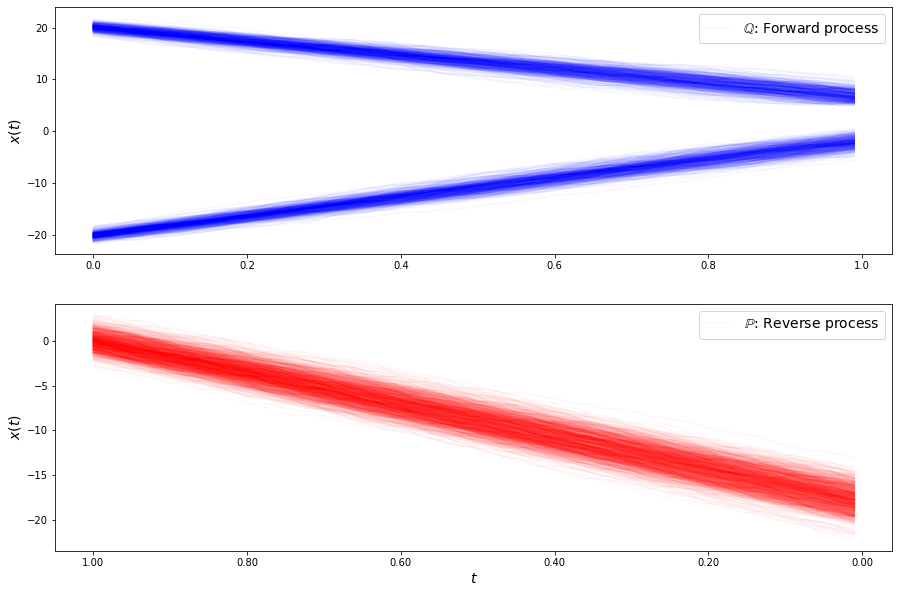

loss b 0.910397818887546
loss b 0.8529137148376722
loss b 0.8248146594092153
loss b 0.9049215661119407
loss b 0.9077708436718197
loss b 0.8418524977083237
loss b 0.8327932734827358
loss b 0.7812346053126005
loss b 0.8496514036937786
loss b 0.7156253474000246
loss b 0.8781205731608092
loss b 0.8785921649452372
loss b 0.7250868181325686
loss b 0.8054190366121474
loss b 0.799421466723633
loss b 0.785079534153722
loss b 0.7790040781328095
loss b 0.8438407996306291
loss b 0.7235998326491758
loss b 0.6727603516562739
loss b 0.7569169247385678
loss b 0.7309938321879793
loss b 0.7846274319832115
loss b 0.840301881058188
loss b 0.7321310845364469
loss b 0.7017740396872445
loss b 0.7997765902888329
loss b 0.6508775211792323
loss b 0.7326741882833611
loss b 0.7551606715663591
loss f 2.923954001300749
loss f 2.931798994300555
loss f 3.016839211462651
loss f 2.922381209056674
loss f 2.9758293012042323
loss f 2.963260221970132
loss f 2.9755876562898322
loss f 2.952812327123509
loss f 2.9861605312671

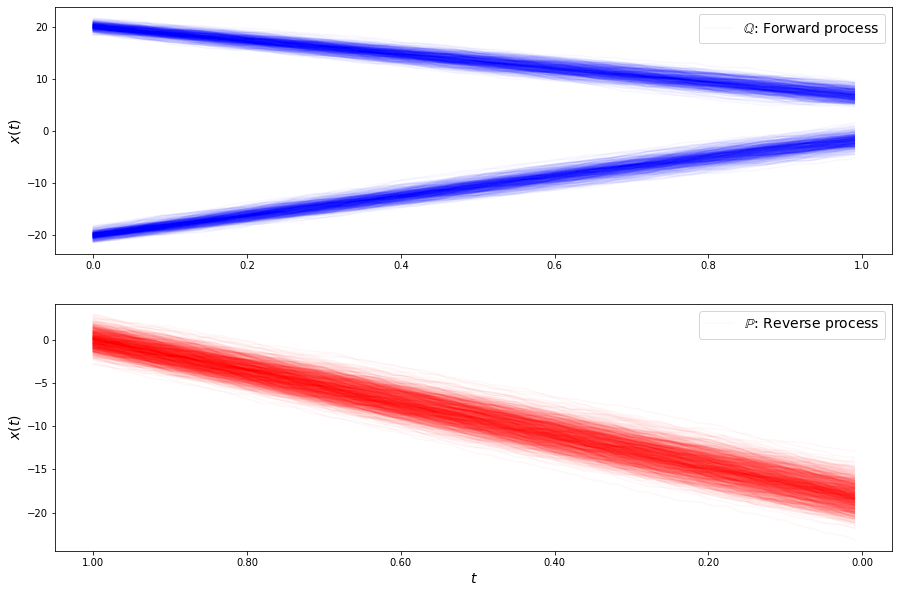

loss b 0.5939201899178731
loss b 0.5736643418737206
loss b 0.5173495416519003
loss b 0.5557420878485072
loss b 0.5895978103483636
loss b 0.5359332026951229
loss b 0.5189793474274506
loss b 0.6124045819001134
loss b 0.5632803024343928
loss b 0.6601118356326833
loss b 0.46814822878721357
loss b 0.5438108719075081
loss b 0.49162485875886425
loss b 0.4688124111002115
loss b 0.5738378559329036
loss b 0.5305082428629471
loss b 0.4629552306871637
loss b 0.5317159040966253
loss b 0.48925025993147503
loss b 0.4918684412972231
loss b 0.3905614811409866
loss b 0.48726748851916263
loss b 0.35773033762855644
loss b 0.45659358311026865
loss b 0.47703310837160556
loss b 0.46608583032044354
loss b 0.4283470519457297
loss b 0.40890415669813185
loss b 0.4962926994951695
loss b 0.5523936338440396
loss f 2.746806343986069
loss f 2.7802814356672303
loss f 2.7478401947268805
loss f 2.6943756908296677
loss f 2.7504570823906285
loss f 2.6376993226803447
loss f 2.699603722575193
loss f 2.686859106563233
loss f

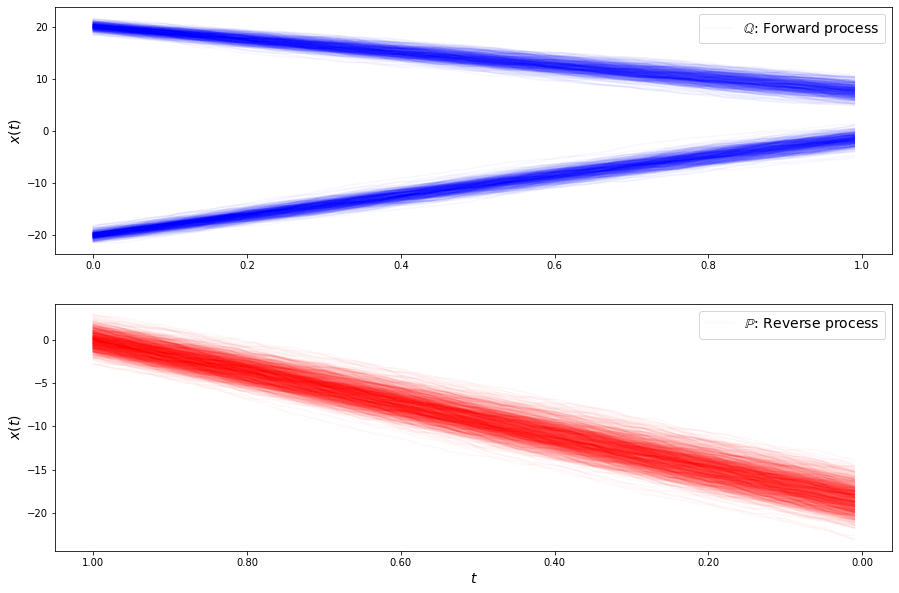

loss b 0.31584808216345955
loss b 0.27887261257964296
loss b 0.34853944509216395
loss b 0.3094056203999982
loss b 0.2608114045112467
loss b 0.285197956385998
loss b 0.38747621473583066
loss b 0.37335153032225793
loss b 0.2590939378979247
loss b 0.24853257983793828
loss b 0.21038256685613815
loss b 0.1693197818009773
loss b 0.28174083987016346
loss b 0.2645280211504462
loss b 0.24334565988978102
loss b 0.19579569815898928
loss b 0.21167152028954414
loss b 0.24456426172512002
loss b 0.11975992252830178
loss b 0.10491825730173174
loss b 0.15808970431604644
loss b 0.08569984995480583
loss b 0.2055598100611579
loss b 0.09507527825023046
loss b 0.188982009976588
loss b 0.14649927275821567
loss b 0.19864880485380124
loss b 0.16259339712759588
loss b 0.2512321380922055
loss b 0.12795793572092773
loss f 2.757148321655677
loss f 2.7284289382962976
loss f 2.6858567115613092
loss f 2.7253092032315593
loss f 2.7205722826732783
loss f 2.7268151157923146
loss f 2.7481386906356593
loss f 2.76973620463

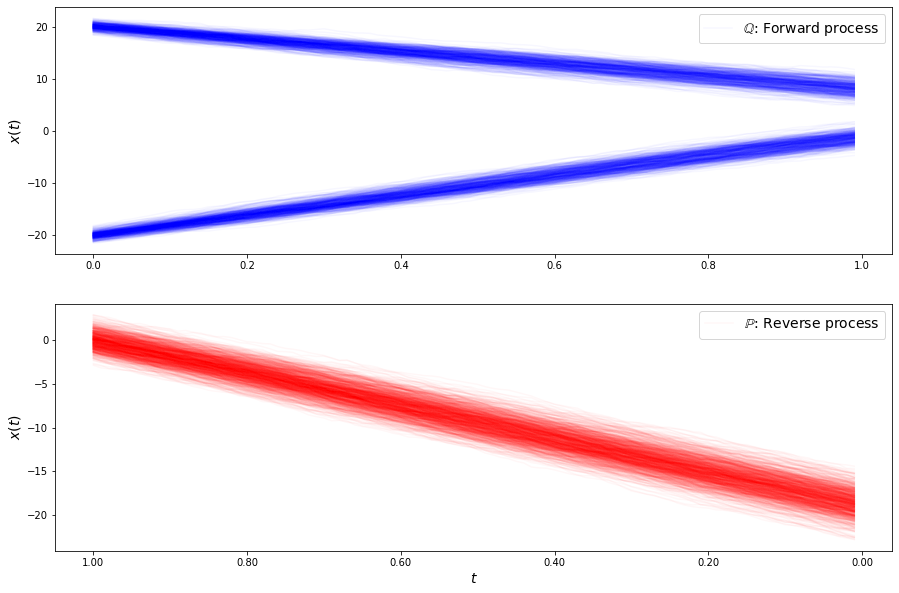

loss b 0.016660589820065734
loss b 0.03195509329732854
loss b 0.029439195313560977
loss b 0.04787710242875571
loss b -0.0009555810040343692
loss b -0.10549255192107437
loss b 0.0389159059006266
loss b -0.05584380404763571
loss b 0.00020802259172426427
loss b -0.13844843711247223
loss b -0.06990543653259368
loss b -0.06647727024272954
loss b 0.017970682501225712
loss b -0.0524833564247432
loss b -0.1716525598347819
loss b -0.05144656412712746
loss b -0.021635853859994007
loss b -0.20952476894032016
loss b -0.07980950121581841
loss b -0.08230571501918921
loss b -0.13892955202595347
loss b -0.1816520429822383
loss b -0.24931308745467032
loss b -0.13177623387920936
loss b -0.06391135329623421
loss b -0.30504717404013937
loss b -0.20549684508874402
loss b -0.21570384497089928
loss b -0.27485427515215277
loss b -0.07130422374736047
loss f 2.937615364454607
loss f 2.9557298628587008
loss f 2.9384618805021128
loss f 2.9807334179027856
loss f 2.9707538140653416
loss f 2.966434937579834
loss f 2

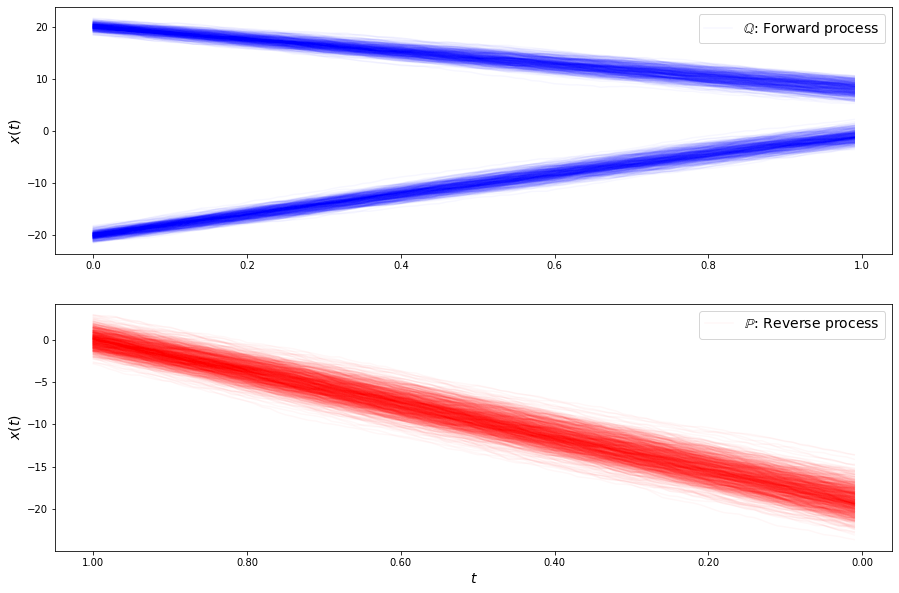

loss b -0.2955375210786678
loss b -0.29042984235640956
loss b -0.21149724502706016
loss b -0.3611306997763095
loss b -0.23050352636875784
loss b -0.3639154824195099
loss b -0.44773173182186493
loss b -0.242383900028512
loss b -0.3966651704723805
loss b -0.40989235058764123
loss b -0.31024569679904757
loss b -0.36747575220349105
loss b -0.4521216834757909
loss b -0.39374967445175785
loss b -0.43090225865668236
loss b -0.26907793377007444
loss b -0.496281434632236
loss b -0.4969587391099802
loss b -0.43565024774681244
loss b -0.5699272603897495
loss b -0.3951776851141042
loss b -0.2997043059148619
loss b -0.4236043603357181
loss b -0.3510659651031312
loss b -0.3461218998695499
loss b -0.3847560435647908
loss b -0.5787287016209222
loss b -0.4432352304000316
loss b -0.43660101309410865
loss b -0.4434127084992125
loss f 3.017748845527527
loss f 3.00630882094552
loss f 2.940475867995722
loss f 2.9427407814292694
loss f 2.9107568969499575
loss f 2.943547784200006
loss f 2.923808092225641
loss

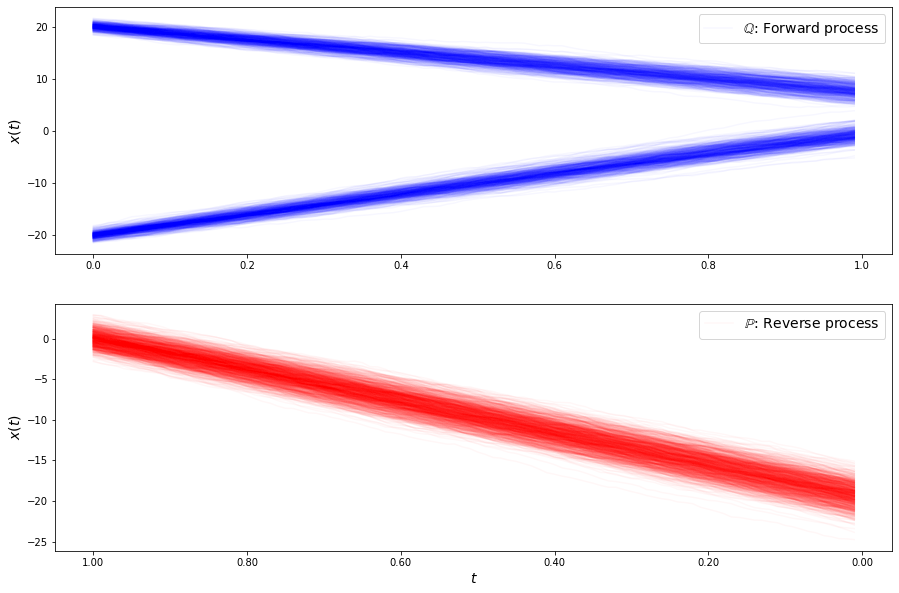

loss b -0.5431687660646092
loss b -0.4712138068787485
loss b -0.5984441733841986
loss b -0.6540405918183907
loss b -0.5330474745025405
loss b -0.5515919533831499
loss b -0.5778903779719541
loss b -0.650363740505526
loss b -0.5440663887488834
loss b -0.6342312030422207
loss b -0.6764825319850305
loss b -0.538161000468035
loss b -0.737389030272024
loss b -0.8174808972121254
loss b -0.714693048882845
loss b -0.7420464179164775
loss b -0.6319675323917013
loss b -0.7105269127354057
loss b -0.7515015151529701
loss b -0.5731328957641253
loss b -0.685614904417464
loss b -0.7774851238124385
loss b -0.7288290233512704
loss b -0.6077458815836043
loss b -0.5493840685462262
loss b -0.4873205456580713
loss b -0.6525791821887449
loss b -0.6019000640240589
loss b -0.6402532594969698
loss b -0.5702979178050916
loss f 2.708703406757485
loss f 2.7228962450584535
loss f 2.674467404815468
loss f 2.6964631272609476
loss f 2.696730755541292
loss f 2.6492720214324414
loss f 2.6413472797753834
loss f 2.6302546

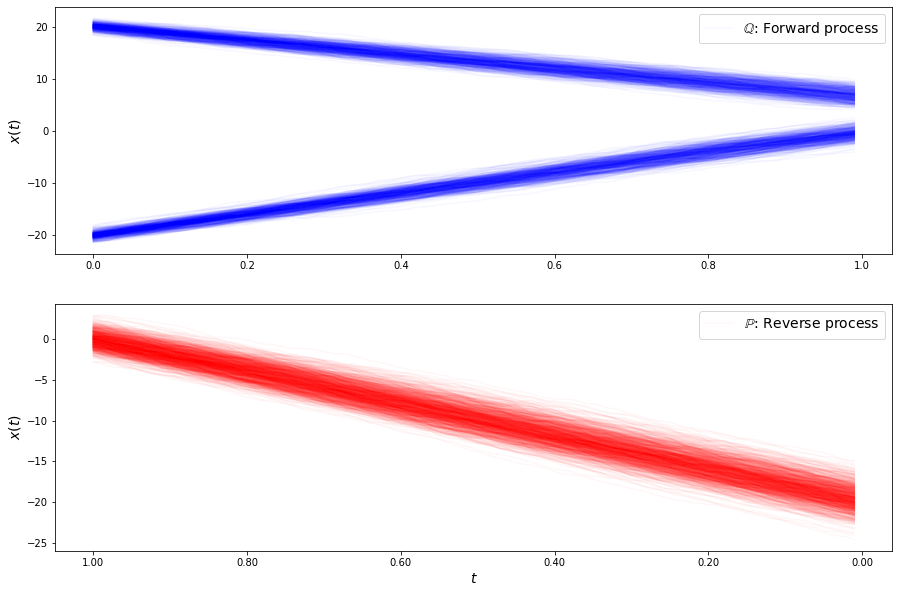

loss b -0.6514235652729327
loss b -0.7628186082430286
loss b -0.8385913377746247
loss b -0.8354757659336758
loss b -0.9180820325162915
loss b -0.9009046451098988
loss b -0.9689468763187249
loss b -0.914252088282454
loss b -0.9210527778913404
loss b -0.8419378297502175
loss b -0.7406957081677892
loss b -0.7522795744216393
loss b -0.7896181006275922
loss b -0.8047947467197293
loss b -0.9849683385672764
loss b -0.7000859046050426
loss b -0.7935878929842113
loss b -0.8130625558489513
loss b -0.884903886197966
loss b -0.8299120475441985
loss b -0.6835596534377122
loss b -0.7679970501336739
loss b -0.9017799748300037
loss b -0.8941321568891595
loss b -0.98238080397148
loss b -0.8596531887702796
loss b -0.9117273264244733
loss b -0.8537207073431504
loss b -0.7338008458528775
loss b -0.791244006927443
loss f 2.3919291630450976
loss f 2.3559990568918185
loss f 2.3448599660853526
loss f 2.3631877701349797
loss f 2.3136645428328078
loss f 2.330025896583596
loss f 2.2956922917468723
loss f 2.31307

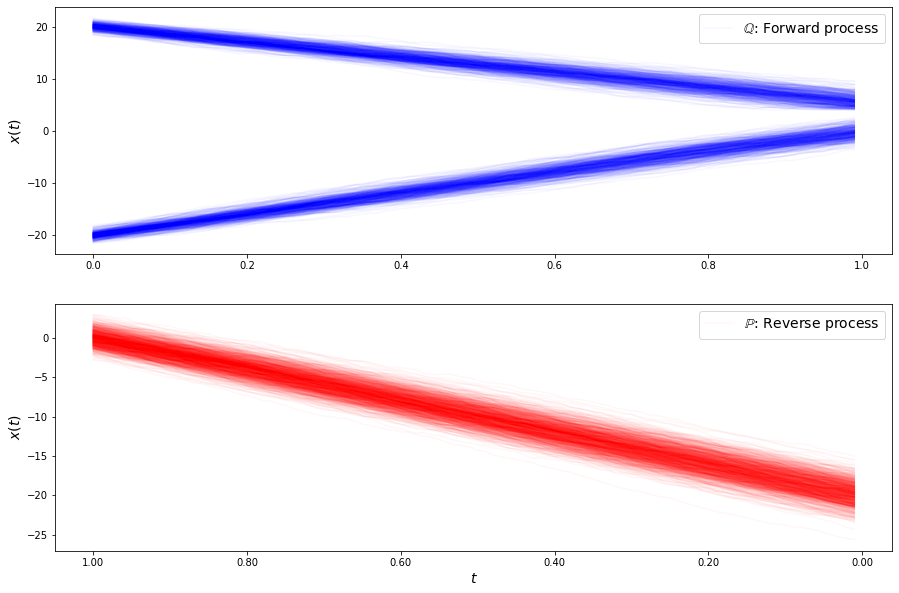

loss b -0.9910999132027543
loss b -1.0135894011424773
loss b -0.861026021166308
loss b -0.9118557374252817
loss b -0.8502212935252248
loss b -1.1868068821019846
loss b -1.1056209199448024
loss b -0.8318294678849327
loss b -0.7397009853938349
loss b -1.0036666208973581
loss b -0.8236692399334277
loss b -0.87905987047205
loss b -0.7847790087653215
loss b -0.7761768032453343
loss b -0.7976395885088253
loss b -0.9116956354365836
loss b -0.878596310519846
loss b -0.8892694418595494
loss b -0.9828296639432945
loss b -0.7308338934757738
loss b -0.8880080481404521
loss b -0.8748768746586966
loss b -0.8340555791586372
loss b -0.7673599776658689
loss b -0.9059341139797304
loss b -0.9282252700076243
loss b -0.7940813437847924
loss b -0.7699481722323657
loss b -0.8605916343098942
loss b -0.7920458597070219
loss f 2.2986897265558994
loss f 2.2457442586460354
loss f 2.2873561434338896
loss f 2.2538765286315
loss f 2.312083112544133
loss f 2.304127928304085
loss f 2.3048083373349746
loss f 2.29778751

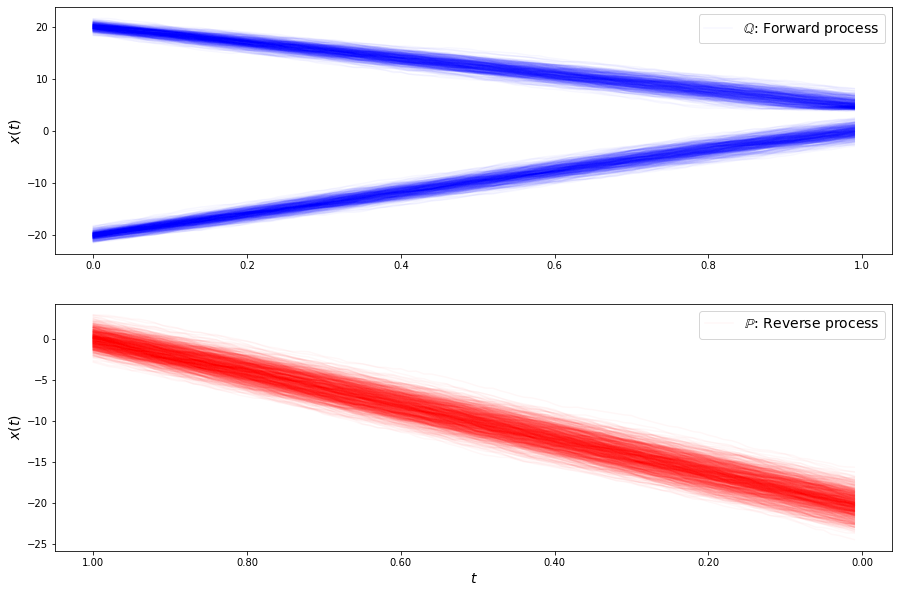

loss b -0.9595837724450047
loss b -1.0222930568625728
loss b -0.8516805882606472
loss b -0.915645336859012
loss b -0.8550457446964281
loss b -0.897279729069461
loss b -0.9270884217578316
loss b -0.9125514543122787
loss b -0.908250962704684
loss b -0.8100238981702049
loss b -0.883464604145353
loss b -0.8803808797458156
loss b -0.8366608798429753
loss b -0.713756533417204
loss b -0.8008072092523149
loss b -0.6941112982773261
loss b -0.7638498229747333
loss b -0.8149933399636352
loss b -0.6787571610818203
loss b -0.7436253902109347
loss b -0.6417252454728481
loss b -0.9310401518033884
loss b -0.7045149172975887
loss b -0.729827159337836
loss b -0.517013231624839
loss b -0.7542334747966035
loss b -0.7341696813026265
loss b -0.737620749496107
loss b -0.7168823122698652
loss b -0.6547914974700549
loss f 2.412191147704817
loss f 2.391091606204299
loss f 2.4735628530681413
loss f 2.4697305583759825
loss f 2.4695099643618517
loss f 2.415413617372895
loss f 2.4289021075968535
loss f 2.4513668487

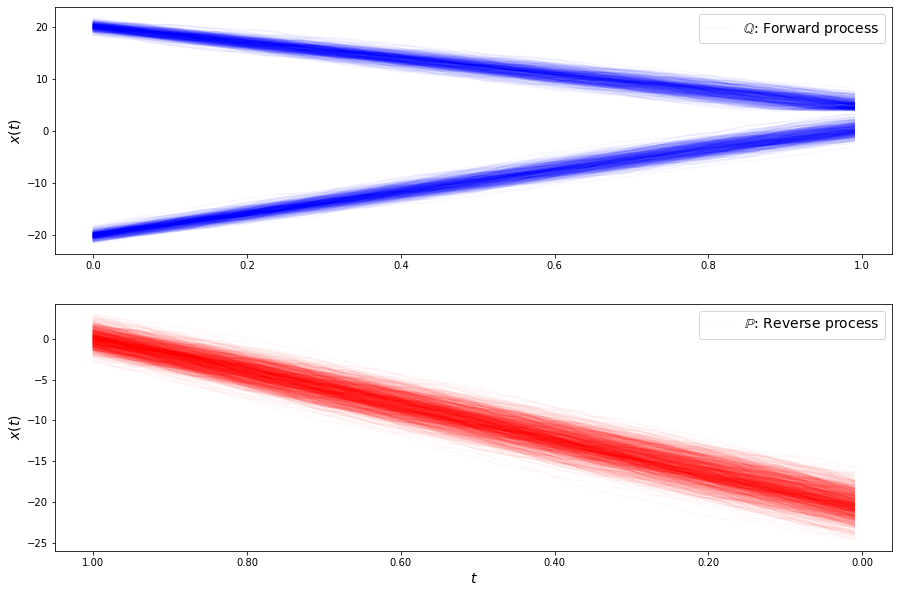

loss b -0.7406747300398525
loss b -0.6589648417340966
loss b -0.6501661011791212
loss b -0.7604953924170806
loss b -0.7209924664304667
loss b -0.6906775374219646
loss b -0.62918784645975
loss b -0.5974694021989381
loss b -0.8982249028347022
loss b -0.7135444470951239
loss b -0.7231290239121692
loss b -0.6248485957888565
loss b -0.6295575681102966
loss b -0.6930436197402092
loss b -0.5912384880314312
loss b -0.5701301706826855
loss b -0.6967856773275807
loss b -0.7941195370520558
loss b -0.660598420333573
loss b -0.6933866784332259
loss b -0.4263970579998795
loss b -0.5515311421805092
loss b -0.7033427749471466
loss b -0.4663442342962203
loss b -0.5231736084971792
loss b -0.5425069810999514
loss b -0.5546982789111965
loss b -0.4518126220549486
loss b -0.646205133045893
loss b -0.48268872817622854
loss f 2.2822892343843133
loss f 2.2714409192098906
loss f 2.270636398362114
loss f 2.266993339418244
loss f 2.2575050504738696
loss f 2.213735243029338
loss f 2.228415602714377
loss f 2.199636

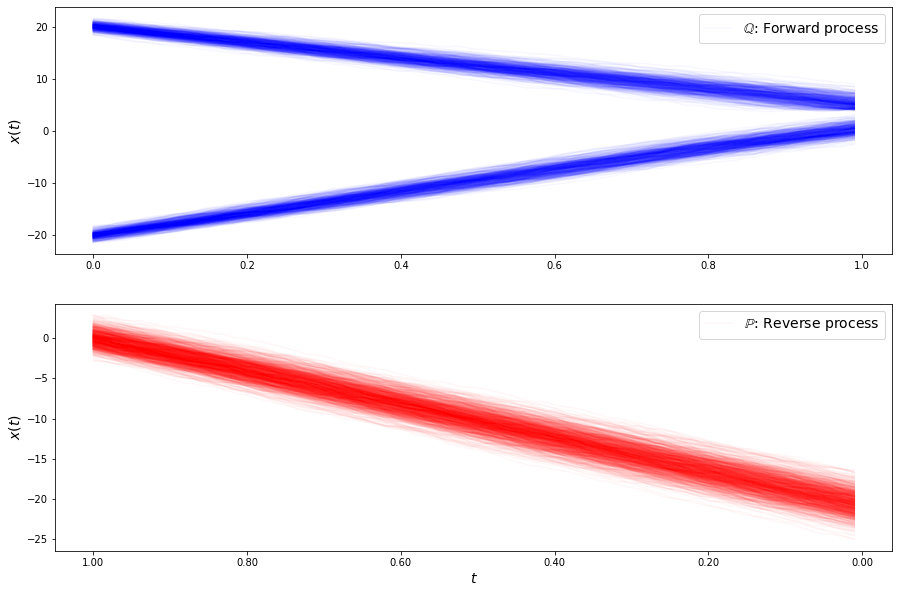

loss b -0.5575446113695683
loss b -0.761809693379893
loss b -0.5943077462373406
loss b -0.5828467457447717
loss b -0.6025623040961979
loss b -0.4644950680467615
loss b -0.4009309046234677
loss b -0.5046806134287014
loss b -0.511785265257273
loss b -0.511118799881617
loss b -0.5360599891777132
loss b -0.5606114640381762
loss b -0.4458451760573578
loss b -0.5863545507153347
loss b -0.45300159881795377
loss b -0.36031889205705475
loss b -0.4549070629983786
loss b -0.37754826537243386
loss b -0.392644230737773
loss b -0.3748317069309991
loss b -0.5089142081381162
loss b -0.3853898095661588
loss b -0.35991814861342963
loss b -0.439404500263059
loss b -0.37689844649982374
loss b -0.33962358792839786
loss b -0.3423305360068123
loss b -0.4560591228380769
loss b -0.31233275224281243
loss b -0.2877106089816809
loss f 1.974354400723602
loss f 1.9834807968962125
loss f 1.9675391543824863
loss f 1.9411677231047593
loss f 1.9445146161592073
loss f 1.931504056642149
loss f 1.9350430605801565
loss f 1

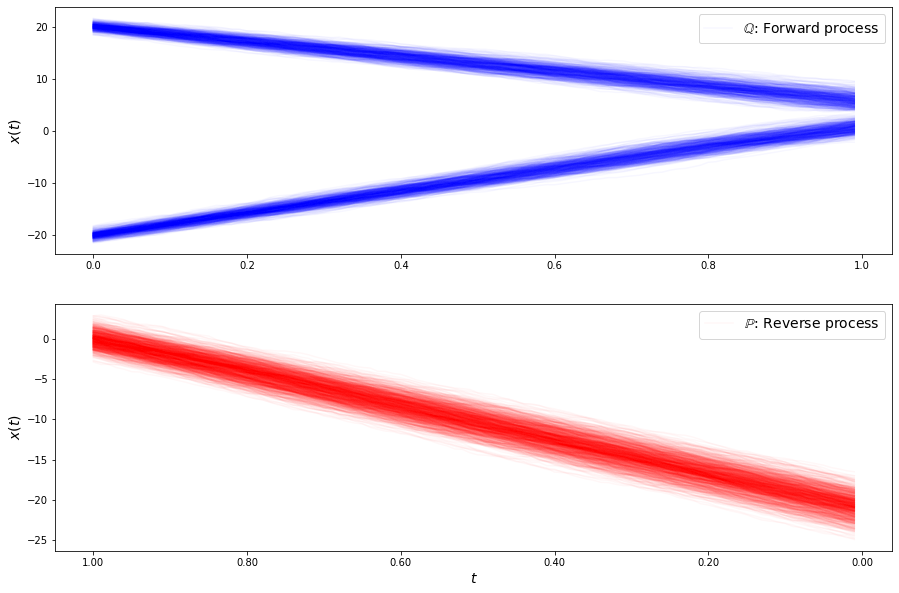

loss b -0.39804017385397167
loss b -0.3240940966117468
loss b -0.4672982300828561
loss b -0.3916198975946837
loss b -0.20067213329704311
loss b -0.26373480558482987
loss b -0.38676909299947293
loss b -0.14563460964036903
loss b -0.21145918081331264
loss b -0.27393394884296807
loss b -0.3327846853757864
loss b -0.31046924932649733
loss b -0.3750569899285001
loss b -0.31515872202695233
loss b -0.22363812514080378
loss b -0.19946696573396897
loss b -0.22664160753283785
loss b -0.40739077384395006
loss b -0.15628185533522335
loss b -0.40049726475907016
loss b -0.2821139315804488
loss b -0.15026721884219169
loss b -0.18580106863747742
loss b -0.110475479848882
loss b -0.16440136011237483
loss b -0.08396023912875739
loss b -0.25058165957731954
loss b -0.11815744804793651
loss b -0.22265122522953254
loss b -0.23032785373367107
loss f 1.9164739168321925
loss f 1.9982724490991661
loss f 2.012999533152383
loss f 1.9988664822924986
loss f 2.0016104069246685
loss f 1.9855532864102377
loss f 2.0029

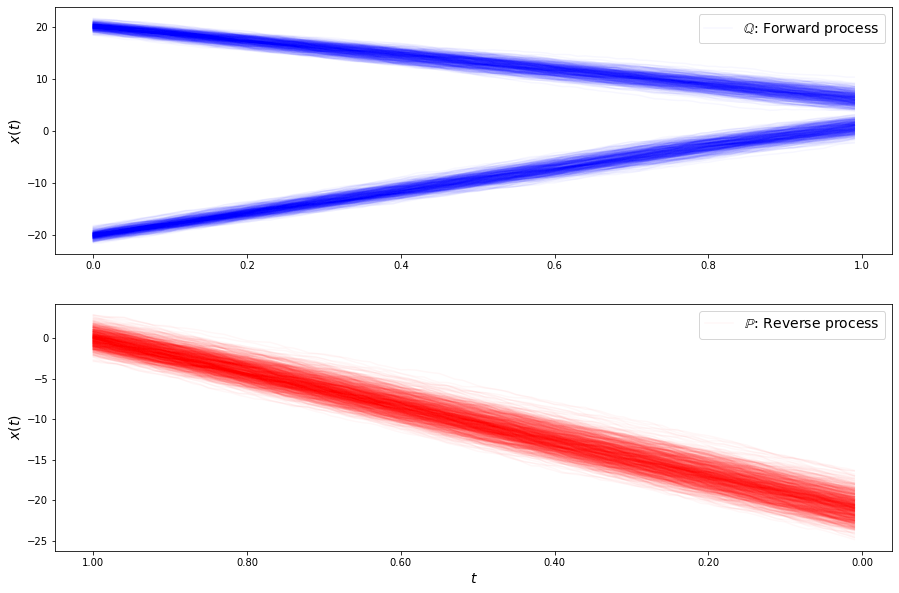

loss b -0.1638839449822376
loss b -0.05632418840627009
loss b -0.21528979155069644
loss b -0.1815513630835843
loss b -0.17456952330261133
loss b -0.2981420467907768
loss b -0.18752964919302892
loss b -0.14366213275904635
loss b -0.21326000315330237
loss b -0.1846746855245088
loss b -0.12160353821780653
loss b -0.15815062902873506
loss b -0.11567045853283159
loss b -0.014109503218769082
loss b -0.057012198336752966
loss b 0.040852373787001676
loss b -0.037637932343592445
loss b -0.15696626240968917
loss b -0.12504084560099174
loss b 0.02037686259227507
loss b -0.111771805505341
loss b -0.16551381330714093
loss b 0.02848977069874725
loss b -0.05436131489347727
loss b 0.020539688331640184
loss b -0.05047157494571278
loss b -0.029877141234465887
loss b -0.13240708561973394
loss b -0.025918140946806726
loss b -0.0377078303024786
loss f 2.097741778458454
loss f 2.0761905854902194
loss f 2.133082595633966
loss f 2.145053409347575
loss f 2.1533470988047942
loss f 2.1658794538000388
loss f 2.14

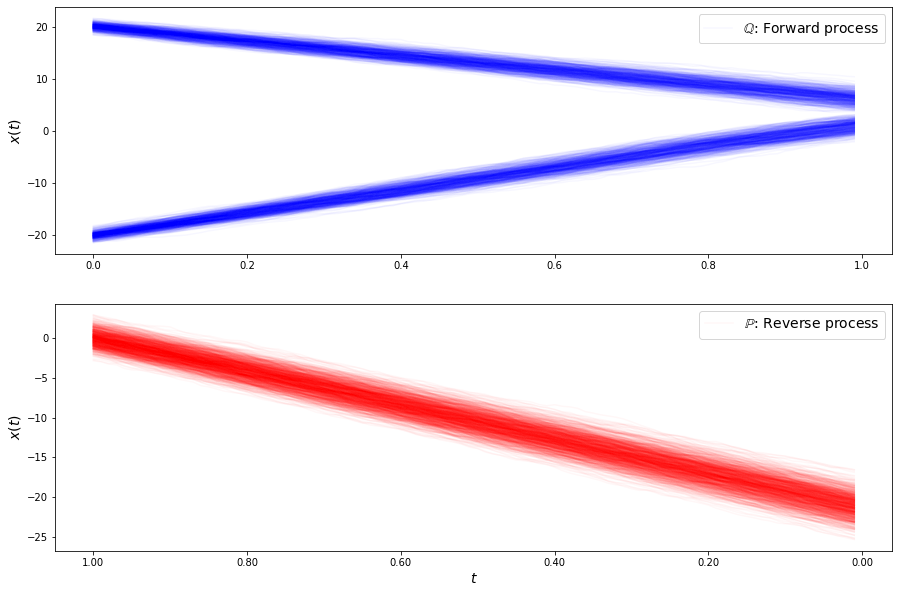

loss b -0.04637420232577079
loss b -0.16550484843915458
loss b 0.04885297442977672
loss b -0.040041476427757905
loss b -0.06216697104711714
loss b -0.03535972095234002
loss b 0.09096558557776303
loss b -0.058377790508370324
loss b -0.08772109087672916
loss b 0.08905654854158876
loss b 0.06106998606585549
loss b -0.0023631040616923305
loss b -0.01868671011513959
loss b 0.059708350460984876
loss b 0.002794906658616036
loss b 0.07927024240190549
loss b 0.10288795511112163
loss b -0.013946431218679533
loss b -0.001661638565282587
loss b 0.20134399331828168
loss b 0.03619907953466199
loss b 0.002849759410154197
loss b 0.11154690733715958
loss b 0.14306750207210311
loss b -0.056788637252787426
loss b 0.05821663545410342
loss b -0.008576737703389445
loss b 0.08919768549059749
loss b -0.009358593273640966
loss b 0.0820280051984385
loss f 2.1761517156563897
loss f 2.245629076427458
loss f 2.1858250520822224
loss f 2.212422822935427
loss f 2.2262545065554327
loss f 2.2186617503825103
loss f 2.24

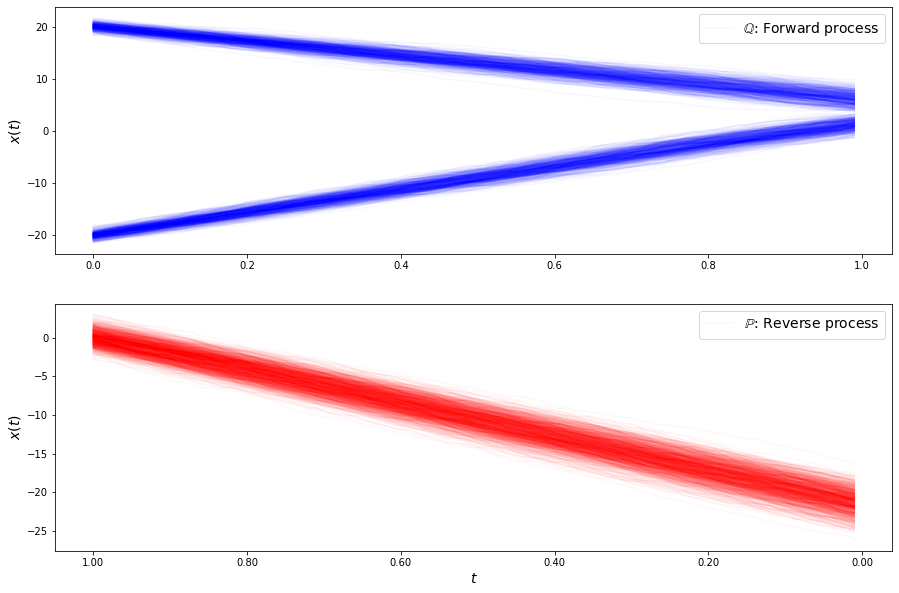

loss b 0.14499552948616196
loss b 0.11921889387979889
loss b 0.049992569158264645
loss b 0.20404982497814866
loss b 0.12221105509760173
loss b 0.2409637160158492
loss b 0.10680989994605249
loss b 0.08624194877041962
loss b 0.12168575933674942
loss b 0.1404348802790211
loss b 0.14538642445787353
loss b 0.11908596176268135
loss b 0.09274177386181538
loss b 0.1354640488967604
loss b 0.23116869190082226
loss b 0.13141470770961233
loss b 0.1826148891849412
loss b 0.10456758565134851
loss b 0.1746549023977233
loss b 0.19732059317485148
loss b 0.19513832522383692
loss b 0.2461498340611877
loss b 0.24707767147059403
loss b 0.2879547587720108
loss b 0.15806233743771286
loss b 0.14376477618386713
loss b 0.23314233959628283
loss b 0.06417914780906041
loss b 0.205020670957098
loss b 0.3095704370562858
loss f 2.201507627295606
loss f 2.166283311027754
loss f 2.1954236056222785
loss f 2.134299229702572
loss f 2.176144332660084
loss f 2.164588577251076
loss f 2.1726292290177924
loss f 2.1409280848903

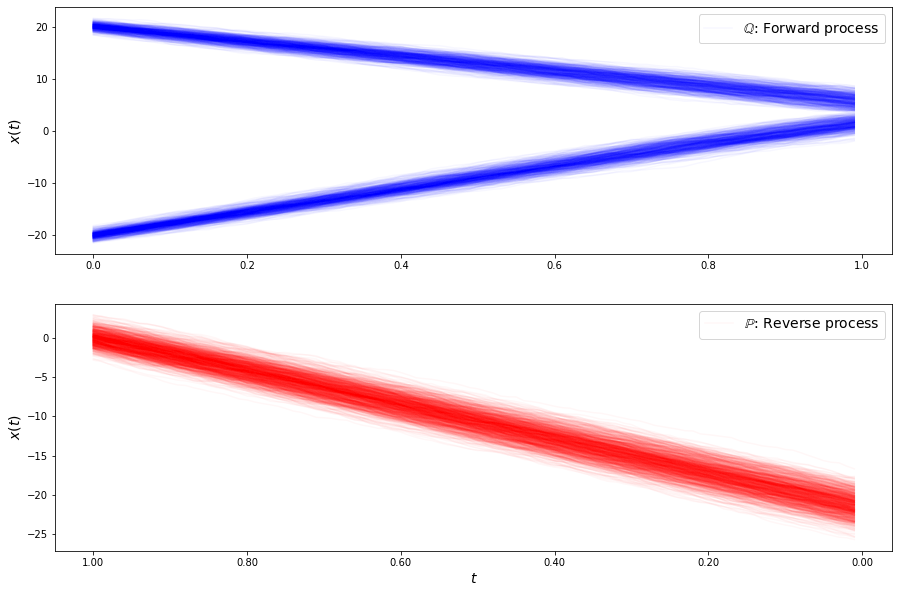

loss b 0.20422435007114753
loss b 0.30465696838333434
loss b 0.17198707671740693
loss b 0.10691736678727878
loss b 0.2927427908159852
loss b 0.2371847617307319
loss b 0.35100587431044705
loss b 0.23049559310405
loss b 0.251168478169074
loss b 0.2691544990684151
loss b 0.21030234906047007
loss b 0.31673488640780556
loss b 0.30650751847961943
loss b 0.286291161052284
loss b 0.3332180250489433
loss b 0.18912980701799176
loss b 0.2630645209434725
loss b 0.24096681338528908
loss b 0.2999091230465785
loss b 0.2815951716195046
loss b 0.341771597757951
loss b 0.24218671753268792
loss b 0.2630001364484639
loss b 0.43706554182769286
loss b 0.3119648385687831
loss b 0.19356348326229927
loss b 0.32635381580002537
loss b 0.3179044157200423
loss b 0.4474684208016263
loss b 0.39919849917524886
loss f 2.003627694662981
loss f 2.032484520070273
loss f 2.0417126143707613
loss f 2.0078911039173195
loss f 2.0128603043641
loss f 2.0132019498614837
loss f 1.9591901210452172
loss f 2.0112551906388836
loss f 

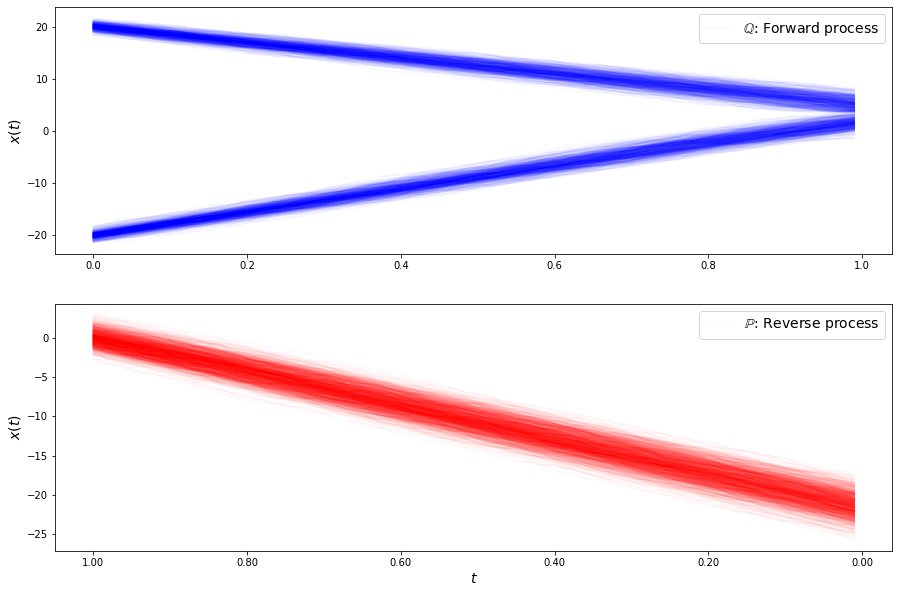

loss b 0.3008814180500228
loss b 0.3906570509785307
loss b 0.43576618967691666
loss b 0.3972301786333142
loss b 0.322276363300719
loss b 0.3464279457150536
loss b 0.3842303887570882
loss b 0.3596675673622188
loss b 0.3172258993182636
loss b 0.3673027765073095
loss b 0.4088240760410811
loss b 0.42818707382199744
loss b 0.3135397866472599
loss b 0.4401077712448466
loss b 0.25933032921415655
loss b 0.36906352811119647
loss b 0.38984710466530237
loss b 0.2936225310079329
loss b 0.4367899400787362
loss b 0.38192945084521246
loss b 0.23182582987029818
loss b 0.46868215310954053
loss b 0.3493728224100572
loss b 0.41471677945388497
loss b 0.3318844578551063
loss b 0.32367261206454534
loss b 0.37628287308703995
loss b 0.46058204574003914
loss b 0.36632553417463565
loss b 0.3818306714840741
loss f 1.8057135276964402
loss f 1.825447677619012
loss f 1.8394398479524607
loss f 1.7892752345120555
loss f 1.8274317486329645
loss f 1.7219036168877626
loss f 1.7864884588809118
loss f 1.7807056129371537
l

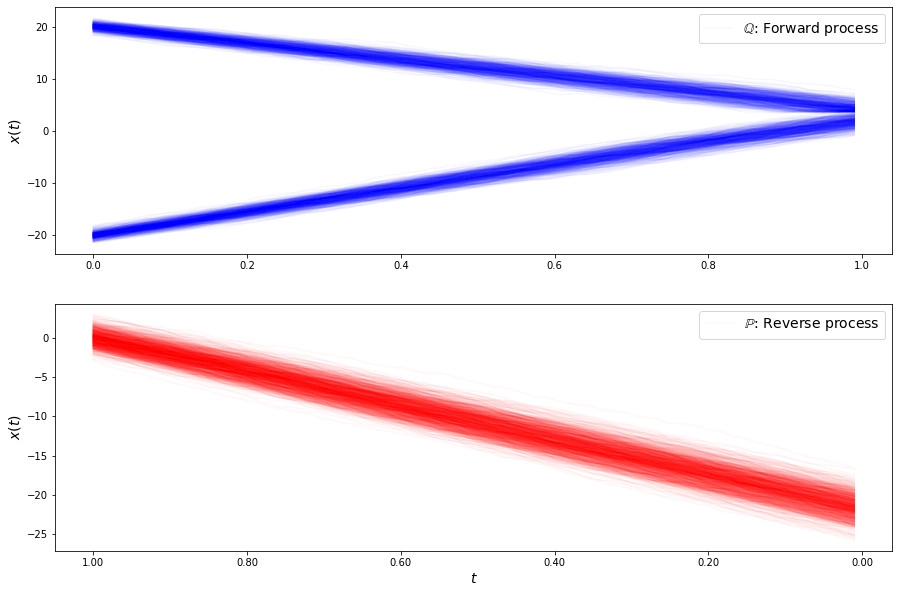

loss b 0.5227788614933179
loss b 0.4517424015040505
loss b 0.44736123622597723
loss b 0.5434614233550653
loss b 0.5886504778596839
loss b 0.4648427970542541
loss b 0.4909124126288563
loss b 0.4934357777308636
loss b 0.43574295892467696
loss b 0.5596145341039609
loss b 0.3944497212859268
loss b 0.5780634215015454
loss b 0.5387931569133053
loss b 0.5002961426033644
loss b 0.41573827411352454
loss b 0.5158571094398348
loss b 0.5343164934221485
loss b 0.4819866314294799
loss b 0.4518508737234013
loss b 0.561969988294218
loss b 0.557491242470984
loss b 0.5139699009849673
loss b 0.48151028892527176
loss b 0.5236617633030529
loss b 0.4518200745262558
loss b 0.44015934702391746
loss b 0.4902040378731373
loss b 0.47609607354826333
loss b 0.5211383109533227
loss b 0.48442387657613384
loss f 1.6825210956905245
loss f 1.7320239187593782
loss f 1.6760680025038106
loss f 1.7756601868222934
loss f 1.770181357395406
loss f 1.7273684284737263
loss f 1.7723823264327123
loss f 1.8026721930967686
loss f 1

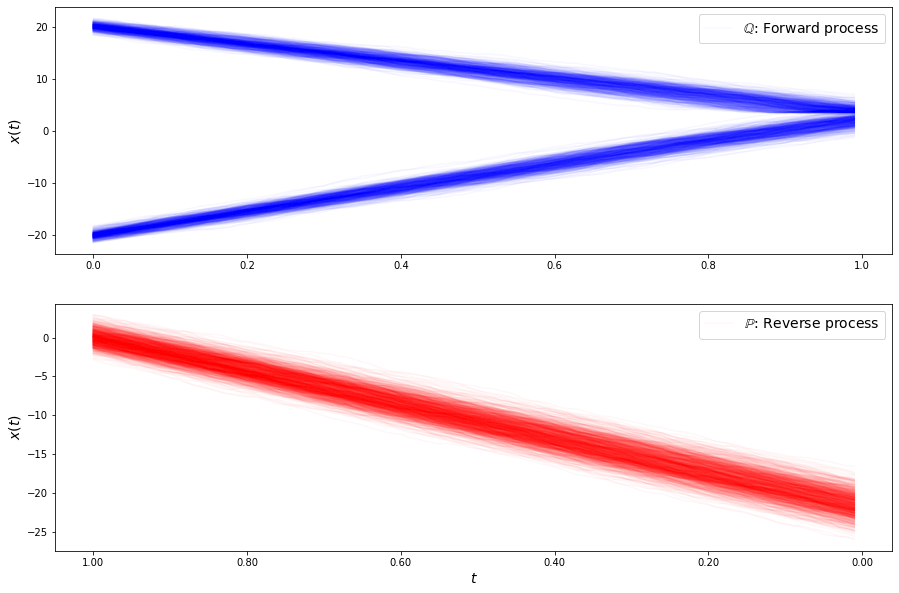

loss b 0.550753008022859
loss b 0.5636602036908558
loss b 0.6527806270882459
loss b 0.6233740619883255
loss b 0.5980883540789059
loss b 0.5530454622312033
loss b 0.497350944528099
loss b 0.6534230526706546
loss b 0.6708273404052026
loss b 0.5807045932314341
loss b 0.6014361949000568
loss b 0.607599914348317
loss b 0.6604388029521756
loss b 0.5943107736193802
loss b 0.646493091131823
loss b 0.5893046375883813
loss b 0.5930744826260154
loss b 0.6442740907982955
loss b 0.6961199801163432
loss b 0.6355054375163662
loss b 0.6115281202420274
loss b 0.5620835842793532
loss b 0.6332575948426362
loss b 0.5158972175976555
loss b 0.6300931254367644
loss b 0.5806166421520879
loss b 0.5781890971260499
loss b 0.6640659644293402
loss b 0.5386458980510517
loss b 0.6566048733366889
loss f 1.919020434429533
loss f 1.8918430769581918
loss f 1.885895821718279
loss f 1.985922482808295
loss f 1.898211307606734
loss f 1.977608193458858
loss f 1.9427772257279141
loss f 1.9333832114359253
loss f 1.943810909854

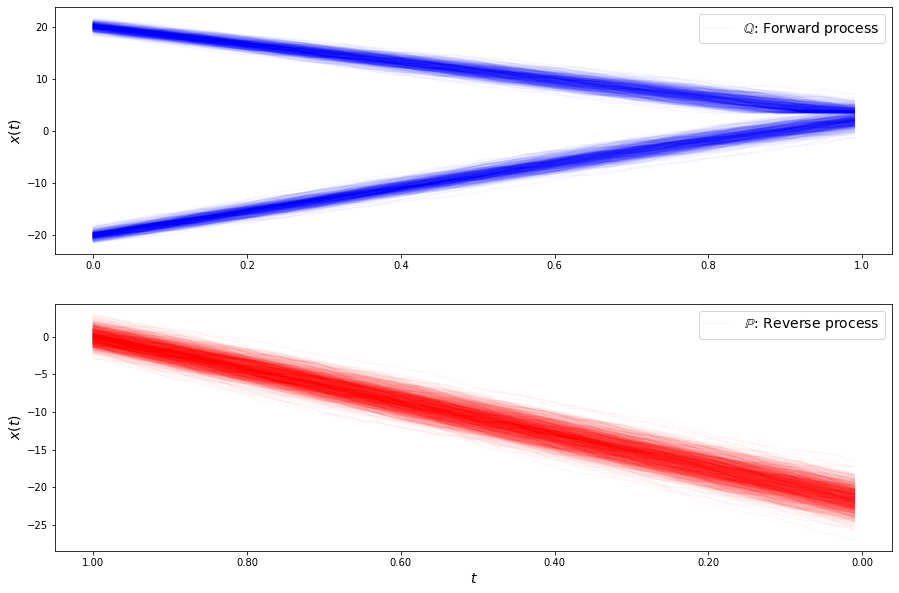

loss b 0.6608648533990611
loss b 0.6483669659557518
loss b 0.6959822536682252
loss b 0.6406618466027307
loss b 0.782866525085392
loss b 0.7656528783628874
loss b 0.7121507694300571
loss b 0.7779342696863373
loss b 0.7408399733791268
loss b 0.8008517047325397
loss b 0.7596883426130726
loss b 0.6968673095526273
loss b 0.6682323343427358
loss b 0.7005545740629433
loss b 0.7173598940278892
loss b 0.7248514206179153
loss b 0.7020576640471083
loss b 0.7431938529958768
loss b 0.7676034129590952
loss b 0.664357999008476
loss b 0.7154296504435478
loss b 0.720671623372834
loss b 0.6881875329807832
loss b 0.6991026886225503
loss b 0.7217271127627191
loss b 0.6997532892138346
loss b 0.7186988568500269
loss b 0.7451582026365071
loss b 0.7096431078500282
loss b 0.7009085437240888
loss f 1.9986373335701944
loss f 2.05517162758501
loss f 2.05018937489667
loss f 2.0229252848940353
loss f 2.0976564405995513
loss f 2.062005590206527
loss f 2.0428721809112083
loss f 1.9994255317322915
loss f 2.00043899169

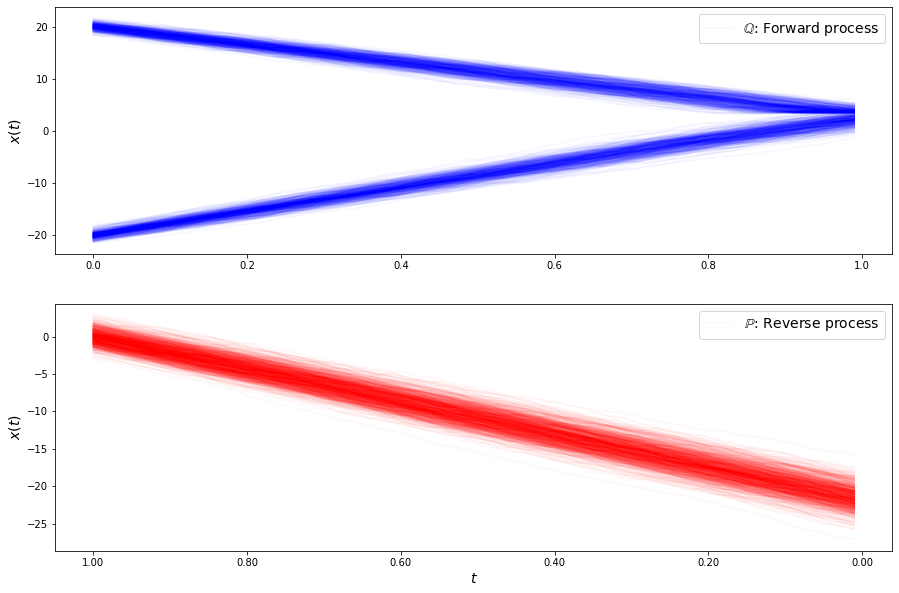

loss b 0.7701273933509661
loss b 0.6808533905679749
loss b 0.7162143899620368
loss b 0.862533313744593
loss b 0.8074272489417637
loss b 0.7700029018543294
loss b 0.8535543992448122
loss b 0.7929064459908015
loss b 0.7427053064043795
loss b 0.6994610612913016
loss b 0.7084426256964061
loss b 0.7735174068556265
loss b 0.7887990415793577
loss b 0.7895189667991704
loss b 0.8111968889236494
loss b 0.7895001632272747
loss b 0.8806864288697792
loss b 0.7583541015132315
loss b 0.8135325977231519
loss b 0.8432506185863866
loss b 0.8180599110890328
loss b 0.8040448695935819
loss b 0.7455646199796327
loss b 0.8794581053319036
loss b 0.7753243834457137
loss b 0.9316091766409008
loss b 0.8584561507544245
loss b 0.8284374744549778
loss b 0.7211924138709772
loss b 0.8071243765680587
loss f 1.841987307397116
loss f 1.9824102149681002
loss f 1.9405565398252433
loss f 1.8788595134800528
loss f 1.918623735565272
loss f 1.846935145882444
loss f 1.8122863407382697
loss f 1.8287567469774448
loss f 1.8358296

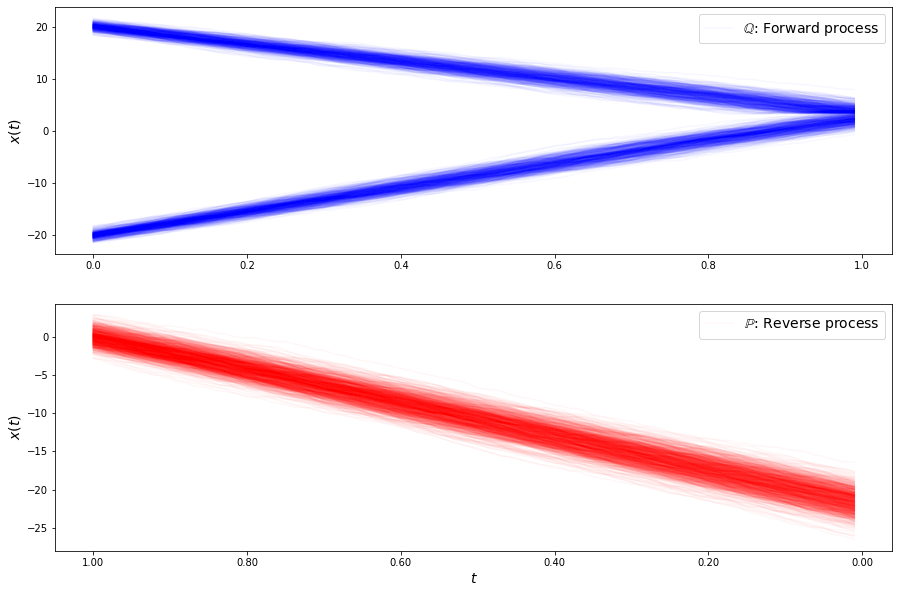

loss b 0.8439929265324967
loss b 0.7888973780077703
loss b 0.8577990949407074
loss b 0.8364210116249988
loss b 0.8620985506985038
loss b 0.9492761108450897
loss b 0.893456432347735
loss b 0.6951671311016061
loss b 0.6942771641155449
loss b 0.8488717007537758
loss b 0.8872321974151218
loss b 0.8326382446925933
loss b 0.8508531953782499
loss b 0.830643215819673
loss b 0.8703703200557066
loss b 0.8490830748291602
loss b 0.7705950293218332
loss b 0.8866992382943194
loss b 0.8354092788218551
loss b 0.8411081664492877
loss b 0.8588920787612339
loss b 0.9476116912871118
loss b 0.9472165358340455
loss b 0.8121621875816519
loss b 0.914976663712507
loss b 0.8994347545207081
loss b 0.8527892626817648
loss b 0.8643324656499229
loss b 0.8407693430382631
loss b 0.870183494460521
loss f 1.5424150012067304
loss f 1.584865171477403
loss f 1.4908783868214934
loss f 1.6387046185001186
loss f 1.4747322842486794
loss f 1.5364532863970157
loss f 1.5885388507827705
loss f 1.6295548688522108
loss f 1.51017460

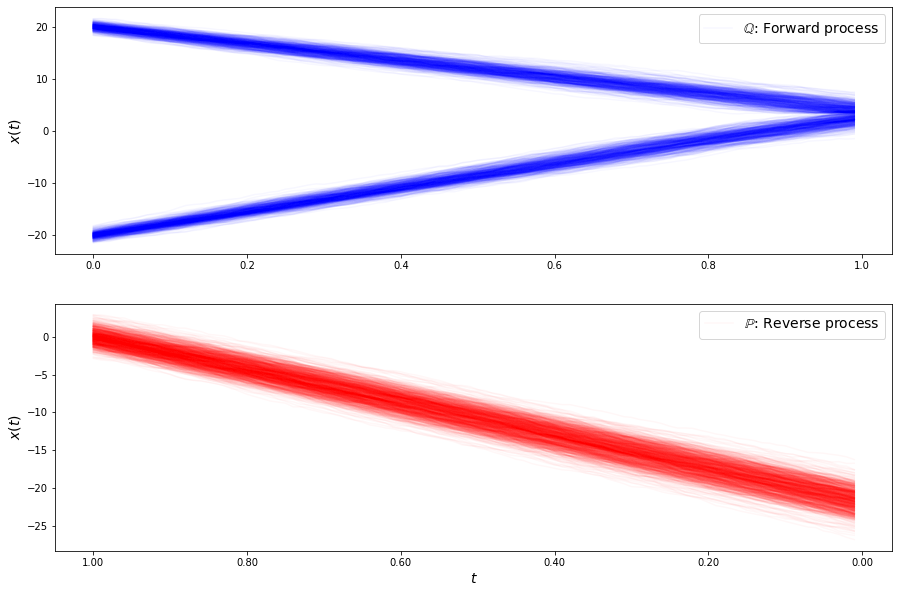

loss b 0.8256081293175203
loss b 0.8577196560736801
loss b 0.8315247152235986
loss b 0.8496251827412673
loss b 0.8384135042421741
loss b 0.8366398974619027
loss b 0.8546162224573817
loss b 0.7293952076156218
loss b 0.9277717472262885
loss b 0.8295659293932414
loss b 0.7989917007833103
loss b 0.9615396106683499
loss b 0.8692483187158941
loss b 0.8657410996528018
loss b 0.8139217003297803
loss b 0.8241599025408419
loss b 0.8631000476709032
loss b 0.9068719585344939
loss b 0.8771712718090301
loss b 0.808707034458423
loss b 0.8741764429442997
loss b 0.87201639176296
loss b 0.8351950673523882
loss b 0.8429544718858615
loss b 0.8360227122462117
loss b 0.8604889517364148
loss b 0.8229942152714941
loss b 0.8869771134839353
loss b 0.8328897801337845
loss b 0.9478874118532002
loss f 1.452761723318667
loss f 1.4018950902839327
loss f 1.4755408534267214
loss f 1.4793380434701058
loss f 1.3735302216061624
loss f 1.5073615848128834
loss f 1.4300805517063067
loss f 1.5026546774254903
loss f 1.5360202

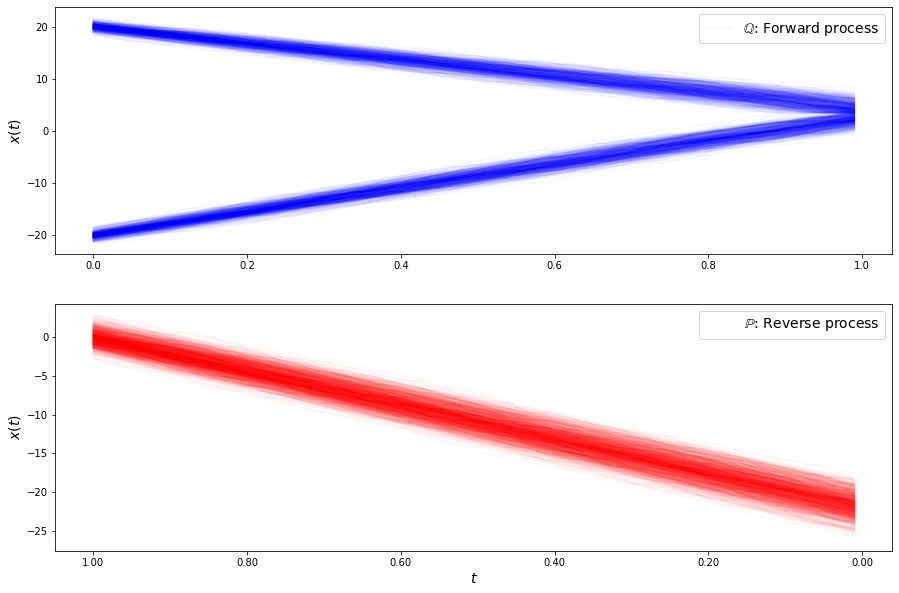

loss b 0.8689201808839886
loss b 0.8261155953743964
loss b 0.857388825275417
loss b 0.8556883018487765
loss b 0.9114732491019485
loss b 0.7850306775724576
loss b 0.8357977899668938
loss b 0.8171542461567125
loss b 0.8724022271069714
loss b 0.8562886861595281
loss b 0.8684254090133697
loss b 0.8358620273847215
loss b 0.9061143673457748
loss b 0.9380043988639157
loss b 0.8551961647239471
loss b 0.828499119984027
loss b 0.8626692165198475
loss b 0.8887742322241584
loss b 0.8150407350035358
loss b 0.8818985646998739
loss b 0.7941814475267549
loss b 0.8550652267905176
loss b 0.8643723767125308
loss b 0.9286764488958473
loss b 0.8947544582658568
loss b 0.8299862940628909
loss b 0.7803003137638901
loss b 0.8693062249582709
loss b 0.9169101572355269
loss b 0.9286072277906
loss f 1.6019612594204973
loss f 1.4943338715783847
loss f 1.5323817960002752
loss f 1.5750402777331158
loss f 1.6046449194397607
loss f 1.6386808258975625
loss f 1.5206937952565778
loss f 1.4923132510373214
loss f 1.56422634

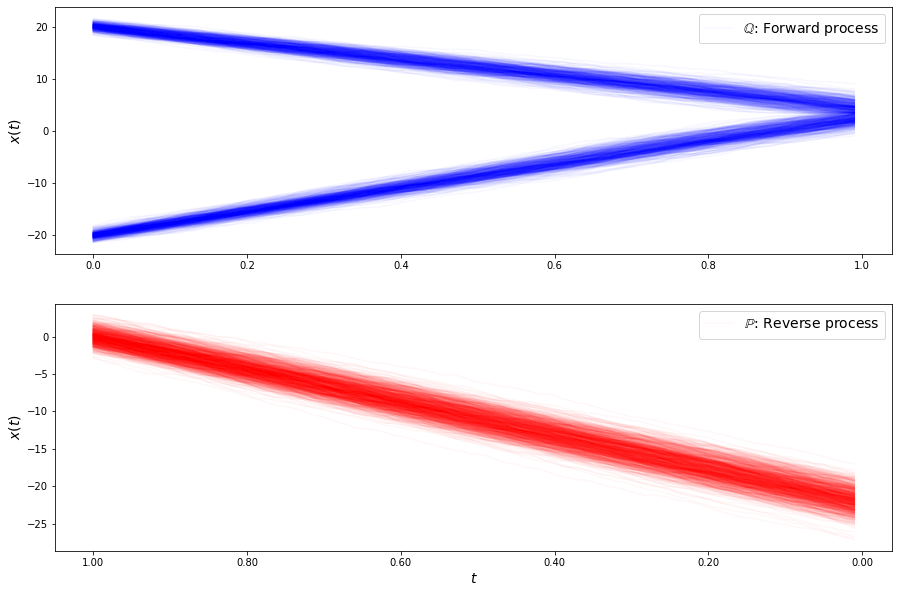

loss b 0.8611299369460895
loss b 0.887710504104752
loss b 0.9051769191796203
loss b 0.8158004857233188
loss b 0.790819599872908
loss b 0.870186269183202
loss b 0.9447342660147183
loss b 0.9257336910316395
loss b 0.8035719942157291
loss b 0.7717113181912089
loss b 0.8024370735584255
loss b 0.9103386523321655
loss b 0.9130026585427532
loss b 0.8797032197314021
loss b 0.9768873537793059
loss b 0.8627140741010126
loss b 0.753594118239307
loss b 0.8965415238067853
loss b 0.8746042818217887
loss b 0.945246476416042
loss b 0.8542109068820849
loss b 0.8010392424382814
loss b 0.8214185024066919
loss b 0.8948390006693544
loss b 0.8717072163720603
loss b 0.9193929368269371
loss b 0.8249273261384514
loss b 0.8940895987462495
loss b 0.8888896397393158
loss b 0.8634363559978498
loss f 1.4627065973577533
loss f 1.5492092511256212
loss f 1.4630836993282894
loss f 1.5926111587983285
loss f 1.5388820025318286
loss f 1.5369098458708461
loss f 1.6117582781986453
loss f 1.5595367334516912
loss f 1.61383491

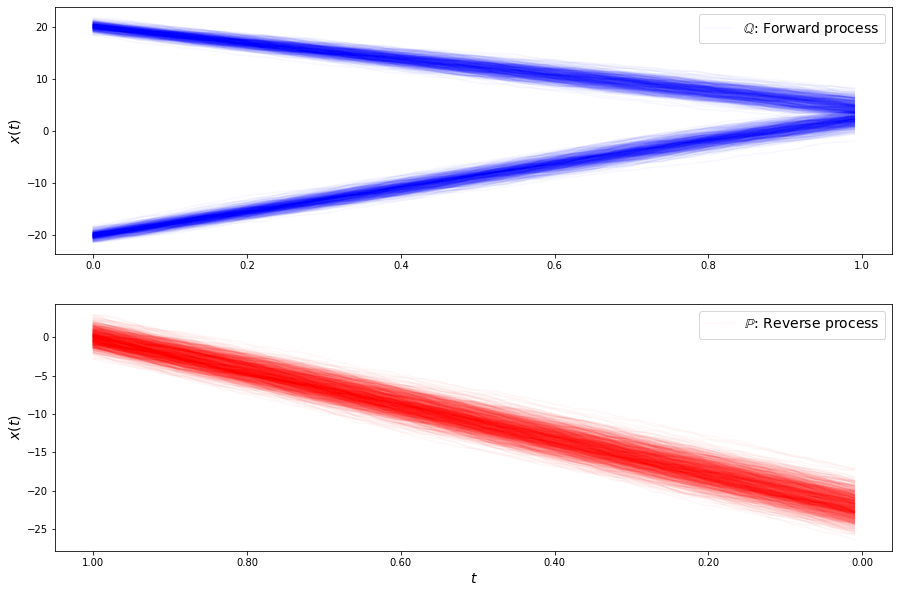

loss b 0.9014267945424104
loss b 0.8294005613616827
loss b 0.8983454773792644
loss b 0.9260631085310631
loss b 0.8517871404773771
loss b 0.8364137648479008
loss b 0.890380852639217
loss b 0.9269943146512568
loss b 0.9223915082670755
loss b 0.8680982509556672
loss b 0.9148513247543032
loss b 0.927479443030255
loss b 0.9632745358004259
loss b 0.9866778873276364
loss b 0.8727601321217464
loss b 0.8927141829906079
loss b 0.8941832666465327
loss b 0.8620924255313694
loss b 0.859263442565888
loss b 0.9080177034006603
loss b 0.9127697772404351
loss b 0.984753048531332
loss b 0.9285082850489779
loss b 0.9007386620418661
loss b 0.9505370878077466
loss b 0.9804049923602414
loss b 0.9244747572020031
loss b 0.9281637339376747
loss b 0.9608310669241846
loss b 0.9620832390260776
loss f 1.6007911470400007
loss f 1.5186683867431392
loss f 1.566888382570735
loss f 1.5191779127065774
loss f 1.657410632634033
loss f 1.5207448930662293
loss f 1.5510406164363695
loss f 1.5562884737918223
loss f 1.586575315

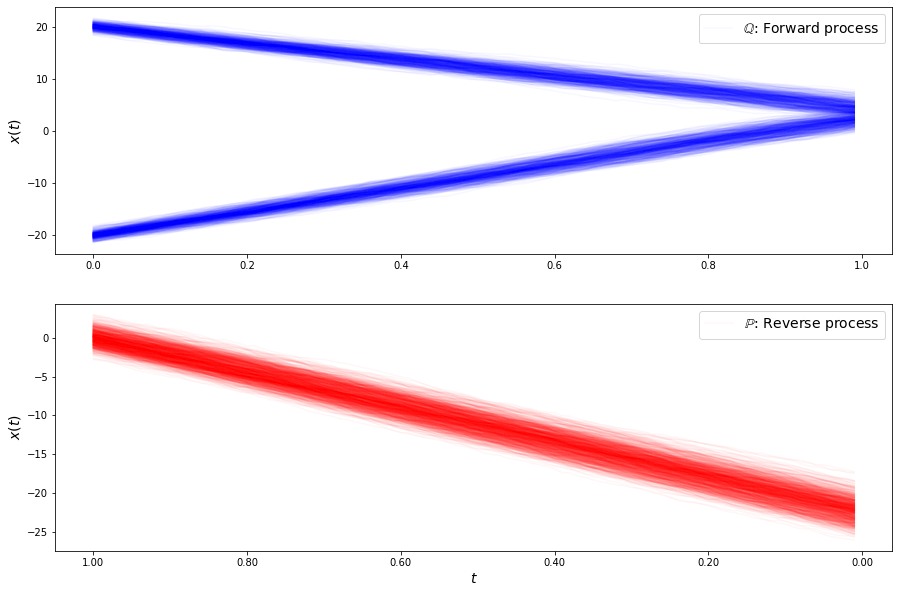

loss b 0.9550663840608093
loss b 0.9315484766084207
loss b 0.9265264616104087
loss b 0.9476671009378186
loss b 0.8385827273980139
loss b 0.92052536282159
loss b 0.9132739161522542
loss b 0.9374686474380165
loss b 0.916574040978626
loss b 0.956098329151814
loss b 0.9336935896752965
loss b 0.8758905894109517
loss b 0.9497457760140434
loss b 0.9687593609661644
loss b 0.9332792258889685
loss b 0.9507497124621691
loss b 0.940613365247797
loss b 0.9541835716562483
loss b 0.9339810900823007
loss b 0.9336747965929507
loss b 0.934621911613974
loss b 1.014263158929553
loss b 1.0006890485683644
loss b 0.9627713503726842
loss b 0.9809417478629052
loss b 0.9728185090764898
loss b 0.9653351926796641
loss b 0.9878940239032096
loss b 1.0018113071887422
loss b 0.8842132365938655
loss f 1.5447676451704282
loss f 1.5559791058206711
loss f 1.4761443812027852
loss f 1.4071282252561104
loss f 1.503941448387086
loss f 1.4920313126402582
loss f 1.514725160072891
loss f 1.555321504175501
loss f 1.5211105576468

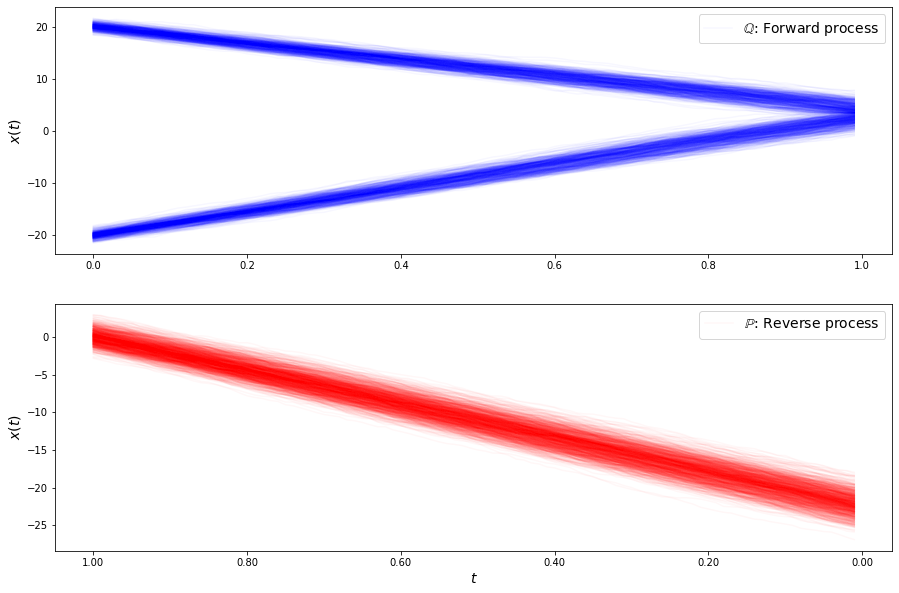

loss b 0.9683667776368029
loss b 0.8780879320034496
loss b 0.9604666163532678
loss b 0.9450360896179308
loss b 0.914615281922086
loss b 0.9320822988964393
loss b 0.9716729363725961
loss b 0.9800641576872486
loss b 1.0338346079936294
loss b 0.9101013126463192
loss b 0.9244033781870885
loss b 0.9762854732181491
loss b 0.9934186683703053
loss b 1.0058281320725806
loss b 1.0210386717411428
loss b 0.9263672435770959
loss b 0.9729403673837382
loss b 0.9866152357336899
loss b 1.014397621640736
loss b 0.9197716951301708
loss b 0.9827864469655736
loss b 1.0262231456463788
loss b 0.8905294460073255
loss b 1.0051523214596365
loss b 0.9457964169441494
loss b 0.9797397857359721
loss b 0.9794338974679074
loss b 1.0159757451919307
loss b 0.9771069600532681
loss b 0.9445936956390966
loss f 1.4315230515894273
loss f 1.4376417858799542
loss f 1.3945445241049474
loss f 1.474981281393366
loss f 1.4625392247118139
loss f 1.3884681065161664
loss f 1.4787058731016847
loss f 1.4289469195024813
loss f 1.380986

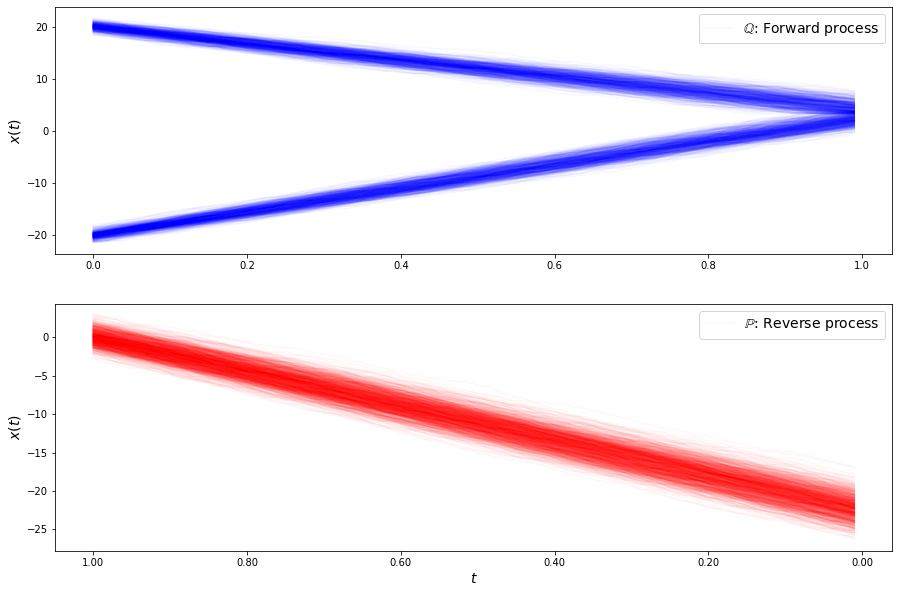

loss b 0.9727611479411693
loss b 0.9689921094856667
loss b 0.9728265837411674
loss b 0.9672280142448515
loss b 0.9961920304223044
loss b 0.9559562361327124
loss b 0.9875533079891035
loss b 1.049366066103894
loss b 0.9344495380645531
loss b 0.9866746609098325
loss b 0.9718218995571162
loss b 0.980478242920173
loss b 1.043524651587606
loss b 0.9850936978790379
loss b 0.9921932935597217
loss b 0.977327065039838
loss b 0.9571099540063278
loss b 0.9510185520351389
loss b 0.9626400661002484
loss b 1.0201708134621448
loss b 0.9821653537530778
loss b 0.942687196996513
loss b 0.970670432708527
loss b 0.99565556017472
loss b 0.9847542749908373
loss b 0.9448687582642769
loss b 0.9551086406350883
loss b 0.9718334315483994
loss b 0.9310356476109758
loss b 0.9500799643931264
loss f 1.3124787315380653
loss f 1.3170654303945328
loss f 1.2977962702780095
loss f 1.3158740075189386
loss f 1.4191882621879601
loss f 1.3789852849839523
loss f 1.31831685541712
loss f 1.2140275111995933
loss f 1.4081840530143

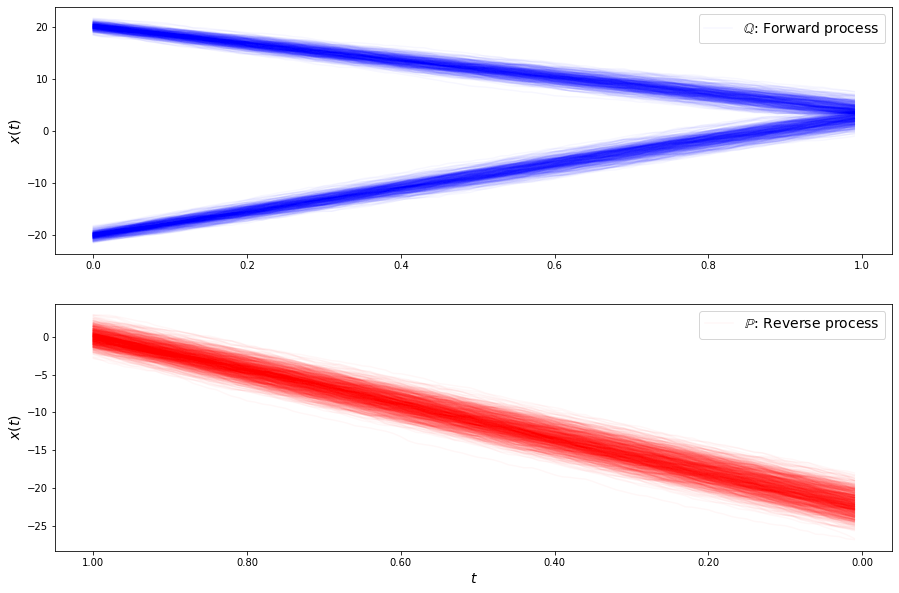

loss b 0.995212563150337
loss b 0.9710263403814433
loss b 0.9564221576288544
loss b 0.9600608338195097
loss b 0.9445156441575162
loss b 0.9740093535240572
loss b 0.9376197009115013
loss b 0.9370262382574456
loss b 0.9558178694419772
loss b 1.0010874841169726
loss b 0.9264227716171731
loss b 1.0264448660974657
loss b 0.935058873202336
loss b 0.9830926867231962
loss b 0.9796434247586758
loss b 0.9533249995036954
loss b 0.8998452069937519
loss b 0.8986961207105414
loss b 0.8943548442494735
loss b 0.9998091326168287
loss b 0.966283121748974
loss b 0.922056211060072
loss b 0.9461421907308493
loss b 0.9317503358079121
loss b 0.9210389343259205
loss b 0.8658518755842278
loss b 0.8879732805277447
loss b 0.9520471173845984
loss b 0.9537651211468448
loss b 0.897582594169401
loss f 1.2556521565143768
loss f 1.192212886345088
loss f 1.273266182216499
loss f 1.1532539219534728
loss f 1.2872581409681105
loss f 1.2026457007189688
loss f 1.283089605622089
loss f 1.1992696851545366
loss f 1.18257811702

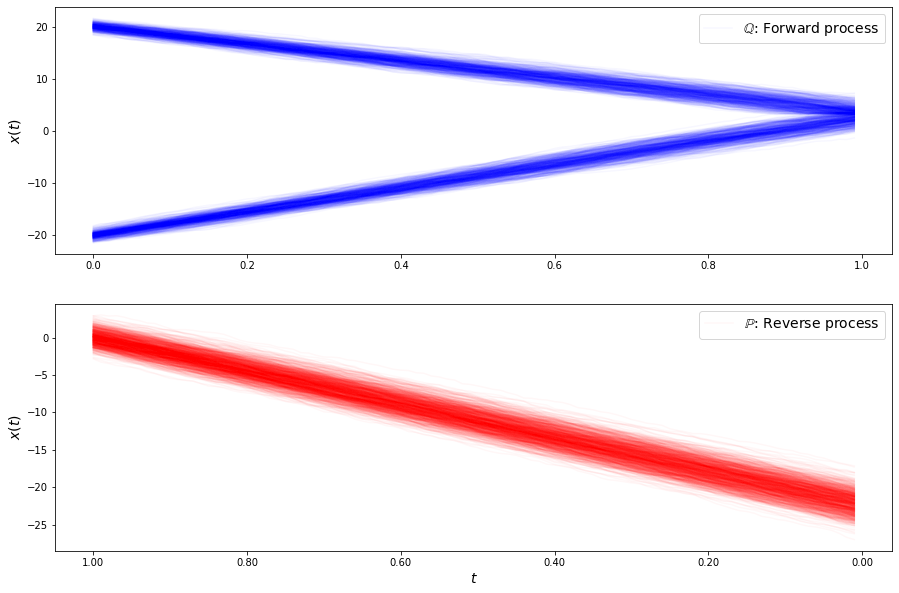

loss b 0.8625064933655309
loss b 0.8960615938608475
loss b 0.8745834400779839
loss b 0.9423141804887402
loss b 0.8689347295317097
loss b 0.9253285446011807
loss b 0.8702803901016377
loss b 0.8955536588683312
loss b 0.8715744391407688
loss b 0.8632139592904423
loss b 0.8946274888134177
loss b 0.9257280432278077
loss b 0.8548408722190719
loss b 0.8189209780424634
loss b 0.8574249346950465
loss b 0.8425410648936804
loss b 0.8445944285274534
loss b 0.782526814174067
loss b 0.8339993310323526
loss b 0.7977179515883316
loss b 0.7922237882505178
loss b 0.901144915193775
loss b 0.8752024551745667
loss b 0.878521845800656
loss b 0.9112591998788429
loss b 0.8465633036642304
loss b 0.8068486638169527
loss b 0.7560027367791876
loss b 0.7854796308197357
loss b 0.8478059780530718
loss f 1.1167240938673704
loss f 1.2140800494836885
loss f 1.1453480739722557
loss f 1.05734491896332
loss f 1.1587956338692451
loss f 1.088830383931104
loss f 1.2112781156178059
loss f 1.0594567670820505
loss f 1.058781615

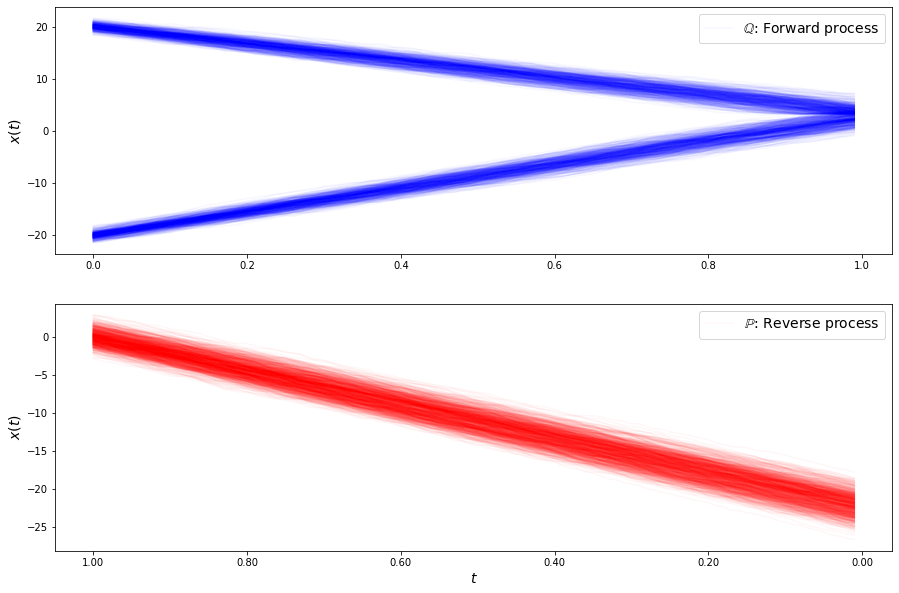

loss b 0.7541070420285544
loss b 0.8334694134125551
loss b 0.9028413021745766
loss b 0.8495959591741429
loss b 0.7854671663739315
loss b 0.7812038081083839
loss b 0.8063760477869837
loss b 0.8431374403372727
loss b 0.8551584267950946
loss b 0.8667592051070381
loss b 0.809594256774116
loss b 0.8419732968138728
loss b 0.7826839668746088
loss b 0.8773311439823656
loss b 0.868260563903246
loss b 0.7175582880997751
loss b 0.8095427827215723
loss b 0.7593338735404366
loss b 0.8210831370377883
loss b 0.779744616989452
loss b 0.7667952602017801
loss b 0.7546278350575872
loss b 0.7137735415931491
loss b 0.7747747726548506
loss b 0.6895418420938777
loss b 0.7634991284017003
loss b 0.7655798096393694
loss b 0.7220660684567297
loss b 0.78991174191698
loss b 0.7835174946653204
loss f 1.029890584528477
loss f 0.981748237524978
loss f 1.077269528302277
loss f 1.0005569178372415
loss f 1.0426741965887334
loss f 1.0038297245096188
loss f 1.1134343785560057
loss f 0.9991206509297222
loss f 0.99185689968

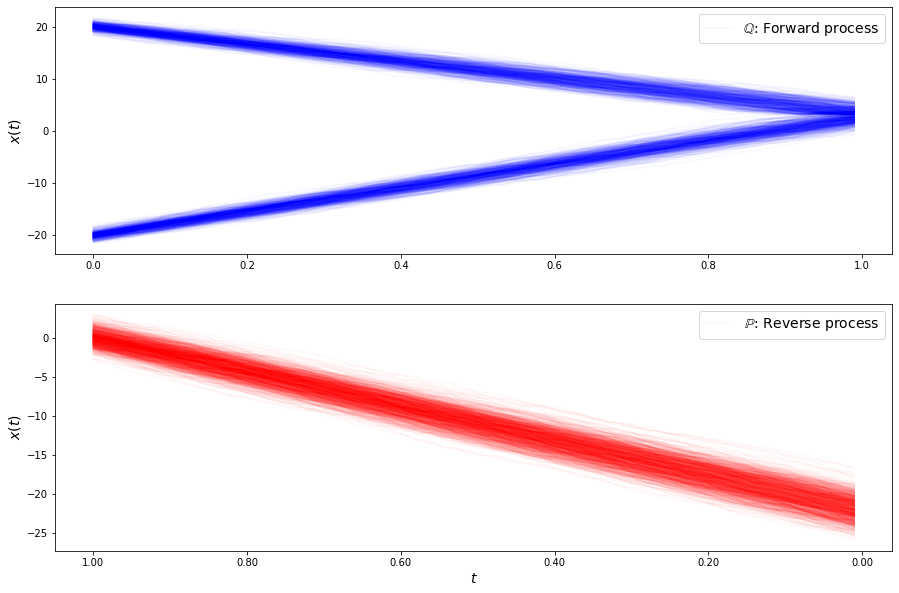

loss b 0.7149972879811867
loss b 0.802639924626242
loss b 0.8544526953546638
loss b 0.7816327636390764
loss b 0.768155672346498
loss b 0.7419741334292034
loss b 0.7800715443214157
loss b 0.8403478434604649
loss b 0.802073260464959
loss b 0.6282165148520809
loss b 0.7045585979346501
loss b 0.7395905177716782
loss b 0.7935180568596318
loss b 0.7534253704503309
loss b 0.7805577980298108
loss b 0.7085484715857795
loss b 0.7258677283324363
loss b 0.6417401269404511
loss b 0.7070303605059889
loss b 0.7283670832834125
loss b 0.6722499885724053
loss b 0.7381080675757155
loss b 0.7142855892337615
loss b 0.6667653700230831
loss b 0.7612348208522658
loss b 0.7993077899897731
loss b 0.7637258844588224
loss b 0.791631700534429
loss b 0.721968534755009
loss b 0.8595952037316518
loss f 1.0716775782484538
loss f 1.0653424179958928
loss f 1.0813141889577826
loss f 1.0169172327978353
loss f 0.9810271279722791
loss f 1.1094070944619456
loss f 1.0439929522742146
loss f 1.032670649247968
loss f 0.932036552

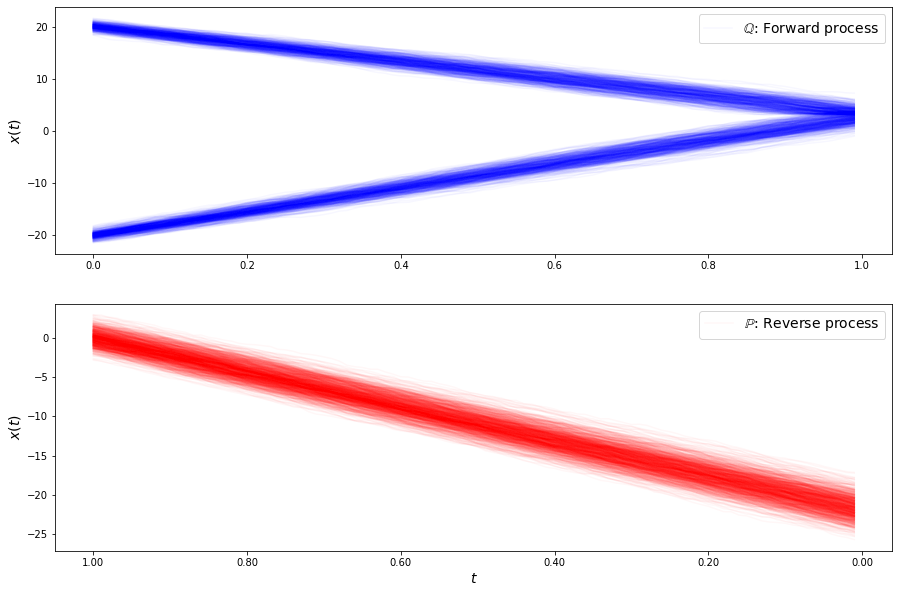

loss b 0.6689169955278618
loss b 0.6927940333177741
loss b 0.763845776490493
loss b 0.7115303493654802
loss b 0.7746004697552734
loss b 0.7751143174114065
loss b 0.7062558056688757
loss b 0.7271285223913171
loss b 0.6240704837754846
loss b 0.7682547391298326
loss b 0.6347407029622063
loss b 0.6857051445692075
loss b 0.6956835991266579
loss b 0.7682254432540813
loss b 0.6293929846826386
loss b 0.7189950324797043
loss b 0.7018852408228455
loss b 0.6361834638163728
loss b 0.8013023052349804
loss b 0.7238878836544778
loss b 0.6348941596037422
loss b 0.7388132731890007
loss b 0.8106099426139234
loss b 0.6626319327569611
loss b 0.7094558111652236
loss b 0.6662126362809493
loss b 0.7491422841035591
loss b 0.7357318464413231
loss b 0.6834484332785422
loss b 0.6607082562690553
loss f 1.0725479237279776
loss f 1.1177355012683774
loss f 0.9840624677563601
loss f 1.0111871722492112
loss f 0.9815480066584387
loss f 0.9885021675705179
loss f 1.045481137997481
loss f 1.0439490423187088
loss f 0.92912

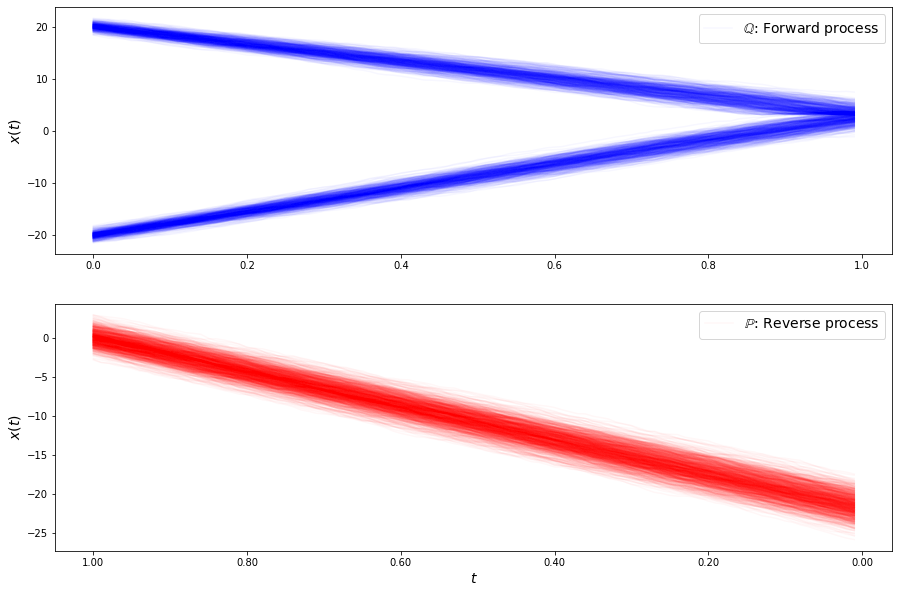

loss b 0.7178199272315458
loss b 0.7319317740835083
loss b 0.5717077238624516
loss b 0.5753934253676842
loss b 0.7054709773464461
loss b 0.7274223634636169
loss b 0.7380998656491248
loss b 0.679816336998312
loss b 0.7238700331738785
loss b 0.6977022404824215
loss b 0.6920451241099203
loss b 0.6639907928402677
loss b 0.7360503994938448
loss b 0.692178529905178
loss b 0.6117127800486962
loss b 0.6779846584449282
loss b 0.7458313085225128
loss b 0.6134139321095248
loss b 0.6848852905229273
loss b 0.7308718045105436
loss b 0.6630217494750562
loss b 0.7166832440217525
loss b 0.6646441299720885
loss b 0.6627931931394578
loss b 0.6596277195889066
loss b 0.7009504074669979
loss b 0.6446311445373282
loss b 0.7158734041960544
loss b 0.6571931895936574
loss b 0.7309079492689647
loss f 0.9821729503050964
loss f 0.9966864970800144
loss f 1.1000041256006736
loss f 0.828539983745171
loss f 1.0153905942350088
loss f 0.9762182493655926
loss f 1.0390736755192531
loss f 1.0127531645797097
loss f 0.921475

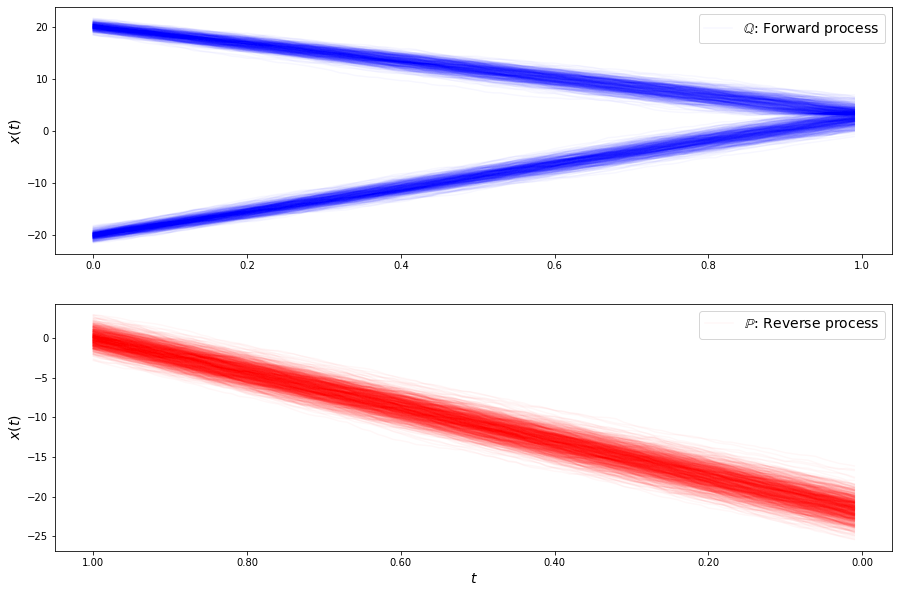

loss b 0.6169199048882922
loss b 0.680992255861239
loss b 0.7035999759681735
loss b 0.6044575978594551
loss b 0.6768012795154149
loss b 0.7270402124951567
loss b 0.6228989725768326
loss b 0.610412403313452
loss b 0.6909770094377544
loss b 0.5969126807781933
loss b 0.6849340948877383
loss b 0.6592807778838233
loss b 0.659549141259425
loss b 0.6351433852640822
loss b 0.671658811416917
loss b 0.6641022799372504
loss b 0.6762989055990885
loss b 0.5462616490506995
loss b 0.5510433070062655
loss b 0.5291357313730395
loss b 0.6581398139276475
loss b 0.7171324172240323
loss b 0.6674042398222686
loss b 0.534171471899893
loss b 0.5925527703584205
loss b 0.6826096215788019
loss b 0.6121404762336339
loss b 0.6841367247894782
loss b 0.6638914847466102
loss b 0.5743871077524786
loss f 0.9078444623345205
loss f 0.9410490016258433
loss f 0.9343662180146062
loss f 0.9004778390898703
loss f 0.8821503221564415
loss f 0.8447155477482755
loss f 1.058951965220678
loss f 0.9207948416658692
loss f 0.974905745

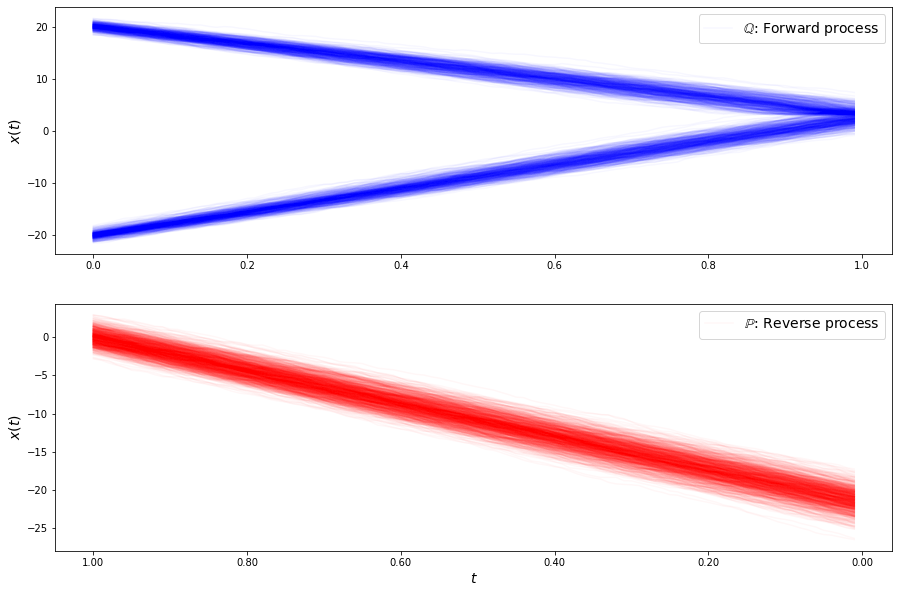

loss b 0.566290744706468
loss b 0.47594503143733247
loss b 0.5607885372335933
loss b 0.40695456882089465
loss b 0.612298333839584
loss b 0.6333295872643429
loss b 0.5038268596418091
loss b 0.6657709106590203
loss b 0.6124059506796992
loss b 0.4757205261825613
loss b 0.5938610674449092
loss b 0.5299246256669145
loss b 0.5699734484418302
loss b 0.5595810099329844
loss b 0.6735956570655216
loss b 0.5560672423152724
loss b 0.4984908223025017
loss b 0.5750881321209066
loss b 0.5618576792635445
loss b 0.5414079592031442
loss b 0.49925433145571685
loss b 0.5689882836197272
loss b 0.5979806631222255
loss b 0.5730192415413102
loss b 0.5318325456734118
loss b 0.5439385613567745
loss b 0.5593086268808175
loss b 0.4741856378107776
loss b 0.5626495693889635
loss b 0.615917027611925
loss f 0.7551285109994379
loss f 0.8434342927880834
loss f 0.8329040533626015
loss f 0.8018260706653668
loss f 0.8614623267939583
loss f 0.822512797024674
loss f 0.8077409830956637
loss f 0.8609091632210114
loss f 0.9895

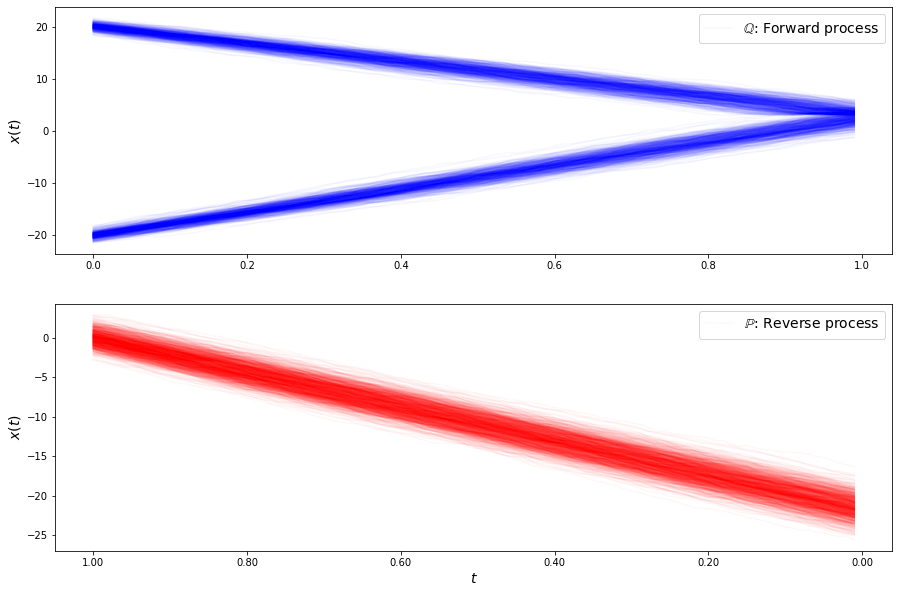

loss b 0.47074766771059284
loss b 0.4727522168751313
loss b 0.36899810632336205
loss b 0.5239610754886117
loss b 0.41731928071869856
loss b 0.4598952817315467
loss b 0.3619995869682202
loss b 0.46935777347122637
loss b 0.4052875938960006
loss b 0.438728267833086
loss b 0.3851737611672225
loss b 0.4807723642735186
loss b 0.5369771380239408
loss b 0.49110993066110775
loss b 0.44974396977806574
loss b 0.45248167449409255
loss b 0.5327919821211003
loss b 0.4422506633651994
loss b 0.4801777304903542
loss b 0.4208754474247582
loss b 0.43749340133099873
loss b 0.4346774210974815
loss b 0.502654177904262
loss b 0.36247174462253484
loss b 0.5491307372603326
loss b 0.39563898201940745
loss b 0.46516699588772076
loss b 0.479684989829208
loss b 0.3482716839364493
loss b 0.46991644379562403
loss f 0.8465922095437577
loss f 0.8470364376109205
loss f 0.75637365533453
loss f 0.8371440622352527
loss f 0.8064054456230911
loss f 0.8671204874992987
loss f 0.8401786333602221
loss f 0.7698785188744599
loss 

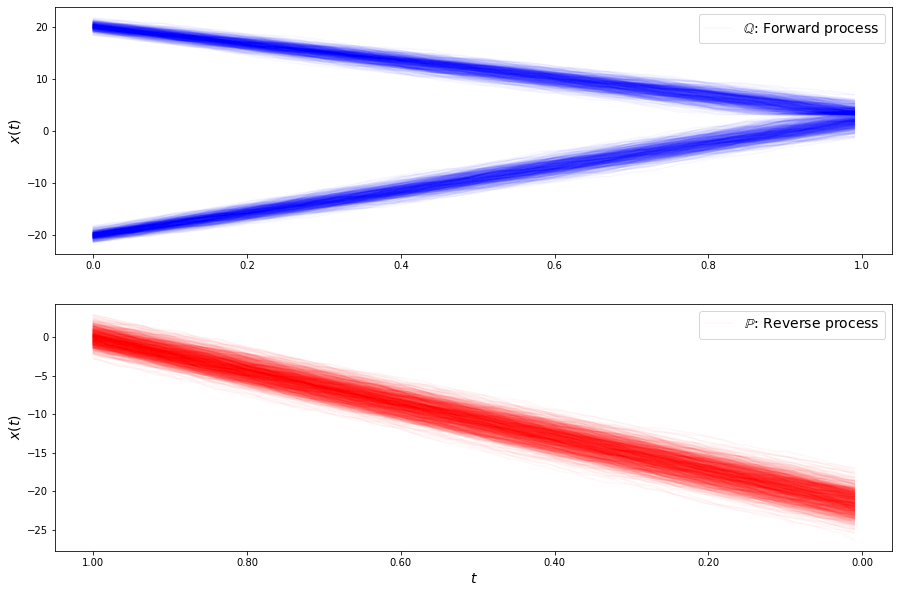

loss b 0.44681358243323854
loss b 0.43446514819298654
loss b 0.3954477121197157
loss b 0.36096296165814673
loss b 0.45224706439940543
loss b 0.35959981871170227
loss b 0.36602837481891964
loss b 0.5213850767474814
loss b 0.5124990466918851
loss b 0.3674678268745948
loss b 0.38793786142453063
loss b 0.44881623545890614
loss b 0.38391606238196335
loss b 0.31280909727879413
loss b 0.3534371973950275
loss b 0.4709019132930804
loss b 0.3672780900821121
loss b 0.39994879666481753
loss b 0.37922196524034585
loss b 0.28401466188213553
loss b 0.32349944341106807
loss b 0.5091042156296767
loss b 0.40706961130805497
loss b 0.4086868539886627
loss b 0.3736888350486431
loss b 0.38812307046445166
loss b 0.41086965245500023
loss b 0.3602516790348057
loss b 0.38127080379738715
loss b 0.36449349820909327
loss f 0.6611413266449406
loss f 0.685633612672312
loss f 0.7049563657476166
loss f 0.7916019443029937
loss f 0.6027975992825918
loss f 0.6458223022835685
loss f 0.6452106232859467
loss f 0.55091467023

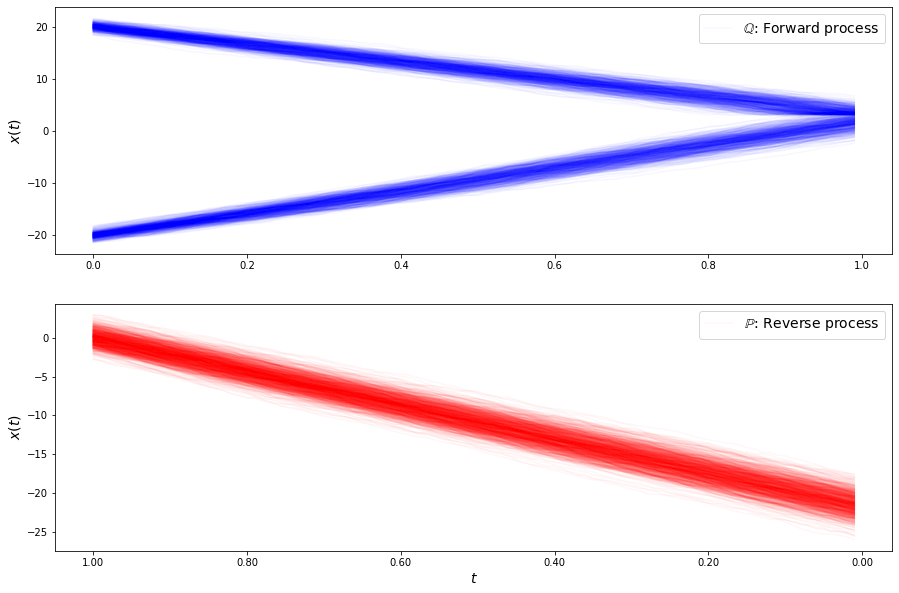

loss b 0.3689612221615626
loss b 0.3693107792939726
loss b 0.46216406611699284
loss b 0.44491500371139203
loss b 0.3996364576496064
loss b 0.4539341056279445
loss b 0.5597238709131017
loss b 0.4159299593609461
loss b 0.46334765603636197
loss b 0.48535107575177555
loss b 0.4428885913316368
loss b 0.3402162203463969
loss b 0.5306149536484691
loss b 0.4143754956647308
loss b 0.4605407179606966
loss b 0.3373779514774615
loss b 0.46580513713190713
loss b 0.35548797232030016
loss b 0.4080647528240622
loss b 0.45409718853750314
loss b 0.4464582207962293
loss b 0.42801732741798576
loss b 0.4374187656092739
loss b 0.41848366090640254
loss b 0.4149548129281743
loss b 0.501317584316508
loss b 0.4965210817318684
loss b 0.4582234601179956
loss b 0.41723762998849256
loss b 0.4004230105093228
loss f 0.6763585724927802
loss f 0.5377665735687924
loss f 0.667495492273458
loss f 0.59094675807117
loss f 0.66625393885719
loss f 0.6112662307026568
loss f 0.5404547954546546
loss f 0.7130293359419576
loss f 0

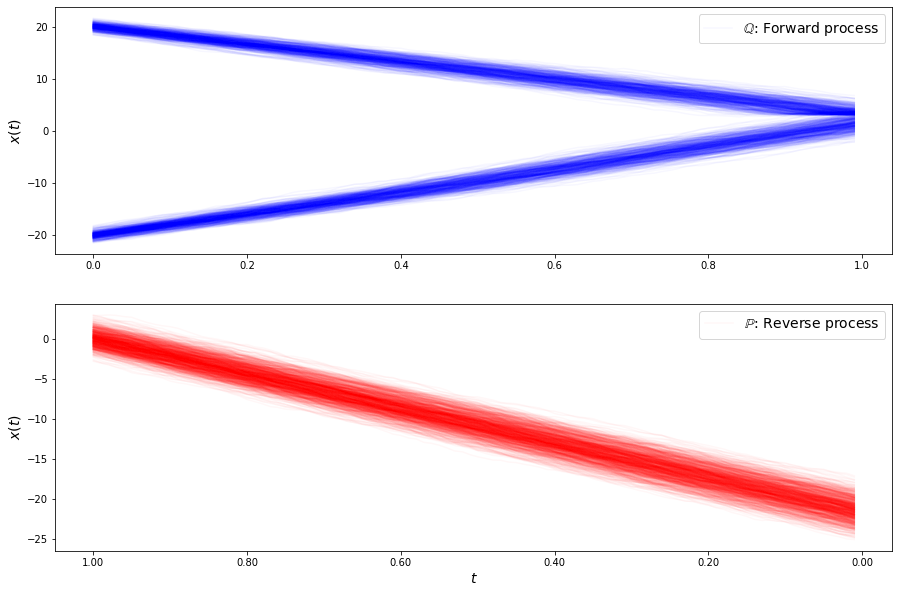

loss b 0.6100672272077009
loss b 0.665503459717378
loss b 0.545695319057682
loss b 0.491746886155243
loss b 0.5645533558867755
loss b 0.6038270190922619
loss b 0.4971550113724985
loss b 0.37602510331002653
loss b 0.4819651516268813
loss b 0.5265750968483316
loss b 0.3738514090212495
loss b 0.6352851670397252
loss b 0.604127938957244
loss b 0.5426176616010983
loss b 0.5199122136204145
loss b 0.4708541124812779
loss b 0.5097988911544048
loss b 0.44305115435624876
loss b 0.4565711602586604
loss b 0.48884607300397587
loss b 0.601220203174494
loss b 0.43392105337147574
loss b 0.5169071800423954
loss b 0.4580138958329178
loss b 0.45763624918232637
loss b 0.4606659854539674
loss b 0.4372627014256633
loss b 0.5671904797905813
loss b 0.5147474026875262
loss b 0.555475586606901
loss f 0.6879389588959266
loss f 0.5927760282794218
loss f 0.5887070505245866
loss f 0.5838943936631121
loss f 0.5616775605764862
loss f 0.5434924668767754
loss f 0.6102668125360455
loss f 0.6572643785541751
loss f 0.4352

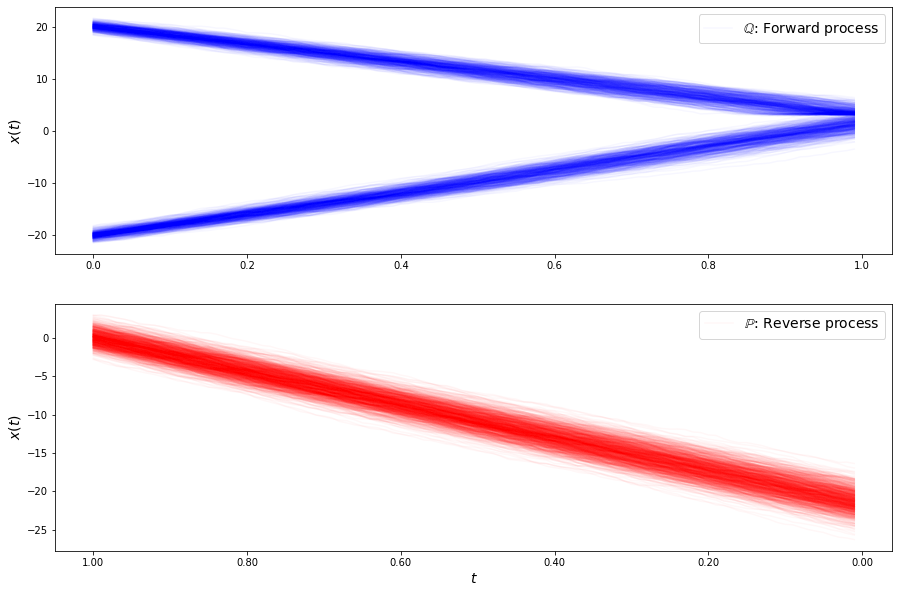

loss b 0.5495613729223225
loss b 0.5369082044197462
loss b 0.5380203237778056
loss b 0.4546799077231024
loss b 0.4060661452212757
loss b 0.4496775090421726
loss b 0.4641701061701796
loss b 0.4488089352675637
loss b 0.40311751113943584
loss b 0.360317807805476
loss b 0.34707629868905093
loss b 0.33390019095808066
loss b 0.42415821481367455
loss b 0.5861822028357009
loss b 0.4251568647756935
loss b 0.41887080409174204
loss b 0.38916762485509676
loss b 0.37068730051145937
loss b 0.31976991238783353
loss b 0.410109383809491
loss b 0.336781830092896
loss b 0.416612422232484
loss b 0.2979456160883645
loss b 0.3087939779700049
loss b 0.39490062729317604
loss b 0.27928173821493124
loss b 0.17364882201918236
loss b 0.1870577006442907
loss b 0.14192256956098345
loss b 0.2451038273805037
loss f 0.6214998410819665
loss f 0.6426229947426839
loss f 0.5795546267976232
loss f 0.6942337418214894
loss f 0.5784945259400599
loss f 0.7048337024776377
loss f 0.6016755711774491
loss f 0.6710200262009665
loss

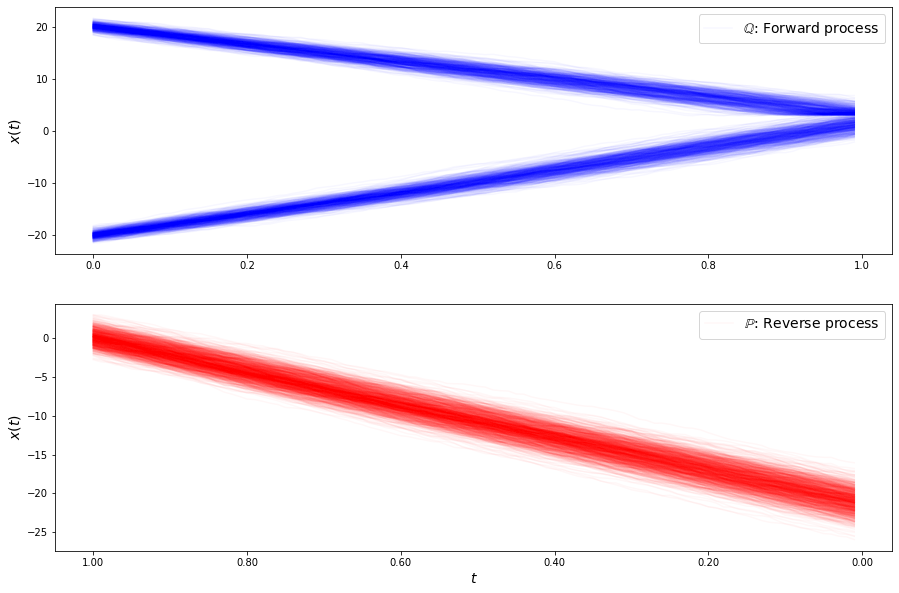

loss b 0.25652883900655526
loss b 0.14343452260463688
loss b 0.3902958671543465
loss b 0.2444479368889638
loss b 0.2286471526429887
loss b 0.18315848188700917
loss b 0.0698993984137445
loss b 0.06339114573596454
loss b 0.16175299606668248
loss b 0.1527596252905754
loss b 0.13539426255648812
loss b 0.10308115168402945
loss b 0.15903838666820166
loss b 0.23202628225498467
loss b 0.08664356030250754
loss b 0.007098416062724195
loss b 0.07439461625978076
loss b 0.08379510029860888
loss b 0.09080070453061737
loss b 0.032907555168444104
loss b -0.09587834057491064
loss b -0.1669641634404795
loss b -0.057883461263961586
loss b -0.025017783152502502
loss b 0.02550478575711457
loss b -0.08844857111485963
loss b -0.11101125339430577
loss b -0.07305637501516513
loss b -0.014329848380303243
loss b -0.06624673927752449
loss f 0.44555433531463173
loss f 0.4970936408377616
loss f 0.5635667773955175
loss f 0.5230595804046934
loss f 0.5621657564021578
loss f 0.48887618935629984
loss f 0.474865508013610

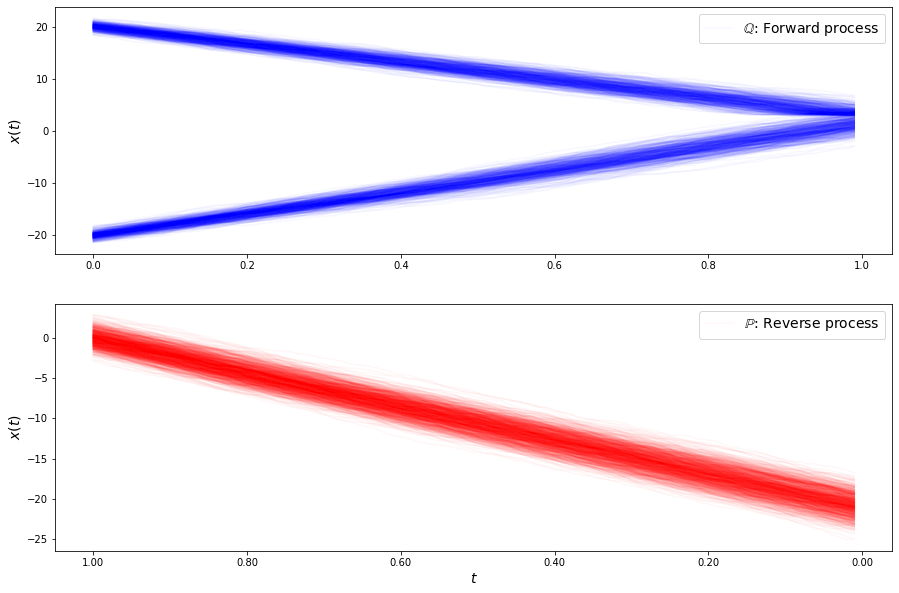

loss b -0.08345088154689254
loss b -0.21099497658382907
loss b -0.11390811680756997
loss b -0.20246673169300067
loss b -0.1732764945802095
loss b -0.16656459030160445
loss b -0.18761721882036675
loss b -0.13732555283676032
loss b -0.23150031495859863
loss b -0.40646842173181746
loss b -0.31493928157247364
loss b -0.2245197354311396
loss b -0.14314588358271585
loss b -0.22141504463042153
loss b -0.10861027210284421
loss b -0.17096605024366668
loss b -0.21439148894689233
loss b -0.15480878910785278
loss b -0.2651187845286319
loss b -0.22423286527892378
loss b -0.2918950323374116
loss b -0.3803005690987259
loss b -0.37669719179114286
loss b -0.0750769801544555
loss b -0.18707372973184663
loss b -0.3244953123891178
loss b -0.23386968371444508
loss b -0.2832132843687366
loss b -0.30142477017474545
loss b -0.3376543578128127
loss f 0.5494162228862595
loss f 0.6169712865544201
loss f 0.670782278344814
loss f 0.4969663441918967
loss f 0.5903755902679724
loss f 0.45136940735121184
loss f 0.5308

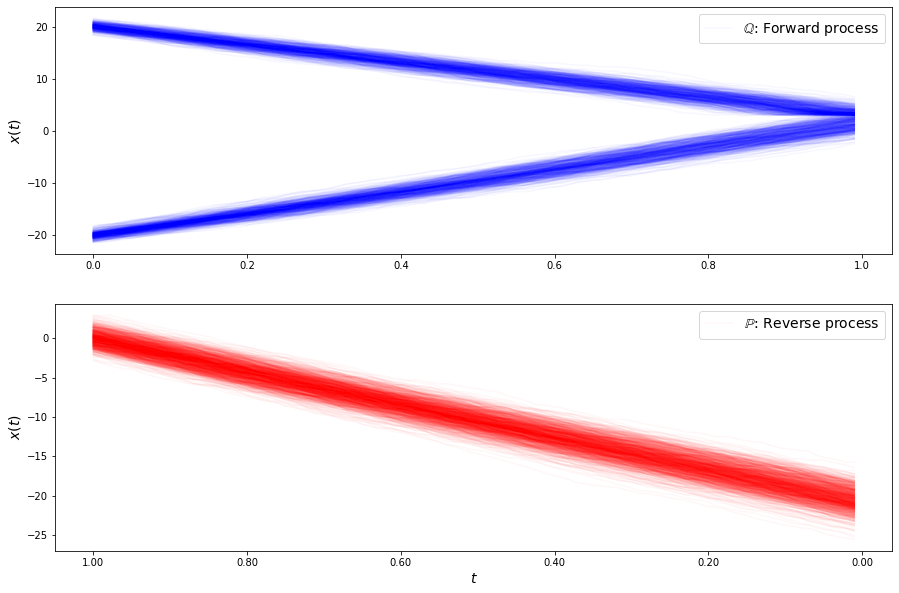

loss b -0.2806208075798156
loss b -0.382788941897222
loss b -0.2509175286308447
loss b -0.23202290442825604
loss b -0.28096771122446257
loss b -0.15235257668705446
loss b -0.5025693089119727
loss b 0.012424289099268312
loss b -0.26055180073726736
loss b -0.22742092773428962
loss b -0.3815632131673915
loss b -0.4154632555929769
loss b -0.2851613969785139
loss b -0.4350384155520784
loss b -0.2150324658272232
loss b -0.09155044881557448
loss b -0.24988465496816534
loss b -0.2895780820505509
loss b -0.24911098555713987
loss b -0.2696539938049643
loss b -0.17029219893590536
loss b -0.24035794317683182
loss b -0.3502022367579211
loss b -0.4624853051614295
loss b -0.25147533695195295
loss b -0.3655659046225578
loss b -0.40830862929141254
loss b -0.19632393662746436
loss b -0.31630268490291036
loss b -0.15373509560797582
loss f 0.5629863231656935
loss f 0.5797139223720474
loss f 0.564179172340012
loss f 0.5186133932218203
loss f 0.6018037469784693
loss f 0.6713054900253274
loss f 0.52027240942

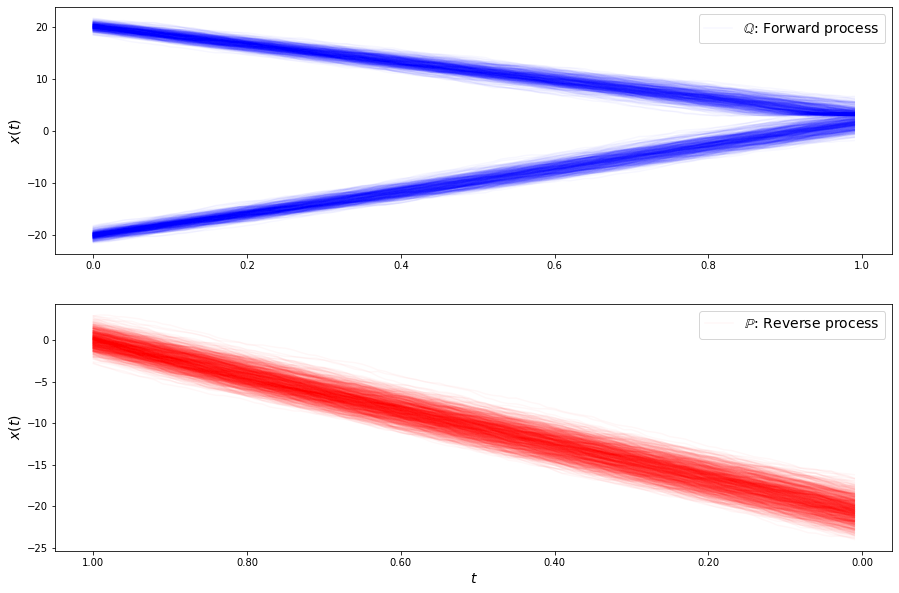

loss b -0.4427092438096713
loss b -0.4323367125761522
loss b -0.2449963265307305
loss b -0.34036786143628944
loss b -0.2520254648374583
loss b -0.3482995206508086
loss b -0.23240031491360577
loss b -0.2982464258588131
loss b -0.36450644303207164
loss b -0.25350272374749666
loss b -0.255998327719671
loss b -0.2749620732060122
loss b -0.34590548226550405
loss b -0.4290605282894251
loss b -0.3805958396639541
loss b -0.32479201038559646
loss b -0.36199743169563725
loss b -0.5510215067735852
loss b -0.40176586765037064
loss b -0.35885718552770035
loss b -0.315095002570805
loss b -0.4217234051477926
loss b -0.15079435445061248
loss b -0.46867182000861934
loss b -0.29740053781820674
loss b -0.22566232232147032
loss b -0.3470483846310285
loss b -0.4200472082202473
loss b -0.12515770953405858
loss b -0.3336102514220846
loss f 0.6032107946644755
loss f 0.613200656356276
loss f 0.522084814741172
loss f 0.44614008289897705
loss f 0.6338745058059029
loss f 0.41431713523296365
loss f 0.5620196496988

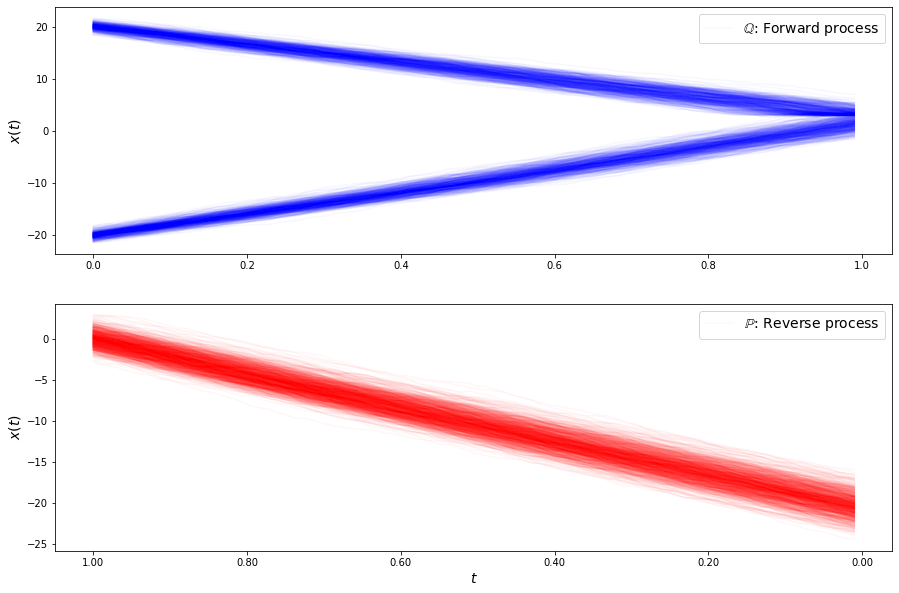

loss b -0.36724311933748294
loss b -0.5685853695555215
loss b -0.3867490814345694
loss b -0.4512470651782202
loss b -0.20163832069299067
loss b -0.3394160835669995
loss b -0.5439663208483565
loss b -0.3639914269052829
loss b -0.551067730335009
loss b -0.2517508095820494
loss b -0.5764013271620857
loss b -0.38131134589624427
loss b -0.25406342287524364
loss b -0.2733935494404042
loss b -0.3812467057761117
loss b -0.5601497747725671
loss b -0.45363997370468706
loss b -0.4985664229869252
loss b -0.2791525578827318
loss b -0.535348866362043
loss b -0.33195604671751405
loss b -0.4302053557237306
loss b -0.3421198919071139
loss b -0.504875438241961
loss b -0.3174679203913888
loss b -0.5995997777120312
loss b -0.43942295692705824
loss b -0.31601275666930684
loss b -0.3477213165059043
loss b -0.3842907762875238
loss f 0.4912632582714595
loss f 0.4260478940724531
loss f 0.5093803049256523
loss f 0.49829094586945155
loss f 0.47235206312413897
loss f 0.5943241580415997
loss f 0.5341622474767543
l

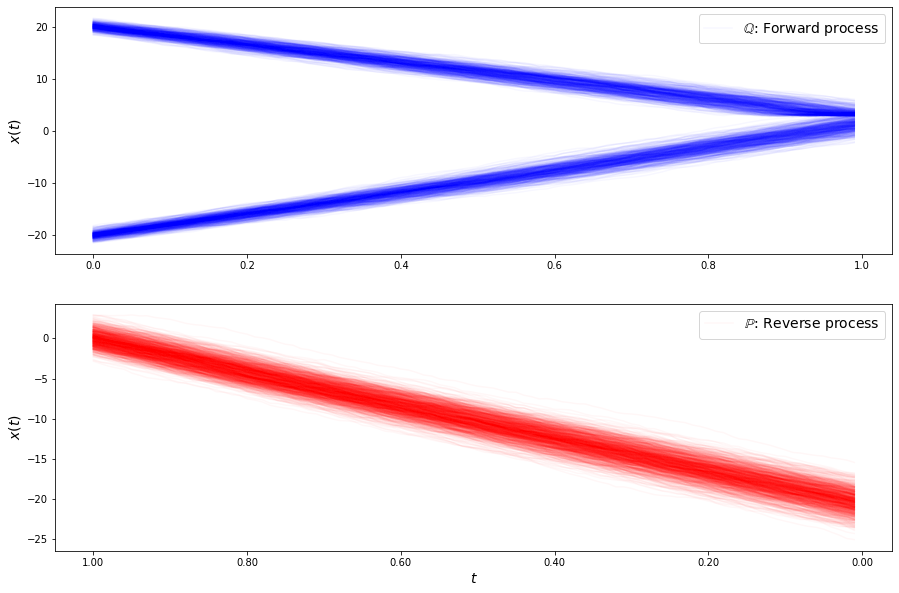

loss b -0.481643157817157
loss b -0.5591671375779611
loss b -0.504725356557498
loss b -0.3932087313161777
loss b -0.403595788480499
loss b -0.5386025990795378
loss b -0.5108855983951535
loss b -0.4778671117107329
loss b -0.602781680575604
loss b -0.5056299687191355
loss b -0.39473728938222663
loss b -0.7815986076264148
loss b -0.47932376040987534
loss b -0.4091987096721159
loss b -0.48557710058520076
loss b -0.5666113333013616
loss b -0.37428676180550763
loss b -0.5313228384402701
loss b -0.5191088489663729
loss b -0.5243741159741219
loss b -0.643635226514769
loss b -0.43431023764439275
loss b -0.5388071826100159
loss b -0.4909060225071929
loss b -0.5224525835380203
loss b -0.5975691216422483
loss b -0.5739210791094853
loss b -0.47822550799773317
loss b -0.4699552276335544
loss b -0.3478140578596674
loss f 0.30261452141102263
loss f 0.3344724712389891
loss f 0.41847740966641517
loss f 0.5313741313800547
loss f 0.401960333332101
loss f 0.365421196015436
loss f 0.30491928314748595
loss f

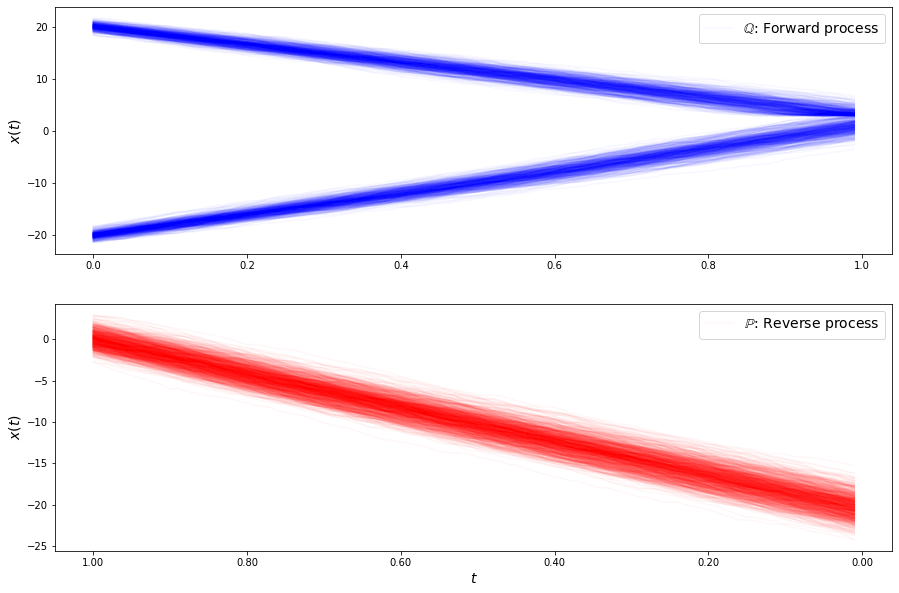

loss b -0.49237283866209125
loss b -0.6203619139869808
loss b -0.6821839608112319
loss b -0.7711480689964928
loss b -0.5741205850442509
loss b -0.5466661203370897
loss b -0.5223940735808481
loss b -0.513503997245123
loss b -0.5692758474296561
loss b -0.6381697486041449
loss b -0.5251201716686706
loss b -0.5157404720565161
loss b -0.6197402546985717
loss b -0.5173129795794121
loss b -0.5632967494792017
loss b -0.669591891204292
loss b -0.5032631423338362
loss b -0.534119447813634
loss b -0.6259745239425487
loss b -0.3931473587629201
loss b -0.5387668859821394
loss b -0.6649521788325696
loss b -0.5440764036835535
loss b -0.7251348691133302
loss b -0.5589408781276702
loss b -0.7877970989000722
loss b -0.39866780414496056
loss b -0.6044033007953752
loss b -0.49795236427858325
loss b -0.5642545768219854
loss f 0.1768510123582156
loss f 0.3703969281093973
loss f 0.24069558354713785
loss f 0.278355599141703
loss f 0.5078475927338821
loss f 0.3107684918290598
loss f 0.17976144685567264
loss f 

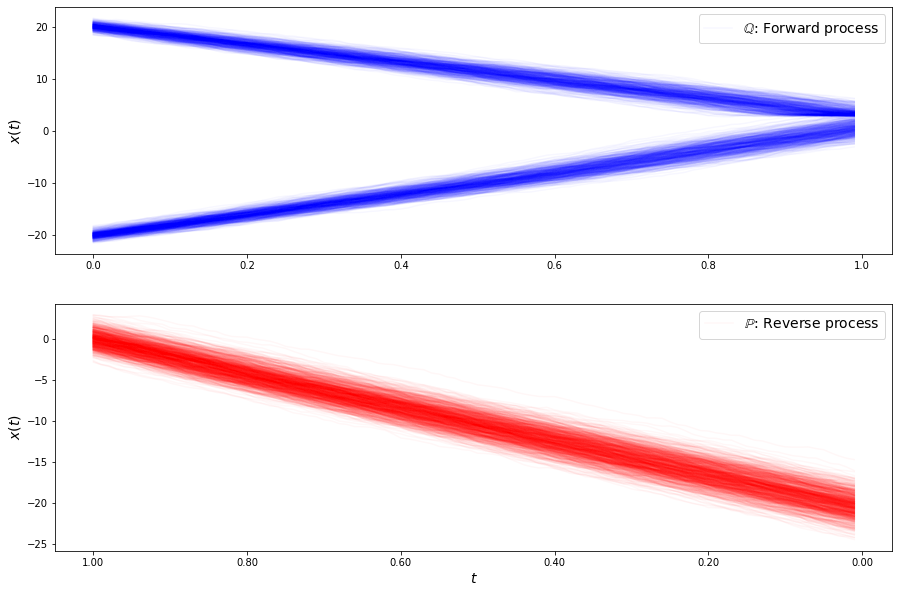

loss b -0.6405187258488123
loss b -0.6124316751414185
loss b -0.4903157842281721
loss b -0.6143637953426199
loss b -0.6859619657810552
loss b -0.5591342004391984
loss b -0.6171268106379041
loss b -0.5587289742365578
loss b -0.600434888215024
loss b -0.6093267037985479
loss b -0.6221035273341006
loss b -0.631417692953918
loss b -0.6053814277926255
loss b -0.6501677983152039
loss b -0.6595725125047868
loss b -0.5460825481682215
loss b -0.6476084508719505
loss b -0.5584157484263057
loss b -0.5227625318440577
loss b -0.5377305971645255
loss b -0.6103950809765329
loss b -0.593223383453981
loss b -0.62249364563342
loss b -0.7551679994165157
loss b -0.7034647035565684
loss b -0.6076936628656119
loss b -0.5076463081190424
loss b -0.5572442235095613
loss b -0.5727795346005633
loss b -0.6629342795033999
loss f 0.11101561505126016
loss f 0.14762322997503222
loss f 0.11807888347992351
loss f 0.2582356743046014
loss f 0.17108289209509472
loss f 0.15775244506408193
loss f 0.18337560421733629
loss f 

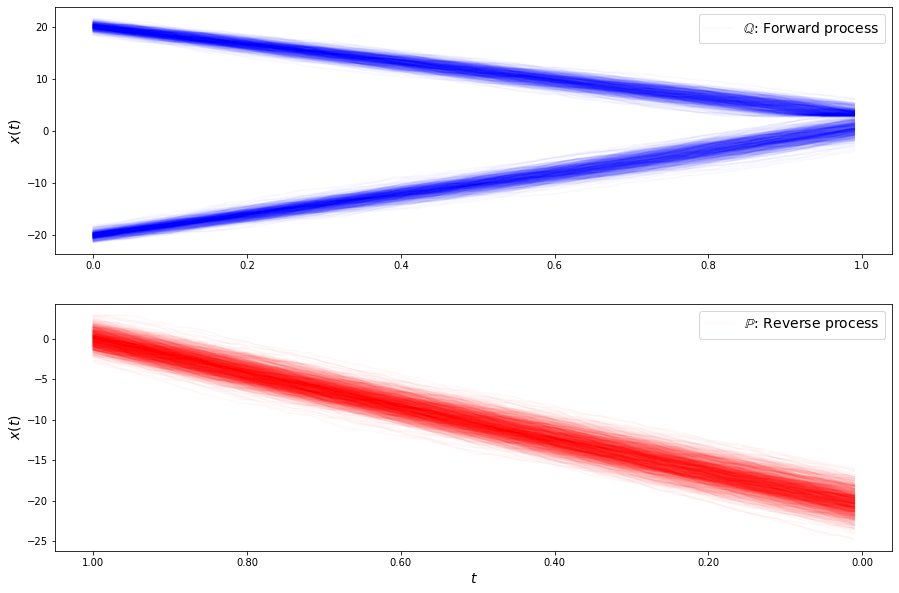

loss b -0.6176023079292777
loss b -0.5241814139124772
loss b -0.7234448002848998
loss b -0.5214549736468183
loss b -0.5763223098570642
loss b -0.5466418235784757
loss b -0.5736947214863392
loss b -0.5292948414068546
loss b -0.5608935230341646
loss b -0.6253810951496911
loss b -0.5780115373304066
loss b -0.5220769672526184
loss b -0.6383402277041458
loss b -0.5612947516179194
loss b -0.5700742948559469
loss b -0.5392286985395713
loss b -0.6786432440306353
loss b -0.6147719806396829
loss b -0.6581328714325994
loss b -0.5842255057151787
loss b -0.7271028459655414
loss b -0.7549169345003499
loss b -0.7402629096230741
loss b -0.6130656655795765
loss b -0.551044051544749
loss b -0.6409105883468175
loss b -0.5707303607432798
loss b -0.7052040059553698
loss b -0.6471804974241068
loss b -0.48356049687819225
loss f 0.04885902572735613
loss f 0.2006554565637841
loss f 0.27380948698240876
loss f 0.16926432492773016
loss f 0.1919321993338533
loss f 0.1136780861362986
loss f -0.008760118279328646
lo

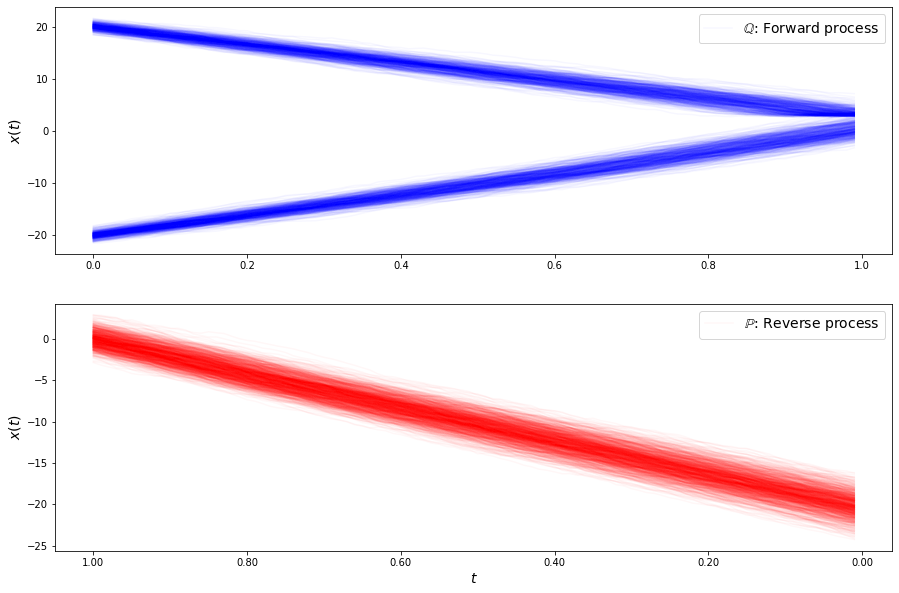

loss b -0.6595209877327867
loss b -0.5935921378797736
loss b -0.5827849040116514
loss b -0.48963682839800315
loss b -0.577769561063493
loss b -0.7464159478969375
loss b -0.48102008091390314
loss b -0.737087537567184
loss b -0.6574995790986264
loss b -0.6466412908100845
loss b -0.6145126700263249
loss b -0.4770401540503479
loss b -0.5713780412102023
loss b -0.6618685166866668
loss b -0.47696262702434744
loss b -0.6421327411017034
loss b -0.8275013098196066
loss b -0.691014843701126
loss b -0.5228784649581196
loss b -0.6112254678133299
loss b -0.4460878557259129
loss b -0.5388226290969218
loss b -0.648167853384977
loss b -0.5834453100674205
loss b -0.5906577728558092
loss b -0.7206552906220118
loss b -0.871818476510928
loss b -0.79893167170032
loss b -0.5302857906401762
loss b -0.5285346235263227
loss f 0.10725222602740662
loss f 0.07636863667392706
loss f -0.0017383956594964763
loss f 0.024191309450375644
loss f 0.06961371704442491
loss f 0.036837460053189504
loss f 0.04620122086748025


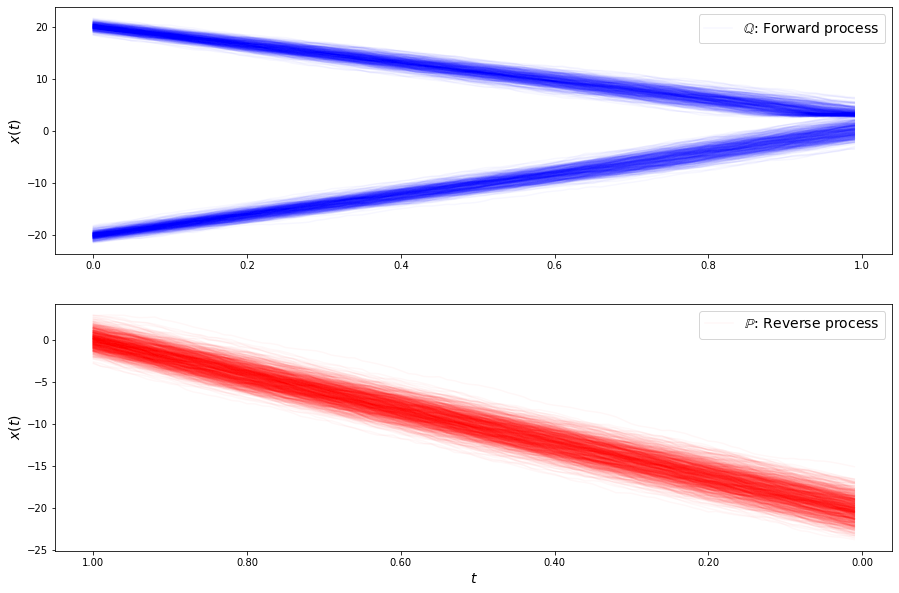

loss b -0.6067340260192665
loss b -0.7259730592090009
loss b -0.6467661745855535
loss b -0.6718427136061108
loss b -0.5995633251743845
loss b -0.8192414071752507
loss b -0.9218881139560893
loss b -0.6741685410106295
loss b -0.7001650611083258
loss b -0.6175767153627024
loss b -0.6589048645898851
loss b -0.7956808252171742
loss b -0.7626890740880254
loss b -0.6402966890480689
loss b -0.6246183700895004
loss b -0.4383596753433765
loss b -0.6523653465920424
loss b -0.584130786086982
loss b -0.7566584971030312
loss b -0.8971503872511983
loss b -0.4687806284417018
loss b -0.5868650075170866
loss b -0.4464794185374736
loss b -0.7450178184252936
loss b -0.5896403530054026
loss b -0.8025150561844687
loss b -0.7356603093136256
loss b -0.7394115682255724
loss b -0.6375306510454098
loss b -0.763663433273726
loss f -0.008586240158711372
loss f 0.10658415495504732
loss f -0.03780738660447196
loss f -0.15067708052944703
loss f -0.05106018750984959
loss f 0.2097313025015942
loss f 0.08322741055953159

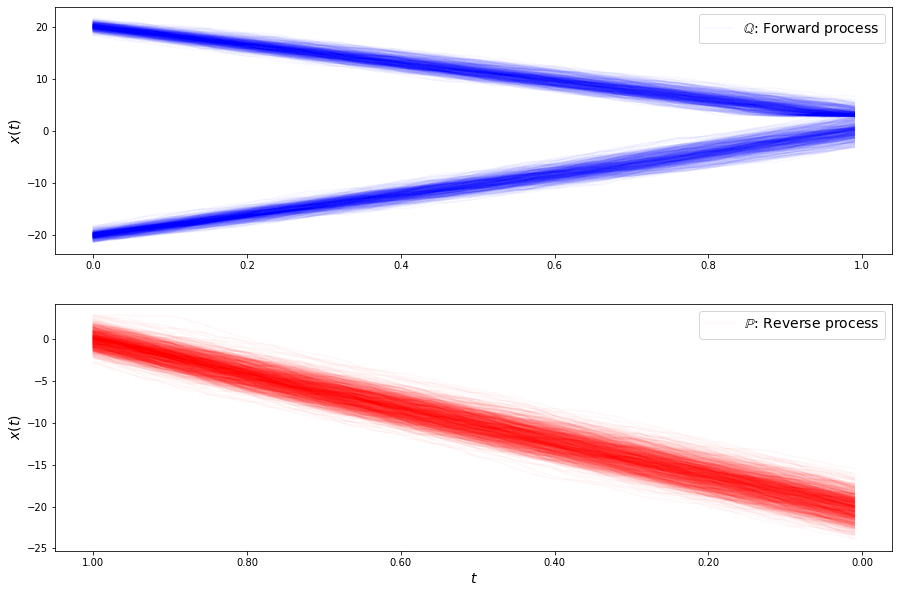

loss b -0.7795485248629032
loss b -0.6072780057487666
loss b -0.6900199683123802
loss b -0.5829532237549638
loss b -0.7734155619149526
loss b -0.8450397498167821
loss b -0.543348775331562
loss b -0.8407207347428806
loss b -0.6531541955306157
loss b -0.7354862827711542
loss b -0.5898467209850882
loss b -0.529995846696986
loss b -0.8420353856492712
loss b -0.7628416679971541
loss b -0.8141929222933658
loss b -0.6360605565433017
loss b -0.7894045309408557
loss b -0.8882905014485237
loss b -0.4949406023256361
loss b -0.7747679430102653
loss b -0.7161565393880779
loss b -0.7141361790906455
loss b -0.7847622333602411
loss b -0.8238464654900499
loss b -0.7433449967879708
loss b -0.5696035914373887
loss b -0.8658581379058871
loss b -0.8104145568869315
loss b -0.8027758952455146
loss b -0.6712065873018199
loss f -0.09355493762193486
loss f 0.08650922532923544
loss f -0.2523461114425006
loss f -0.0951316048484078
loss f 0.0768405988075751
loss f -0.05043501359712843
loss f -0.198707442157433
los

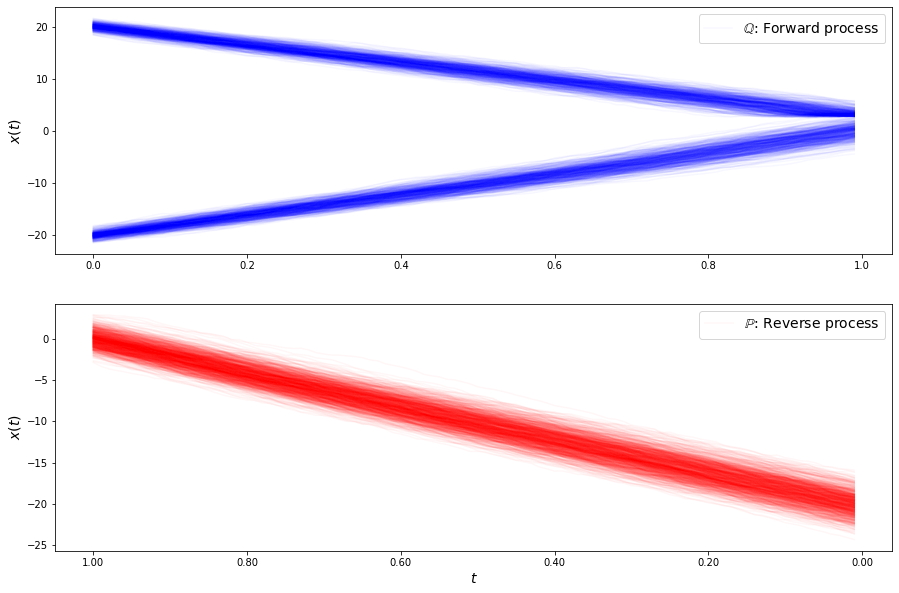

loss b -0.8014429165851198
loss b -0.8367319716682671
loss b -0.7427514781925327
loss b -0.9661880502467813
loss b -0.790338629059816
loss b -0.7245753494469623
loss b -0.8949206985983893
loss b -0.8505872523816875
loss b -0.7223060731133306
loss b -0.797434487629581
loss b -0.8614328461553397
loss b -0.7193727795659333
loss b -0.6982957462886187
loss b -0.7473327128816546
loss b -0.7795614278638352
loss b -0.6121983593560159
loss b -0.8082749940366641
loss b -0.7721591469105257
loss b -0.8883074017296039
loss b -0.7825322875170883
loss b -0.6684080470757789
loss b -0.8453826935087286
loss b -0.6607840614624658
loss b -0.830676133583432
loss b -0.8852243358178098
loss b -0.8410318423762403
loss b -0.932516134634191
loss b -0.8822209776036821
loss b -0.7383123833891104
loss b -0.8632254827745005
loss f -0.09130460811332702
loss f -0.03515666501901303
loss f -0.1240336132940304
loss f -0.2285803924149957
loss f -0.2124918380931932
loss f -0.14638533887868135
loss f -0.26296997716454995
l

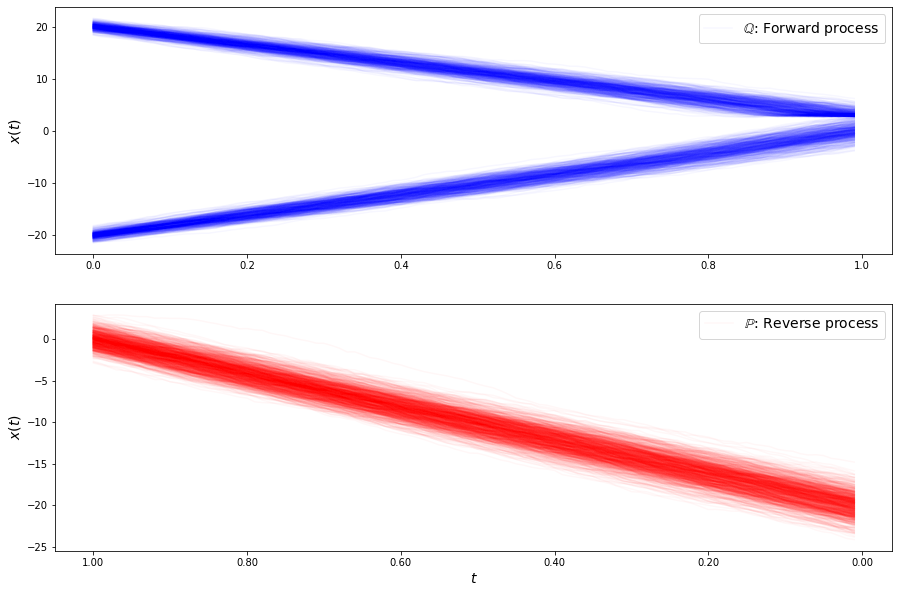

loss b -0.9040783492565669
loss b -1.028969684443896
loss b -0.8316827634152791
loss b -0.7419140549509301
loss b -0.9397656898321225
loss b -0.9948356468443924
loss b -0.9033377666150096
loss b -0.8515338431019676
loss b -0.6906897249463886
loss b -0.846328676601951
loss b -0.854871207609495
loss b -0.9943769844287873
loss b -0.8217906904283524
loss b -0.9336970430817236
loss b -0.6663441617335096
loss b -0.8698175291736608
loss b -0.8083024887083263
loss b -0.9078304095413618
loss b -0.9812500707779024
loss b -0.831239095521611
loss b -0.9344852681893825
loss b -0.8987387210117117
loss b -0.8616650225356186
loss b -0.778804984732516
loss b -0.9144745723442517
loss b -0.7372524362157171
loss b -0.7472210440968147
loss b -0.9977832922404616
loss b -0.8966084532688191
loss b -1.037768585983523
loss f -0.23979325218230574
loss f -0.35693054155992615
loss f -0.1909375199144079
loss f -0.2319852163556406
loss f -0.22038960476004188
loss f -0.3979291429990371
loss f -0.5027756474876593
loss

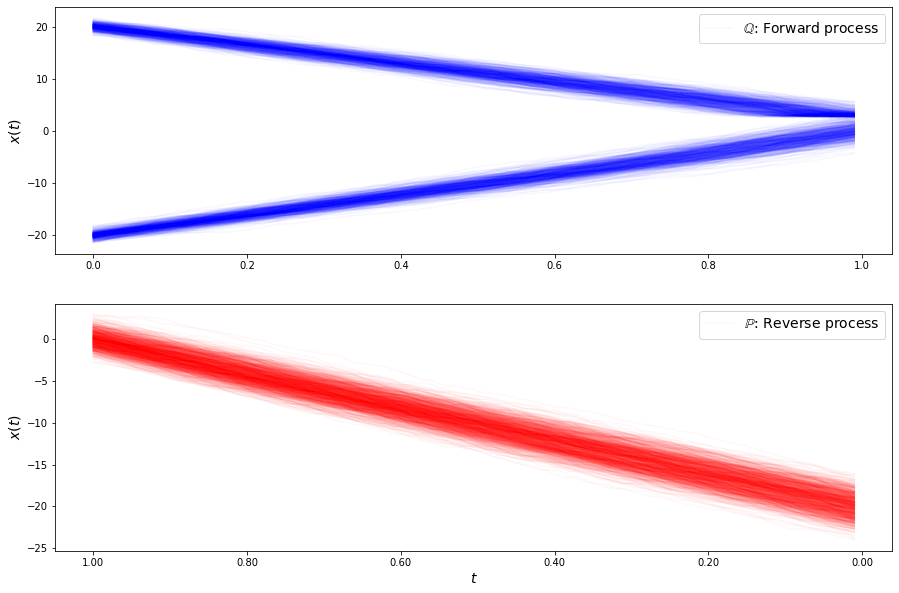

loss b -0.8472613558900923
loss b -0.8959811162714885
loss b -1.0092749149048705
loss b -0.8993900179105885
loss b -0.8695745829132805
loss b -0.8373845509508839
loss b -0.9907411916335007
loss b -0.939082446489707
loss b -1.1000176960151526
loss b -0.8710561731529501
loss b -0.8240561909623298
loss b -0.7128381889965163
loss b -0.8023884256879298
loss b -1.0725971751852048
loss b -1.2007610192424611
loss b -0.9223024261238494
loss b -1.1448443908171495
loss b -1.0064035323302079
loss b -0.8426621500877486
loss b -1.0973087818431217
loss b -1.002707077626018
loss b -0.9575671072978483
loss b -0.9080747764036434
loss b -0.9812983844682749
loss b -0.8790841685907231
loss b -1.1980584969417394
loss b -1.0038621368540885
loss b -1.1101477777278432
loss b -0.8641150390442336
loss b -1.016814141638863
loss f -0.6440182116562007
loss f -0.5140527811473614
loss f -0.36123852095916875
loss f -0.47017555705470243
loss f -0.31376085298353196
loss f -0.21983267200707157
loss f -0.24664637278690654

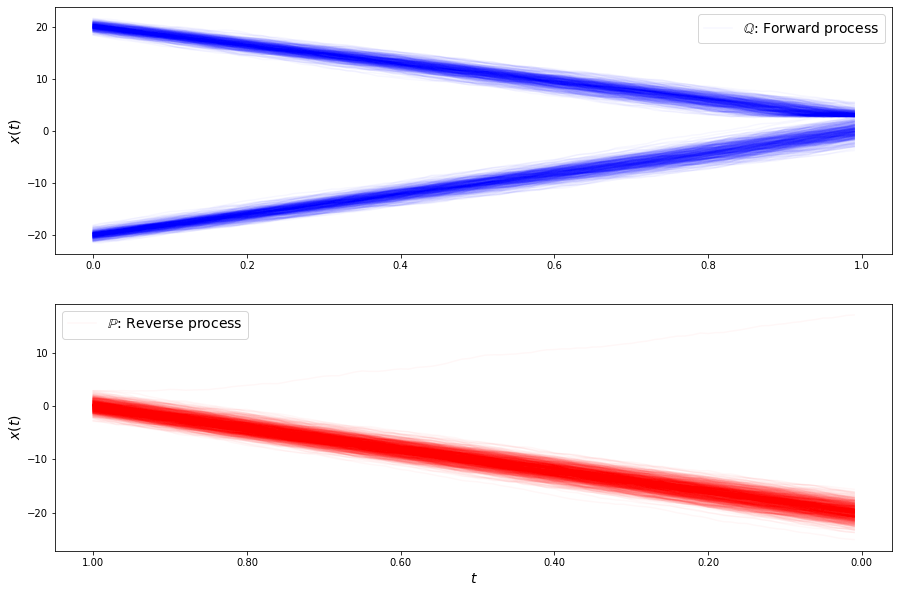

loss b -1.0015600790845571
loss b -0.9482425162867728
loss b -1.0260585917251923
loss b -1.1661679624543895
loss b -1.1122002717205877
loss b -1.0997309833017104
loss b -0.9997467249610518
loss b -1.2101189514209183
loss b -1.0157816023221
loss b -1.0085495336540211
loss b -0.999850795493045
loss b -0.9806773052106897
loss b -1.1334925827149347
loss b -1.0329943972500168
loss b -0.9575851136580346
loss b -1.0923364815677903
loss b -1.0487485325765824
loss b -1.004697692671222
loss b -0.9389483263713491
loss b -1.0855057358854756
loss b -0.8376362341551694
loss b -1.0347177381709745
loss b -1.0587486194768991
loss b -0.9848899870116969
loss b -0.9876135971619803
loss b -1.0244124393021141
loss b -0.9409302459039744
loss b -1.035293418041507
loss b -1.0121016113786343
loss b -0.9048200355269332
loss f -0.4482343471583421
loss f -0.4181797146595484
loss f -0.44214342416128016
loss f -0.6279518171000688
loss f -0.2668223525850175
loss f -0.3350079012287933
loss f -0.5093741793250176
loss f

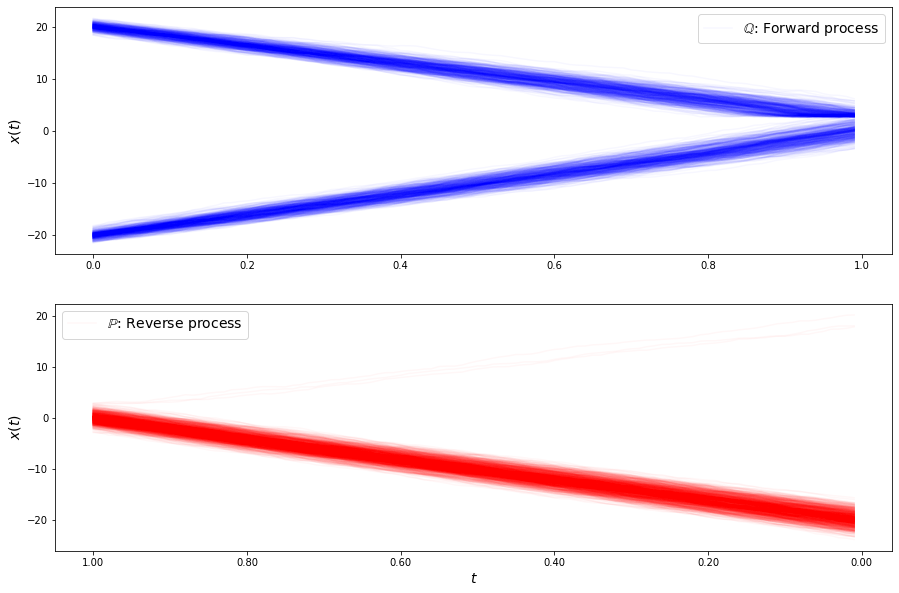

loss b -1.0657379468094983
loss b -1.0397698693211548
loss b -1.0111777250621437
loss b -0.9272375333773908
loss b -1.077773791982808
loss b -0.9268503597306328
loss b -0.9153029270385904
loss b -0.8969130999809272
loss b -1.0846907962843244
loss b -1.1706731996349091
loss b -1.0218245690057386
loss b -1.0358044608976693
loss b -0.9654807913581698
loss b -0.956016490222567
loss b -0.9020736126138218
loss b -0.9966255213719325
loss b -0.9897007367446254
loss b -1.2133256821850373
loss b -1.0014519012534817
loss b -1.1126774034247826
loss b -1.0171149943827469
loss b -1.107738762353005
loss b -1.1105127156520118
loss b -1.0666422794364705
loss b -1.03583744053841
loss b -0.9242212240134376
loss b -0.8880746450234323
loss b -1.0978179326779247
loss b -1.1123155527082642
loss b -1.044346538309647
loss f -0.7314049767805196
loss f -0.5994252168942115
loss f -0.6036188079588405
loss f -0.6284117310985631
loss f -0.492647202585508
loss f -0.50990483412108
loss f -0.6101238503433342
loss f -0.

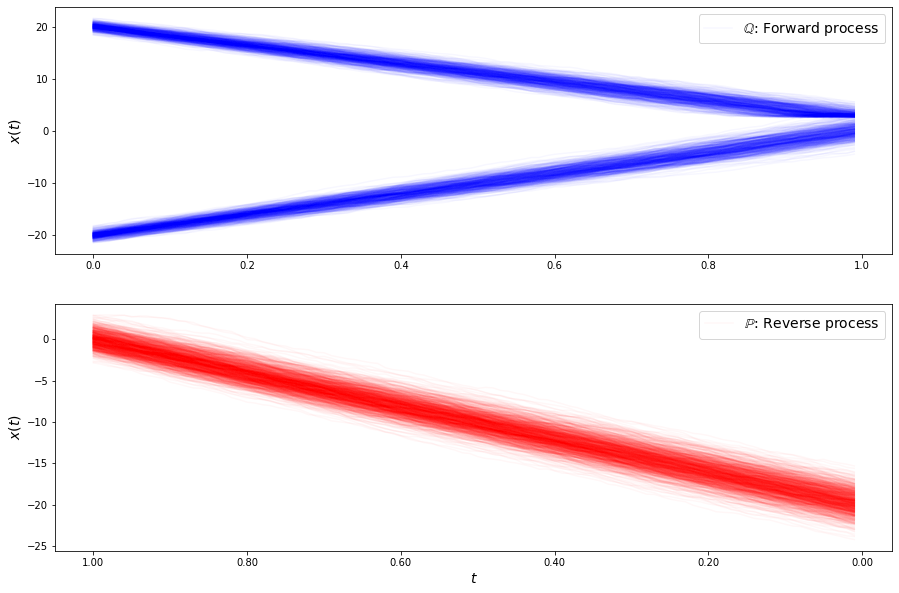

loss b -1.0810436795851388
loss b -1.1493660986362786
loss b -1.0221405779176644
loss b -1.0766118533062896
loss b -1.1905465916269629
loss b -0.9041136903815624
loss b -1.043672988044603
loss b -1.1663053893545168
loss b -1.175641935289172
loss b -0.8637343474849487
loss b -0.9820046904724422
loss b -1.1683668105278355
loss b -1.066962938883885
loss b -1.042400743527509
loss b -0.936936241832205
loss b -1.0357226265598694
loss b -1.048343412057788
loss b -0.9139922850003684
loss b -1.0793202556126726
loss b -1.0287481472501658
loss b -0.8299959927966908
loss b -0.9330692459554527
loss b -1.247302754360024
loss b -1.0329293250477103
loss b -1.02714176203175
loss b -1.1875793153367915
loss b -1.0004396289547675
loss b -0.8264290036346179
loss b -1.0655225100327774
loss b -1.0589127115428043
loss f -0.8437226838460178
loss f -0.5677395660173544
loss f -0.5152485542855877
loss f -0.5738222254250621
loss f -0.8321259053290126
loss f -0.41260061551872307
loss f -0.5239826928250254
loss f -0

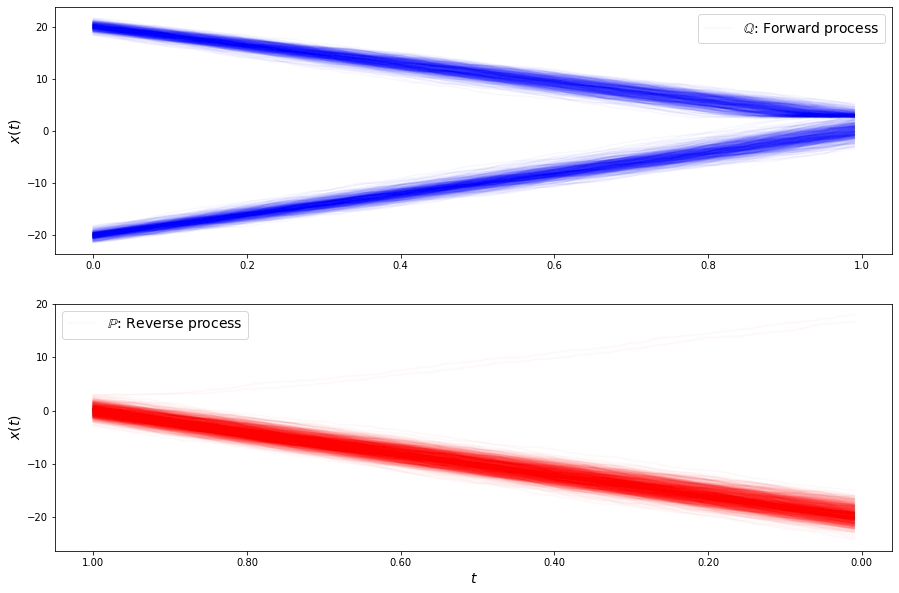

loss b -1.1720399162407864
loss b -1.0279689639724032
loss b -1.0693985110805597
loss b -0.95054504039634
loss b -0.8499679593229647
loss b -0.8000683984961506
loss b -1.0597535723507663
loss b -0.8495875339986307
loss b -0.9660473005005709
loss b -0.8788710361728327
loss b -0.8526612267115137
loss b -0.8680174447086014
loss b -0.9737927406960798
loss b -1.0342361952355845
loss b -1.031402719258653
loss b -0.8447679200845228
loss b -0.9860808963267663
loss b -0.9004148072487538
loss b -0.8798984498153011
loss b -0.9237120967357627
loss b -0.9099843222129239
loss b -0.9495755324147152
loss b -0.850713917854623
loss b -0.9820443786529021
loss b -0.9245099183335325
loss b -0.9362324358617296
loss b -0.8589771375520624
loss b -1.0213765739187253
loss b -0.875867212125234
loss b -1.0108684331932196
loss f -0.5829808033665811
loss f -0.5420186793000221
loss f -0.5684563234422699
loss f -0.6891932119930578
loss f -0.8291633281869882
loss f -0.4562486543788599
loss f -0.6587161332774115
loss f

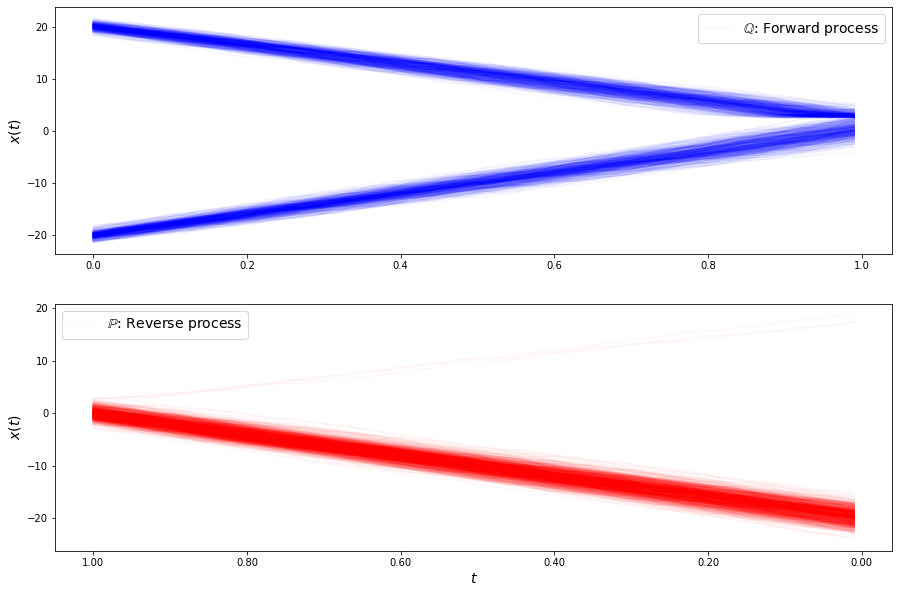

loss b -0.7797372088417404
loss b -0.6983627537727517
loss b -0.9297025930688894
loss b -1.0014117635105066
loss b -1.0488971577081656
loss b -0.9874322918928369
loss b -0.7089398371389197
loss b -0.917860146642789
loss b -0.8132550570273471
loss b -0.9067365917130499
loss b -1.0378895638209393
loss b -0.8315055195251766
loss b -0.7692411910432939
loss b -0.7022910569466758
loss b -0.943245565219075
loss b -0.810234924816942
loss b -0.9596924445034508
loss b -0.7987538460578878
loss b -0.7995823459295625
loss b -1.0524334969643945
loss b -0.6890804852543925
loss b -0.9752386265397428
loss b -0.8719645086064793
loss b -0.9580295294448173
loss b -0.8383853867147383
loss b -0.8712151321607372
loss b -0.8444745656147434
loss b -0.7811302244585064
loss b -0.7651251071003198
loss b -0.8366412979487575
loss f -0.6403428678133255
loss f -0.7761193913173045
loss f -0.36293615857538786
loss f -0.5869724317416126
loss f -0.9852694397001918
loss f -0.5826125281715374
loss f -0.616836549358977
loss

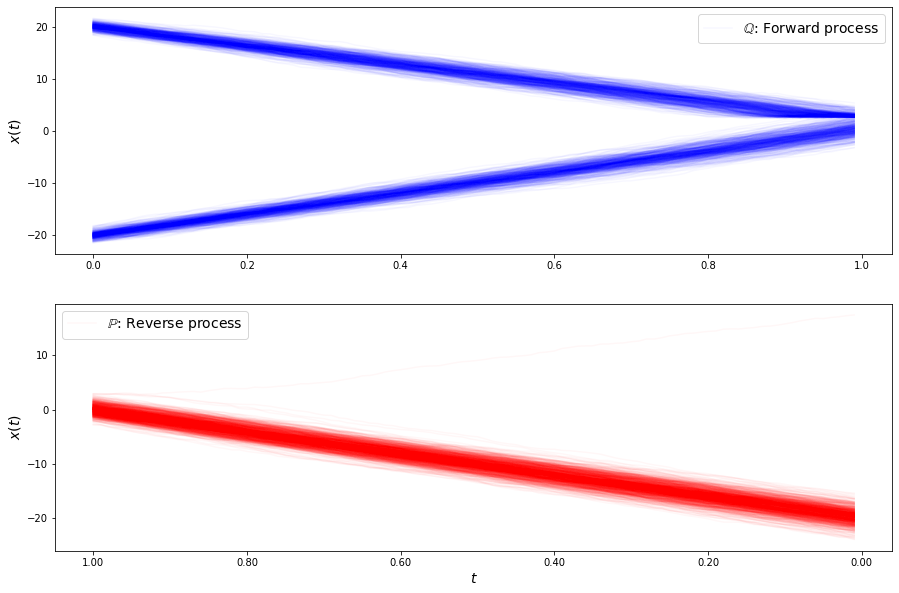

loss b -0.7877548325422622
loss b -0.8038384879773509
loss b -0.958298686508162
loss b -0.7776371443904048
loss b -0.8211799322144016
loss b -0.951084799457755
loss b -0.7667481745600478
loss b -0.7972273146261023
loss b -0.7395339473451571
loss b -0.7116635012698583
loss b -0.865452159564873
loss b -0.8238164583686706
loss b -0.8855531727005034
loss b -0.74838684671729
loss b -0.772909711775832
loss b -0.9861408759971971
loss b -0.7943914824503493
loss b -0.748547967100025
loss b -0.7709435493828869
loss b -1.0447864510352396
loss b -0.8300440723113107
loss b -0.9535815171832241
loss b -0.7007655446375606
loss b -0.8052209138960944
loss b -0.8430930324045105
loss b -0.9960829992092479
loss b -0.7472276147349062
loss b -0.8397508566855137
loss b -0.7038754299664398
loss b -0.9599878725417114
loss f -1.014783068090847
loss f -0.5505124630005759
loss f -0.695875544143548
loss f -0.517413443635399
loss f -0.7397473192798125
loss f -0.7363654688346738
loss f -1.1126936754143022
loss f -0.4

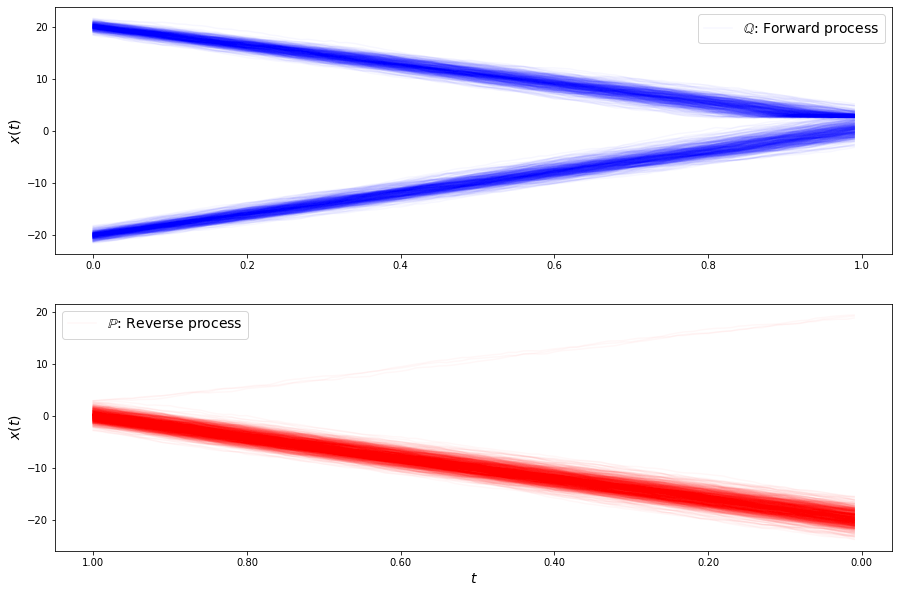

loss b -0.6359903267582446
loss b -0.6532111376606237
loss b -0.7233249102948781
loss b -0.6764669598238205
loss b -0.7211643652454909
loss b -0.8602171339099765
loss b -0.8932584654809749
loss b -0.9131866196380294
loss b -0.6230512895150077
loss b -0.6773516760808573
loss b -0.6545752262092119
loss b -0.8642532552758561
loss b -0.6605001502810474
loss b -0.8546427728740923
loss b -0.9741377096779604
loss b -0.8680636420383927
loss b -0.6341468127084062
loss b -0.9565287755692587
loss b -0.8538005820719051
loss b -0.5408819839775627
loss b -0.8070270613699531
loss b -0.9194837846973182
loss b -0.7349423092900669
loss b -0.8355172843429364
loss b -0.8212255648311284
loss b -0.7571714367449945
loss b -0.8863508329203161
loss b -0.7675534731292506
loss b -1.0008528991119727
loss b -0.9058276091576002
loss f -0.8741106211900173
loss f -0.8797696574817275
loss f -0.5531582284474902
loss f -0.5869502070589451
loss f -0.5898944846752496
loss f -1.0130802545060815
loss f -1.1381051060671248
l

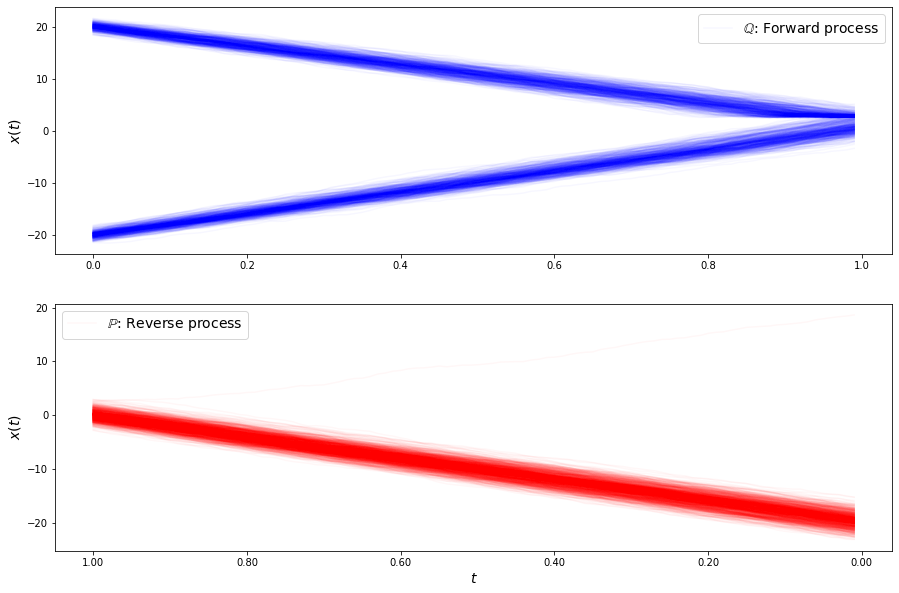

loss b -0.8763146419580145
loss b -0.59404655952855
loss b -0.6495031592472278
loss b -0.9149540040793422
loss b -0.686003351446421
loss b -0.8717948422763686
loss b -0.8041074084091346
loss b -0.6309380516672289
loss b -0.8807832631843424
loss b -0.7050311326216743
loss b -0.8253493611644591
loss b -0.9246555551343923
loss b -0.7599601486497748
loss b -0.8525307451851909
loss b -0.868299032607819
loss b -0.7807614541114619
loss b -0.878595537473264
loss b -0.8245950515469632
loss b -0.6471422137307428
loss b -0.7079829019506187
loss b -0.7147661978321094
loss b -0.9205693758803966
loss b -0.7226743995979279
loss b -0.823301614018056
loss b -0.8020076419638189
loss b -0.8355911846866286
loss b -0.8091975137868166
loss b -0.8250227838858389
loss b -0.8971746058776039
loss b -0.7539159709406287
loss f -0.8821143176366119
loss f -0.5467422415832356
loss f -0.7476627436802292
loss f -0.9989954305250165
loss f -1.3477023801772845
loss f -0.8863891379083257
loss f -0.9270969373010681
loss f 

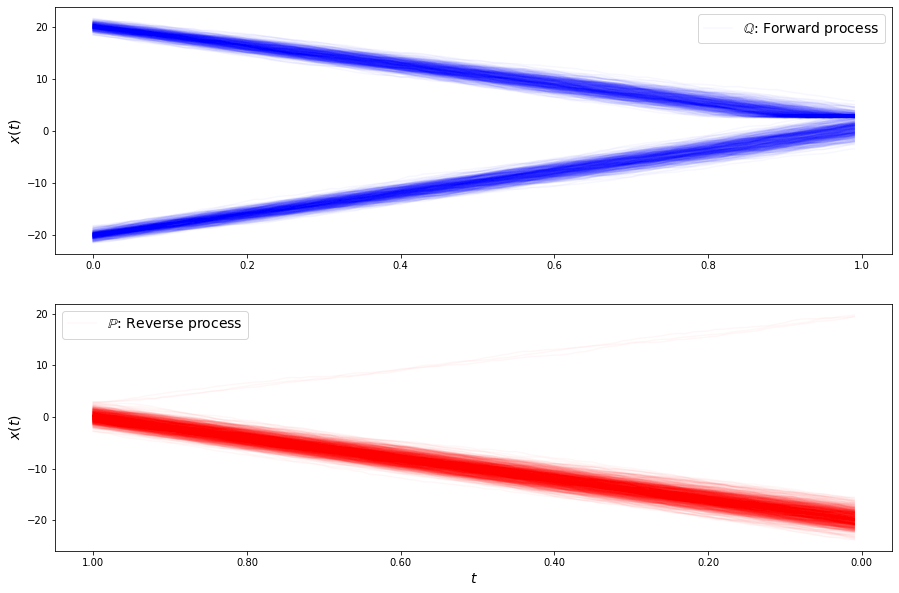

loss b -0.6834877631805326
loss b -0.8862391992247941
loss b -0.871532300673425
loss b -0.846880197331036
loss b -0.8696013315277659
loss b -0.8973143781727597
loss b -0.6273645216408262
loss b -0.7120879820223651
loss b -0.6392401668052677
loss b -0.7763425910661206
loss b -0.7595601626351409
loss b -0.7100571437158706
loss b -0.5094898957472865
loss b -0.7756592249703402
loss b -0.867460332946074
loss b -0.8482174893589103
loss b -0.7378750712935799
loss b -0.7890929917058798
loss b -1.0643860025310508
loss b -0.981717022515007
loss b -0.8753691180401915
loss b -0.871800218084087
loss b -0.8088037627927872
loss b -0.8149663240841307
loss b -0.8197165073854187
loss b -0.9172495106023429
loss b -0.8798027693508594
loss b -0.9110631973724013
loss b -0.8585089755486366
loss b -0.8891640988343597
loss f -0.8084091133858414
loss f -1.2176577669954451
loss f -1.067763790992568
loss f -0.8883030497591305
loss f -0.9277008802726318
loss f -1.0887818833083402
loss f -0.8681666276820598
loss f 

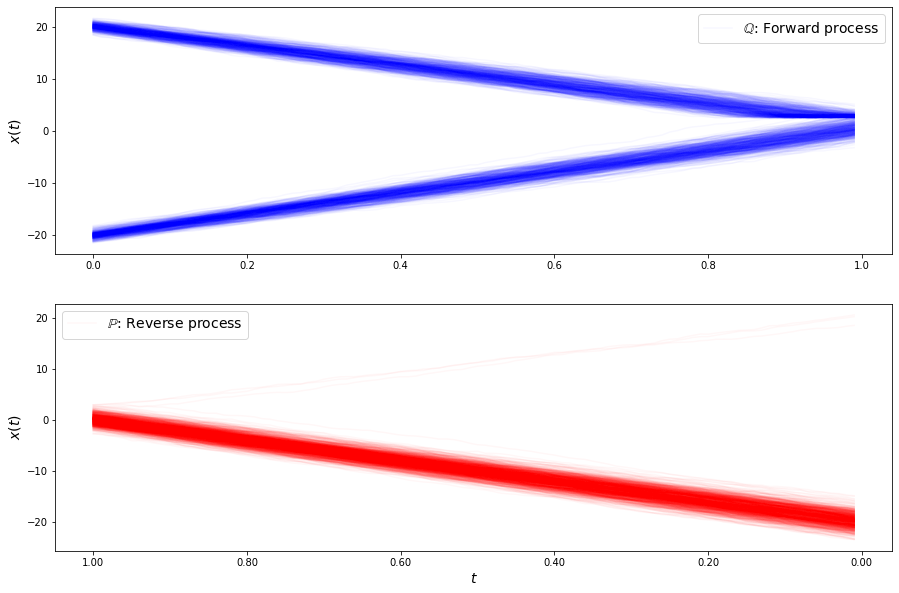

loss b -0.872239051474906
loss b -0.8132974508224181
loss b -0.8285214811310517
loss b -0.7097122445540545
loss b -0.7805742102658484
loss b -0.9078887986246315
loss b -1.034946445176009
loss b -0.8389512449584762
loss b -0.8358262974447505
loss b -0.8890855899348973
loss b -0.7339340247764053
loss b -0.9118571158653505
loss b -0.8410488022206831
loss b -0.8188991253122685
loss b -0.8815307364971693
loss b -0.7882250688557071
loss b -0.9900053364511817
loss b -0.9202587311207759
loss b -0.981584203135131
loss b -1.0171071421884639
loss b -0.8795816429659918
loss b -0.5963127298282386
loss b -0.912617679225155
loss b -0.8717352251476288
loss b -0.8258162193053702
loss b -0.879019274756838
loss b -0.8115923591566224
loss b -0.8519098455157821
loss b -0.917580264936966
loss b -0.888709722571793
loss f -1.084130332253179
loss f -1.5531026278957578
loss f -1.2157259307777468
loss f -1.1706341065105117
loss f -0.9545387658025668
loss f -1.4671790133660263
loss f -0.8683069932529315
loss f -1

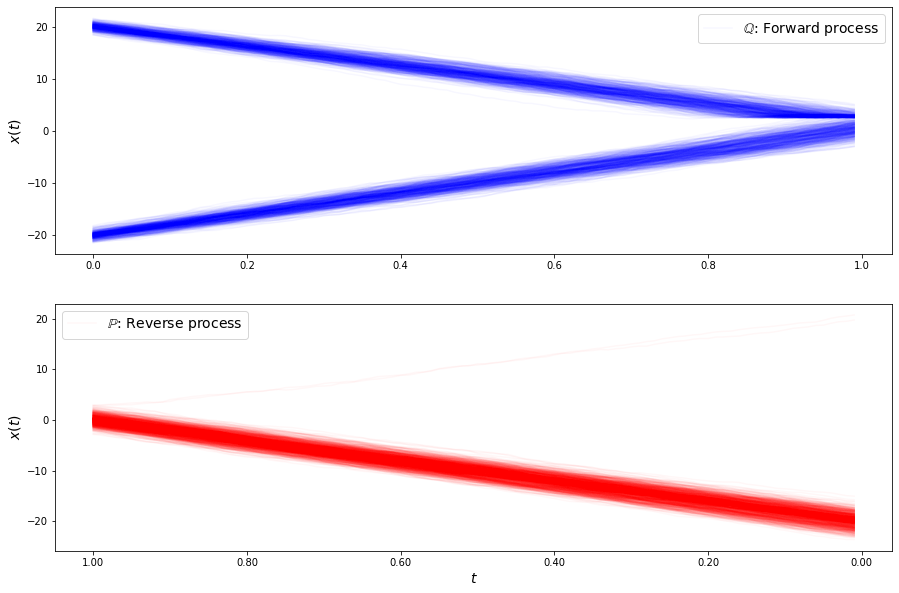

loss b -0.7410850829357392
loss b -0.884112143130188
loss b -1.0212474020843945
loss b -0.8647974738331172
loss b -0.9001850498395754
loss b -0.8562839282839566
loss b -0.856546632418325
loss b -0.9289328404021732
loss b -0.8151871932968384
loss b -1.0024918638042655
loss b -0.9010155818883175
loss b -0.8419771688819966
loss b -0.9298066939084197
loss b -0.9432636508992029
loss b -0.9255606160623469
loss b -0.8040982029590197
loss b -0.9676094933524271
loss b -0.8917113041178778
loss b -0.9544817063471571
loss b -1.083582714306999
loss b -0.9863251500143649
loss b -0.9078749144419969
loss b -0.8677709083604653
loss b -0.8784868938728286
loss b -1.053013948319821
loss b -1.0223944043433975
loss b -0.8302171622781512
loss b -1.1631210102799039
loss b -1.1014281956531335
loss b -1.0359859134747722
loss f -1.5479830984104328
loss f -1.6798641905862803
loss f -1.4605986558534307
loss f -1.887685345463461
loss f -1.5106722130065642
loss f -1.5917473114720118
loss f -1.0566296932909918
loss f

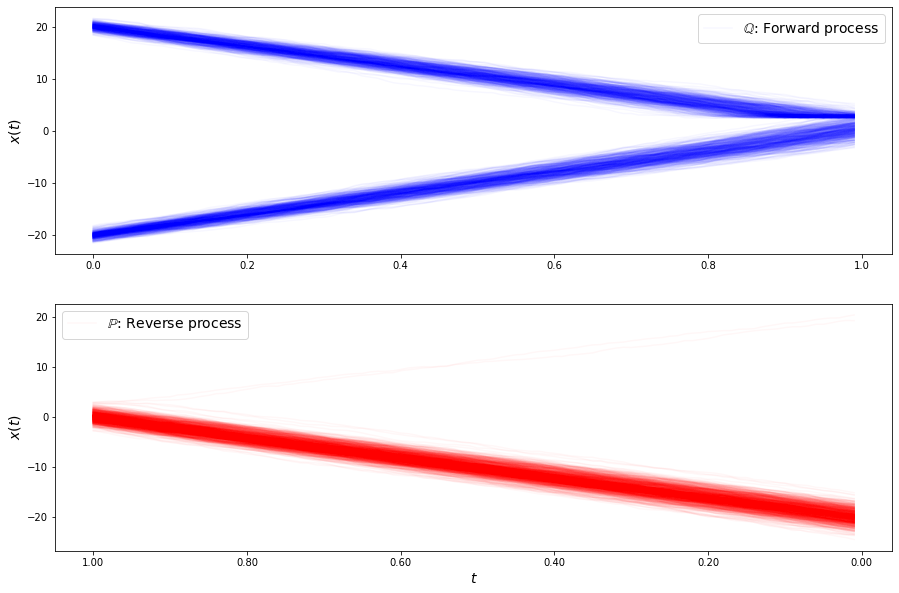

loss b -0.9727882748644093
loss b -0.9698106325043104
loss b -0.9344341276506488
loss b -1.0118231618705302
loss b -0.9239998646161376
loss b -0.9979752331083479
loss b -0.8001933177473793
loss b -1.0163453823609332
loss b -1.072725090219007
loss b -0.8181220550476025
loss b -0.9159121156873636
loss b -1.0864606301496234
loss b -1.0672209269847655
loss b -0.9215770772555771
loss b -0.998539072831835
loss b -1.1771565736163676
loss b -1.0158523958038552
loss b -1.2134359076357568
loss b -1.0015960504477897
loss b -0.9485554852727008
loss b -1.0510094353526211
loss b -1.0068879645957816
loss b -0.9592393832639743
loss b -1.0575721647803704
loss b -1.0479970725937144
loss b -0.9670930317792317
loss b -0.9432138180932937
loss b -1.0415572249379064
loss b -1.091194262653192
loss b -1.0193643043283118
loss f -1.5841192680832255
loss f -2.025892354083749
loss f -1.5040213019306778
loss f -1.3850466855858112
loss f -1.3358522922134513
loss f -1.6930190977644022
loss f -1.5995361964361459
loss 

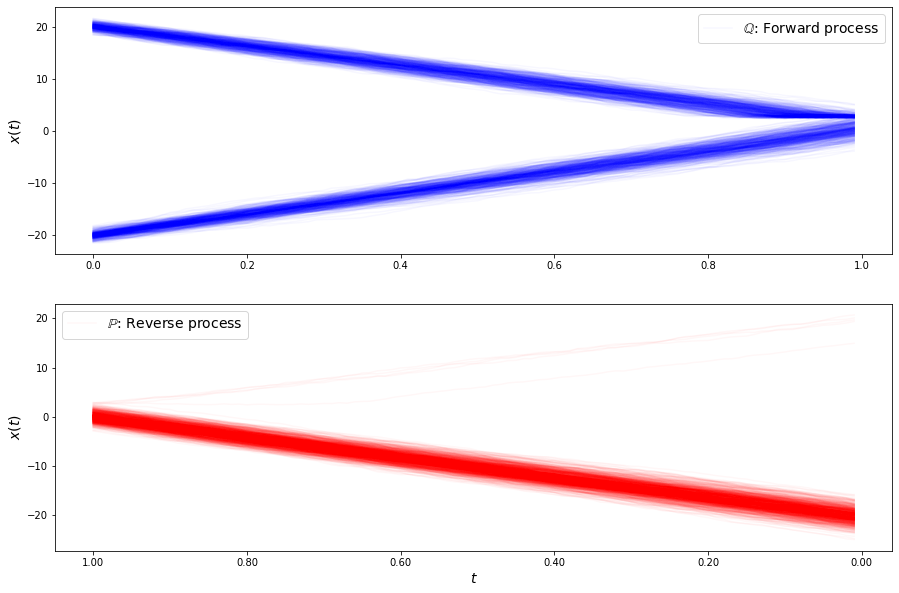

loss b -1.0775846610777418
loss b -0.8977062363559153
loss b -0.9106620358257332
loss b -0.8561720159227627
loss b -1.0915639946536881
loss b -1.096305461119174
loss b -0.9318238104932143
loss b -0.9540117859275594
loss b -1.137276760168984
loss b -0.8207144504749788
loss b -0.9405378270479245
loss b -0.903158819724317
loss b -0.9265062341371388
loss b -0.967448685418149
loss b -0.9165494484815652
loss b -0.9234918133385863
loss b -0.6422552731675373
loss b -0.8769092390541691
loss b -1.0844440906272177
loss b -0.7848465449614682
loss b -0.843084223016461
loss b -0.8656317082258266
loss b -0.8456206868263442
loss b -1.0681158292615587
loss b -0.750002366466103
loss b -0.8977660200888029
loss b -0.9252831672762506
loss b -0.9809647432107754
loss b -0.877939549219806
loss b -0.7410643511015809
loss f -1.7688863731179383
loss f -1.798535145832528
loss f -1.9668848412503395
loss f -1.3707476050561869
loss f -1.7008327691478506
loss f -1.6823357930601603
loss f -1.5500995333655603
loss f -1

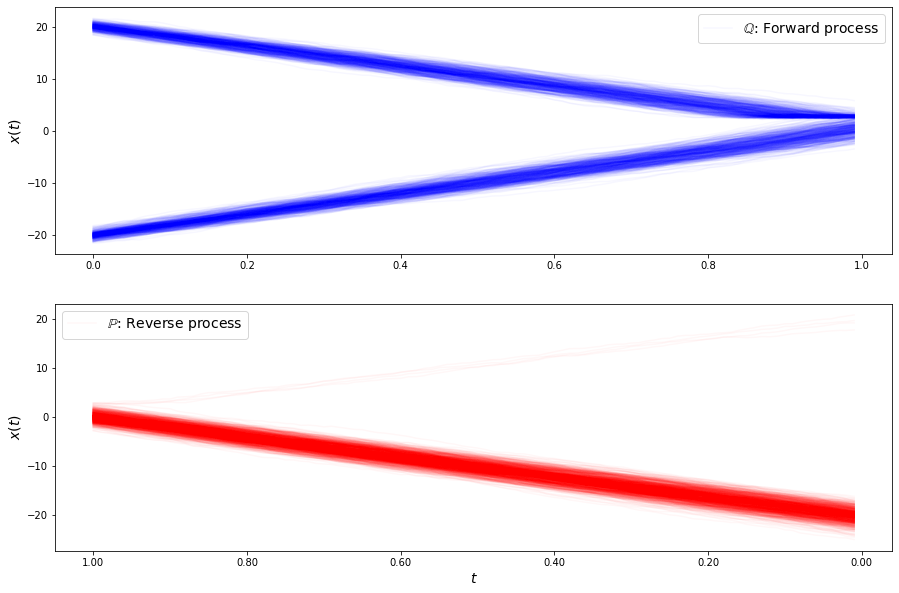

loss b -1.0901106124839846
loss b -0.9641269365189338
loss b -0.7562194596259175
loss b -0.8409457238208048
loss b -0.7789305793318618
loss b -0.9109601305949188
loss b -0.8934429836070158
loss b -1.0196600377630811
loss b -0.9745588529367765
loss b -0.9191515766647906
loss b -0.8541280754828057
loss b -1.0009582355782376
loss b -0.7688380352406943
loss b -0.5849093418809799
loss b -0.9589487693949269
loss b -0.9421239094777079
loss b -0.860164040368657
loss b -0.8229590711508805
loss b -0.8954251270957223
loss b -0.8676270769384707
loss b -0.8186366332069195
loss b -0.7998013502114658
loss b -0.7591867038779072
loss b -0.7386993906771908
loss b -0.9260337940474027
loss b -0.8138806192235164
loss b -0.7222232930986588
loss b -0.9444306621095696
loss b -0.736392893216994
loss b -0.7523175174267949
loss f -1.6679067674670158
loss f -1.8895419503380741
loss f -1.4257159969108606
loss f -1.9743248151005757
loss f -1.440134671511926
loss f -1.6524931178804836
loss f -1.5551529996332816
loss

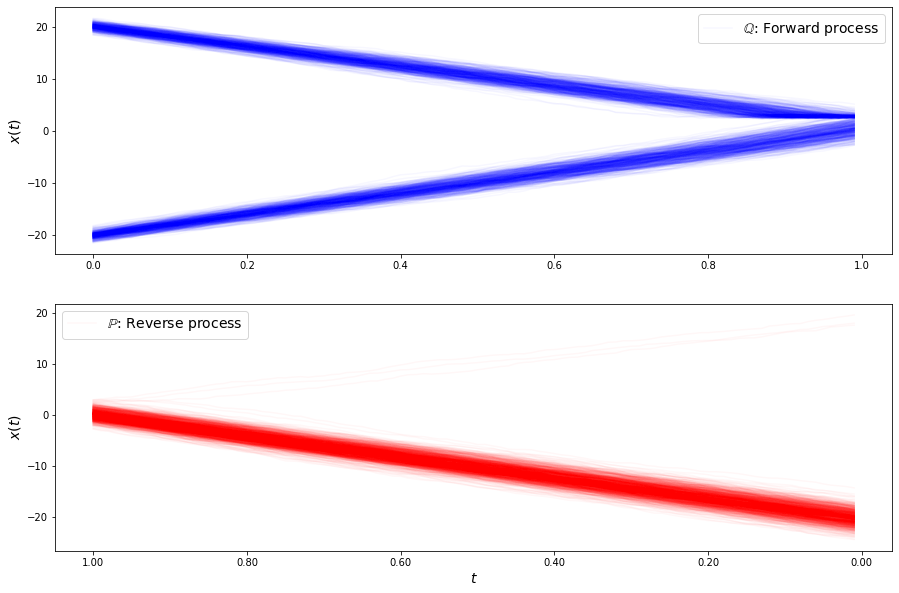

loss b -0.7314382601292408
loss b -0.8589031977691993
loss b -0.6488915332613376
loss b -0.8079891177763348
loss b -0.8912826416313216
loss b -0.8069129455771313
loss b -0.8940147655341765
loss b -0.8014458676639432
loss b -0.7397361938151399
loss b -0.7841550065794893
loss b -0.8474547288764316
loss b -0.6734653295916019
loss b -0.6961995004280688
loss b -0.7216431580854908
loss b -0.7606282391458246
loss b -0.7379299227689777
loss b -0.8787874377145186
loss b -0.7452901530351419
loss b -0.6551405129325195
loss b -0.9093505111361058
loss b -0.9023353836815007
loss b -0.7138853827626715
loss b -0.860364761380303
loss b -0.8185898114224011
loss b -0.6018683607805564
loss b -0.6259953889536408
loss b -0.7776314302847144
loss b -0.6806672104874666
loss b -0.6105323661246513
loss b -0.6727417698072047
loss f -2.0876414748212455
loss f -2.178026786733617
loss f -2.141582215348562
loss f -1.7207095035143636
loss f -2.1940498869333385
loss f -2.238104627155023
loss f -1.8149310103224783
loss 

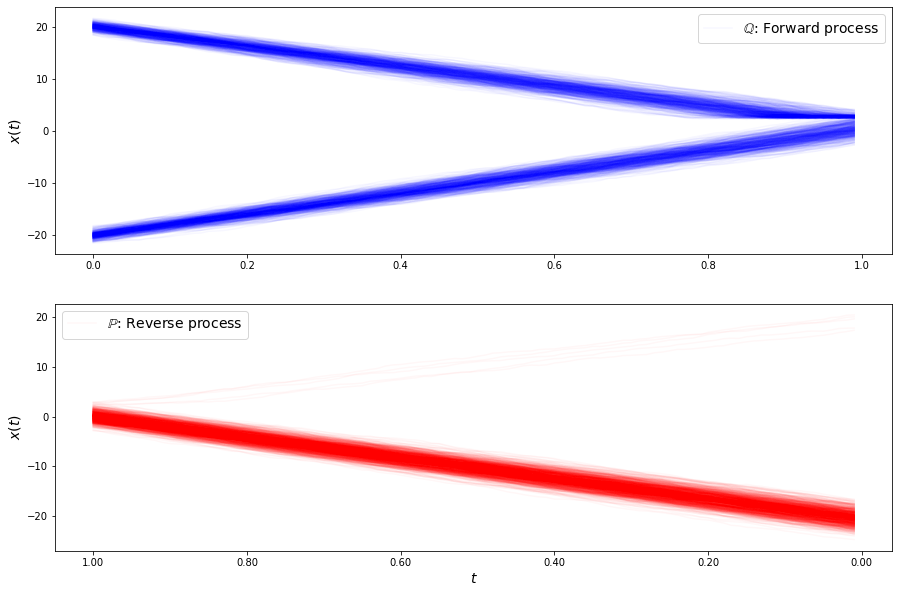

loss b -0.7756020773918745
loss b -0.7784312757760626
loss b -0.9056198876410501
loss b -0.6870658258013589
loss b -0.6497966218830475
loss b -0.7633868688111953
loss b -0.538604717671598
loss b -0.6801353931661989
loss b -0.7790205929955875
loss b -0.7464432484268411
loss b -0.6195322576105469
loss b -0.5153987278942431
loss b -0.5604605110425271
loss b -0.6925609776487944
loss b -0.8138774466980088
loss b -0.6204671248344698
loss b -0.6597180968385505
loss b -0.5833893515765193
loss b -0.7090054630064138
loss b -0.6341587055871801
loss b -0.6081423100724607
loss b -0.6698085244273088
loss b -0.5960219583591476
loss b -0.6247181795695806
loss b -0.6896086932428809
loss b -0.6719401209302301
loss b -0.7317369185770823
loss b -0.42754979669412574
loss b -0.6343726933035649
loss b -0.37004557808766353
loss f -2.2264599186343776
loss f -2.0313772863650743
loss f -2.0628899968617707
loss f -2.1767552805883787
loss f -1.983906215721126
loss f -2.0454418990680807
loss f -2.7007521996650867
l

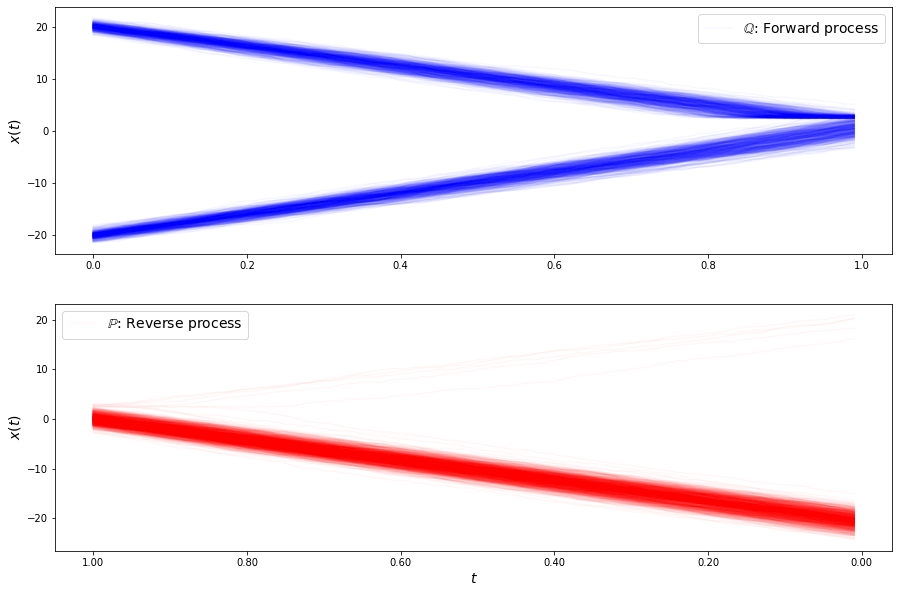

loss b -0.5621160971302349
loss b -0.6921166276844652
loss b -0.6901238016770873
loss b -0.5533893402306156
loss b -0.5381489165248289
loss b -0.5101433830595408
loss b -0.6802855937279796
loss b -0.7030072435717714
loss b -0.49100668175994633
loss b -0.48699318403114705
loss b -0.4368784363807196
loss b -0.5402903772943931
loss b -0.5173464644660306
loss b -0.5979188909442135
loss b -0.5524000492010529
loss b -0.7733614146639972
loss b -0.4786000508453103
loss b -0.6376914416373666
loss b -0.6567755369021179
loss b -0.5294662236410608
loss b -0.5079750643428038
loss b -0.5503531248656875
loss b -0.7251556662279246
loss b -0.3894236234658844
loss b -0.551155923835934
loss b -0.41366960964554916
loss b -0.45841184265505985
loss b -0.5143645476264858
loss b -0.4684873528665114
loss b -0.40640153443953664
loss f -2.54102559401228
loss f -2.96896111343829
loss f -2.2757697061881927
loss f -2.451519365674402
loss f -2.6653134876852884
loss f -2.6675678533475975
loss f -2.4392130241743213
lo

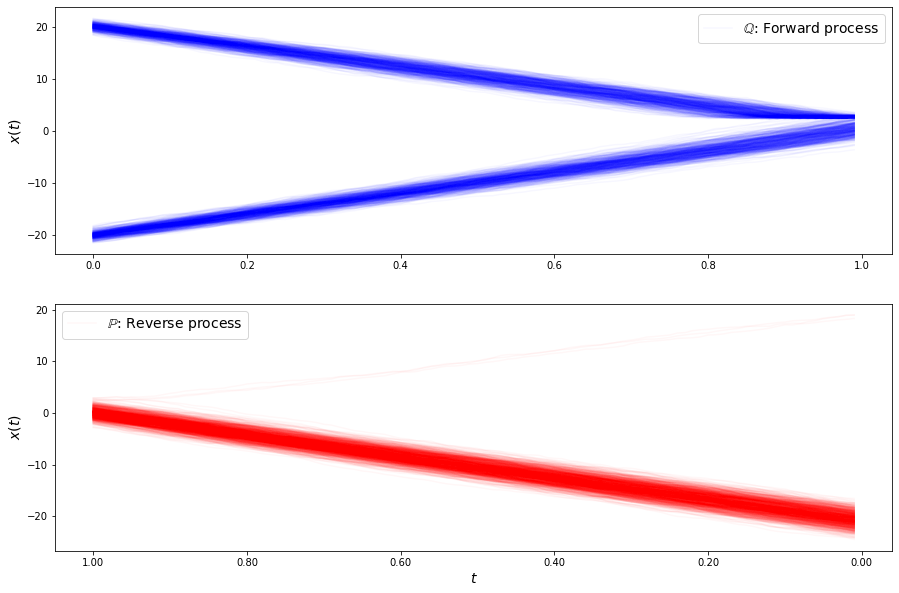

loss b -0.6530290854416917
loss b -0.4578431855102118
loss b -0.549092670409605
loss b -0.5274845036667111
loss b -0.5140436014365218
loss b -0.43522883231634646
loss b -0.509558905979946
loss b -0.7172479812961416
loss b -0.5992563606208282
loss b -0.508311296098347
loss b -0.40945463801702126
loss b -0.40534189416355393
loss b -0.5098285428165595
loss b -0.5946010046826146
loss b -0.4385667019871625
loss b -0.6004104753611317
loss b -0.47127980514860085
loss b -0.47406766576484327
loss b -0.5137860123124702
loss b -0.404430712068146
loss b -0.46625459330634333
loss b -0.5523050306403559
loss b -0.26740104202426046
loss b -0.3354641545607052
loss b -0.5388278233121864
loss b -0.525727963129087
loss b -0.5354929452701767
loss b -0.43886294454547087
loss b -0.5233311758202004
loss b -0.6133711085049317
loss f -2.655836340080208
loss f -2.2192720363470486
loss f -2.4673796018166825
loss f -3.0903748343201305
loss f -2.656709575868914
loss f -2.0227034091294613
loss f -3.137548390224126
l

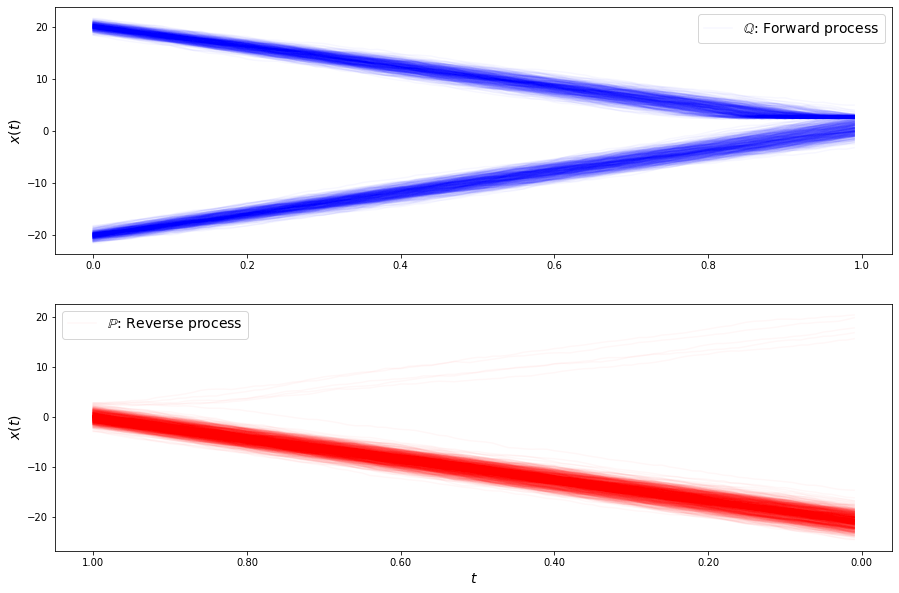

loss b -0.4428145164906447
loss b -0.3744788900893654
loss b -0.47124452048967325
loss b -0.36205419269947736
loss b -0.41794140910455574
loss b -0.6451992473160755
loss b -0.4782551476381858
loss b -0.5300833948902237
loss b -0.39781222921852044
loss b -0.47048903267640074
loss b -0.3603272855257448
loss b -0.5391482103124362
loss b -0.44841413749145964
loss b -0.4815222901384672
loss b -0.486223680601685
loss b -0.6011755249725759
loss b -0.44885816975133863
loss b -0.3300709047088847
loss b -0.4473155020858432
loss b -0.4058919907337379
loss b -0.5040704570517737
loss b -0.3732374386030185
loss b -0.3639629204626343
loss b -0.41180344003389696
loss b -0.5051412304209489
loss b -0.4186923261271115
loss b -0.5292442037565164
loss b -0.4860263853245038
loss b -0.3270658201393806
loss b -0.3619584522342271
loss f -3.4289865721652886
loss f -2.804600136451124
loss f -2.7773756363008153
loss f -3.552036582554282
loss f -3.337712313327406
loss f -2.3384964252659026
loss f -2.66025245468749

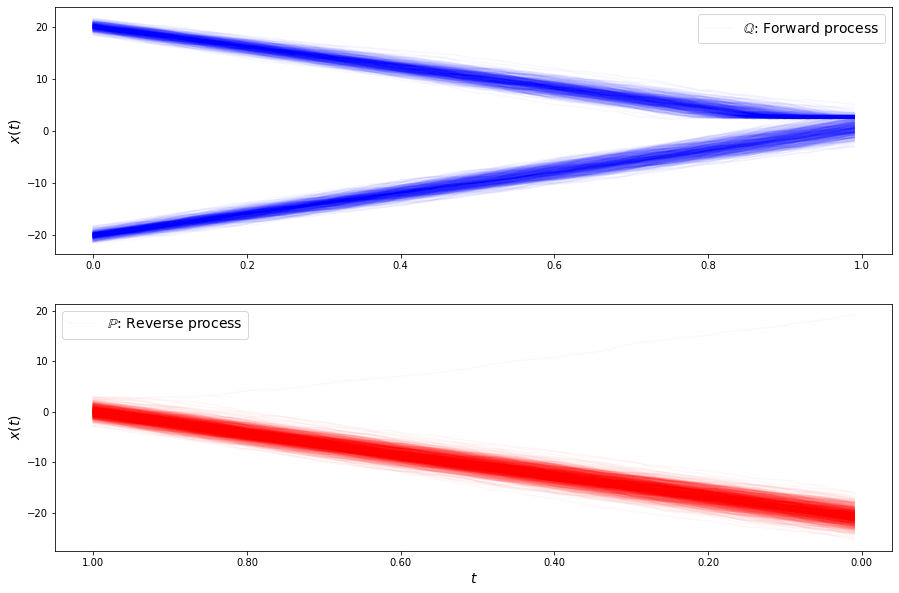

loss b -0.3454375245188084
loss b -0.3799732870839649
loss b -0.39084559017912335
loss b -0.5837209154182927
loss b -0.39771517642051696
loss b -0.4753892783091813
loss b -0.3961181780297415
loss b -0.354392036174548
loss b -0.37326693443743175
loss b -0.4829545422822739
loss b -0.31627054754771433
loss b -0.4875204468157328
loss b -0.49188148409086346
loss b -0.33462808224995494
loss b -0.3975329777321605
loss b -0.7055580440994678
loss b -0.42288510091444925
loss b -0.33108008769832276
loss b -0.38740105904087707
loss b -0.49707872239108875
loss b -0.4270376385341548
loss b -0.5476735408699362
loss b -0.37196157735385316
loss b -0.3019497999083822
loss b -0.3142497391037533
loss b -0.3790418095353388
loss b -0.4201962449124984
loss b -0.3951199754588362
loss b -0.2842806684988984
loss b -0.42822356593986677
loss f -3.6469722069049983
loss f -2.9192117733139944
loss f -3.186870948822584
loss f -2.715110977505609
loss f -2.8863204596166367
loss f -3.115576505200108
loss f -2.2972169217

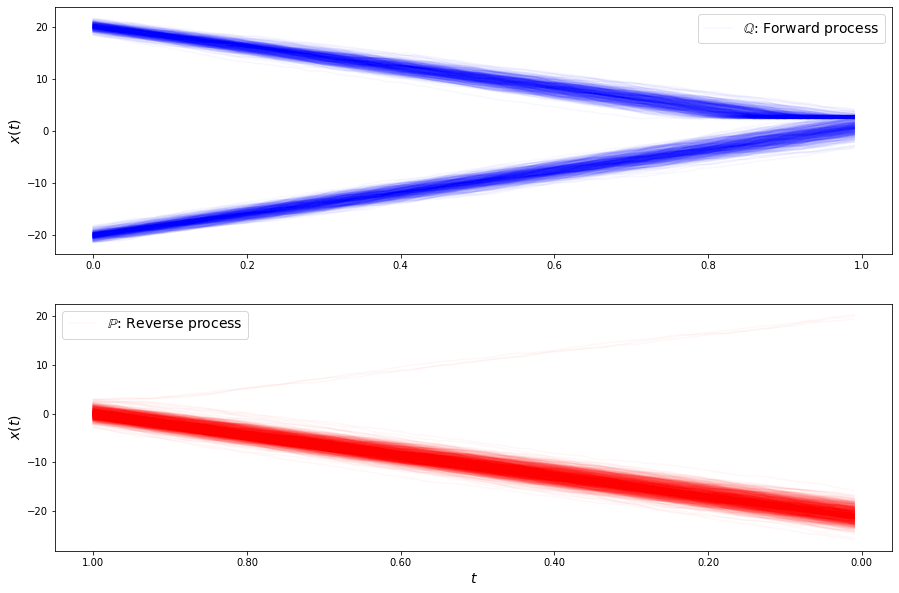

loss b -0.507721214467458
loss b -0.47737310157387547
loss b -0.3901804781013824
loss b -0.4491609797222477
loss b -0.37791204646819826
loss b -0.42137002452658484
loss b -0.3904343389067749
loss b -0.2906320486873
loss b -0.4582553870805523
loss b -0.31341247323623006
loss b -0.3531545311377669
loss b -0.3715723765885828
loss b -0.2735513120325295
loss b -0.44659099571729954
loss b -0.45058700518142497
loss b -0.47369223099231994
loss b -0.5757442210338751
loss b -0.45100068520710973
loss b -0.4467958903396265
loss b -0.4777395787808877
loss b -0.3673926937222918
loss b -0.48141713061206975
loss b -0.3722915167682909
loss b -0.41512207266098833
loss b -0.23709124385328545
loss b -0.345643583181398
loss b -0.4441945033877364
loss b -0.5110692576066068
loss b -0.3987156724663686
loss b -0.4106843211305752
loss f -3.1137684252626436
loss f -3.724934111913535
loss f -3.2719231526589656
loss f -3.3284354403179326
loss f -3.1997563288304742
loss f -2.8390499876087283
loss f -3.7011251255219

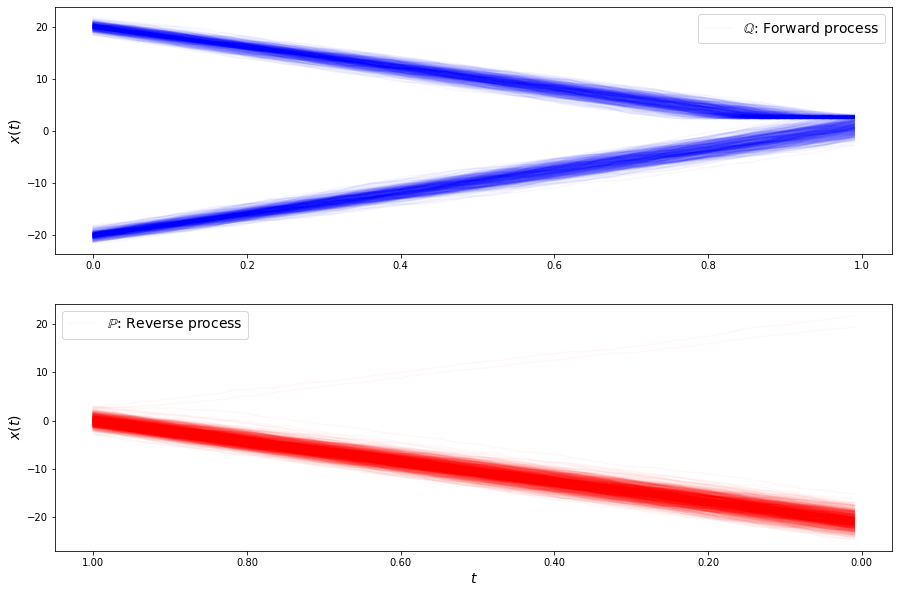

loss b -0.44811458345399796
loss b -0.3774570805476854
loss b -0.48553774924779347
loss b -0.40722921014400787
loss b -0.37336159092376775
loss b -0.3794957876533789
loss b -0.3677702868904627
loss b -0.5047474534613128
loss b -0.36086323740785997
loss b -0.24376814900085325
loss b -0.23399766831540908
loss b -0.24940476580397605
loss b -0.46162734804118216
loss b -0.3603808538913676
loss b -0.3709835641379249
loss b -0.34516267166555925
loss b -0.43706167584348227
loss b -0.4643830377589435
loss b -0.20909413725521492
loss b -0.4029769437275639
loss b -0.3529293442382174
loss b -0.5259560759550951
loss b -0.13819503300922348
loss b -0.2867263661159448
loss b -0.5486100663956307
loss b -0.3835801784144388
loss b -0.4853831803269785
loss b -0.3392274019866746
loss b -0.34166348977073013
loss b -0.377509897146741
loss f -3.885169698337744
loss f -3.031959334405871
loss f -3.4816694751183497
loss f -3.6265938903285355
loss f -3.771998231934424
loss f -3.6898671607530344
loss f -4.00855667

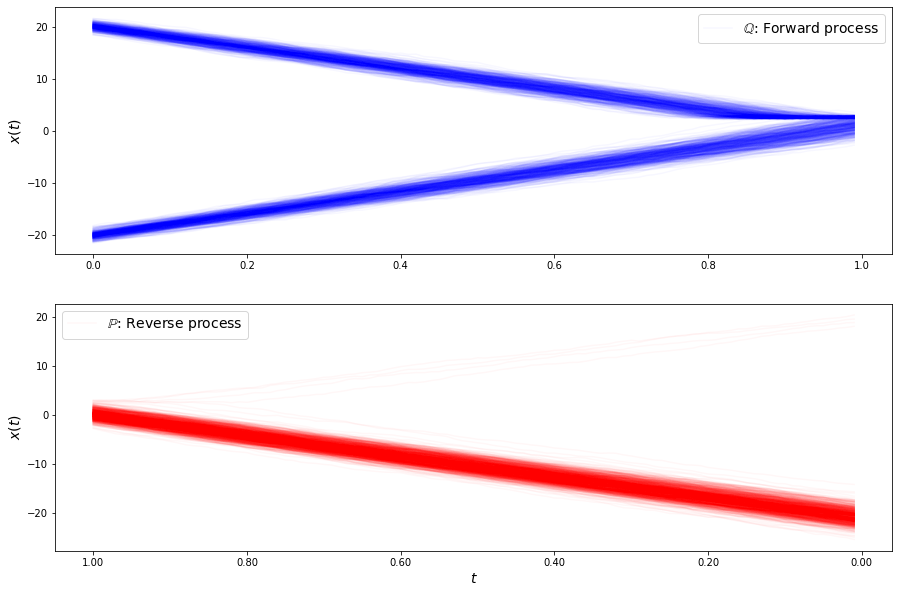

loss b -0.3776476636642137
loss b -0.2810606111315244
loss b -0.3174523953006685
loss b -0.3488677637141198
loss b -0.3470334668890725
loss b -0.421908926177341
loss b -0.30032825140266733
loss b -0.35768900343779164
loss b -0.4435803765323638
loss b -0.35175530041693415
loss b -0.3511677481828781
loss b -0.48474659992512176
loss b -0.2853198865729099
loss b -0.23771722720565716
loss b -0.3732768827101827
loss b -0.49812615613699135
loss b -0.5010624861259075
loss b -0.4198858774903042
loss b -0.42756581752193845
loss b -0.40181991619001567
loss b -0.4015154226782799
loss b -0.42654148255866847
loss b -0.2596611358994711
loss b -0.4408800429752797
loss b -0.31253174672275374
loss b -0.31239036394125974
loss b -0.3257732993948897
loss b -0.47167324933830856
loss b -0.33362215022422165
loss b -0.4336611610193121
loss f -4.156577902492623
loss f -4.2442313262597615
loss f -4.395126589410205
loss f -3.4965301154555086
loss f -3.7748862625453037
loss f -4.470068162857363
loss f -3.731567644

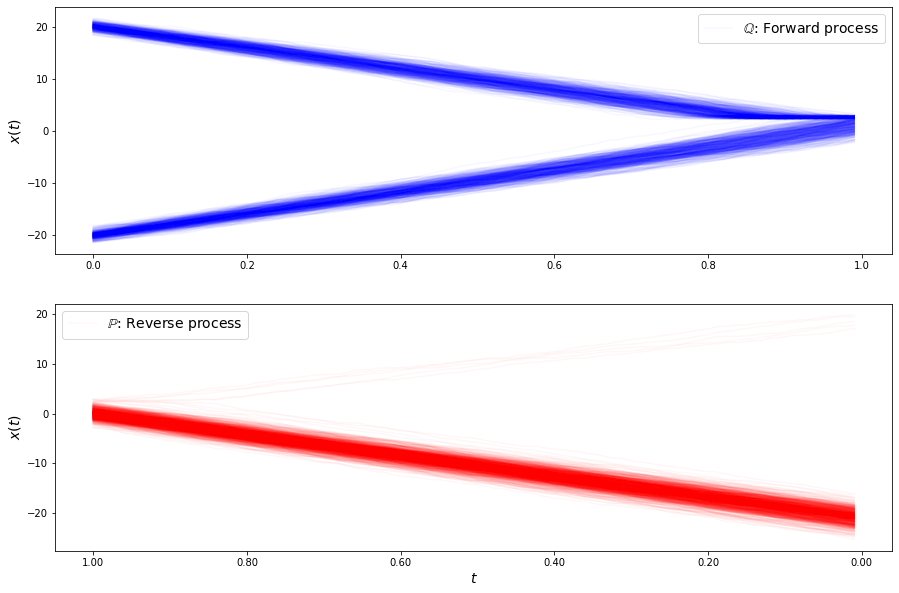

loss b -0.3555727465466703
loss b -0.24966344277429814
loss b -0.3662452754019809
loss b -0.35791206033280615
loss b -0.20563252528203677
loss b -0.2452404066378053
loss b -0.3639529320063901
loss b -0.5311905856869613
loss b -0.3002900419437116
loss b -0.38076199340056266
loss b -0.42097447415950645
loss b -0.5690929188095126
loss b -0.37043431380734176
loss b -0.33235577860223614
loss b -0.35458541631955576
loss b -0.41738715712557944
loss b -0.3609860632506218
loss b -0.43207248498853046
loss b -0.43556090788727136
loss b -0.28219713984277667
loss b -0.47012277525064317
loss b -0.3134336945661515
loss b -0.29307485478160633
loss b -0.42334701658787743
loss b -0.3174787007651734
loss b -0.3150443867150434
loss b -0.3646080677612784
loss b -0.6368876072938834
loss b -0.4004035273386363
loss b -0.40380554436818267
loss f -4.381090141984546
loss f -3.5548470697802497
loss f -4.4918878390694505
loss f -4.500071600587803
loss f -2.2839406966264058
loss f -4.526965496811089
loss f -3.67978

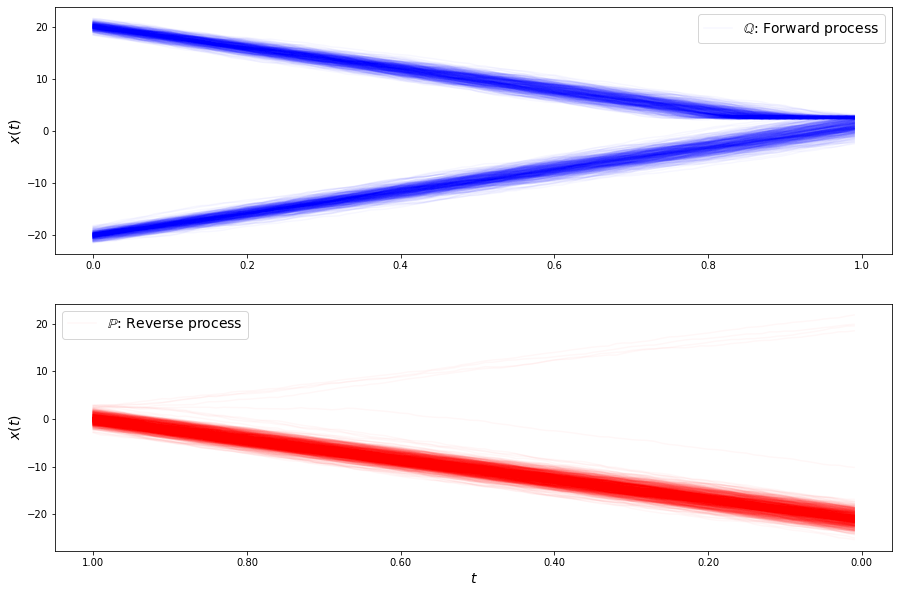

loss b -0.39930004889284815
loss b -0.27167806811982936
loss b -0.3161310895519787
loss b -0.31250659886349486
loss b -0.24395441902522322
loss b -0.42424165610487635
loss b -0.44049583974109585
loss b -0.34545092428709157
loss b -0.39525294333830474
loss b -0.3826093828624371
loss b -0.3750431856552466
loss b -0.4640941655454176
loss b -0.32402985202798495
loss b -0.4254925904764476
loss b -0.4128262509184228
loss b -0.25140337018839143
loss b -0.32522202287142576
loss b -0.3722571880565282
loss b -0.3305069994230295
loss b -0.2932076574103794
loss b -0.2796284170494828
loss b -0.30483085214289674
loss b -0.3577191163301694
loss b -0.47972889009670716
loss b -0.1802989786288613
loss b -0.3085655458444657
loss b -0.28069509681649946
loss b -0.21951961580918525
loss b -0.4744031394928239
loss b -0.2800923737467421
loss f -3.6190382210883745
loss f -4.091487643868695
loss f -3.8872964798635743
loss f -4.710870210544111
loss f -4.475084642376415
loss f -3.5529254437272644
loss f -4.532436

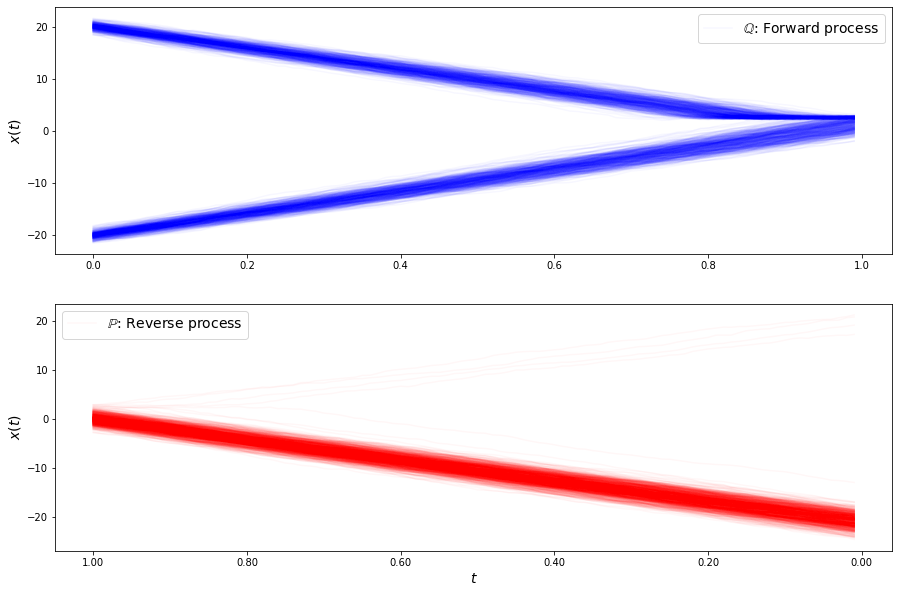

loss b -0.3313111952113775
loss b -0.16704310974318376
loss b -0.2471419305186345
loss b -0.13867549995289122
loss b -0.3269186219087748
loss b -0.385080700727559
loss b -0.34320288802778365
loss b -0.33966202147832397
loss b -0.22431278438001873
loss b -0.42663712745354004
loss b -0.29239629864649824
loss b -0.2550051303416809
loss b -0.3762142226601178
loss b -0.43312906639525106
loss b -0.23190005193384702
loss b -0.3512356083324108
loss b -0.3337221695086236
loss b -0.16727236407904458
loss b -0.22804091924419656
loss b -0.17750016303094943
loss b -0.44751747579872775
loss b -0.4239047546787846
loss b -0.2013646124960198
loss b -0.2539616949522652
loss b -0.1753370508766446
loss b -0.35445950738432525
loss b -0.31693101888985137
loss b -0.18644536844775647
loss b -0.3412844147311458
loss b -0.21320120745277785
loss f -4.558872670469794
loss f -3.8110007106252723
loss f -4.517087845560676
loss f -4.527688814528942
loss f -4.483986246332528
loss f -4.03661766570665
loss f -4.60362546

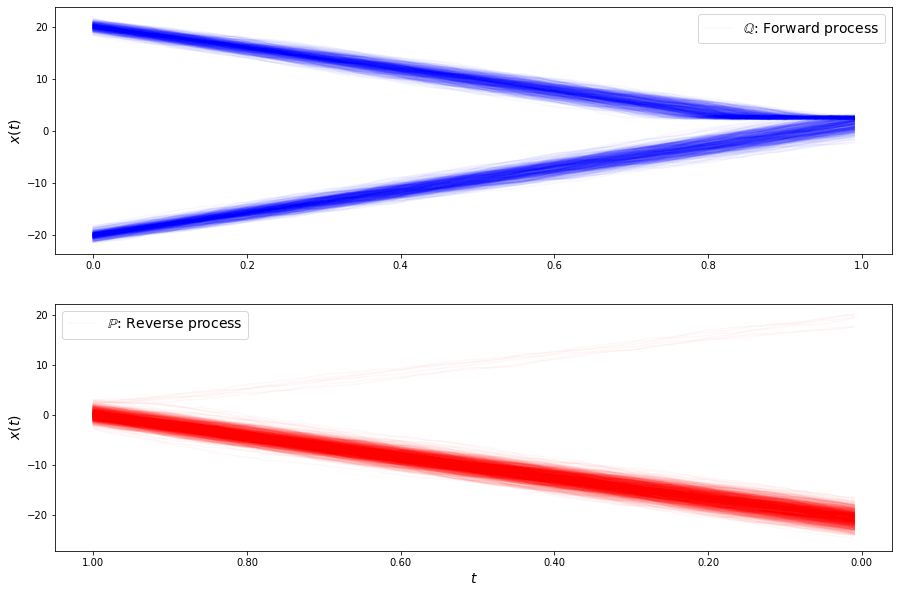

loss b -0.47046876540993304
loss b -0.403001802833083
loss b -0.40242640676949853
loss b -0.30310103592146115
loss b -0.35178904638593284
loss b -0.22023676108859197
loss b -0.2093669864787339
loss b -0.12515271908492
loss b -0.3017336946224796
loss b -0.29792907264432045
loss b -0.4470429446137363
loss b -0.256367850134121
loss b -0.31735431206815884
loss b -0.339737813525985
loss b -0.4121279693024748
loss b -0.42462111215316295
loss b -0.20326436443111068
loss b -0.1089030753092119
loss b -0.2285369807652575
loss b -0.22735234539735513
loss b -0.44347127649783785
loss b -0.26110141120971403
loss b -0.1723234266345739
loss b -0.3022119304129611
loss b -0.25775747476162175
loss b -0.4343934004517721
loss b -0.31739691473188186
loss b -0.3170687698822958
loss b -0.25535748129407515
loss b -0.3672276743147099
loss f -4.31200013202202
loss f -3.942686423839271
loss f -4.397690060131022
loss f -4.520584102774187
loss f -4.21827154697907
loss f -3.110185000406783
loss f -3.41899400458448
l

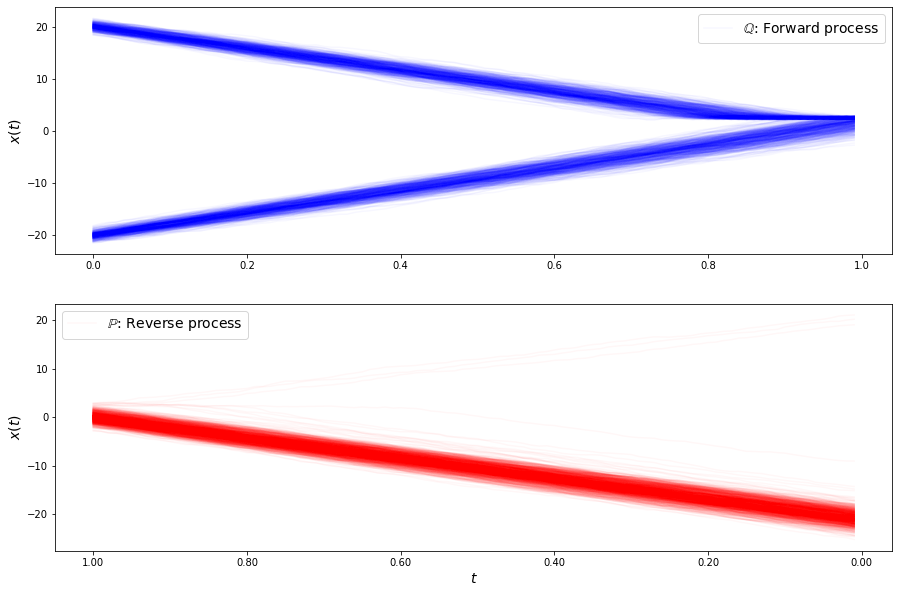

loss b -0.23270462084008167
loss b -0.25173822584287464
loss b -0.16061135763972206
loss b -0.364800441025233
loss b -0.20322003474661582
loss b -0.1837249245158915
loss b -0.32526233334696436
loss b -0.2819302990304087
loss b -0.19035429234621531
loss b -0.2922674395130925
loss b -0.18493424683752524
loss b -0.24409043316190812
loss b -0.19882936357666053
loss b -0.34206309890100806
loss b -0.33569350230297296
loss b -0.24519615967451808
loss b -0.2638020288964658
loss b -0.2716925204173049
loss b -0.27036031907861185
loss b -0.23117037664338244
loss b -0.22239978393209006
loss b -0.2635303256597106
loss b -0.25675751890136794
loss b -0.24043724511593978
loss b -0.31853814653828416
loss b -0.2345856950719156
loss b -0.12342003263476889
loss b -0.1918481022999042
loss b -0.3011364642220851
loss b -0.21278072784712448
loss f -4.346735634943891
loss f -4.099629619787262
loss f -4.452993417103506
loss f -3.783876882401726
loss f -3.0666299508695665
loss f -4.275519912566035
loss f -3.9634

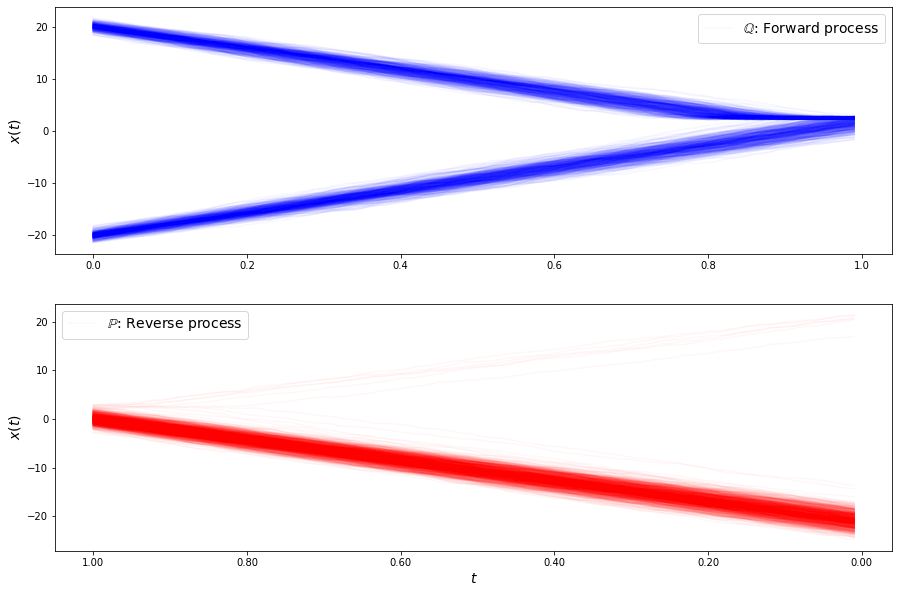

loss b -0.13437818187418865
loss b -0.14933339689552347
loss b -0.2411508197157397
loss b -0.186723310882325
loss b -0.2085075338318979
loss b -0.1431043134206798
loss b -0.2830425453144647
loss b -0.14682272631514862
loss b -0.31358993365322374
loss b -0.1881800831738083
loss b -0.16505826759114395
loss b -0.2543788265207086
loss b -0.3505393798225569
loss b -0.228037506730421
loss b -0.13366181846843295
loss b -0.1655977262001083
loss b -0.2394580191610591
loss b -0.14667583652480107
loss b -0.16761872140619122
loss b -0.2140662439388876
loss b -0.11908385801948929
loss b -0.3622883601681684
loss b -0.2052400423099055
loss b -0.10590492090763486
loss b -0.16832104030637876
loss b -0.1974512691459614
loss b -0.14668942804712698
loss b 0.003926405647934327
loss b -0.21920513877314193
loss b -0.027836552391429452
loss f -4.201799246702155
loss f -4.145348732401319
loss f -4.095754093729595
loss f -3.993514964976304
loss f -4.073878963095377
loss f -4.128746804124188
loss f -4.2247459646

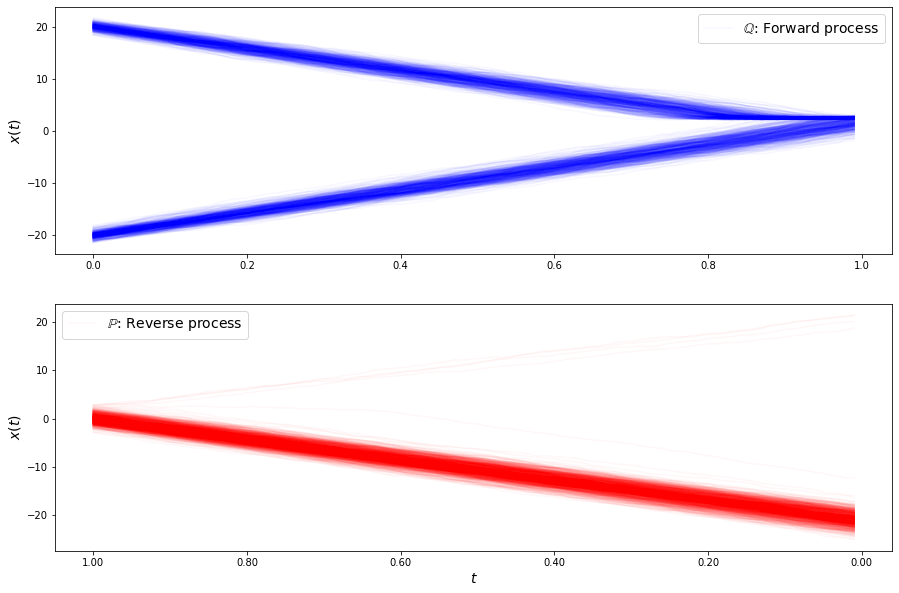

loss b -0.11527175605722793
loss b -0.15457361071556747
loss b -0.1599601519251298
loss b -0.10679249582529897
loss b -0.21220334306455432
loss b -0.05304424107975603
loss b -0.12370481641157423
loss b -0.08148982083189314
loss b -0.11878054573617237
loss b 0.054442354516476
loss b -0.22332745878526955
loss b -0.2283317470217581
loss b -0.2942882749226609
loss b -0.14232176896892118
loss b -0.21187046255247427
loss b -0.131707291362648
loss b -0.11716651617657227
loss b -0.1605057109767143
loss b -0.0678492756070557
loss b -0.2655107897906362
loss b -0.22913130115001065
loss b -0.12350614539111496
loss b -0.12651383821733592
loss b -0.08534046048689706
loss b -0.1484363012751223
loss b -0.1355155899879125
loss b -0.12000597814105976
loss b -0.15175987411002406
loss b -0.2443219638650121
loss b -0.130493480012562
loss f -3.475242304155961
loss f -3.8094744855756995
loss f -3.931516597632726
loss f -3.9865253218759333
loss f -3.9847023246037345
loss f -3.950799355639501
loss f -4.0470906

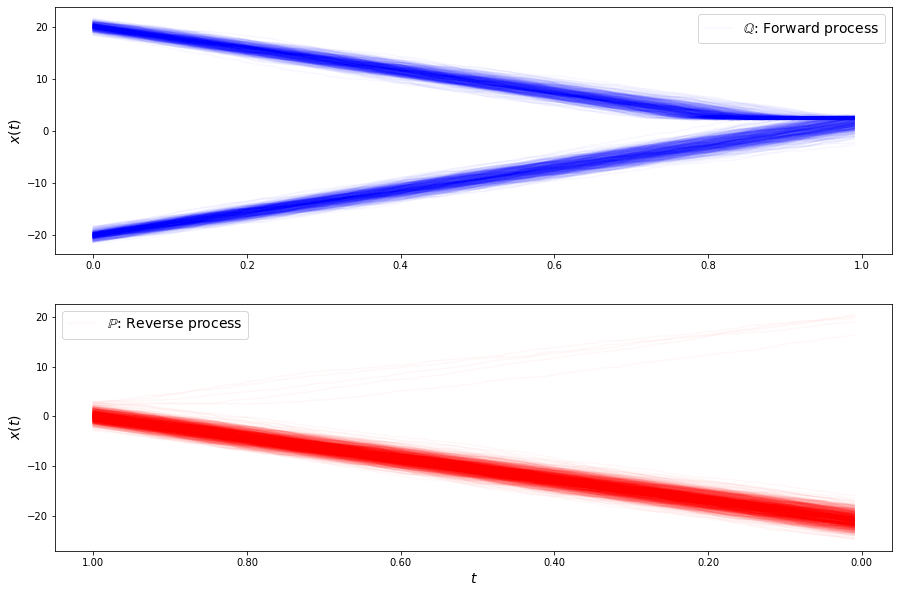

loss b -0.02670558099820054
loss b -0.03626039023749042
loss b -0.15466817587831633
loss b -0.16854680552581652
loss b 0.0310241375192657
loss b -0.06800705726882957
loss b -0.20452741252958165
loss b -0.07555627549163328
loss b -0.03711539080874832
loss b -0.042633534634872954
loss b -0.09549481225342712
loss b -0.017193901501354233
loss b -0.143081627192949
loss b -0.0997615275403372
loss b -0.1346279237055736
loss b -0.024979109396644723
loss b -0.10499601462888782
loss b -0.10413488596263284
loss b 0.04100412353037633
loss b -0.0662815541678234
loss b -0.04577512428312891
loss b -0.1259765111833796
loss b -0.15084898750892448
loss b -0.18001972249728274
loss b -0.13335296821250878
loss b 0.010471869274717584
loss b -0.16908393944918723
loss b -0.05746343124160234
loss b -0.08715390963477489
loss b -0.19291876044916806
loss f -3.8814259814058696
loss f -3.7725462060804653
loss f -3.8982187750340866
loss f -3.8690877623782076
loss f -3.8553313590376623
loss f -3.998386309667433
loss 

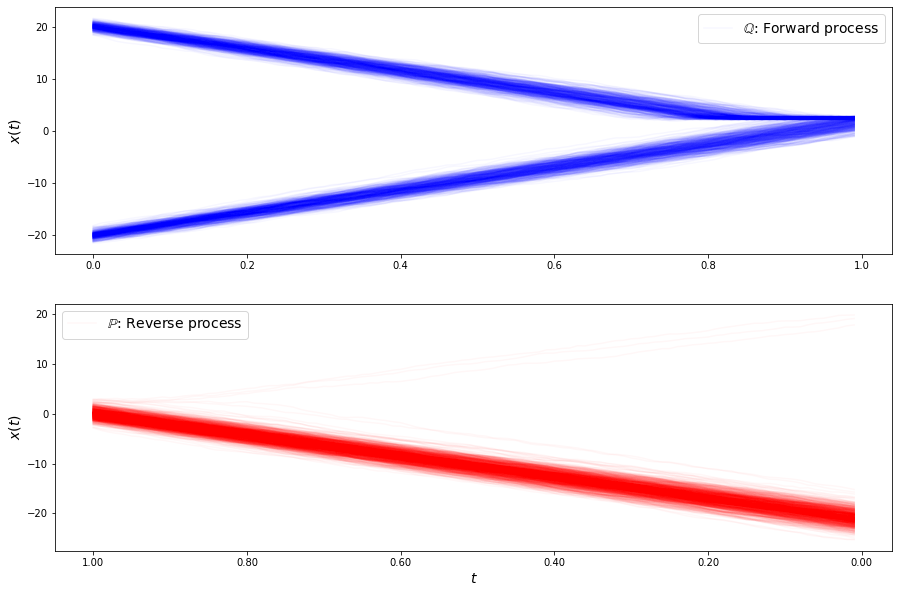

loss b 0.04869988131168352
loss b -0.05780372235555689
loss b 0.01839376814943666
loss b 0.05898135189885988
loss b -0.07763133058497937
loss b -0.06910170332951288
loss b -0.13566468775280505
loss b -0.01749022278676987
loss b 0.058425561671130166
loss b -0.04770457286353175
loss b -0.030128942307725802
loss b -0.09508225081656242
loss b -0.2093679706167847
loss b -0.05235789889535607
loss b -0.054113617284101065
loss b -0.08707268014908648
loss b 0.028358461302727084
loss b -0.05269125906290601
loss b -0.04160595941686157
loss b -0.024432955123969105
loss b -0.025028642209810367
loss b -0.10187399327491531
loss b -0.05689008931225487
loss b -0.11188211778422842
loss b 0.017333151138959293
loss b -0.03803310644949903
loss b -0.12928424649427933
loss b -0.04846493445676086
loss b -0.06575474019275071
loss b -0.06625021746138256
loss f -3.9562964688380946
loss f -3.7460222663106904
loss f -3.920293558472025
loss f -3.9912022818409714
loss f -3.838656113827731
loss f -3.805299374101091
l

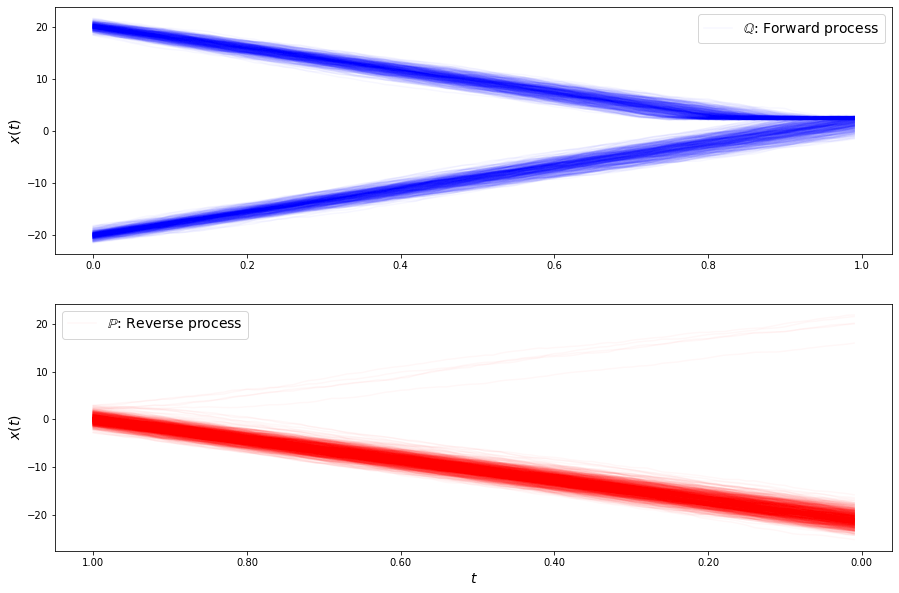

loss b 0.0018888944977972898
loss b 0.04879086923600669
loss b 0.03235086779284168
loss b 0.02676443796694693
loss b 0.09176026251016563
loss b -0.14472552341831538
loss b -0.034222191928550735
loss b -0.12668164499062462
loss b 0.02620770802241613
loss b 0.03998656389185943
loss b -0.06694230577944629
loss b 0.014265899737872399
loss b -0.045984411346803804
loss b 0.02287185655775516
loss b -0.016381973169707457
loss b -0.008634611036171184
loss b -0.010892541275654428
loss b 0.002750386430730513
loss b -0.021999942195173518
loss b -0.0025501622400764526
loss b 0.05346536407652487
loss b 0.009277933466205942
loss b 0.061281141650977276
loss b 0.046751333540183064
loss b 0.09253395986121125
loss b 0.04533707862471105
loss b -0.05803765710676935
loss b -0.01930974009489186
loss b -0.13690917528188185
loss b -0.0567961326618373
loss f -3.8810718371080197
loss f -3.9425166167103654
loss f -3.877584962372249
loss f -3.8868409807687643
loss f -3.9385488542098317
loss f -3.9060394902832454
l

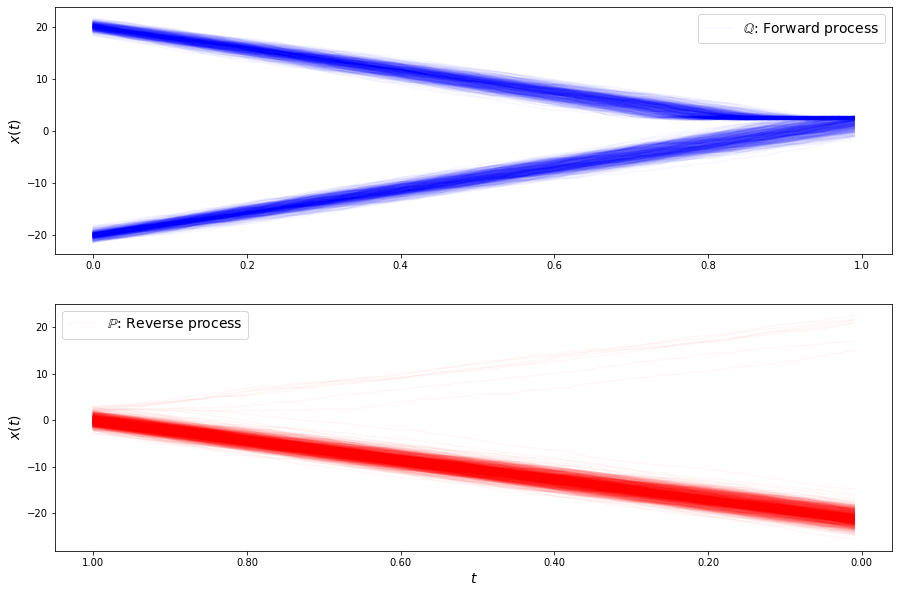

loss b -0.050309321663826914
loss b 0.06400935650730712
loss b 0.12927067895451033
loss b -0.0729974709130459
loss b 0.05981907435929601
loss b 0.0804948109032827
loss b 0.13248524084082428
loss b 0.06328934268714927
loss b 0.010813570520111735
loss b 0.007544782220874179
loss b -0.03818575100876992
loss b 0.030667093720238865
loss b -0.04323095212067661
loss b 0.10930744918520569
loss b -0.11281658324414048
loss b 0.022117977068605976
loss b 0.018282267040518652
loss b 0.08590411693890651
loss b 0.13506553762229945
loss b 0.19953670153123648
loss b 0.07159802851629475
loss b 0.17815981981528364
loss b 0.0010408163231379155
loss b 0.01492820728900609
loss b -0.0063781406059690154
loss b 0.08236721884639421
loss b 0.008049428971806938
loss b 0.13772716914984165
loss b 0.1208413154460035
loss b 0.04543524572456312
loss f -3.940118782117191
loss f -3.9496367523891305
loss f -3.8860913220496163
loss f -3.9376567893060925
loss f -4.006131149066622
loss f -3.9293207395912635
loss f -3.922856

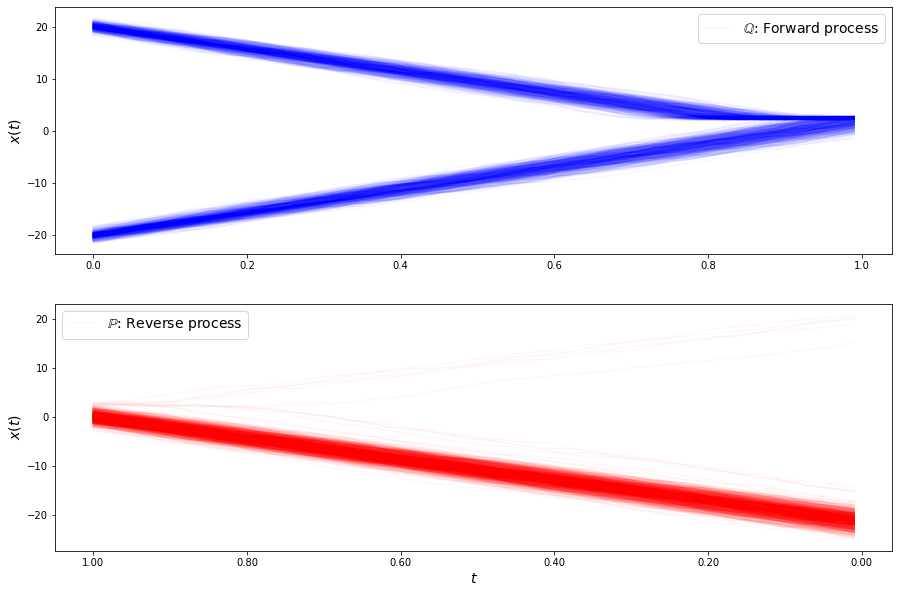

loss b 0.0348743317431058
loss b 0.16255896779277865
loss b 0.07251733412115217
loss b 0.0714649234532966
loss b -0.04304982498442836
loss b -0.02249833838426615
loss b -0.01526774645868438
loss b 0.05503773085601699
loss b 0.09195299072731253
loss b 0.08012132409397539
loss b 0.190759397684692
loss b 0.022460923466604464
loss b 0.11760467442195664
loss b 0.05425676218802582
loss b 0.07082236430733671
loss b 0.06055525770510297
loss b 0.17215589703349324
loss b 0.10980920874176461
loss b -0.012242068361964715
loss b 0.1324619526889063
loss b 0.32640048949112993
loss b 0.2355607903701234
loss b 0.08517417504079566
loss b 0.11785952896461119
loss b 0.16339705386577374
loss b 0.14898276818749284
loss b 0.1939759583370864
loss b 0.054398147949705815
loss b 0.0829664258492032
loss b 0.1233158293606147
loss f -4.172493434002718
loss f -3.901820619565928
loss f -3.972763732364353
loss f -4.049193209201651
loss f -4.035757413529578
loss f -3.9927534357902674
loss f -4.057787416438196
loss f -3

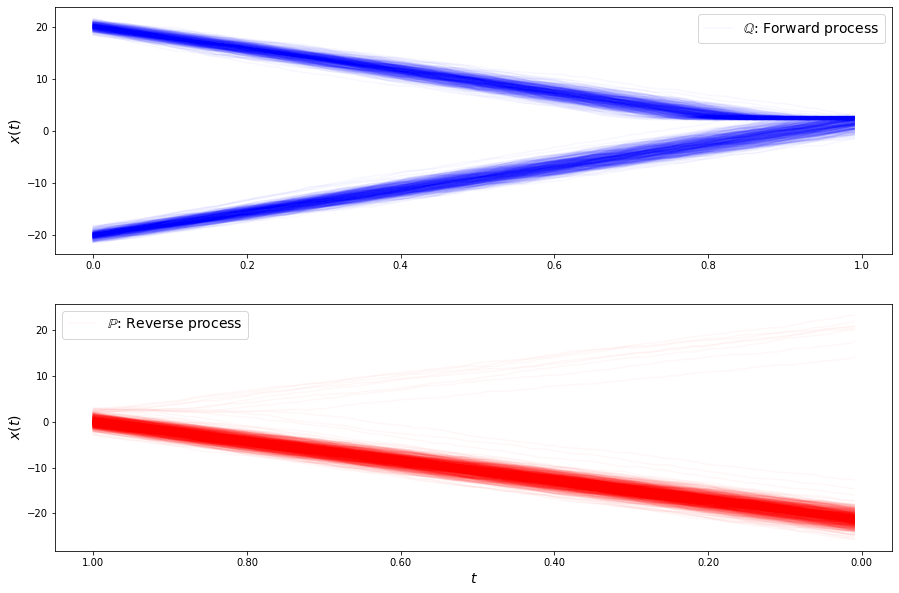

loss b 0.07322929260028974
loss b 0.1220437300419308
loss b 0.15279764988333272
loss b 0.18762581372825202
loss b 0.1295964480400732
loss b 0.21048119148305336
loss b 0.13961724838422426
loss b 0.08654240545448146
loss b 0.18216444137950172
loss b 0.058828400863996565
loss b 0.07224867345004907
loss b 0.0774523802718347
loss b 0.2137011642079938
loss b 0.15857572074655737
loss b 0.13991159816284252
loss b 0.07159315148951742
loss b 0.20720723667666818
loss b 0.10542449452609261
loss b 0.1714347526056335
loss b 0.17940913591370697
loss b 0.16509063332356944
loss b 0.09666348184252384
loss b 0.27681830845153016
loss b 0.3335559445920269
loss b 0.17496617824744562
loss b 0.06427882117224752
loss b 0.1787035501391652
loss b 0.22566242814991389
loss b 0.19480875535863637
loss b 0.16638325274305793
loss f -4.096933301046112
loss f -4.040973353722498
loss f -4.070839151222401
loss f -4.2476385842227895
loss f -4.030141842843794
loss f -4.098031639800039
loss f -3.9640282509570817
loss f -4.01

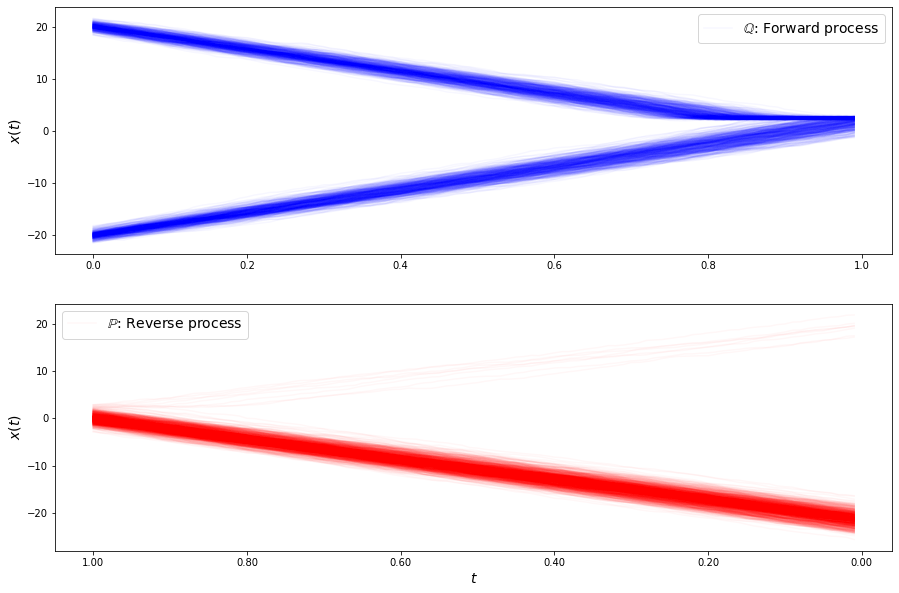

loss b 0.14495229816503058
loss b 0.07949511844636731
loss b 0.2726818025169266
loss b 0.0983088317202701
loss b 0.20555063599796522
loss b 0.1546848898605964
loss b 0.08590093244143635
loss b 0.2816801104012264
loss b 0.15358259540729496
loss b 0.2432182077041949
loss b 0.10511008233648453
loss b 0.12060117557180657
loss b 0.17394562392351512
loss b 0.23389213555942437
loss b 0.08606536109522578
loss b 0.20271857927460665
loss b 0.2611130483605635
loss b 0.1928264654775449
loss b 0.17867691873373948
loss b 0.16890943914424472
loss b 0.1837183439705509
loss b 0.25613445959665493
loss b 0.18732375973542795
loss b 0.261124395052598
loss b 0.23262472889522598
loss b 0.29688495745738147
loss b 0.21900541115569547
loss b 0.13412710259932545
loss b 0.23431188644062267
loss b 0.2623131092246543
loss f -4.123340615308856
loss f -4.286267287805617
loss f -4.146748678593293
loss f -4.2448154604887955
loss f -4.26622107953922
loss f -4.119504314447694
loss f -4.1810218797321985
loss f -4.18979528

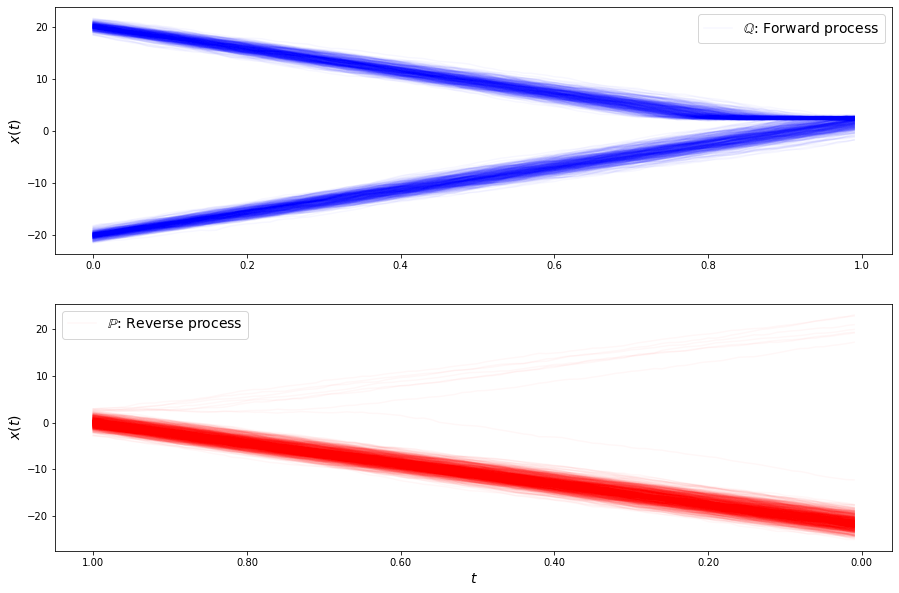

loss b 0.14706662355217912
loss b 0.17412617260959917
loss b 0.30469369836449633
loss b 0.2576578857183087
loss b 0.26631568622794455
loss b 0.2098224375913836
loss b 0.17629648517905142
loss b 0.3028165265595921
loss b 0.15732830039546986
loss b 0.29216274709999585
loss b 0.2026446286537582
loss b 0.2562908737936776
loss b 0.15686355959984105
loss b 0.2732665417018463
loss b 0.34202948804076333
loss b 0.23593065194085344
loss b 0.17788864330611612
loss b 0.1969807866535046
loss b 0.28096553902357596
loss b 0.3190135829508138
loss b 0.16610618149554554
loss b 0.29053483182103257
loss b 0.3706386974334005
loss b 0.33769559764675533
loss b 0.31002759197815694
loss b 0.3301058035497372
loss b 0.3176055402055978
loss b 0.2917586194096397
loss b 0.30184219698380227
loss b 0.23843874941649118
loss f -4.21754928138598
loss f -4.27429892600349
loss f -4.2281971750081615
loss f -4.2209294140281175
loss f -4.193564757092377
loss f -4.183556659415885
loss f -4.320390154649147
loss f -4.1608876344

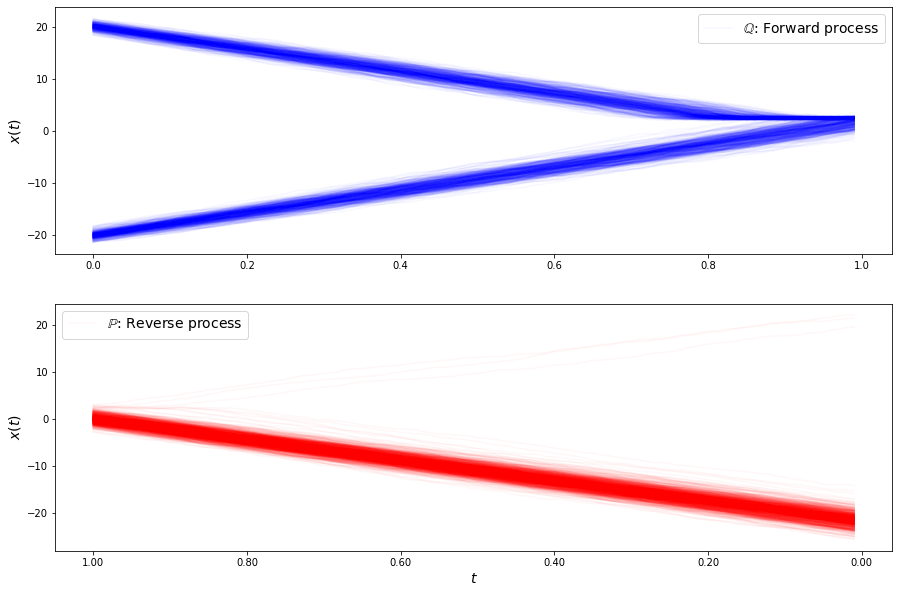

loss b 0.26945900265164274
loss b 0.21380400946008676
loss b 0.3897076012718534
loss b 0.23195198332812791
loss b 0.3189578924635501
loss b 0.4596844918480218
loss b 0.37173319905255103
loss b 0.31967376118020296
loss b 0.34663290590000817
loss b 0.3821191802965112
loss b 0.27532420333198687
loss b 0.3727522072575205
loss b 0.33880619775524135
loss b 0.42175421617524816
loss b 0.40157328341587406
loss b 0.40444415216986085
loss b 0.3517909420944615
loss b 0.3295204288347236
loss b 0.31950941139473005
loss b 0.33258499781435175
loss b 0.34110328211733615
loss b 0.38790970750298037
loss b 0.33504976656320856
loss b 0.2777601505896398
loss b 0.30141634266802236
loss b 0.4490113546321247
loss b 0.4215047148313911
loss b 0.42237989840800094
loss b 0.2961389150223525
loss b 0.4140416131733312
loss f -4.312853549227169
loss f -4.438802994331751
loss f -4.339356494322992
loss f -4.356632151799185
loss f -4.314533492136827
loss f -4.320353021017673
loss f -4.328581999639602
loss f -4.3897090558

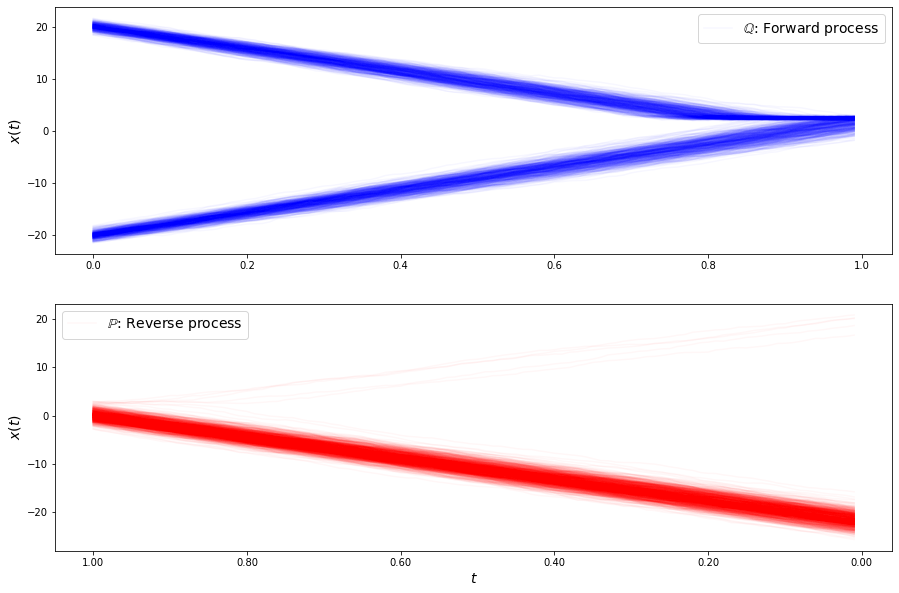

loss b 0.42159078374874553
loss b 0.46705872931973363
loss b 0.4415533532413467
loss b 0.4971621716398783
loss b 0.45003388943319855
loss b 0.34801631017860707
loss b 0.3837494093153143
loss b 0.3670214707955607
loss b 0.37475296477842573
loss b 0.4832792449948895
loss b 0.41638922229108943
loss b 0.3827139083912113
loss b 0.44358067562305836
loss b 0.45668865271644116
loss b 0.5000202794524485
loss b 0.4953982338050611
loss b 0.47997929782186705
loss b 0.44643796829744137
loss b 0.4101317117996346
loss b 0.4868905777380212
loss b 0.4836647251969517
loss b 0.41342044065741534
loss b 0.5231160630190544
loss b 0.4678238626103942
loss b 0.5821919448877234
loss b 0.4405017924662016
loss b 0.4259847229423551
loss b 0.45309029507442666
loss b 0.4771434267739845
loss b 0.5962576872080877
loss f -4.401385049620622
loss f -4.426671770661056
loss f -4.434804914011095
loss f -3.85921278120757
loss f -4.3257910773033865
loss f -4.459864069346304
loss f -4.38723790991922
loss f -4.221819058027983
l

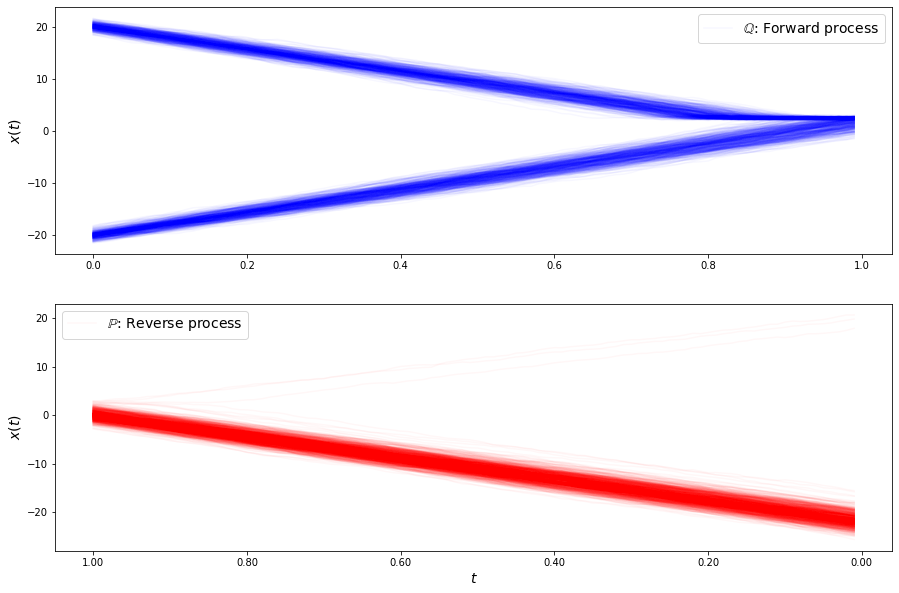

loss b 0.5398558022403719
loss b 0.4562219158505361
loss b 0.44456008284244003
loss b 0.4915924665575636
loss b 0.4653216513808454
loss b 0.4751092659828646
loss b 0.5029407421445145
loss b 0.5135722100283573
loss b 0.5268506804686512
loss b 0.4991719628036472
loss b 0.46422853259975677
loss b 0.5182124847723113
loss b 0.586212315136973
loss b 0.5379001843108671
loss b 0.5371950522539597
loss b 0.40550605275902496
loss b 0.4919335277926708
loss b 0.5942070303522596
loss b 0.5366400900561535
loss b 0.47736247881040117
loss b 0.581017829918757
loss b 0.5639658078957012
loss b 0.43404287252597323
loss b 0.5331124933451903
loss b 0.6050717435332603
loss b 0.6006607343066073
loss b 0.6150409527300625
loss b 0.5581015816891849
loss b 0.606121301052066
loss b 0.5896582885823476
loss f -4.604075876043231
loss f -4.6349627708122005
loss f -4.580327802238921
loss f -4.1068410941996625
loss f -4.610952321589926
loss f -4.131500883427326
loss f -4.361097799833045
loss f -4.56702661952952
loss f -4

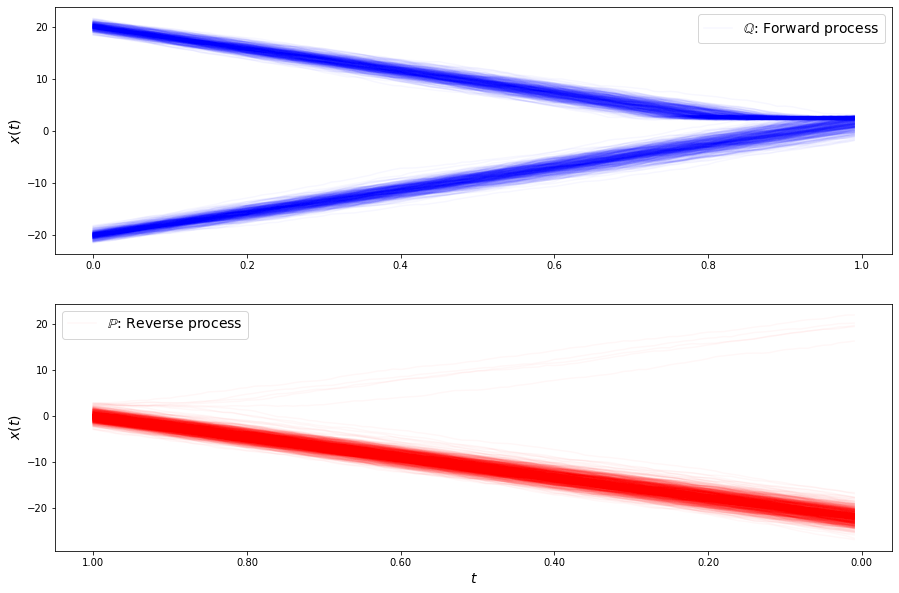

loss b 0.584460069421775
loss b 0.5398969629350644
loss b 0.5696273045607324
loss b 0.6473039145314582
loss b 0.6423275473649198
loss b 0.6077036246888596
loss b 0.7061742318864856
loss b 0.5975446093107935
loss b 0.5883825357460271
loss b 0.5829426625292162
loss b 0.6385172724664934
loss b 0.5964696383997227
loss b 0.704151069228899
loss b 0.5911852629901244
loss b 0.6022705385354857
loss b 0.5769095100799397
loss b 0.6706397073516037
loss b 0.6651423365402174
loss b 0.7387705044569626
loss b 0.6430402473906377
loss b 0.6073440565340381
loss b 0.650594037551559
loss b 0.6019152629626714
loss b 0.6566091985262478
loss b 0.623066827511245
loss b 0.6772835700293106
loss b 0.6559261711567801
loss b 0.652936984983308
loss b 0.6803010171250803
loss b 0.6734291260500931
loss f -4.611205680010421
loss f -4.673923188930014
loss f -4.551967262731287
loss f -4.55058181522508
loss f -4.606617716179299
loss f -4.1886854560069064
loss f -4.630175179902934
loss f -4.577300562326138
loss f -4.6225875

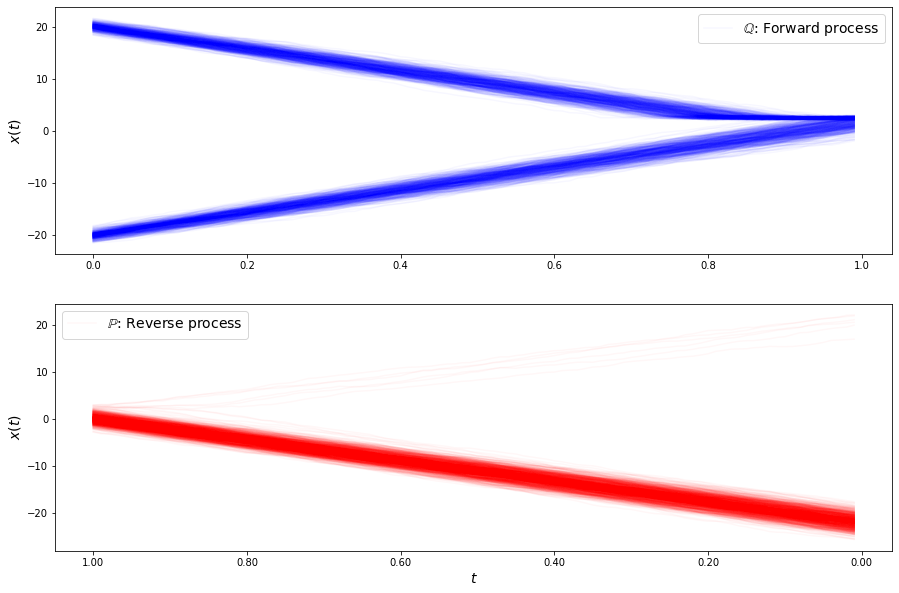

loss b 0.6589786591058742
loss b 0.6753563369021026
loss b 0.6678753074907017
loss b 0.6866488362020111
loss b 0.7343111887306235
loss b 0.749379189973228
loss b 0.7051878960435534
loss b 0.7372379210596011
loss b 0.6936094868533359
loss b 0.6966730925110015
loss b 0.6324898630727743
loss b 0.6967602865981255
loss b 0.7680980986178426
loss b 0.7847839021816684
loss b 0.7522618258567182
loss b 0.754150465213873
loss b 0.7512041871679299
loss b 0.7033737113752804
loss b 0.7388057629272369
loss b 0.7097716949071823
loss b 0.7444379206393323
loss b 0.7184095210606053
loss b 0.7446719724080074
loss b 0.7289917529461034
loss b 0.7695721143033787
loss b 0.7354713183621964
loss b 0.7256222991333894
loss b 0.842532495222999
loss b 0.7788639637572176
loss b 0.712159514018901
loss f -4.871750138340443
loss f -4.690038871090069
loss f -4.874197797547559
loss f -4.7379213013580825
loss f -4.565226398851151
loss f -4.707089997571128
loss f -4.774236773352884
loss f -4.752830549448897
loss f -4.53627

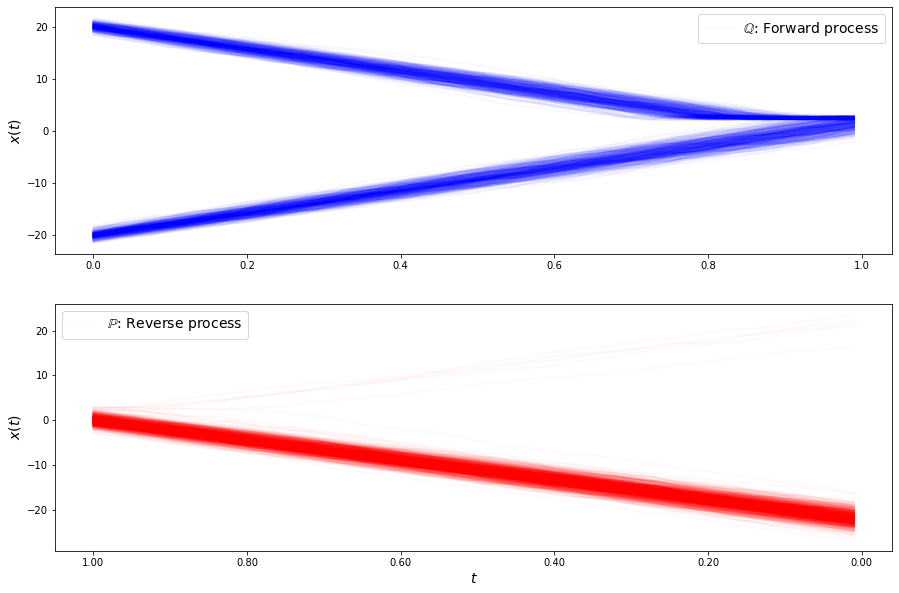

loss b 0.8551226567575992
loss b 0.7647974665031145
loss b 0.7945647839718591
loss b 0.7652425752821786
loss b 0.753785516649445
loss b 0.8336757247359123
loss b 0.8411647674229835
loss b 0.7862842537611975
loss b 0.7985268764340906
loss b 0.8138671948112716
loss b 0.7869018507171356
loss b 0.8701214194747191
loss b 0.8337273705897187
loss b 0.8141608345137573
loss b 0.8445193568648679
loss b 0.868723787752925
loss b 0.8473432591667438
loss b 0.8464384526426323
loss b 0.839132956380395
loss b 0.7943422573415915
loss b 0.8822220245418516
loss b 0.8378906658639583
loss b 0.8159785160296492
loss b 0.9019687629072312
loss b 0.8462102312767928
loss b 0.8454003741400254
loss b 0.8669819897161811
loss b 0.8837421351025248
loss b 0.8504975715471327
loss b 0.8957477198311224
loss f -4.8463404095724965
loss f -4.779469823484078
loss f -4.568128305702548
loss f -4.4379927081165045
loss f -4.90761726560747
loss f -4.544082485205351
loss f -4.64930493015029
loss f -4.743835188809474
loss f -4.81271

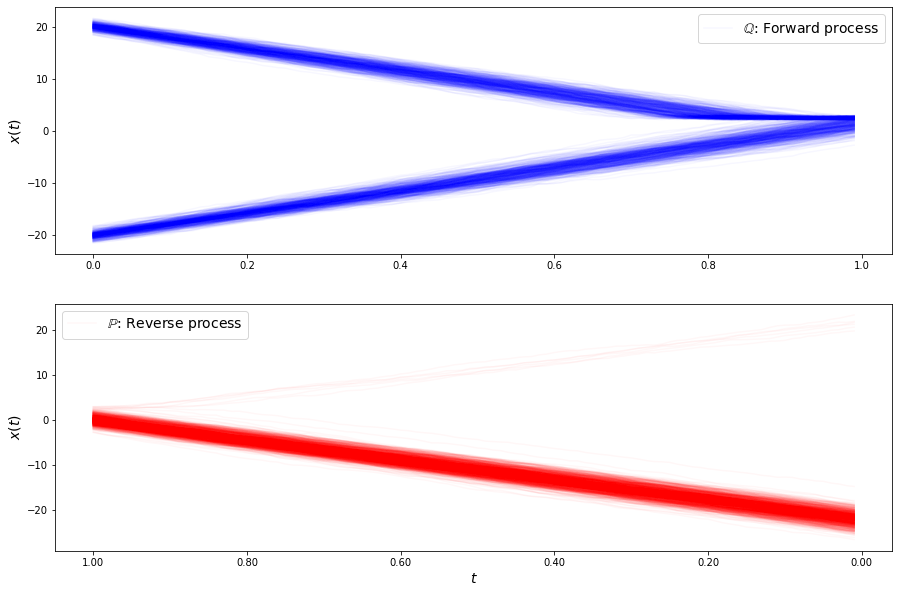

loss b 0.8119221771256754
loss b 0.8645955650709064
loss b 0.964594203089177
loss b 0.8710360176969699
loss b 0.8800669559430313
loss b 0.915072563173893
loss b 0.8947920327697387
loss b 0.8921700868327093
loss b 0.9179767194529914
loss b 0.8795188246256048
loss b 0.9367167417006713
loss b 0.8387917523384695
loss b 0.9445146771332906
loss b 0.9514739763211489
loss b 0.9441164410926917
loss b 0.9140975670315278
loss b 0.9881821490003238
loss b 0.9150841723246075
loss b 1.0346464921722764
loss b 0.9043797329382961
loss b 0.9552360489293893
loss b 0.9968367714066786
loss b 0.9500233834224647
loss b 0.8728678143131205
loss b 0.8958212510377271
loss b 0.8694303927638761
loss b 0.9703349482130871
loss b 0.8992695391571536
loss b 1.0377039259780036
loss b 0.854093964317974
loss f -4.899158808139012
loss f -4.835485964278627
loss f -4.7749438416651655
loss f -4.771185835122378
loss f -4.3618993536715545
loss f -4.934556902284634
loss f -4.769948015441171
loss f -4.641410807983296
loss f -4.708

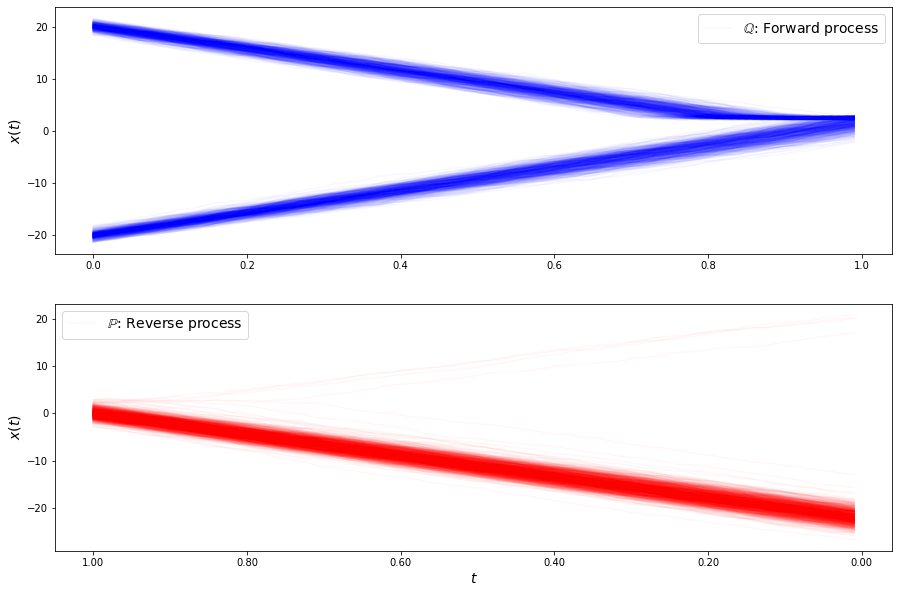

loss b 1.0280029549631726
loss b 0.886378679786251
loss b 0.9458680103740306
loss b 1.0170951401391095
loss b 0.9991995926320815
loss b 0.9913427893747594
loss b 1.048290049878348
loss b 1.0115194876056348
loss b 1.020734782297383
loss b 0.9463860836303889
loss b 0.9687304171254408
loss b 0.9535654787148219
loss b 0.9913141194522263
loss b 0.9929049183658089
loss b 0.9688300083875746
loss b 1.002058033029458
loss b 0.9641328381273905
loss b 0.9692345169499621
loss b 1.0404696625028471
loss b 0.9463593628506286
loss b 0.9955693390680923
loss b 0.9796598118609731
loss b 0.9995188810328517
loss b 1.0032151563008664
loss b 0.9301090134740708
loss b 0.9924738130433488
loss b 0.9640233100214494
loss b 1.0024936571255303
loss b 1.0386172836640792
loss b 0.9427504491142898
loss f -4.802659027002178
loss f -4.788706013879318
loss f -4.598187652639014
loss f -4.809825733943939
loss f -4.986776373999465
loss f -4.860279325184686
loss f -4.912905882196245
loss f -4.869967966324135
loss f -5.013621

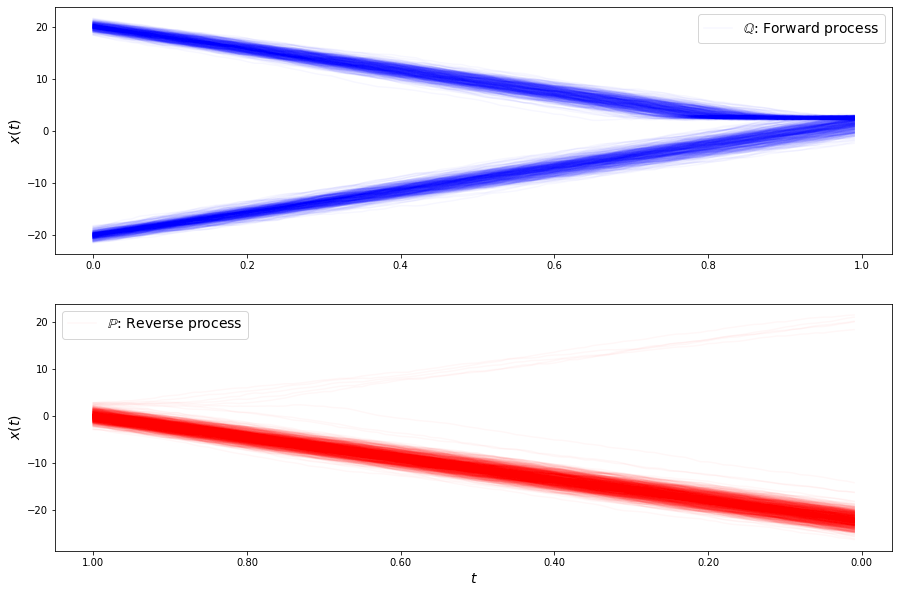

loss b 0.9984189431055681
loss b 1.0559884544548972
loss b 1.0046263066706789
loss b 1.0490838934883888
loss b 1.0207734229350975
loss b 0.9550893868718084
loss b 1.0647722891033002
loss b 1.0751079803897345
loss b 1.1282331212616588
loss b 1.0378181310932104
loss b 1.0111491059022832
loss b 1.0249423523492622
loss b 1.0990719644987836
loss b 1.1817019422443198
loss b 1.0576364220700047
loss b 0.9867586018968019
loss b 1.0224766867486337
loss b 1.0221218825262717
loss b 1.1242053636770437
loss b 1.0228327223414628
loss b 1.027599304111168
loss b 1.1236699879284862
loss b 1.1076051332026635
loss b 1.0338130513203432
loss b 1.1497065394128296
loss b 0.9987970185154947
loss b 1.0827502949894456
loss b 1.070766491289743
loss b 1.0777759677831227
loss b 1.0083771146158644
loss f -4.96581692186234
loss f -4.964748564739286
loss f -4.903303604769582
loss f -4.9616417078739685
loss f -5.033375318180401
loss f -4.8378878147231905
loss f -4.930449188102834
loss f -4.9803131239072576
loss f -4.89

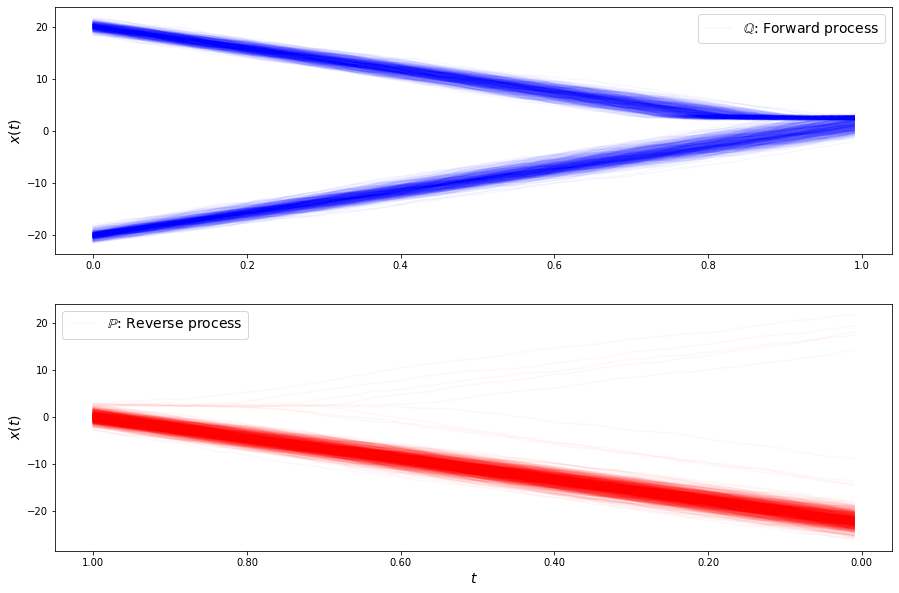

loss b 1.057847532421164
loss b 1.0581832387139165
loss b 1.087343702779205
loss b 1.1095227491594588
loss b 1.0665714032577291
loss b 1.0477660413187482
loss b 1.1259532114633872
loss b 1.1409742997941799
loss b 1.1053005883614495
loss b 1.0314131890528142
loss b 1.0522307919214267
loss b 1.0737820600804981
loss b 1.089264990191955
loss b 1.1191482137597235
loss b 1.1183455726226061
loss b 1.0222960104573828
loss b 1.0728513888944855
loss b 1.152429091433931
loss b 1.0904116580705399
loss b 1.0070210341485935
loss b 1.094436296078787
loss b 1.0313716281243759
loss b 1.1412833885670723
loss b 1.1142881389090256
loss b 1.0839550623978105
loss b 1.0475590300918627
loss b 1.0615289393766616
loss b 1.0561202534782796
loss b 1.009295580937645
loss b 1.0768602685004764
loss f -4.515990542025075
loss f -4.7548520053729515
loss f -4.952779403752182
loss f -5.0579555480890654
loss f -4.857276131009661
loss f -4.964673204460797
loss f -4.930028272996392
loss f -4.952455223736295
loss f -4.950169

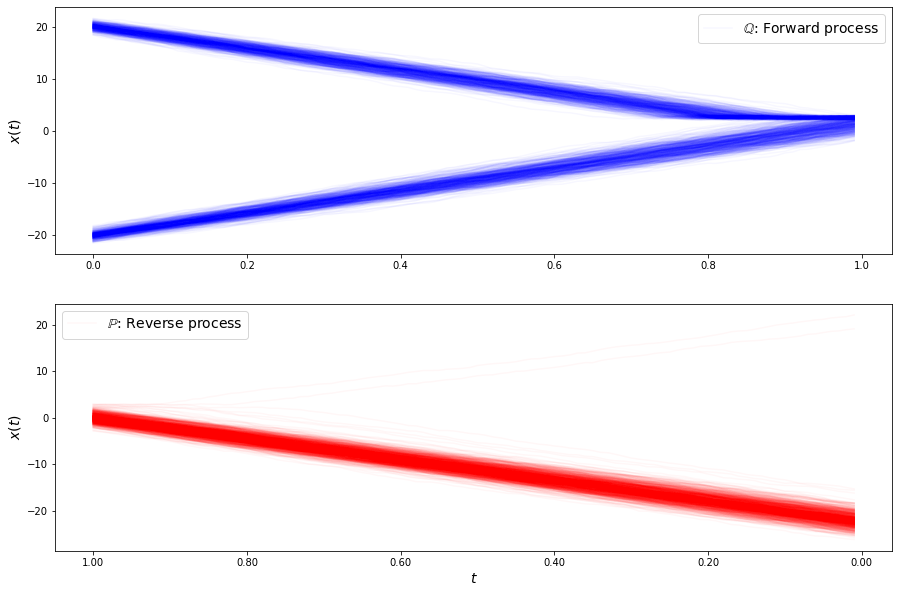

loss b 1.0612928460646334
loss b 1.0677939428343608
loss b 1.1399324718926827
loss b 1.1062370414534235
loss b 1.0755601670767923
loss b 1.1210389774314982
loss b 1.1604299214234286
loss b 1.1272706808560762
loss b 1.0914736427914755
loss b 1.1405470610940156
loss b 1.108122968029713
loss b 1.0597344737662007
loss b 1.1035395781846478
loss b 1.1739585838355642
loss b 1.1145979169937161
loss b 1.093218764836393
loss b 1.129116951651641
loss b 1.0503526371559853
loss b 0.9732571919382861
loss b 1.1062030653429045
loss b 1.070773899433273
loss b 1.0721886155252607
loss b 1.0760919866221808
loss b 0.9501376998792387
loss b 1.0217566604882509
loss b 1.0013484175062644
loss b 0.9846960165617102
loss b 1.0445668139867772
loss b 1.0746057521692225
loss b 1.1359983723047697
loss f -5.0091254097712286
loss f -4.816528201235185
loss f -4.9180655480338284
loss f -4.93215777612248
loss f -4.970567015746071
loss f -5.021114731844101
loss f -4.914149812042312
loss f -4.87608505713864
loss f -5.122252

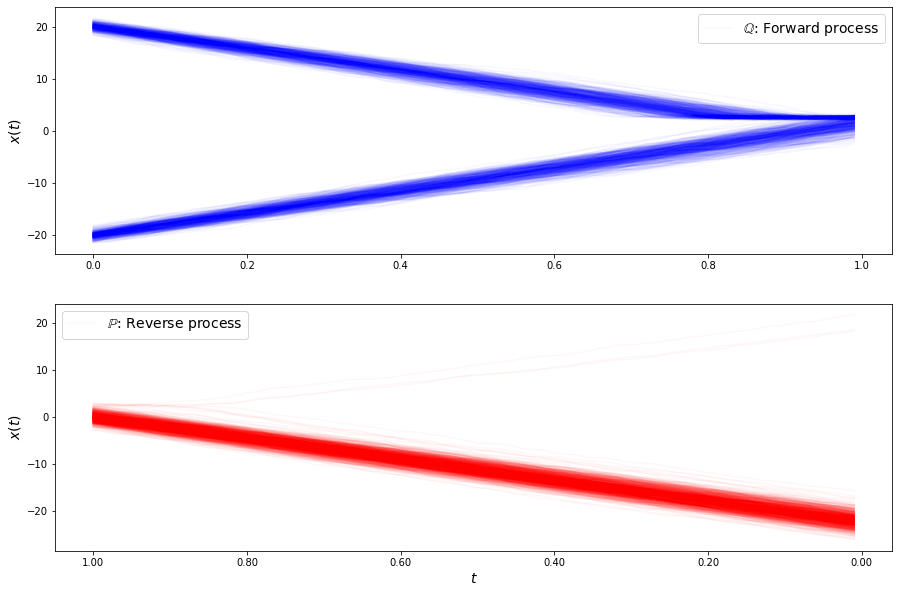

loss b 1.027706339322596
loss b 1.060904180304467
loss b 1.1072754584459272
loss b 1.0191236713554201
loss b 1.114236320189936
loss b 1.1215231549827518
loss b 1.1392999328720206
loss b 1.0618273146678194
loss b 1.0999588359347172
loss b 1.1306240204428832
loss b 1.1250450961912437
loss b 0.9951395678176992
loss b 1.0484922487246389
loss b 1.0234901021051062
loss b 1.035145472594651
loss b 1.073431849697796
loss b 1.0337612045435483
loss b 1.0774302348365838
loss b 1.0393582908038128
loss b 0.960926587394496
loss b 1.0090335086164048
loss b 0.9851209269031774
loss b 1.0400641426442458
loss b 1.032734323544137
loss b 1.0641836427984175
loss b 1.0668856813986645
loss b 1.05150462569976
loss b 1.0435314652758703
loss b 1.0602710280036105
loss b 0.9684269342377827
loss f -4.919510398202834
loss f -4.565852699191404
loss f -4.628324458985715
loss f -4.688463392945749
loss f -5.172180050080248
loss f -4.993811211893715
loss f -4.996774444910619
loss f -4.75403660222575
loss f -4.882370282205

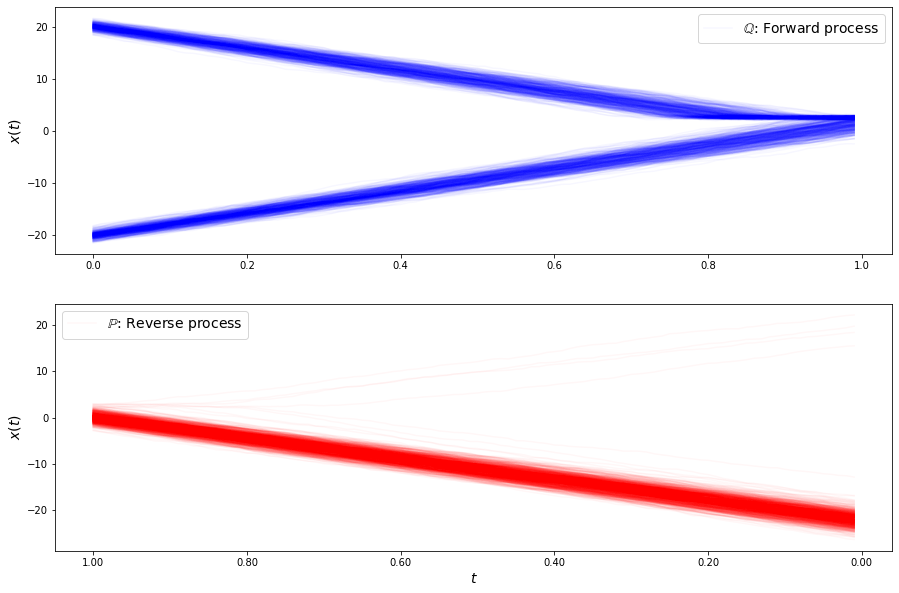

loss b 1.02150851518721
loss b 1.0046805227784141
loss b 1.0313733453620484
loss b 1.02843268707417
loss b 1.0208456765130018
loss b 0.9783474697059958
loss b 1.059986032878716
loss b 1.0690991809291381
loss b 0.9912865564233149
loss b 1.0349345776520888
loss b 0.954553239543202
loss b 0.9242470516551486
loss b 0.9493937607539875
loss b 1.0432592948193868
loss b 0.9424437133520052
loss b 0.9728094515677428
loss b 0.9754013453609816
loss b 0.9415276401265971
loss b 0.9477683494607874
loss b 0.9603139647845402
loss b 0.9956165468034345
loss b 0.9437406503038341
loss b 0.886916829535718
loss b 0.8351404684277141
loss b 0.8904571031927017
loss b 0.9392657031094848
loss b 0.9389007779344766
loss b 0.8737263401669136
loss b 0.8597267635247271
loss b 0.9432922173316134
loss f -5.063895280426803
loss f -5.078021419466116
loss f -4.947046662141002
loss f -5.171445551463598
loss f -4.824035746683878
loss f -4.900648978264118
loss f -5.066823950825219
loss f -5.1211625607849856
loss f -4.97000855

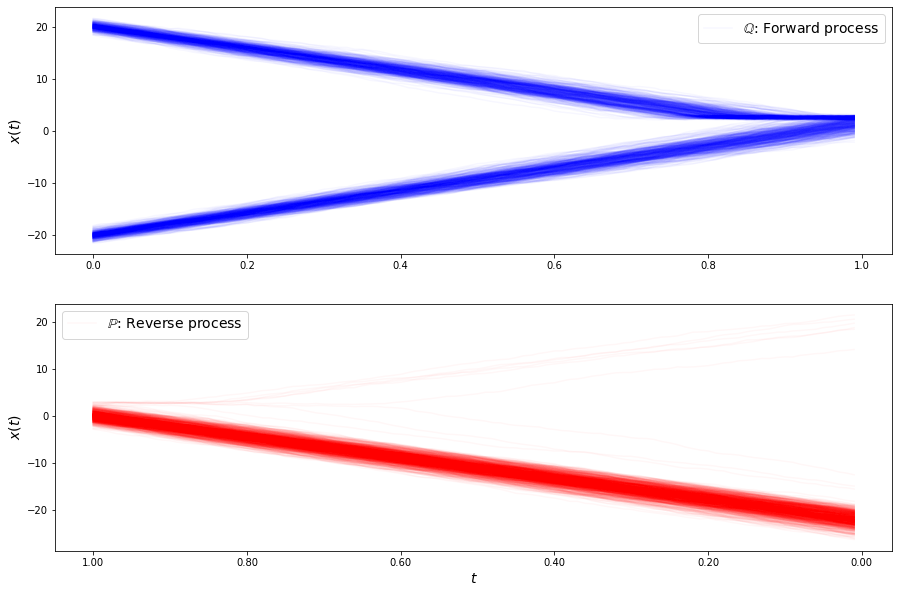

loss b 0.9279226612752695
loss b 0.9050118448169491
loss b 0.9003002996892963
loss b 0.9018951255207219
loss b 0.934428116293389
loss b 0.9509085227475451
loss b 0.875777986084547
loss b 0.8738009967572491
loss b 0.8943387659049387
loss b 0.8765293205108395
loss b 0.8747160282242223
loss b 0.8058515828328221
loss b 0.9997688449159815
loss b 0.7452137168976715
loss b 0.8340738820462078
loss b 0.8334858334048253
loss b 0.8868634831593216
loss b 0.9001929082481539
loss b 0.9011298754696795
loss b 0.9071841591725077
loss b 0.8448776990187801
loss b 0.8427578360610233
loss b 0.8239223024625902
loss b 0.7966439400727707
loss b 0.941203642553631
loss b 0.8934427294303608
loss b 0.8648680982700263
loss b 0.8072440045385113
loss b 0.7522013762892289
loss b 0.783539245735035
loss f -5.100635863789148
loss f -5.100862800600697
loss f -4.917962451849445
loss f -5.055828279996877
loss f -4.978227193774685
loss f -4.995761535918695
loss f -4.642699040492944
loss f -4.768468773079752
loss f -4.270503

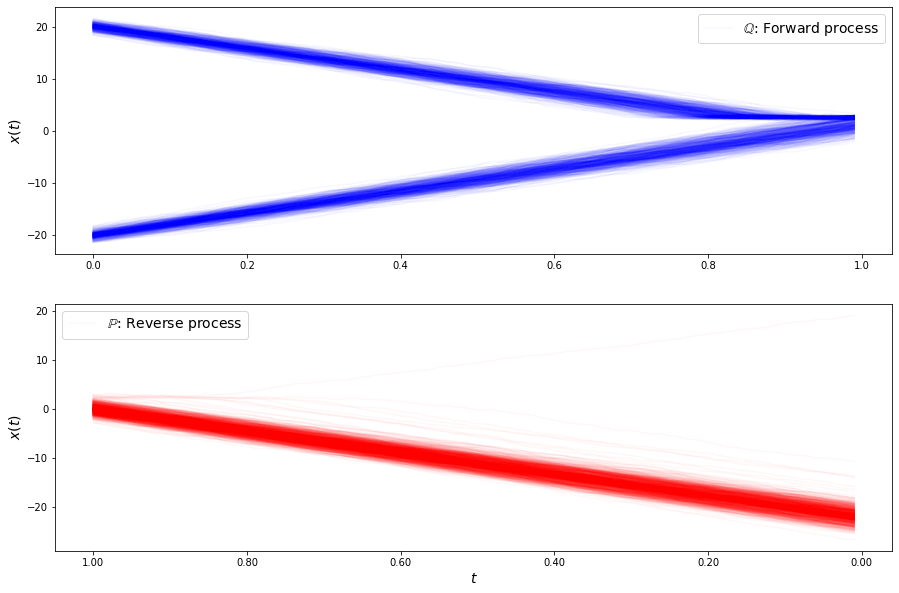

loss b 0.8914887161135319
loss b 0.8002577011128365
loss b 0.8239752808704458
loss b 0.8939696419271879
loss b 0.8278542591733362
loss b 0.8379817492242664
loss b 0.8609153542052811
loss b 0.8215614953887282
loss b 0.814268876264218
loss b 0.7020468491024658
loss b 0.75178412523346
loss b 0.6876225898639553
loss b 0.9307749549064018
loss b 0.7790477652436079
loss b 0.8203140405419547
loss b 0.6691883155374273
loss b 0.9001139550857418
loss b 0.741888808720274
loss b 0.6600064975588958
loss b 0.7481294396525016
loss b 0.73738339333248
loss b 0.6684946197342909
loss b 0.7137261035995389
loss b 0.6750579676466372
loss b 0.7285185410165915
loss b 0.6847117764511624
loss b 0.7755593056677492
loss b 0.6564040182435503
loss b 0.6344807465320271
loss b 0.6268842739778497
loss f -5.149907013121378
loss f -4.981774468097396
loss f -5.078491240234692
loss f -5.162687820296162
loss f -5.06683196164497
loss f -5.174203741911648
loss f -5.079231314331122
loss f -5.012710662434477
loss f -5.276138856

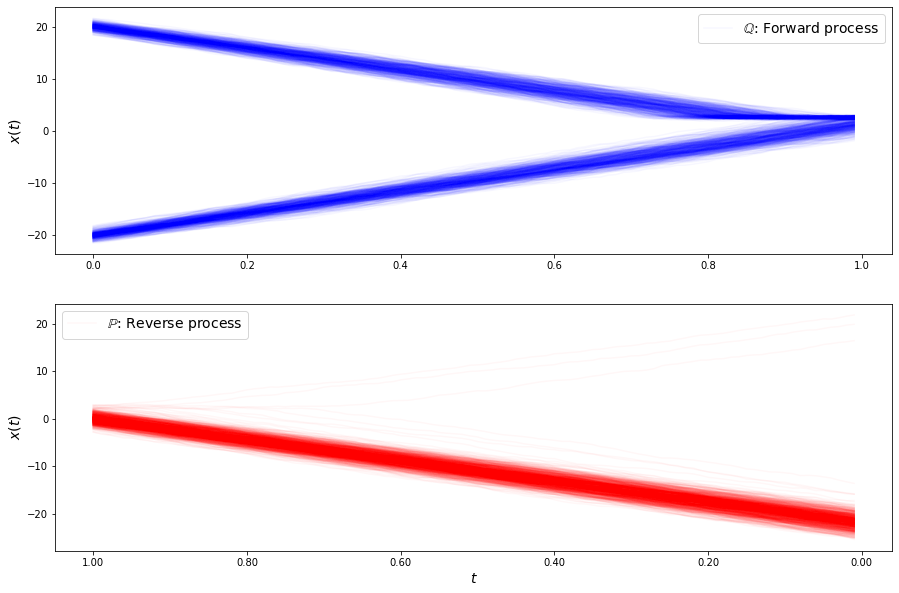

loss b 0.7047111177791039
loss b 0.7785750540705317
loss b 0.7296489453586812
loss b 0.6200523715545518
loss b 0.7112907110130022
loss b 0.5989485901505355
loss b 0.6386792330425605
loss b 0.6767600522730643
loss b 0.6134113975912504
loss b 0.5378713310904181
loss b 0.6880838451648771
loss b 0.6867335281062878
loss b 0.6102356594624997
loss b 0.7128682359716328
loss b 0.6697309558799814
loss b 0.7162549293535627
loss b 0.6947712732125574
loss b 0.728843934937987
loss b 0.6848036586258007
loss b 0.5995381578112932
loss b 0.5858999076535615
loss b 0.6606023574618091
loss b 0.6998778909112171
loss b 0.5595005740128579
loss b 0.4752036167683742
loss b 0.5803922715987191
loss b 0.5081871324935838
loss b 0.4390095054091985
loss b 0.5836611175045815
loss b 0.6158925002694939
loss f -5.226961093774786
loss f -4.978323121466519
loss f -4.967374073499449
loss f -4.3973851810177385
loss f -5.200744521552611
loss f -5.154162689636723
loss f -5.154660794264299
loss f -5.082388917785355
loss f -5.05

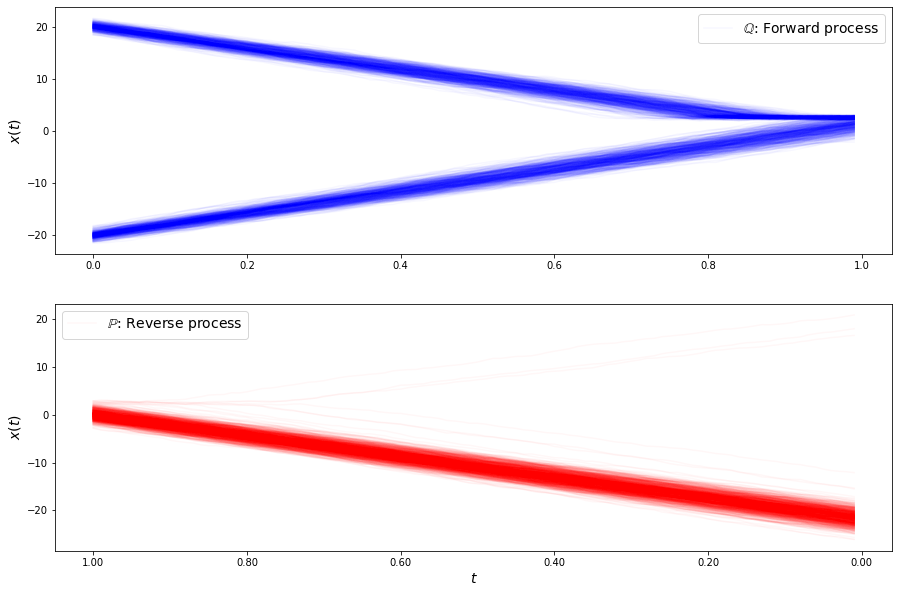

loss b 0.5599198457209328
loss b 0.5272291023314785
loss b 0.5837654711198574
loss b 0.4430373266945524
loss b 0.7085705906456058
loss b 0.5737354551157666
loss b 0.5210178498166198
loss b 0.5493987011228667
loss b 0.6080449236036201
loss b 0.5945033847988732
loss b 0.43468770726279593
loss b 0.5069749665841002
loss b 0.4779284196878532
loss b 0.4979545626086878
loss b 0.42666790430619334
loss b 0.39934699941129725
loss b 0.4552400956034422
loss b 0.5070958515498355
loss b 0.4940023278354234
loss b 0.5338408779025249
loss b 0.3606092821650671
loss b 0.41727097627930326
loss b 0.42588979546249073
loss b 0.4057764823351752
loss b 0.453624867500509
loss b 0.3683011842258825
loss b 0.3061492381779001
loss b 0.40449144049070085
loss b 0.4284099594930536
loss b 0.5218732023519042
loss f -4.843180564264331
loss f -4.938202963832722
loss f -5.022354297043231
loss f -4.957573596395987
loss f -4.993140852708572
loss f -4.794672162114678
loss f -4.557332744015915
loss f -5.014967492882743
loss f 

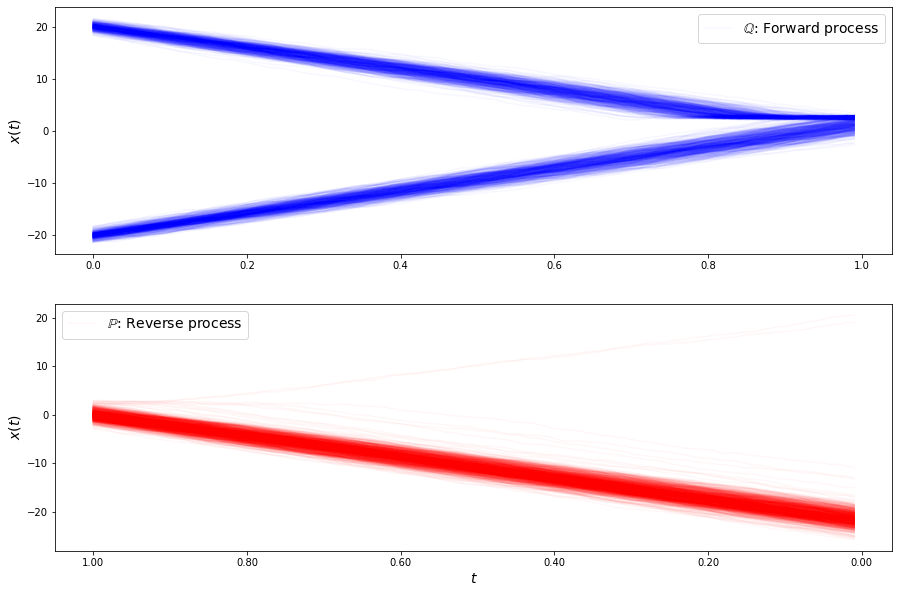

loss b 0.5095312574965843
loss b 0.3207021136771057
loss b 0.42736013648558674
loss b 0.34451921246949646
loss b 0.33619117675110344
loss b 0.26520194356853355
loss b 0.4711435200049872
loss b 0.3782191277872303
loss b 0.3460903083959597
loss b 0.24215501015100824
loss b 0.36385923259071945
loss b 0.5003585649903038
loss b 0.2845002750731141
loss b 0.40457596393597717
loss b 0.28116467327173833
loss b 0.35889455506542367
loss b 0.25198920955555437
loss b 0.6461125055374972
loss b 0.43075146381882506
loss b 0.2770625927592468
loss b 0.3200322089085027
loss b 0.3242859565219324
loss b 0.3061219003249686
loss b 0.45427996979395013
loss b 0.2234073469923924
loss b 0.28515765656270325
loss b 0.22123073559673442
loss b 0.3220022586984919
loss b 0.18189761141284974
loss b 0.2631802154967418
loss f -5.163249168833656
loss f -4.9790917737761555
loss f -5.239021322411587
loss f -5.214082813779948
loss f -5.133551533155472
loss f -5.133584614933396
loss f -5.150597068954869
loss f -5.097506971809

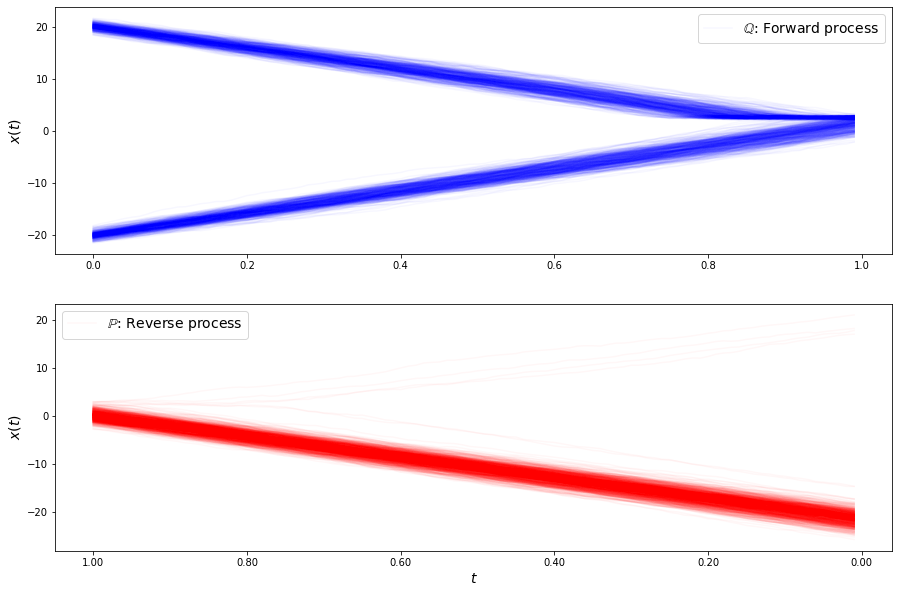

loss b 0.1850798214494797
loss b 0.2827351014225718
loss b 0.13460058334201166
loss b 0.14696309718753897
loss b 0.23013347600796563
loss b 0.14393150331670596
loss b 0.14375026234947144
loss b 0.11848197197794433
loss b 0.23473384396774782
loss b 0.047881509131634595
loss b 0.18616597759238718
loss b 0.18622560862692658
loss b 0.2720263373526378
loss b 0.3118039366071307
loss b 0.08614729126064596
loss b 0.07948906609326853
loss b 0.1431486807099243
loss b 0.18543886159030537
loss b 0.27333492722626945
loss b 0.21145942729822154
loss b 0.2426640920554918
loss b 0.2107125405321362
loss b 0.1727826367490657
loss b 0.16023202591097788
loss b 0.13180477423016215
loss b 0.13521010559617017
loss b 0.17619770440742946
loss b 0.17497406043568356
loss b 0.11092013353294362
loss b 0.1065972970525862
loss f -4.31832899508063
loss f -5.117419703030356
loss f -4.678180887416417
loss f -4.832454676685243
loss f -5.101395092414735
loss f -4.725633393803664
loss f -4.382269097936444
loss f -4.8763733

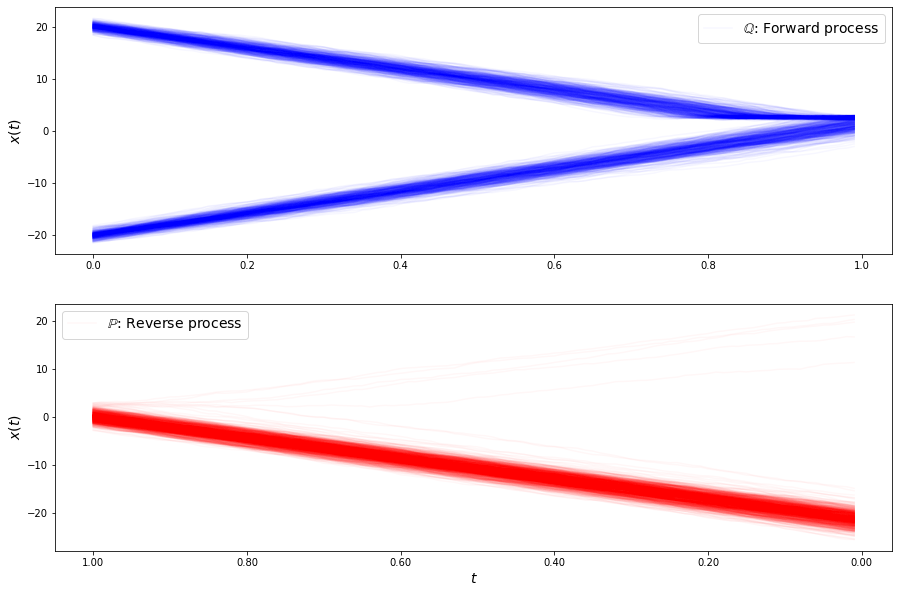

loss b 0.2016846356404486
loss b 0.09597821149401778
loss b 0.2166507399742192
loss b 0.17939313520164626
loss b 0.04253326713732654
loss b 0.19942199436361813
loss b 0.08991109000276941
loss b 0.04807526024413422
loss b 0.1935736567176979
loss b 0.22015533535741438
loss b 0.0029104505443537836
loss b 0.06587493822635251
loss b -0.01758501767701817
loss b 0.14760758282618514
loss b 0.05854699869935185
loss b 0.061211054504695266
loss b 0.09610731624301994
loss b -0.014130396868312264
loss b 0.11279066765347387
loss b -0.059686779074785735
loss b 0.06826658492378884
loss b 0.014768181216910366
loss b 0.002544424570750784
loss b -0.10035357718124654
loss b 0.0638127749745988
loss b 0.2143207051742207
loss b -0.05319150667568909
loss b 0.05162226618593438
loss b 0.03293742056996777
loss b 0.025017465209400538
loss f -4.9572878208177835
loss f -5.150674424666835
loss f -4.034913824113767
loss f -4.70904219644036
loss f -5.029402962654105
loss f -4.760369116481862
loss f -4.992059440460122


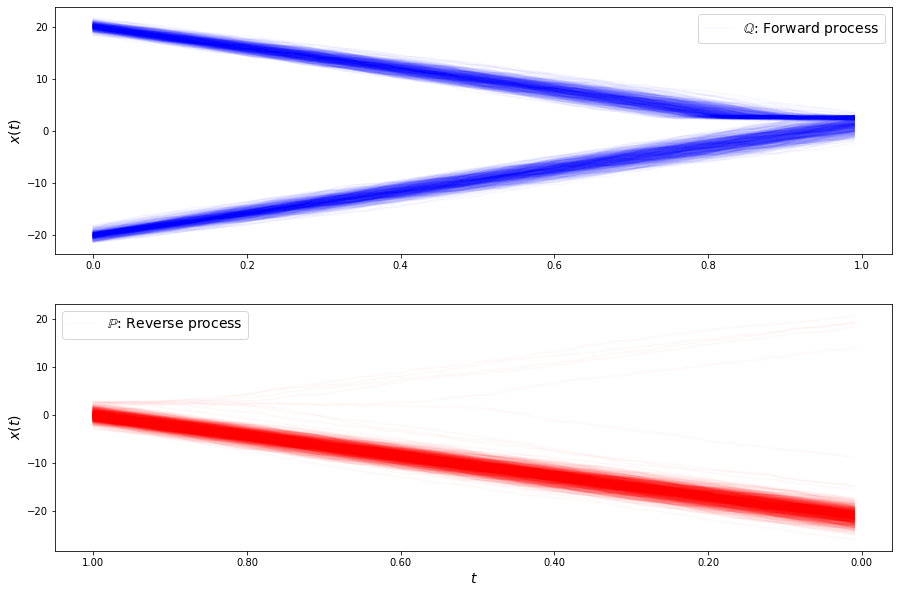

loss b 0.005103195115937966
loss b -0.21211457670820597
loss b -0.010415242931238682
loss b -0.10006473477544536
loss b 0.043019334977441474
loss b 0.136648290634693
loss b 0.09579966508166285
loss b 0.19235385429184035
loss b -0.11808859317041166
loss b -0.2177725759418037
loss b 0.01259988633869167
loss b -0.10572139902079254
loss b -0.09108793355216707
loss b -0.02544520324455839
loss b -0.2431571886671852
loss b -0.00315954285152347
loss b 0.04830288679537702
loss b -0.22542975383767733
loss b -0.14221144296845992
loss b -0.04904816874291366
loss b -0.06904522206589926
loss b -0.14351772774291785
loss b -0.16245855796021333
loss b -0.04349671499293208
loss b 0.11650216150805362
loss b 0.10151623107782208
loss b 0.12505987304749414
loss b -0.03756202055480971
loss b -0.19479527084658285
loss b -0.0111109484937674
loss f -5.26944237758993
loss f -5.044102734296623
loss f -4.729987179348465
loss f -4.555475932730421
loss f -5.0188425508278485
loss f -4.586117471533353
loss f -3.483121

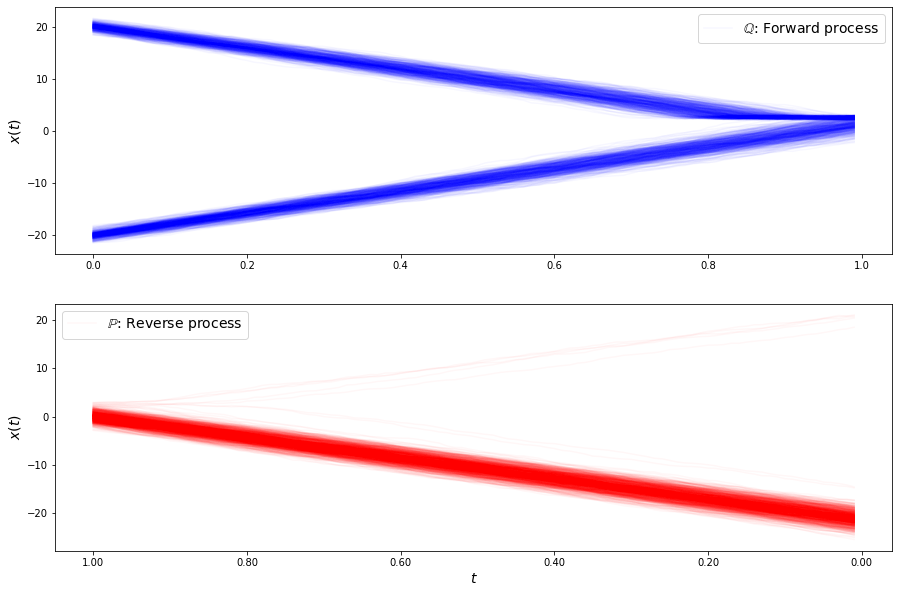

loss b -0.21762606262665152
loss b 0.08375751940923136
loss b -0.05839997247045785
loss b -0.12697199329902675
loss b -0.05111099440967813
loss b -0.18819273780860388
loss b -0.15706324398655072
loss b -0.3803331051530682
loss b -0.014365368638060497
loss b -0.25356973871364547
loss b -0.17808545803623763
loss b -0.14161898365875603
loss b -0.20888565678717466
loss b -0.15611066840830726
loss b -0.1767607657026926
loss b -0.11807876152837084
loss b -0.253479756322323
loss b 0.16933549907905354
loss b -0.07520309770132616
loss b -0.08758516865638258
loss b -0.24433756451357683
loss b -0.10824210669306644
loss b -0.26726660137583563
loss b -0.07701350121325228
loss b -0.0958917469255852
loss b -0.020613168310661074
loss b -0.2593235599545136
loss b -0.1023399869083684
loss b -0.020943433356363516
loss b -0.12893497430078518
loss f -4.919461967226852
loss f -5.155529103747409
loss f -5.211372510924926
loss f -5.099395063606428
loss f -4.56374292976758
loss f -4.870432530245448
loss f -5.1

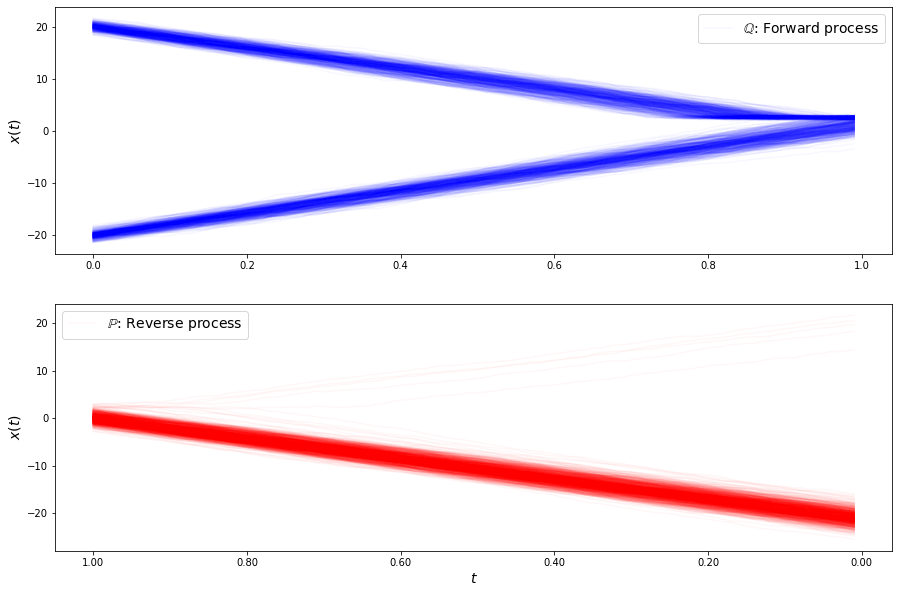

loss b -0.2118115431567443
loss b -0.29533009924617487
loss b -0.001716687460219491
loss b -0.150348892056939
loss b -0.09847821875277646
loss b -0.279380273763773
loss b -0.05914408667772333
loss b -0.15672883324777367
loss b -0.03871423638977697
loss b -0.16236623281579265
loss b 0.034063705207474884
loss b -0.2665829580149998
loss b -0.25412946510367346
loss b -0.032222065539073814
loss b -0.253368717510686
loss b -0.15432392160907232
loss b -0.06258503637730194
loss b -0.43600606207781434
loss b -0.16036121229796022
loss b -0.20759118143235075
loss b -0.1738944226271096
loss b -0.2386946324445151
loss b -0.27836948629790764
loss b -0.21149889430190882
loss b -0.2696381701094602
loss b -0.16902164572767256
loss b -0.2725630107396004
loss b 0.09361155879230555
loss b -0.2539594936010157
loss b -0.10831119545595881
loss f -4.710591543333335
loss f -4.757629852620511
loss f -4.162593241397441
loss f -4.549686992657223
loss f -4.692321389770215
loss f -4.625619749951506
loss f -4.470149

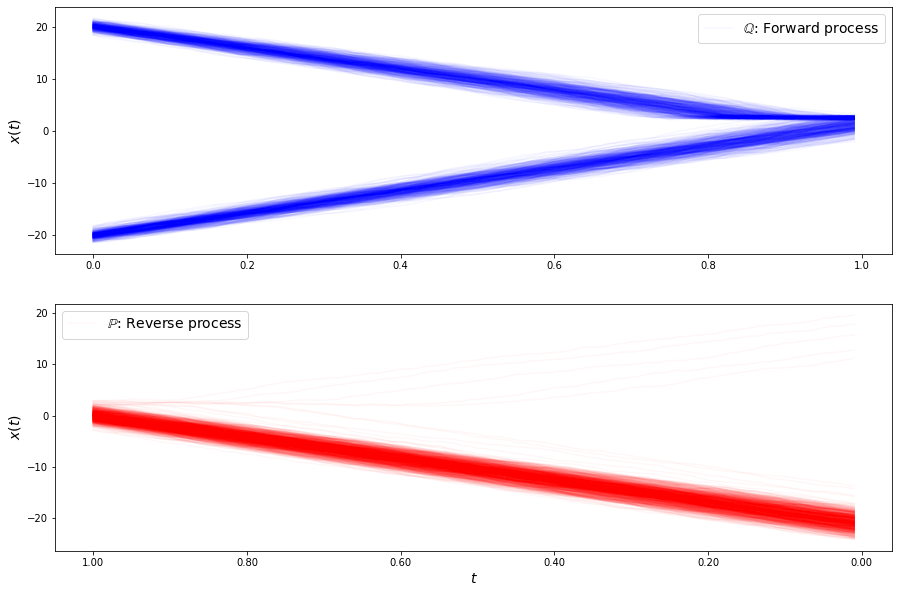

loss b -0.24941613188336162
loss b -0.30830343548444644
loss b -0.13217696143663465
loss b -0.33941062479926337
loss b -0.016346077752035712
loss b -0.4100397421984698
loss b -0.19677726218726416
loss b -0.12667919089206428
loss b -0.3502208873906818
loss b -0.4615762559600327
loss b -0.22861931503282795
loss b -0.17107554625027088
loss b -0.16998239119775727
loss b -0.22928643291475062
loss b -0.149966759750424
loss b -0.35096995580709
loss b -0.341320952823872
loss b -0.23470201975208124
loss b -0.21994229444154115
loss b -0.13576963569856002
loss b -0.34465634753122765
loss b -0.07908622162488384
loss b -0.1957727530024571
loss b -0.19412355524948957
loss b -0.21926048823009286
loss b -0.24120697461537344
loss b -0.2751821428313971
loss b -0.24632055698140884
loss b -0.24941354005353303
loss b -0.15796582788575766
loss f -5.092639265783089
loss f -4.723889205391356
loss f -3.6298563566574273
loss f -4.2455354504261384
loss f -3.7038682683714876
loss f -4.856703611013366
loss f -3.77

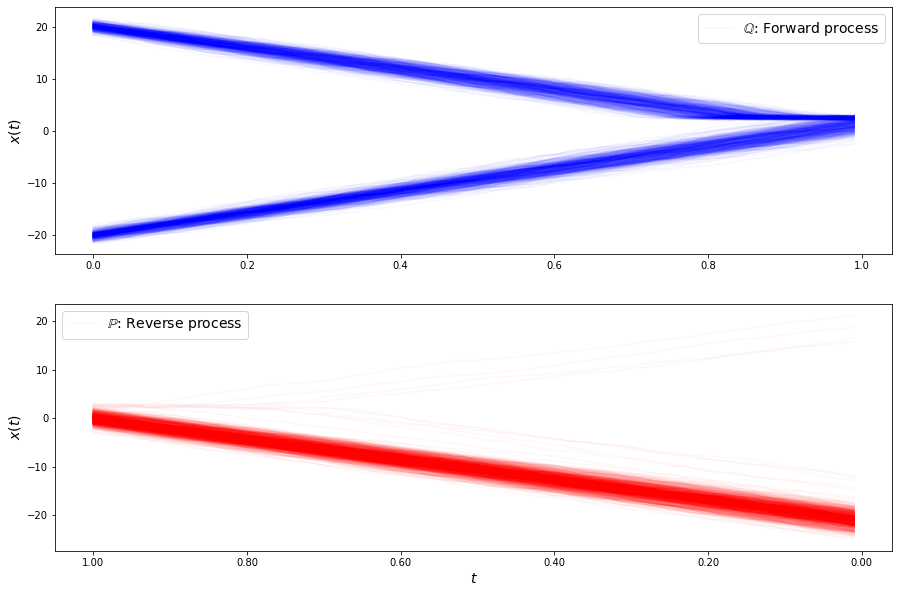

loss b -0.046923605788769696
loss b -0.3059258914979076
loss b -0.42510221054405467
loss b -0.48213347344306795
loss b -0.24914262916852117
loss b -0.3751478656748059
loss b -0.22541844420276339
loss b -0.1327984848155737
loss b -0.39563963235650995
loss b -0.33050947872094966
loss b -0.16634746195327468
loss b -0.3669292256458281
loss b -0.2557430895807371
loss b -0.42482641646571895
loss b -0.38921180786677906
loss b -0.26615729241980235
loss b -0.28142988728719937
loss b -0.16880126458952757
loss b -0.17765447607386345
loss b -0.24553877335782182
loss b -0.29033754823595376
loss b -0.27852629926161354
loss b -0.35761205525314904
loss b -0.17205337031317494
loss b -0.4971845718858034
loss b -0.2758399548817118
loss b -0.4189586484137454
loss b -0.27795487900312843
loss b -0.31296292513136337
loss b -0.27768085654410424
loss f -4.890678894824811
loss f -4.545592169661228
loss f -4.855047674675701
loss f -4.764741480790338
loss f -4.788581400309971
loss f -3.190693106380545
loss f -4.3

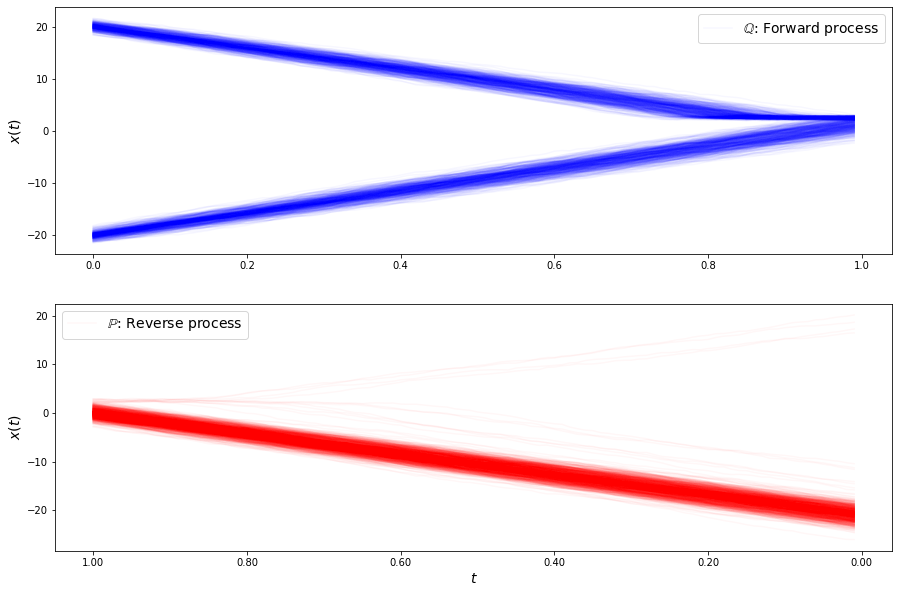

loss b -0.3635591171750182
loss b -0.35307113150131475
loss b 0.03833706555203715
loss b -0.2871680877516684
loss b -0.1663759947216393
loss b -0.5231533791770849
loss b -0.3523075205303334
loss b -0.3609893573193554
loss b -0.40451146594829634
loss b -0.36662521189635777
loss b -0.24561544145589065
loss b -0.18637643984069108
loss b -0.27796750115630103
loss b -0.30390729743161365
loss b -0.34315121292123313
loss b -0.23562326572909542
loss b -0.5376024552014095
loss b -0.46190211272136106
loss b -0.54807014555065
loss b -0.43800293269889906
loss b -0.32020432006668925
loss b -0.2720718071995443
loss b -0.1425798673870905
loss b -0.34191888109810353
loss b -0.45532756947696074
loss b -0.28084057785860445
loss b -0.49007534052162277
loss b -0.34639668147484615
loss b -0.4266865510626852
loss b -0.16952438062361844
loss f -4.708880217227976
loss f -4.607010084821875
loss f -4.691354470203051
loss f -4.59496943789469
loss f -4.364160426226621
loss f -4.781370546099802
loss f -4.202566599

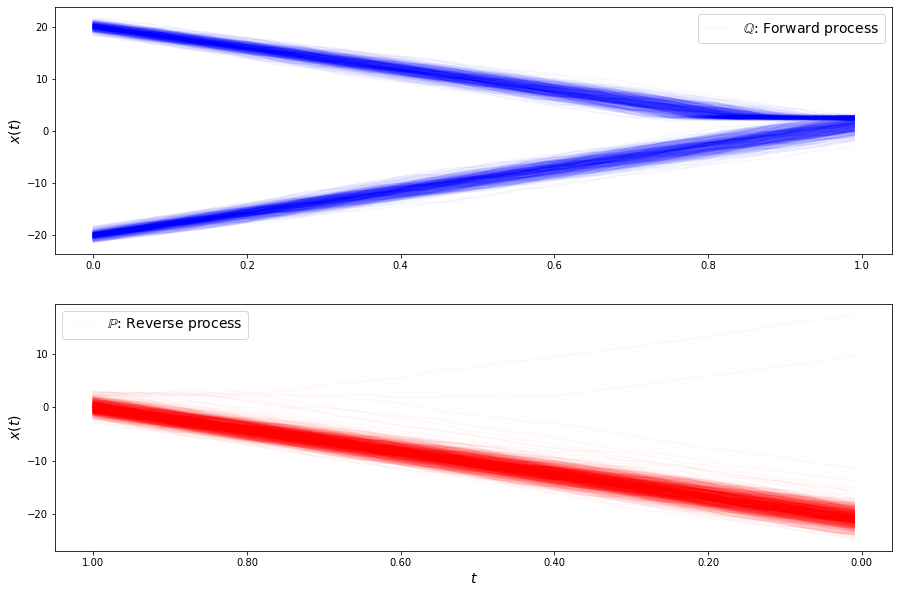

loss b -0.379651507050036
loss b -0.20202855289234392
loss b -0.5257289891279103
loss b -0.4364269357935135
loss b -0.5906661095701533
loss b -0.3770513416863925
loss b -0.26595254183338274
loss b -0.4596241131511944
loss b -0.2471556596941575
loss b -0.27891073704394204
loss b -0.6370643932481295
loss b -0.27566379393774215
loss b -0.3671724660317871
loss b -0.4885728099899947
loss b -0.3548444249690741
loss b -0.37884464485908087
loss b -0.29009232133371937
loss b -0.38149271132987467
loss b -0.2964253207429787
loss b -0.3781740543845375
loss b -0.28021684618325093
loss b -0.23507861102603683
loss b -0.2006133911179911
loss b -0.11944563289185862
loss b -0.3999744112582467
loss b -0.49144941716736834
loss b -0.3471896505509724
loss b -0.44813237868608896
loss b -0.4389791645392027
loss b -0.19588322072327757
loss f -4.609283154941869
loss f -4.638439204837469
loss f -4.633429095620447
loss f -4.602991130907534
loss f -4.181386589388525
loss f -4.7286887389090015
loss f -4.29404377576

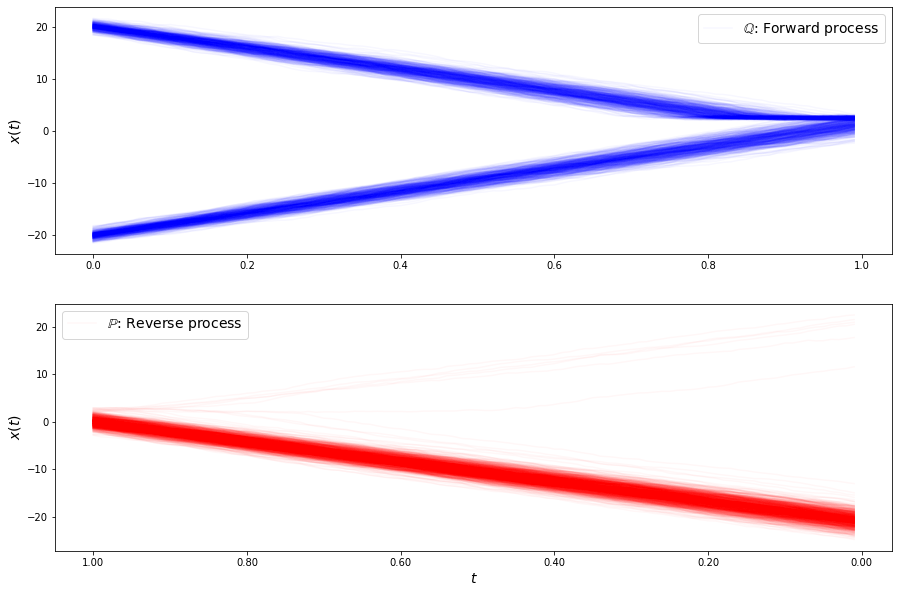

loss b -0.4644710738696586
loss b -0.2945979779721856
loss b -0.4250548670976341
loss b -0.3721585250978707
loss b -0.7147460623671762
loss b -0.43271894959700435
loss b -0.5640518054061828
loss b -0.34473452507900987
loss b -0.4320954277853566
loss b -0.2945530113773719
loss b -0.5636965568850374
loss b -0.46292746136688656
loss b -0.4456777545951748
loss b -0.4311297201390443
loss b -0.22993414009598945
loss b -0.6073291387302235
loss b -0.2731446781132389
loss b -0.2793908528533687
loss b -0.16583626426192616
loss b -0.45600219843334455
loss b -0.34062742729958995
loss b -0.20108921246110303
loss b -0.48372481446094
loss b -0.6334595540860078
loss b -0.29232497407945457
loss b -0.5496575020453008
loss b -0.5449718486562243
loss b -0.33055330059125776
loss b -0.5265149751817215
loss b -0.37150514546845187
loss f -4.406115064798532
loss f -4.660658553656338
loss f -3.9904931131357246
loss f -4.62832476830279
loss f -4.771146450997617
loss f -4.457864972539692
loss f -4.413185300251664

In [ ]:
torch.autograd.set_detect_anomaly(True)
c.fit(300, 30, burn_iterations=0, plot=True)

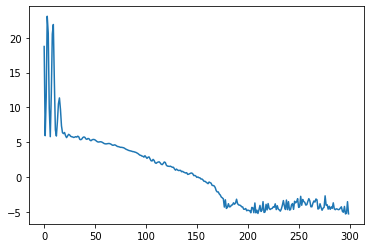

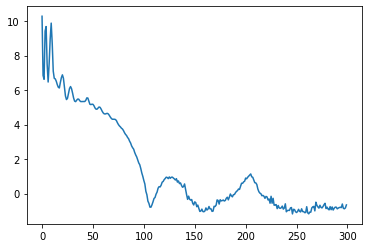

In [123]:
plt.plot(c.loss_f[10:])
plt.show()
plt.plot(c.loss_b[10:])

In [124]:
bb = lambda X: -c.b_backward(X)

t, Xts = c.sde_solver(
    c.b_forward.forward, c.sigma,
    c.X_0, c.dt,  c.number_time_steps, 0.0,
    c.theta_f, False, True
)
t_, Xts_ = c.sde_solver(
    bb, c.sigma, 
    c.X_1, c.dt, c.number_time_steps, 0.0, 
    c.theta_b, False, False
)

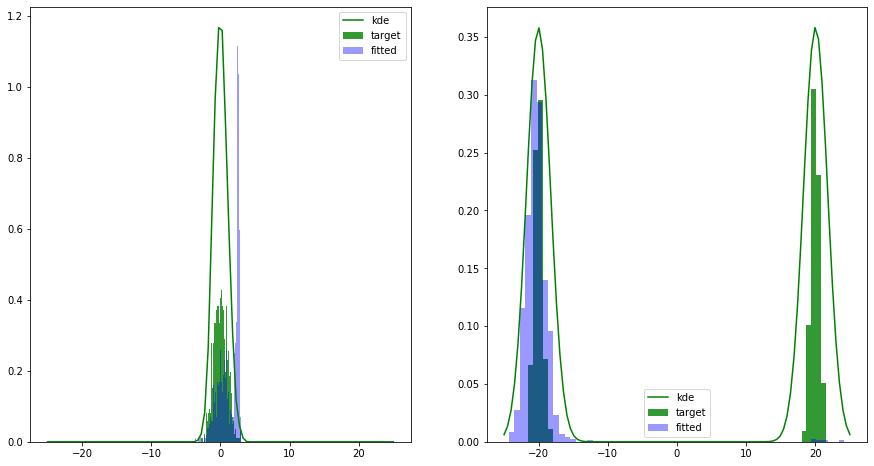

In [125]:
fig, axs = plt.subplots(1,2, figsize=(15, 8))
batch_terminal_empirical_f = next(c.data_stream(forward=True))
xx = torch.linspace(-25, 25).reshape(-1,1).cuda().double()

H = silvermans_rule(batch_terminal_empirical_f)
kd  = np.exp(log_kde_pdf_per_point(xx, batch_terminal_empirical_f, H).detach().cpu().numpy())
axs[1].plot(xx.detach().cpu().numpy(), kd, label="kde", color="green")


bins = 60
axs[1].hist(( X1.detach().cpu().numpy().flatten()), alpha=0.8, bins=bins, label="target", density=True, color="green");
axs[1].hist(( Xts_[:,-1,:-1].flatten().detach().cpu().numpy()), alpha=0.4, bins=bins, label="fitted", density=True, color="blue");
axs[1].legend()




batch_terminal_empirical_b = next(c.data_stream(forward=False))
# xx = torch.linspace(-10, 10).reshape(-1,1).cuda().double()

Hb = silvermans_rule(batch_terminal_empirical_b)
kd  = np.exp(log_kde_pdf_per_point(xx, batch_terminal_empirical_b, Hb).detach().cpu().numpy())
axs[0].plot(xx.detach().cpu().numpy(), kd, label="kde", color="green")


bins = 60
axs[0].hist(( X2.detach().cpu().numpy().flatten()), alpha=0.8, bins=bins, label="target", density=True, color="green");
axs[0].hist(( Xts[:,-1,:-1].flatten().detach().cpu().numpy()), alpha=0.4, bins=bins, label="fitted", density=True, color="blue");
axs[0].legend()